##### Importy

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from keras.src.layers import BatchNormalization, Dropout
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.arima.model import ARIMA
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.optimizers import Adam
import tensorflow as tf
import warnings
import keras_tuner as kt
import itertools
import time
from statsmodels.tsa.stattools import adfuller, kpss, acf, pacf

df_final = pd.read_csv("test20set.csv", parse_dates=['timestamp'])
warnings.filterwarnings('ignore')

C:\Users\Julia\AppData\Local\Temp\ipykernel_24544\606580740.py:20: DtypeWarning: Columns (8) have mixed types. Specify dtype option on import or set low_memory=False.
  df_final = pd.read_csv("test20set.csv", parse_dates=['timestamp'])


##### 1. Wczytanie danych

In [2]:
def visualize(building_data, type=None):
    if type == "small":
        building_data = building_data[(building_data['timestamp'].dt.year == 2017)&(building_data['timestamp'].dt.month == 3)].sort_values('timestamp')

    plt.figure(figsize=(15, 6))
    plt.plot(building_data['timestamp'], building_data['energy_consumption'], alpha=0.7)
    plt.title(f'Zużycie energii w czasie dla budynku {building_data["building_id"]} (2017)\n'
              f'Średnia temperatura: {building_data["airTemperature"].mean():.1f}°C', fontsize=14)
    plt.xlabel('Czas', fontsize=12)
    plt.ylabel('Zużycie energii', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.5)
    plt.tight_layout()
    plt.show()

In [3]:
def load_and_preprocess(file_path = None, data = None):
    if data is None:
        data = pd.read_csv(file_path, parse_dates=['timestamp'])
    data = data.sort_values('timestamp').set_index('timestamp')
    data = data.asfreq('H')

    for col in data.columns:
        data[col] = data[col].replace([np.inf, -np.inf], np.nan)
        data[col] = data[col].interpolate(method='time', limit_direction='both')
        data[col] = data[col].ffill().bfill()

    return data[['energy_consumption', 'airTemperature']]

##### Parametry ARIMA/ARIMAX

In [4]:
def find_arima_params(train, trainExog=None):
    d = determine_differencing_order(train)
    stationary_series = train.diff(d).dropna() if d > 0 else train.copy()

    max_lags = 20
    acf_vals = acf(stationary_series, nlags=max_lags, fft=True)
    pacf_vals = pacf(stationary_series, nlags=max_lags)

    p_range = suggest_p_from_pacf(pacf_vals)
    q_range = suggest_q_from_acf(acf_vals)

    best_aic = np.inf
    best_order = (1, d, 1)
    pdq = itertools.product(p_range, [d], q_range)

    for order in pdq:

        if trainExog is not None:
            try:
                model = ARIMA(train, exog=trainExog, order=order).fit()
                if model.aic < best_aic:
                    best_aic = model.aic
                    best_order = order
            except:
                continue
        else:
            try:
                model = ARIMA(train, order=order).fit()
                if model.aic < best_aic:
                    best_aic = model.aic
                    best_order = order
            except:
                continue

    validated_order = validate_arima_order(train, trainExog, best_order)
    return validated_order


def determine_differencing_order(series, max_diff=2):
    for d in range(max_diff + 1):
        if d > 0:
            diff_series = series.diff(d).dropna()
        else:
            diff_series = series.copy()
        adf_result = adfuller(diff_series)
        try:
            kpss_result = kpss(diff_series, regression='c')
        except:
            kpss_result = (None, 1.0)

        if adf_result[1] <= 0.05 and kpss_result[1] > 0.05:
            return d
    return max_diff

def suggest_p_from_pacf(pacf_vals, threshold=0.2):
    significant_lags = np.where(np.abs(pacf_vals) > threshold)[0]
    if len(significant_lags) > 0:
        max_p = min(np.max(significant_lags) + 2, 5)
        return range(0, max_p + 1)
    return [0, 1, 2]


def suggest_q_from_acf(acf_vals, threshold=0.2):
    significant_lags = np.where(np.abs(acf_vals) > threshold)[0]
    if len(significant_lags) > 0:
        max_q = min(np.max(significant_lags) + 2, 5)
        return range(0, max_q + 1)
    return [0, 1, 2]


def validate_arima_order(series, te, order, n_folds=3):
    p, d, q = order
    train_size = len(series)
    fold_size = train_size // (n_folds + 1)

    aic_scores = []

    for i in range(1, n_folds + 1):
        train = series.iloc[:i * fold_size]
        trainExog = te.iloc[:i * fold_size] if te is not None else None
        if trainExog is not None:
            try:
                model = ARIMA(train, exog=te, order=order).fit()
                aic_scores.append(model.aic)
            except:
                aic_scores.append(np.inf)
        else:
            try:
                model = ARIMA(train, order=order).fit()
                aic_scores.append(model.aic)
            except:
                aic_scores.append(np.inf)
    simpler_models = [
        (max(p - 1, 0), d, q),
        (p, d, max(q - 1, 0)),
        (max(p - 1, 0), d, max(q - 1, 0))
    ]
    for test_order in simpler_models:
        if te is not None:
            try:
                model = ARIMA(series, exog=te, order=test_order).fit()
                if model.aic < np.mean(aic_scores):
                    return test_order
            except:
                continue
        else:
            try:
                model = ARIMA(series, order=test_order).fit()
                if model.aic < np.mean(aic_scores):
                    return test_order
            except:
                continue

    return order

##### Parametry SARIMA/SARIMAX

In [5]:
def find_optimal_seasonal_params(train, trainExog=None, s=24, non_seasonal_order=(1, 1, 1)):
    D = determine_seasonal_differencing_order(train, s)
    P_range = [0, 1, 2]
    Q_range = [0, 1, 2]

    best_aic = np.inf
    best_order = (1, D, 1, s)

    for P, Q in itertools.product(P_range, Q_range):
        seasonal_order = (P, D, Q, s)
        if trainExog is not None:
            try:
                model = SARIMAX(train, exog=trainExog,
                                order=non_seasonal_order,
                                seasonal_order=seasonal_order).fit(disp=False)

                if model.aic < best_aic:
                    best_aic = model.aic
                    best_order = seasonal_order
            except:
                continue
        else:
            try:
                model = SARIMAX(train,
                                order=non_seasonal_order,
                                seasonal_order=seasonal_order).fit(disp=False)

                if model.aic < best_aic:
                    best_aic = model.aic
                    best_order = seasonal_order
            except:
                continue
    return best_order

def determine_seasonal_differencing_order(series, s, max_D=1):
    try:
        from statsmodels.tsa.statespace.tools import seasonal_decompose
        decomposition = seasonal_decompose(series, period=s)
        resid = decomposition.resid.dropna()
        if abs(resid).mean() < 0.1 * abs(series).mean():
            return 0
    except:
        pass

    for D in range(max_D + 1):
        if D > 0:
            diff_series = series.diff(s).dropna()
        else:
            diff_series = series.copy()
        acf_vals = acf(diff_series, nlags=s + 3, fft=True)
        if all(abs(acf_vals[s - 1:s + 2]) < 0.2):
            return D
    return max_D

##### LSTM

In [6]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.optimizers import Adam
import keras_tuner as kt
from sklearn.metrics import mean_squared_error, mean_absolute_error

n_steps = 24
n_features = 3 

def prepare_train_data(data, target_col, n_steps):
    scaler = MinMaxScaler()
    scaled = scaler.fit_transform(data)

    X, y = [], []
    for i in range(n_steps, len(scaled)):
        X.append(scaled[i-n_steps:i, :])
        y.append(scaled[i, data.columns.get_loc(target_col)])

    return np.array(X), np.array(y), scaler

def prepare_test_data(train_data, test_data, scaler, n_steps):
    combined = pd.concat([train_data.iloc[-n_steps:], test_data])
    scaled = scaler.transform(combined)

    X_test = []
    for i in range(n_steps, len(scaled)):
        X_test.append(scaled[i-n_steps:i, :])

    return np.array(X_test)

def build_model(hp):
    model = Sequential()
    model.add(LSTM(
        units=hp.Int('units', 32, 256, step=32),
        input_shape=(n_steps, n_features),
        return_sequences=False
    ))
    model.add(Dense(1))
    model.compile(
        optimizer=Adam(hp.Choice('lr', [1e-2, 1e-3, 1e-4])),
        loss='mse'
    )
    return model

def train_and_predict(train_data, test_data, target_col):

    lstm_times = dict()
    X_train, y_train, scaler = prepare_train_data(train_data, target_col, n_steps)

    start = time.time()
    tuner = kt.RandomSearch(
        build_model,
        objective='val_loss',
        max_trials=10,
        directory='tuning_pred',
        project_name='energy_forecast'
    )

    tuner.search(X_train, y_train, epochs=20, validation_split=0.2)
    best_model = tuner.get_best_models()[0]
    end = time.time()

    lstm_times["LSTMTrain"] = end - start

    start = time.time()
    X_test = prepare_test_data(train_data, test_data, scaler, n_steps)
    predictions = best_model.predict(X_test)
    end = time.time()

    lstm_times["LSTMPredict"] = end - start
    
    dummy = np.zeros((len(predictions), n_features))
    dummy[:, 0] = predictions.flatten()
    preds = scaler.inverse_transform(dummy)[:, 0]

    return preds, test_data[target_col].values, lstm_times

##### Random Forest


In [7]:
def create_rolling_features(data, window=24):
    df = pd.DataFrame(data)
    for i in range(1, window + 1):
        df[f'lag_{i}'] = df['energy_consumption'].shift(i)

    print(df)
    df['hour'] = df.index.hour
    df['day_of_week'] = df.index.dayofweek
    df['month'] = df.index.month
    return df.dropna()

def doRandomForest(trainData, testData):

    rfTimes = dict()

    print("Trenowanie Random Forest...")
    start = time.time()
    train_rf = create_rolling_features(trainData)
    X_train_rf, y_train_rf = train_rf.drop('energy_consumption', axis=1), train_rf['energy_consumption']
    end = time.time()

    rfTimes["RFTrain"] = end - start

    start = time.time()
    test_rf = create_rolling_features(pd.concat([trainData[-24:], testData]))
    X_test_rf, y_test_rf = test_rf.drop('energy_consumption', axis=1), test_rf['energy_consumption']
    end = time.time()

    rfTimes["RFTest"] = end - start

    start = time.time()
    rf_model = RandomForestRegressor(n_estimators=100)
    rf_model.fit(X_train_rf, y_train_rf)
    end = time.time()

    rfTimes["RFModel"] = end - start

    return rf_model, X_test_rf, y_test_rf, rfTimes



##### Ewaluacja

In [8]:
def evaluate_model(y_true, y_pred, model_name, trening_time=None, model_time=None):
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    return {'Model': model_name, 'RMSE': rmse, 'MAE': mae, 'MAPE': mape, 'Czas treningu': trening_time, 'Czas predykcji': model_time}


### Porównanie - ARIMA

In [9]:
import warnings
import pmdarima as pm
warnings.filterwarnings('ignore')
warnings.filterwarnings("ignore", category=FutureWarning)
sorted_buildings = sorted(df_final['building_id'].unique())
selected_buildings = sorted_buildings[:20]  # Selecting one building

all_results = []
all_metrics = []

for building_id in selected_buildings:
    print(f"\n\n====== Processing Building {building_id} ======")

    # 1. Data Preparation
    data = df_final[df_final['building_id'] == building_id].copy()
    data['timestamp'] = pd.to_datetime(data['timestamp'])
    data = data.set_index('timestamp').sort_index()

    # Set hourly frequency and handle missing values
    data = data.asfreq('H')
    print(f"\nMissing values before interpolation: {data['energy_consumption'].isna().sum()}")

    data['energy_consumption'] = data['energy_consumption'].interpolate()

    print(data['energy_consumption'])

    # 2. Stationarity Analysis
    print("\nStationarity Analysis:")
    adf_result = adfuller(data['energy_consumption'].dropna())
    print(f"ADF Statistic: {adf_result[0]}")
    print(f"p-value: {adf_result[1]}")
    print("Critical Values:")
    for key, value in adf_result[4].items():
        print(f"\t{key}: {value}")

    # Determine differencing needed
    if adf_result[1] > 0.05:
        print("Series is non-stationary - applying differencing")
        data['energy_diff'] = data['energy_consumption'].diff().dropna()

        # Check differenced series
        adf_diff = adfuller(data['energy_diff'].dropna())
        print(f"Differenced series p-value: {adf_diff[1]}")
    else:
        print("Series appears stationary")
        data['energy_diff'] = data['energy_consumption']

    # 3. Train-Test Split (maintaining temporal order)

    data = data.dropna(subset=['energy_diff', 'airTemperature'])
    train = data['energy_diff'][-720:-168]
    test = data['energy_diff'][-168:]

    X = data[['airTemperature']]
    exogTrain = X[-720:-168]
    exogTest = X[-168:]

    print(f"\nData split - Train: {len(train)}, Test: {len(test)}")
    print(f"Train period: {train.index.min()} to {train.index.max()}")
    print(f"Test period: {test.index.min()} to {test.index.max()}")

    try:
        arimaTimes = dict()
        start = time.time()
        arima_order = find_arima_params(train)
        end = time.time()
        arimaTimes["arimaSearch"] = end - start

        start = time.time()
        seasonal_order = find_optimal_seasonal_params(train, s=24)
        end = time.time()
        arimaTimes["arimaSeasonalSearch"] = end - start

        try:
            # ARIMA
            start = time.time()
            am = ARIMA(train, order=arima_order,
                        enforce_stationarity=False,
                        enforce_invertibility=False)
            arima_model = am.fit()
            forecast_arima = arima_model.get_forecast(steps=len(test))
            forecast_arima_values = forecast_arima.predicted_mean
            end = time.time()
            arimaTimes["ARIMA"] = end - start

        except Exception as e:
            print("Błąd ARIMA:", e)
            forecast_arima_values = pd.Series([np.nan] * len(test), index=test.index)
            arimaTimes["ARIMA"] = 0

        try:
            # SARIMA
            start = time.time()
            sm = SARIMAX(train, order=arima_order, seasonal_order=seasonal_order, enforce_stationarity=False, enforce_invertibility=False)
            sarima_model = sm.fit(disp=False)
            forecast_sarima = sarima_model.get_forecast(steps=len(test))
            forecast_sarima_values = forecast_sarima.predicted_mean
            end = time.time()
            arimaTimes["SARIMA"] = end - start

        except Exception as e:
            print("Błąd SARIMA:", e)
            forecast_sarima_values = pd.Series([np.nan] * len(test), index=test.index)
            arimaTimes["SARIMA"] = 0
            
        start = time.time()
        arima_order = find_arima_params(train, trainExog=exogTrain)
        end = time.time()
        arimaTimes["arimaxSearch"] = end - start

        start = time.time()
        seasonal_order = find_optimal_seasonal_params(train, trainExog=exogTrain, s=24)
        end = time.time()
        arimaTimes["arimaxSeasonalSearch"] = end - start


        try:
            # ARIMAX
            start = time.time()
            axm = ARIMA(train, exog=exogTrain, order=arima_order, enforce_stationarity=False, enforce_invertibility=False)
            arimax_model = axm.fit()
            forecast_arimax = arimax_model.get_forecast(steps=len(test), exog=exogTest)
            forecast_arimax_values = forecast_arimax.predicted_mean
            end = time.time()
            arimaTimes["ARIMAX"] = end - start

        except Exception as e:
            print("Błąd ARIMAX:", e)
            forecast_arimax_values = pd.Series([np.nan] * len(test), index=test.index)
            arimaTimes["ARIMAX"] = 0

        try:
            # SARIMAX
            start = time.time()
            sxm = SARIMAX(train, exog=exogTrain, order=arima_order,
                                    seasonal_order=seasonal_order, enforce_stationarity=False, enforce_invertibility=False)
            sarimax_model = sxm.fit()
            forecast_sarimax = sarimax_model.get_forecast(steps=len(test), exog=exogTest)
            forecast_sarimax_values = forecast_sarimax.predicted_mean
            end = time.time()
            arimaTimes["SARIMAX"] = end - start

        except Exception as e:
            print("Błąd SARIMAX:", e)
            forecast_sarimax_values = pd.Series([np.nan] * len(test), index=test.index)
            arimaTimes["SARIMAX"] = 0


        try:
            # autoARIMA
            start = time.time()
            auto_arima_model = pm.auto_arima(
                train,
                seasonal=False,
                start_p=0,  # Minimalna wartość p
                start_q=0,  # Minimalna wartość q
                max_p=5,    # Maksymalna wartość p
                max_q=5,    # Maksymalna wartość q
                max_d=3,    # Maksymalna wartość d
                stepwise=False,
                trace=True,
                error_action='ignore',
                suppress_warnings=True,
            )

            forecast_auto_arima = auto_arima_model.predict(n_periods=len(test))
            end = time.time()
            arimaTimes["AutoARIMA"] = end - start

            print("AutoARIMA forecast NaNs:", forecast_auto_arima.isna().sum())

        except Exception as e:
            print("Błąd AutoARIMA:", e)
            forecast_auto_arima = pd.Series([np.nan] * len(test), index=test.index)
            arimaTimes["AutoARIMA"] = 0

        try:
            # autoSARIMA
            start = time.time()
            auto_sarima_model = pm.auto_arima(
                train,
                seasonal=True,
                m=24,
                start_p=0,
                start_q=0,
                max_p=5,
                max_q=5,
                max_d=3,
                start_P=0,  # Minimalna sezonowa wartość P
                start_Q=0,  # Minimalna sezonowa wartość Q
                max_P=2,    # Maksymalna sezonowa wartość P
                max_Q=2,    # Maksymalna sezonowa wartość Q
                max_D=1,    # Maksymalna sezonowa wartość D
                stepwise=False,
                trace=True,
                error_action='ignore',
                suppress_warnings=True,
            )

            forecast_auto_sarima = auto_sarima_model.predict(n_periods=len(test))
            end = time.time()
            arimaTimes["AutoSARIMA"] = end - start

            print("AutoSARIMA forecast NaNs:", forecast_auto_sarima.isna().sum())

        except Exception as e:
            print("Błąd AutoARIMAX:", e)
            forecast_auto_sarima = pd.Series([np.nan] * len(test), index=test.index)
            arimaTimes["AutoARIMAX"] = 0

        try:
            # autoARIMAX
            start = time.time()
            auto_arimax_model = pm.auto_arima(
                train,
                exogenous=exogTrain,
                seasonal=False,
                start_p=0,
                start_q=0,
                max_p=5,
                max_q=5,
                max_d=3,
                stepwise=False,
                trace=True,
                error_action='ignore',
                suppress_warnings=True,
            )

            forecast_auto_arimax = auto_arimax_model.predict(n_periods=len(test), exogenous=exogTest)
            end = time.time()
            arimaTimes["AutoARIMAX"] = end - start

            print("AutoARIMAX forecast NaNs:", forecast_auto_arimax.isna().sum())

        except Exception as e:
            print("Błąd AutoARIMAX:", e)
            forecast_auto_arimax = pd.Series([np.nan] * len(test), index=test.index)
            arimaTimes["AutoARIMAX"] = 0

        try:
            # autoSARIMAX
            start = time.time()
            auto_sarimax_model = pm.auto_arima(
                train,
                exogenous=exogTrain,
                seasonal=True,
                m=24,
                start_p=0,
                start_q=0,
                max_p=5,
                max_q=5,
                max_d=3,
                start_P=0,
                start_Q=0,
                max_P=2,
                max_Q=2,
                max_D=1,
                stepwise=False,
                trace=True,
                error_action='ignore',
                suppress_warnings=True,
            )

            forecast_auto_sarimax = auto_sarimax_model.predict(n_periods=len(test), exogenous=exogTest)
            end = time.time()
            arimaTimes["AutoSARIMAX"] = end - start

            print("AutoSARIMAX forecast NaNs:", forecast_auto_sarimax.isna().sum())

        except Exception as e:
            print("Błąd AutoSARIMAX:", e)
            forecast_auto_sarimax = pd.Series([np.nan] * len(test), index=test.index)
            arimaTimes["AutoSARIMAX"] = 0

        results = pd.DataFrame(index=test.index)
        metrics = []

        results['ARIMA'] = list(forecast_arima_values)
        results['AutoARIMA'] = list(forecast_auto_arima)
        results['ARIMAX'] = list(forecast_arimax_values)
        results['AutoARIMAX'] = list(forecast_auto_arimax)
        results['SARIMA'] = list(forecast_sarima_values)
        results['AutoSARIMA'] = list(forecast_auto_sarima)
        results['SARIMAX'] = list(forecast_sarimax_values)
        results['AutoSARIMAX'] = list(forecast_auto_sarimax)

        try:
            metrics.append(evaluate_model(test, results['ARIMA'], 'ARIMA', model_time=arimaTimes['ARIMA'], trening_time=arimaTimes['arimaSearch']))
        except Exception as e:
            print("Błąd w evaluate_model ARIMA:", e)

        try:
            metrics.append(evaluate_model(test, results['SARIMA'], 'SARIMA', model_time=arimaTimes['SARIMA'], trening_time=arimaTimes['arimaSeasonalSearch']))
        except Exception as e:
            print("Błąd w evaluate_model SARIMA:", e)

        try:
            metrics.append(evaluate_model(test, results['ARIMAX'], 'ARIMAX', model_time=arimaTimes['ARIMAX'], trening_time=arimaTimes['arimaxSearch']))
        except Exception as e:
            print("Błąd w evaluate_model ARIMAX:", e)

        try:
            metrics.append(evaluate_model(test, results['SARIMAX'], 'SARIMAX', model_time=arimaTimes['SARIMAX'], trening_time=arimaTimes['arimaxSeasonalSearch']))
        except Exception as e:
            print("Błąd w evaluate_model SARIMAX:", e)

        try:
            metrics.append(evaluate_model(test, results['AutoARIMA'], 'AutoARIMA', model_time=arimaTimes['AutoARIMA'], trening_time=0))
        except Exception as e:
            print("Błąd w evaluate_model AutoARIMA:", e)

        try:
            metrics.append(evaluate_model(test, results['AutoSARIMA'], 'AutoSARIMA', model_time=arimaTimes['AutoSARIMA'], trening_time=0))
        except Exception as e:
            print("Błąd w evaluate_model AutoSARIMA:", e)

        try:
            metrics.append(evaluate_model(test, results['AutoARIMAX'], 'AutoARIMAX', model_time=arimaTimes['AutoARIMAX'], trening_time=0))
        except Exception as e:
            print("Błąd w evaluate_model AutoARIMAX:", e)

        try:
            metrics.append(evaluate_model(test, results['AutoSARIMAX'], 'AutoSARIMAX', model_time=arimaTimes['AutoSARIMAX'], trening_time=0))
        except Exception as e:
            print("Błąd w evaluate_model AutoSARIMAX:", e)

        print(results.head())

        all_results.append(results)
        all_metrics.append(metrics)

    except Exception as e:
        print(f"\nModel fitting failed: {str(e)}")



====== Processing Building Bear_assembly_Jose ======

Missing values before interpolation: 39
timestamp
2016-01-01 00:00:00    148.50
2016-01-01 01:00:00    152.00
2016-01-01 02:00:00    153.25
2016-01-01 03:00:00    145.50
2016-01-01 04:00:00    158.25
                        ...  
2017-12-31 19:00:00    226.50
2017-12-31 20:00:00    223.00
2017-12-31 21:00:00    163.50
2017-12-31 22:00:00    134.25
2017-12-31 23:00:00    136.25
Freq: h, Name: energy_consumption, Length: 17544, dtype: float64

Stationarity Analysis:
ADF Statistic: -9.590546457752216
p-value: 2.0416257007135208e-16
Critical Values:
	1%: -3.430723750472268
	5%: -2.8617051832726124
	10%: -2.5668579227683557
Series appears stationary

Data split - Train: 552, Test: 168
Train period: 2017-12-01 23:00:00 to 2017-12-24 22:00:00
Test period: 2017-12-24 23:00:00 to 2017-12-31 23:00:00
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=4945.498, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=4840.954, Time=0.11 sec
 ARIMA(0,1

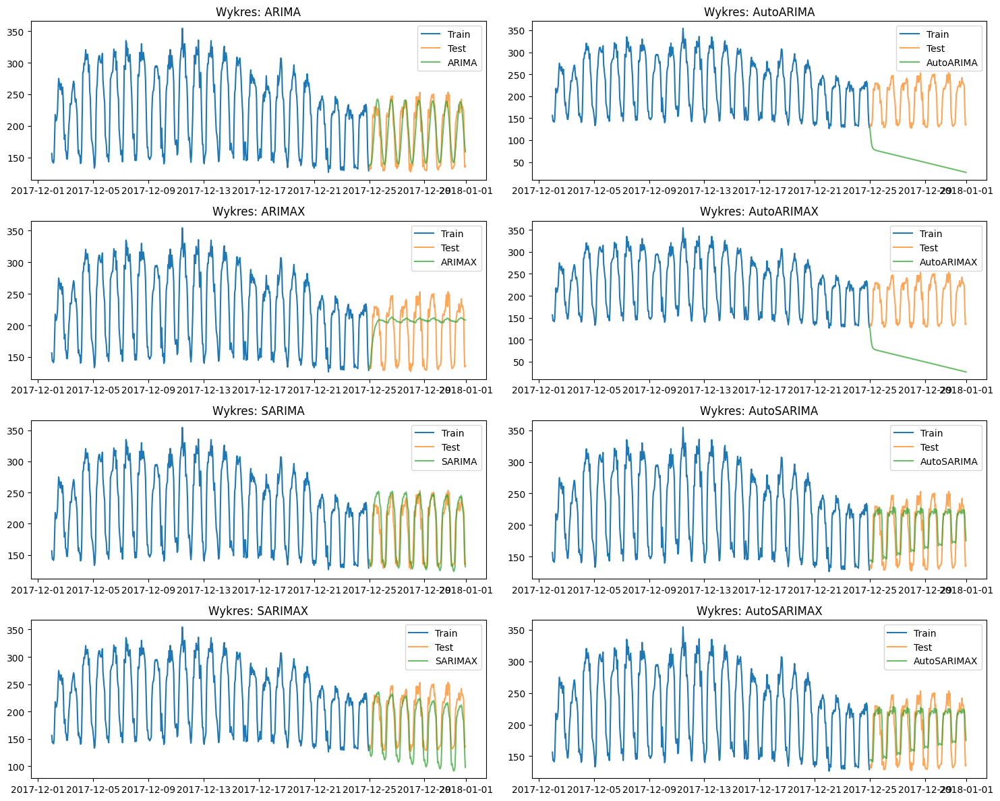


Metryki efektywności:
                   RMSE         MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                       
SARIMA        14.336179   11.249448  0.058616      63.334824       10.073249
ARIMA         17.544192   13.980997  0.075876      19.916803        0.794257
AutoSARIMA    21.260787   17.243511  0.104094       0.000000      235.555268
AutoSARIMAX   21.260787   17.243511  0.104094       0.000000      239.479809
SARIMAX       23.722654   20.244622  0.114797      80.068201       29.962992
ARIMAX        43.321426   35.354315  0.222228      24.472939        0.495826
AutoARIMA    145.827652  137.464303  0.698456       0.000000        5.847878
AutoARIMAX   145.827652  137.464303  0.698456       0.000000        5.489742


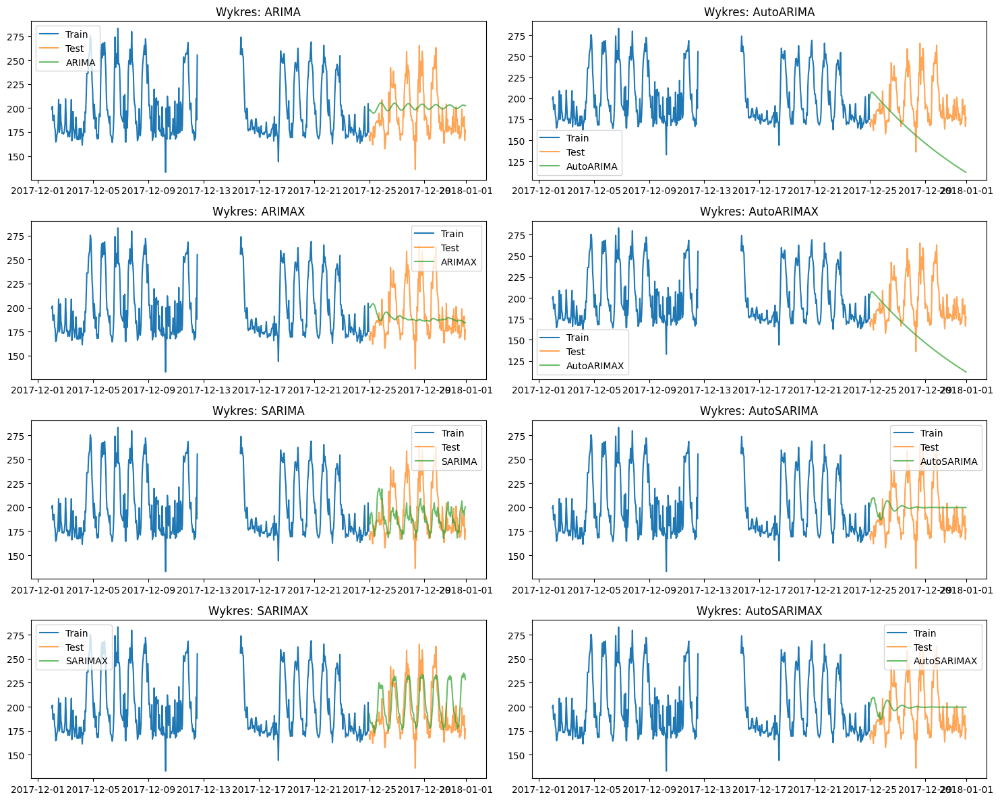


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
SARIMAX      22.931175  17.489124  0.092681    2332.397599       33.308610
SARIMA       24.464953  18.372022  0.089181      66.792689       25.226586
ARIMA        25.375247  22.459771  0.116579      23.214965        0.694547
AutoSARIMA   27.423723  23.676669  0.122349       0.000000      329.779498
AutoSARIMAX  27.423723  23.676669  0.122349       0.000000      325.245089
ARIMAX       27.828206  21.237558  0.103941      26.883768        0.711644
AutoARIMA    54.778550  46.631000  0.231675       0.000000        3.982531
AutoARIMAX   54.778550  46.631000  0.231675       0.000000        3.848981


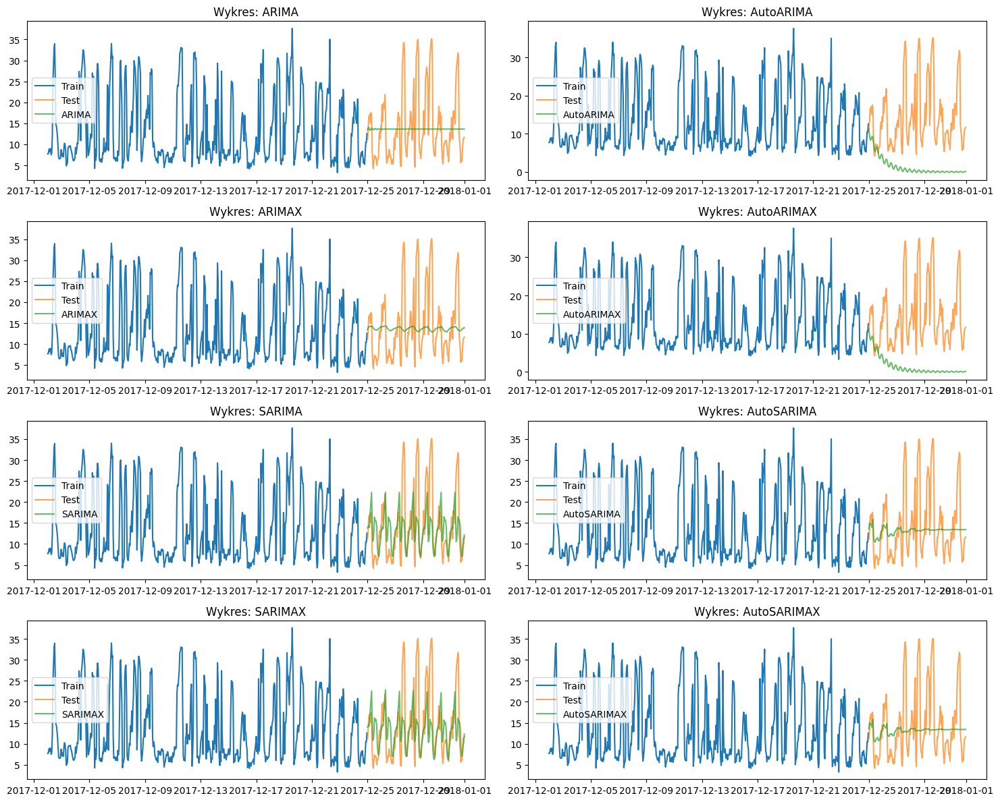


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
SARIMA        7.278682   5.062996  0.378483      87.275294       10.963029
SARIMAX       7.405720   5.118689  0.380620     102.088759        8.380419
AutoSARIMA    8.058699   5.832135  0.458614       0.000000      244.183961
AutoSARIMAX   8.058699   5.832135  0.458614       0.000000      245.870058
ARIMA         8.249188   6.259353  0.525131      10.432275        0.437169
ARIMAX        8.267743   6.161332  0.516945      11.745744        0.421586
AutoARIMA    15.804745  13.107004  0.868543       0.000000        4.413848
AutoARIMAX   15.804745  13.107004  0.868543       0.000000        4.742978


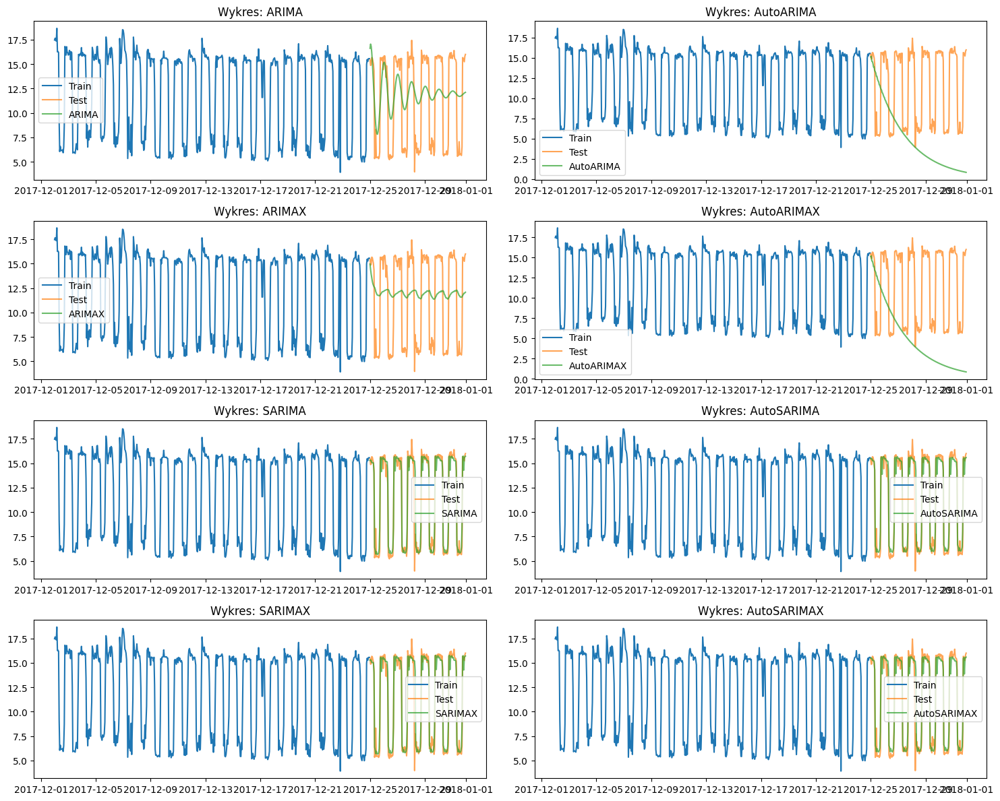


Metryki efektywności:
                 RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                   
SARIMAX      1.261169  0.631525  0.081779      60.353024        6.478910
SARIMA       1.262487  0.630913  0.081648      47.894298        6.400736
AutoSARIMA   1.271446  0.676107  0.085962       0.000000      307.937260
AutoSARIMAX  1.271446  0.676107  0.085962       0.000000      373.863315
ARIMA        3.962976  3.655189  0.453093      25.413509        0.589097
ARIMAX       4.611470  4.362422  0.542582      27.273381        0.319594
AutoARIMA    8.908752  7.497813  0.645187       0.000000        3.684866
AutoARIMAX   8.908752  7.497813  0.645187       0.000000        5.794722


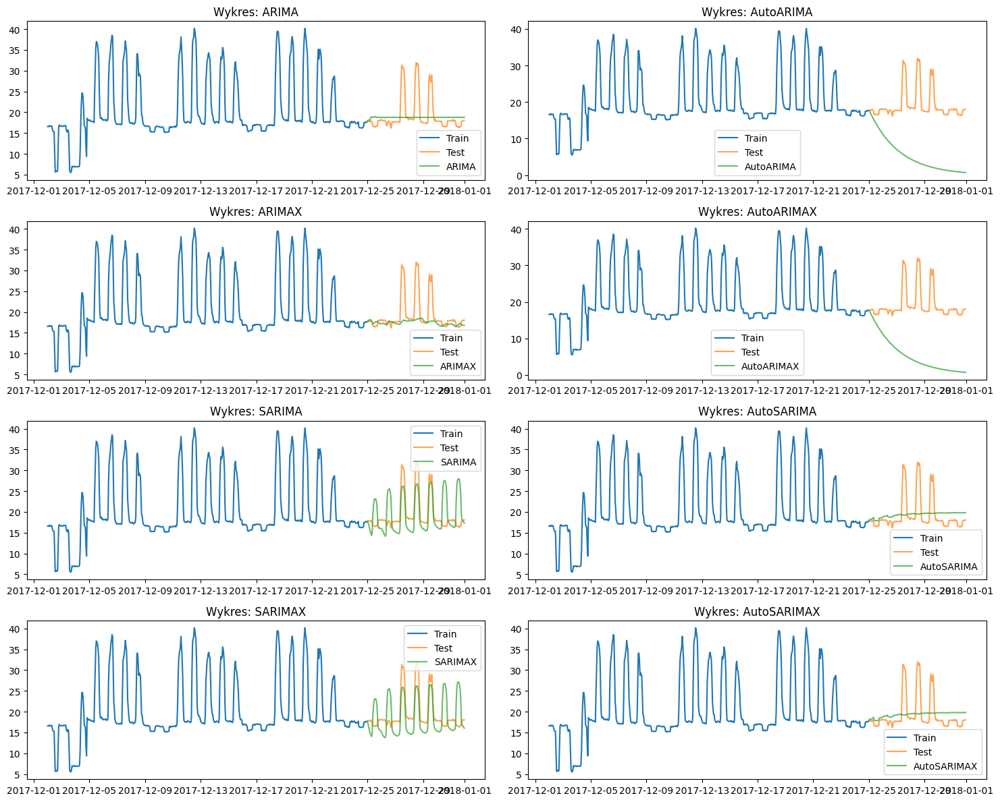


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
AutoSARIMA    4.051497   2.775887  0.127888       0.000000      315.480579
AutoSARIMAX   4.051497   2.775887  0.127888       0.000000      376.117718
ARIMA         4.114041   2.453184  0.107400      25.118737        0.913944
ARIMAX        4.289312   2.151119  0.086368      26.474038        0.821807
SARIMA        4.364051   3.326179  0.181425      95.549094       52.410393
SARIMAX       4.441207   3.724567  0.201704     110.820975       45.123688
AutoARIMA    15.460041  13.977461  0.709862       0.000000        5.190065
AutoARIMAX   15.460041  13.977461  0.709862       0.000000        5.630489


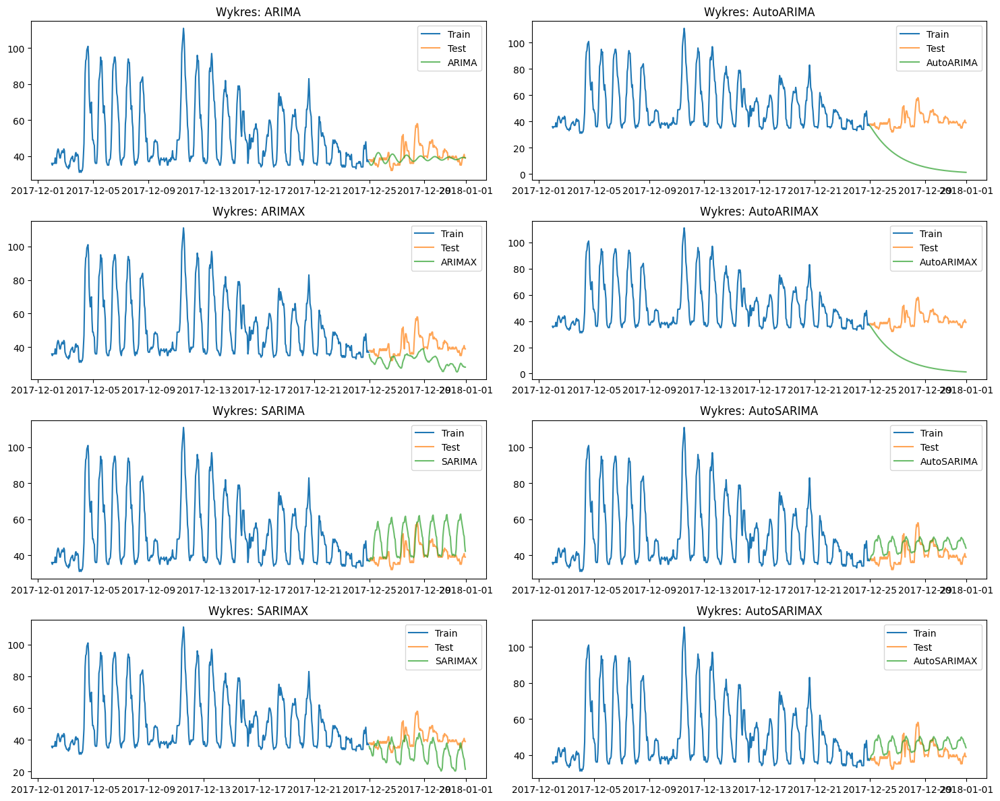


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
ARIMA         5.639042   4.023737  0.093612      23.571298        0.857708
AutoSARIMA    7.115168   5.776694  0.150600       0.000000      349.730073
AutoSARIMAX   7.115168   5.776694  0.150600       0.000000      409.583849
ARIMAX       10.370139   9.045928  0.214539      29.488850        1.320348
SARIMAX      10.384547   9.045020  0.221168      72.105088       21.737471
SARIMA       11.807942   8.911407  0.228875      49.491179       12.500436
AutoARIMA    32.442892  30.001131  0.725257       0.000000        6.674931
AutoARIMAX   32.442892  30.001131  0.725257       0.000000        5.998390


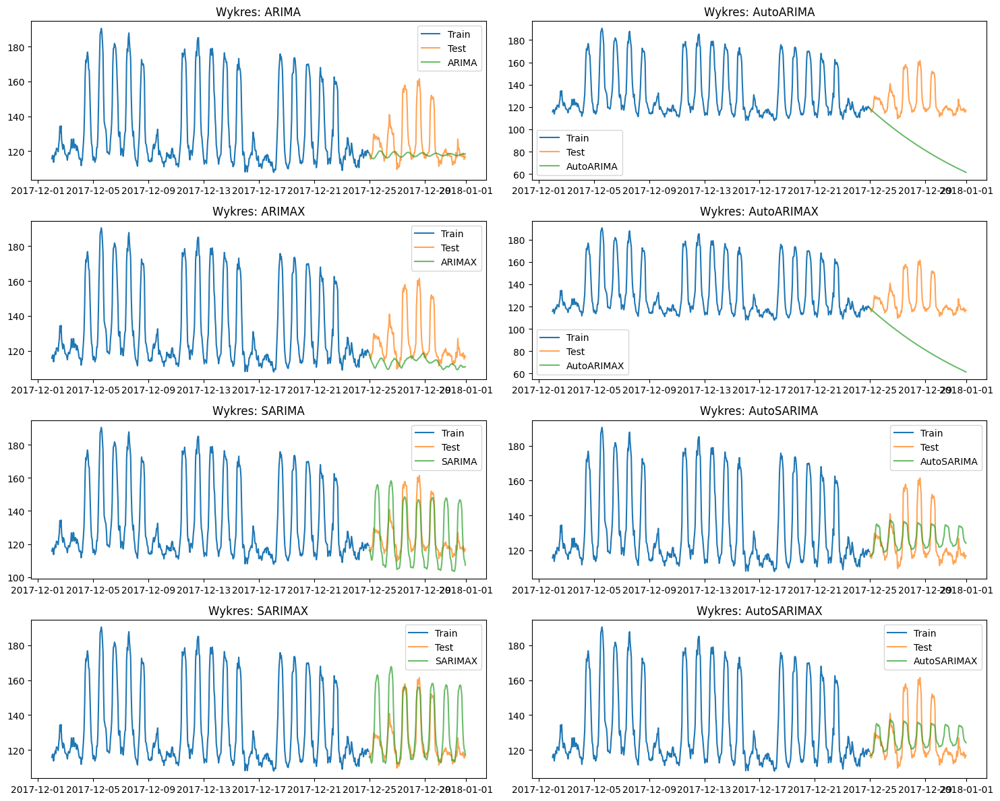


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
AutoSARIMA    9.937988   7.973653  0.062002       0.000000      413.651076
AutoSARIMAX   9.937988   7.973653  0.062002       0.000000      404.355586
SARIMA       12.760085  10.340587  0.083185     122.348281       52.251143
ARIMA        14.849074   8.917259  0.063695      27.593868        1.020897
SARIMAX      15.238813   9.488796  0.076290     155.689664       68.547532
ARIMAX       17.534448  12.158123  0.089008      30.016590        1.505203
AutoARIMA    42.930496  38.269657  0.301315       0.000000        8.257052
AutoARIMAX   42.930496  38.269657  0.301315       0.000000        4.823582


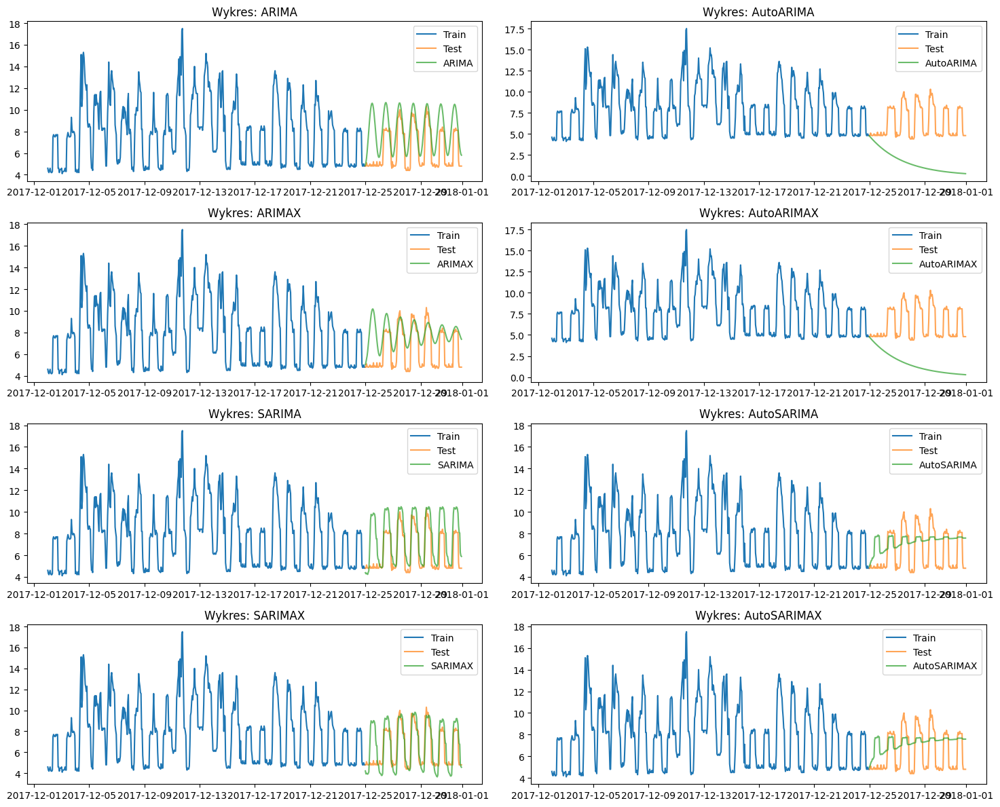


Metryki efektywności:
                 RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                   
SARIMAX      1.321052  0.977526  0.172170     107.716624       15.846182
SARIMA       1.830964  1.355556  0.230718      98.959972       62.341992
AutoSARIMA   1.921056  1.678790  0.309168       0.000000      337.823352
AutoSARIMAX  1.921056  1.678790  0.309168       0.000000      317.416802
ARIMAX       2.082089  1.674439  0.323900      17.794228        1.007625
ARIMA        2.226000  1.808456  0.330315      24.111989        1.299362
AutoARIMA    5.402989  4.813549  0.720022       0.000000        4.838025
AutoARIMAX   5.402989  4.813549  0.720022       0.000000        5.047278


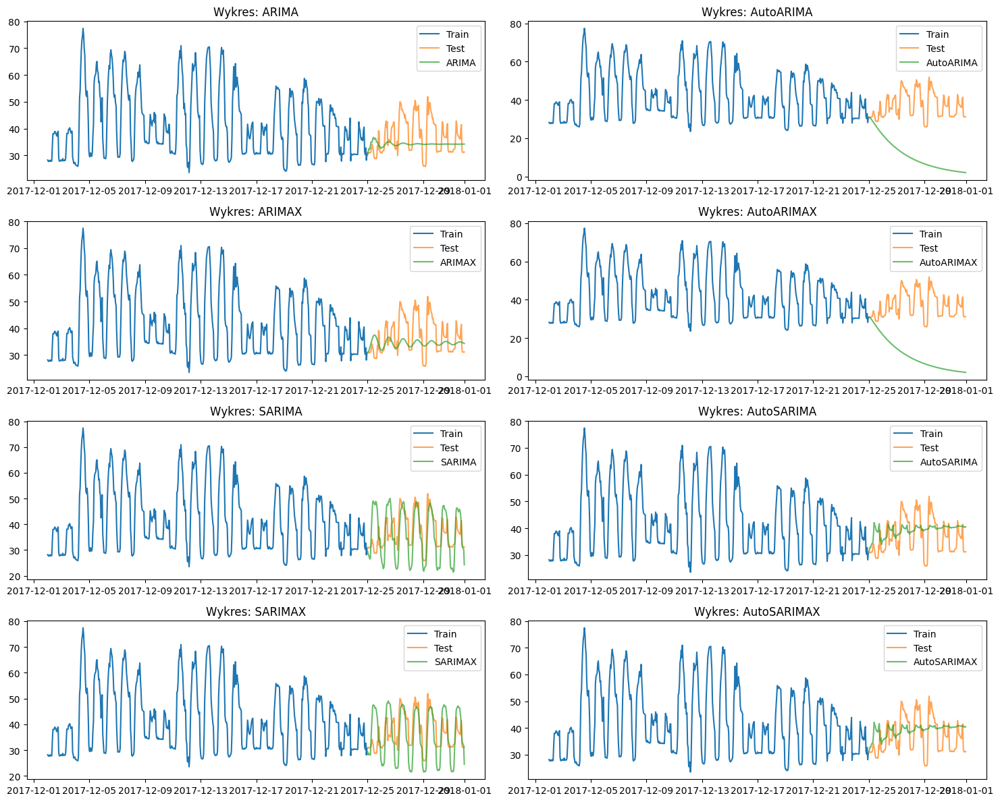


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
AutoSARIMA    6.545835   5.660294  0.163358       0.000000      314.236096
AutoSARIMAX   6.545835   5.660294  0.163358       0.000000      393.590031
ARIMAX        6.756876   5.303423  0.134172      25.740129        1.029572
ARIMA         7.150299   5.659459  0.142850      21.568284        0.845775
SARIMA        7.721008   6.281395  0.180400      95.523253       60.765777
SARIMAX       7.751718   6.473669  0.185067     119.031193       55.016932
AutoARIMA    28.649939  26.191270  0.688237       0.000000        4.381837
AutoARIMAX   28.649939  26.191270  0.688237       0.000000        4.326093


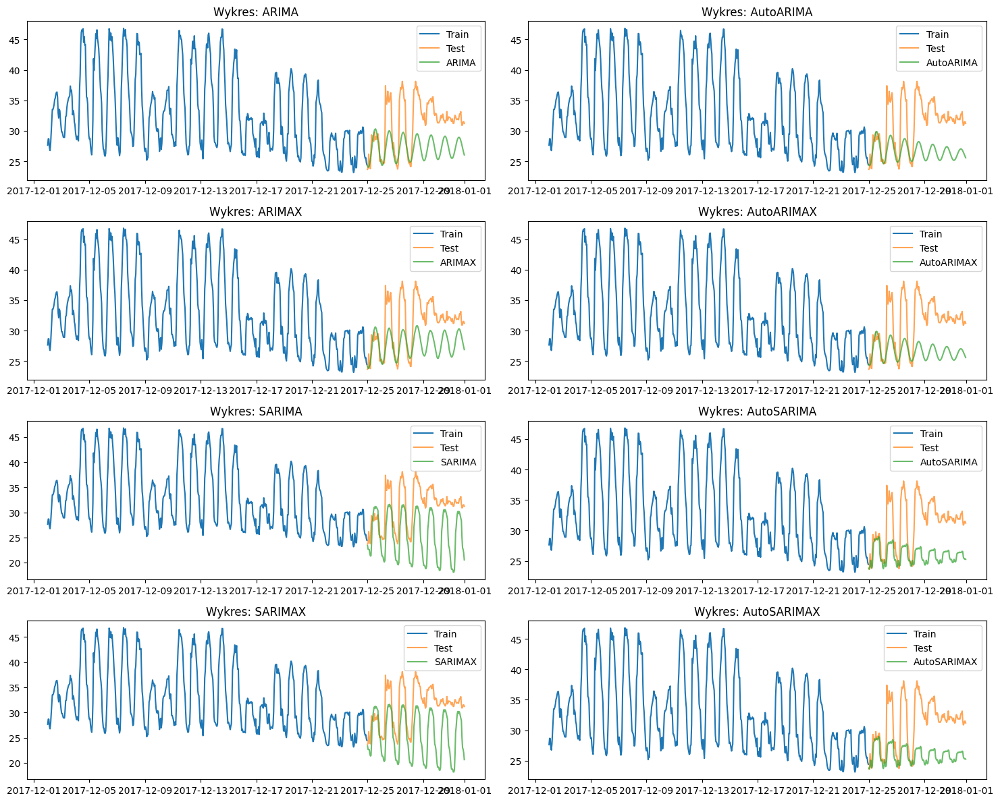


Metryki efektywności:
                 RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                   
ARIMAX       4.447183  3.728929  0.112696      45.358547        2.339216
ARIMA        4.991213  4.218441  0.127225      41.183112        1.430872
AutoARIMA    5.656172  4.805467  0.144721       0.000000       10.637150
AutoARIMAX   5.656172  4.805467  0.144721       0.000000       10.621243
AutoSARIMA   6.173470  5.265600  0.158564       0.000000      466.726025
AutoSARIMAX  6.173470  5.265600  0.158564       0.000000      427.829433
SARIMAX      6.911948  5.917279  0.187277     159.347897       93.605696
SARIMA       6.970905  5.967198  0.188959     127.740726       89.271380


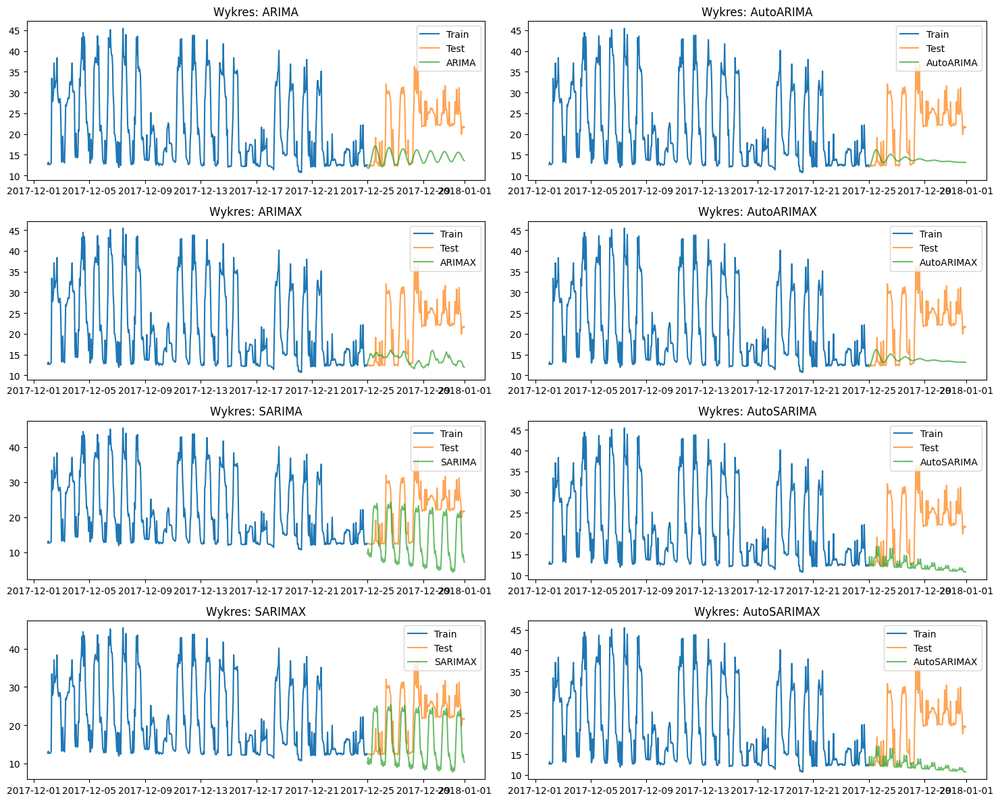


Metryki efektywności:
                  RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                    
SARIMAX       8.351648  6.960542  0.325066     139.738460       54.883593
ARIMA         9.286660  7.727544  0.312791      45.550262        1.646910
ARIMAX       10.241785  8.565870  0.350000      43.116505        1.218117
SARIMA       10.245383  8.919040  0.419890     112.987057       70.743365
AutoARIMA    10.252752  8.503230  0.342828       0.000000       12.635273
AutoARIMAX   10.252752  8.503230  0.342828       0.000000       12.266226
AutoSARIMA   11.501954  9.602459  0.385982       0.000000      383.095967
AutoSARIMAX  11.501954  9.602459  0.385982       0.000000      360.440361


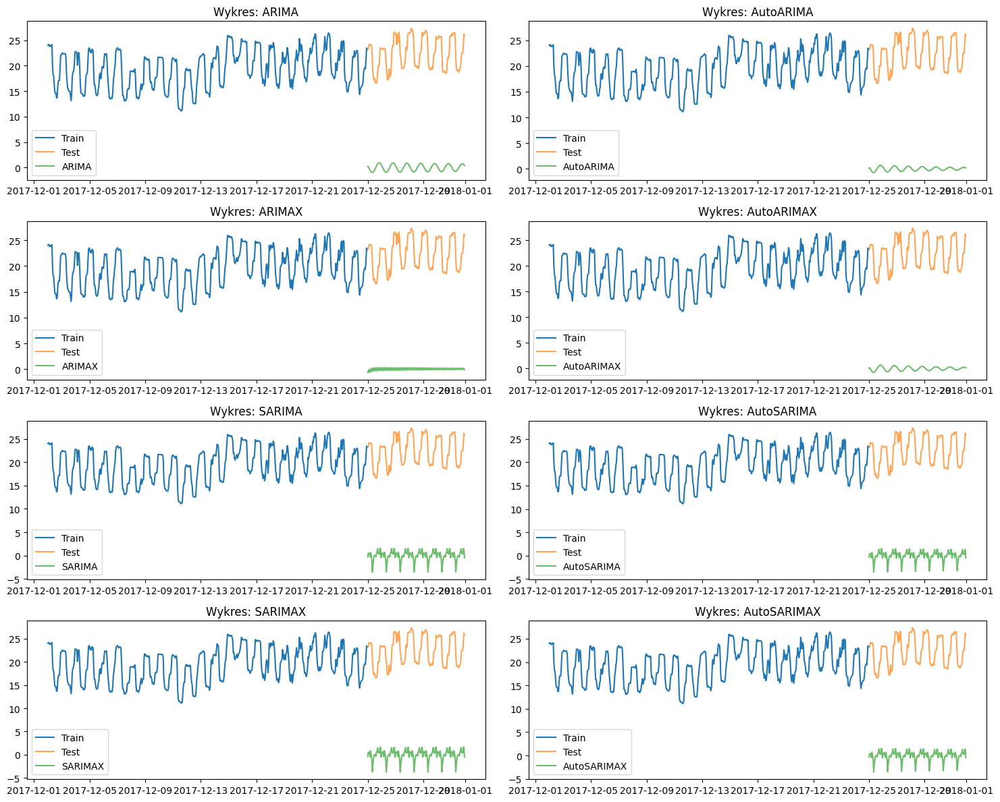


Metryki efektywności:
                 RMSE       MAE          MAPE  Czas treningu  Czas predykcji
Model                                                                       
SARIMA       0.702815  0.516648  2.623672e+13     200.297271        9.258894
AutoSARIMA   0.717516  0.523841  2.337259e+13       0.000000      178.216192
AutoSARIMAX  0.717516  0.523841  2.337259e+13       0.000000      171.024041
SARIMAX      0.741279  0.554674  3.011031e+13     109.771101       16.662724
ARIMA        0.935547  0.716616  3.250863e+13      48.159986        1.434906
AutoARIMA    1.010268  0.699906  1.202730e+13       0.000000        2.720797
AutoARIMAX   1.010268  0.699906  1.202730e+13       0.000000        2.683277
ARIMAX       1.151038  0.793648  1.486413e+12      30.674402        1.012472


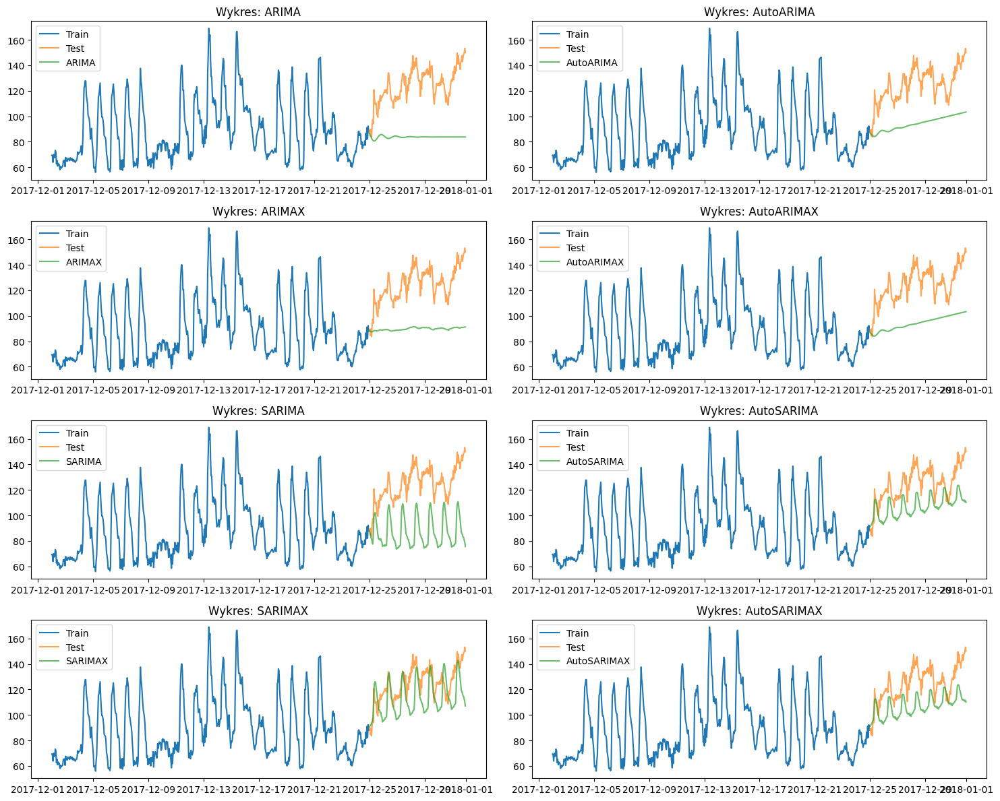


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
SARIMAX      18.411092  14.838877  0.116238      81.125571       18.642519
AutoSARIMA   20.806156  18.333391  0.142129       0.000000      159.122847
AutoSARIMAX  20.806156  18.333391  0.142129       0.000000     1225.167134
AutoARIMA    32.247543  30.286296  0.236536       0.000000        5.199794
AutoARIMAX   32.247543  30.286296  0.236536       0.000000        5.252055
ARIMAX       37.138902  34.890918  0.271715       6.917097        0.157848
SARIMA       40.963500  37.674969  0.295283      63.199983       23.215762
ARIMA        43.080360  40.809957  0.318781       4.558666        0.442038


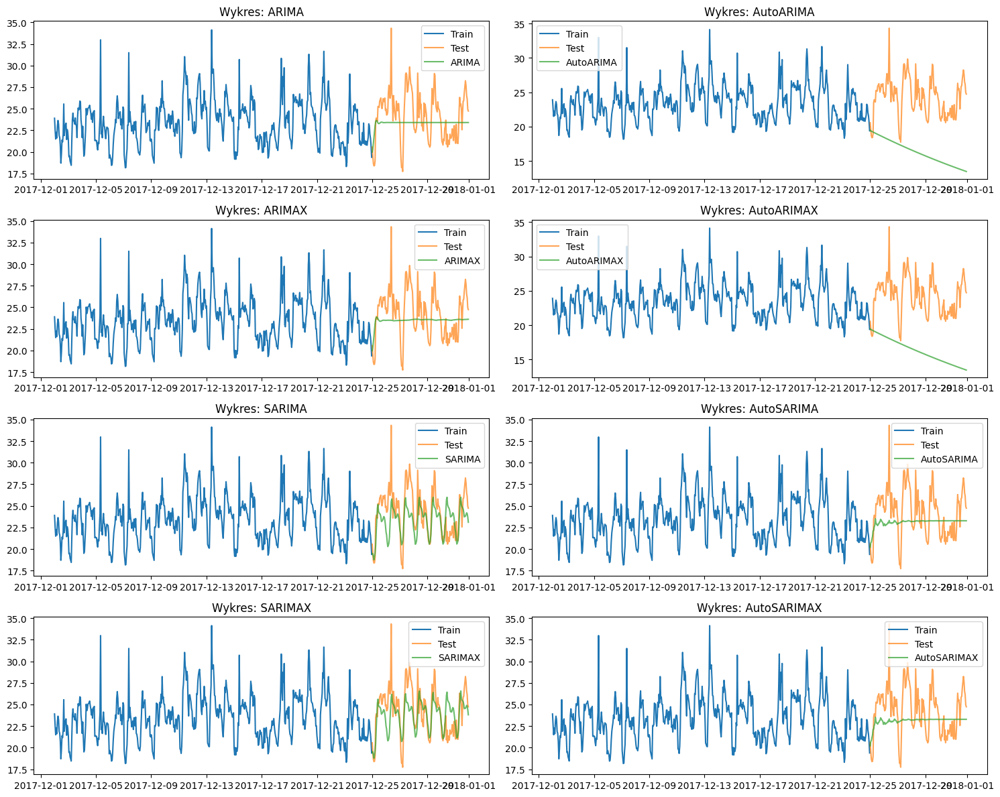


Metryki efektywności:
                 RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                   
SARIMAX      2.236544  1.681925  0.068138      79.102673        5.606045
SARIMA       2.418633  1.862881  0.074441      71.892045        8.708020
ARIMAX       2.744367  2.244144  0.091666       8.790037        0.416965
ARIMA        2.785161  2.271367  0.092327       8.916756        0.683446
AutoSARIMA   2.862277  2.364006  0.095341       0.000000      336.624334
AutoSARIMAX  2.862277  2.364006  0.095341       0.000000      337.570205
AutoARIMA    8.582543  8.039745  0.323524       0.000000        3.326176
AutoARIMAX   8.582543  8.039745  0.323524       0.000000        3.823847


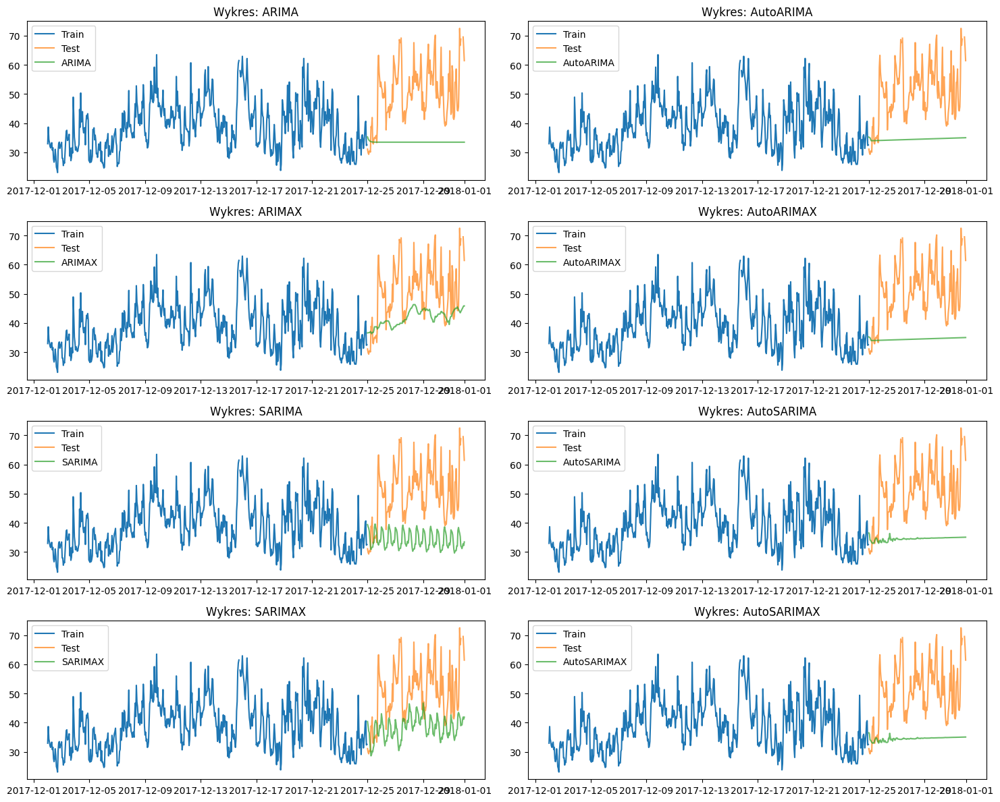


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
ARIMAX       12.092458   9.596529  0.175778       1.547059        0.133349
SARIMAX      14.920640  12.338506  0.226062      56.930667        8.233876
AutoSARIMA   18.246874  15.879944  0.293202       0.000000    49263.114254
AutoSARIMAX  18.246874  15.879944  0.293202       0.000000      199.939297
AutoARIMA    18.305363  15.964355  0.295237       0.000000        5.336185
AutoARIMAX   18.305363  15.964355  0.295237       0.000000        6.935064
SARIMA       18.739868  16.345189  0.303562      39.195540        1.844965
ARIMA        19.228283  16.897714  0.313295       1.000070        0.077806


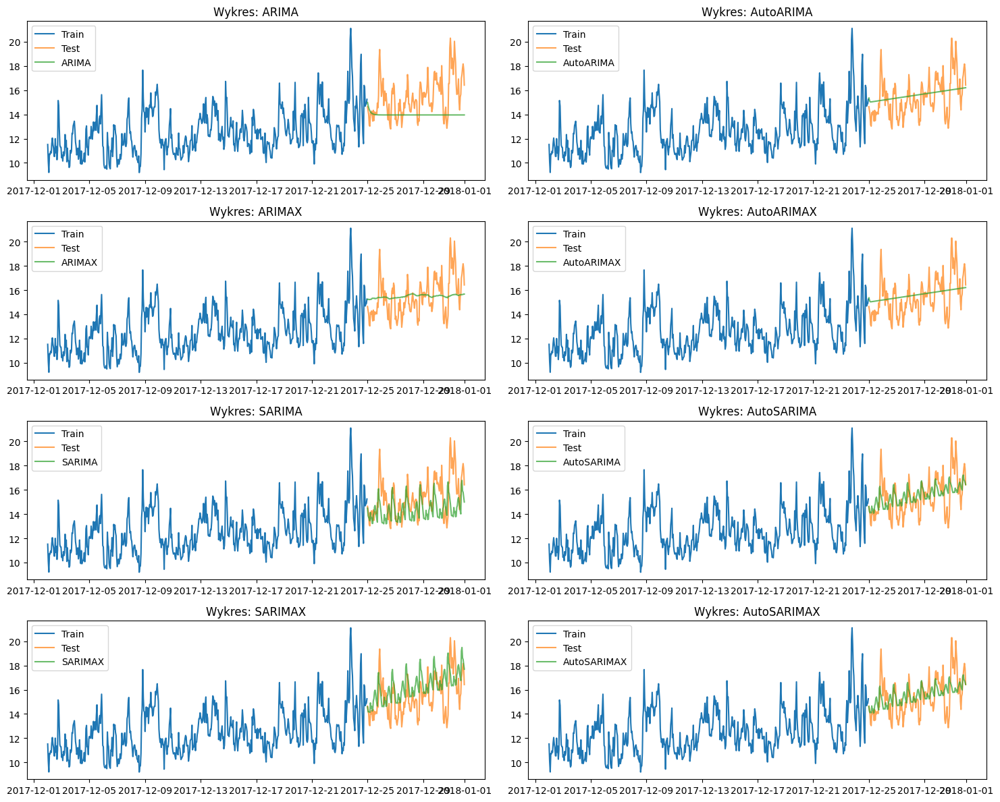


Metryki efektywności:
                 RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                   
AutoSARIMA   1.461044  1.127385  0.073153       0.000000      212.984850
AutoSARIMAX  1.461044  1.127385  0.073153       0.000000      208.248017
AutoARIMA    1.489356  1.203613  0.078511       0.000000        8.007890
AutoARIMAX   1.489356  1.203613  0.078511       0.000000        8.123747
ARIMAX       1.548521  1.249677  0.080639       1.573384        0.046711
SARIMAX      1.783489  1.452828  0.096721     117.442006        1.193727
SARIMA       1.911339  1.431231  0.087954     107.071831        4.683689
ARIMA        2.184825  1.687538  0.102188       1.533902        0.140541


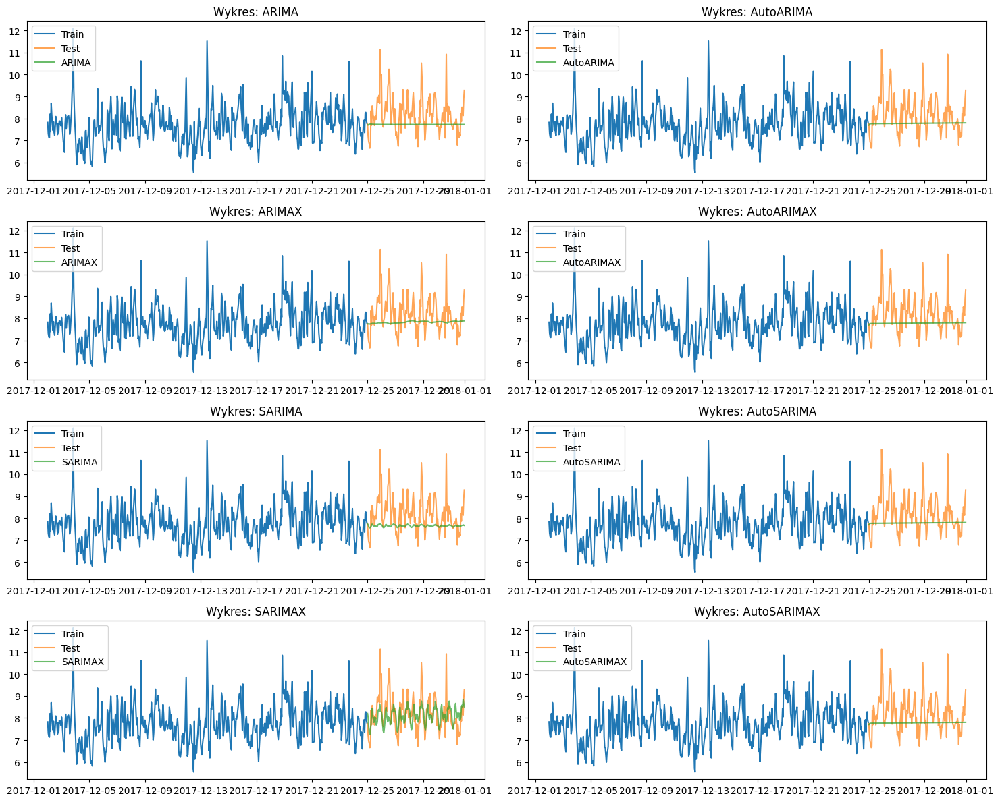


Metryki efektywności:
                 RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                   
SARIMAX      0.716986  0.521915  0.061961      34.765306        0.968934
ARIMAX       0.874777  0.640896  0.074602       7.429972        0.150185
AutoARIMA    0.891332  0.654083  0.075939       0.000000        9.150619
AutoSARIMA   0.891332  0.654083  0.075939       0.000000      259.954514
AutoARIMAX   0.891332  0.654083  0.075939       0.000000        9.295666
AutoSARIMAX  0.891332  0.654083  0.075939       0.000000      264.991623
ARIMA        0.916687  0.675779  0.078230       7.921885        0.445292
SARIMA       0.944027  0.705624  0.081378      23.499930        2.857413


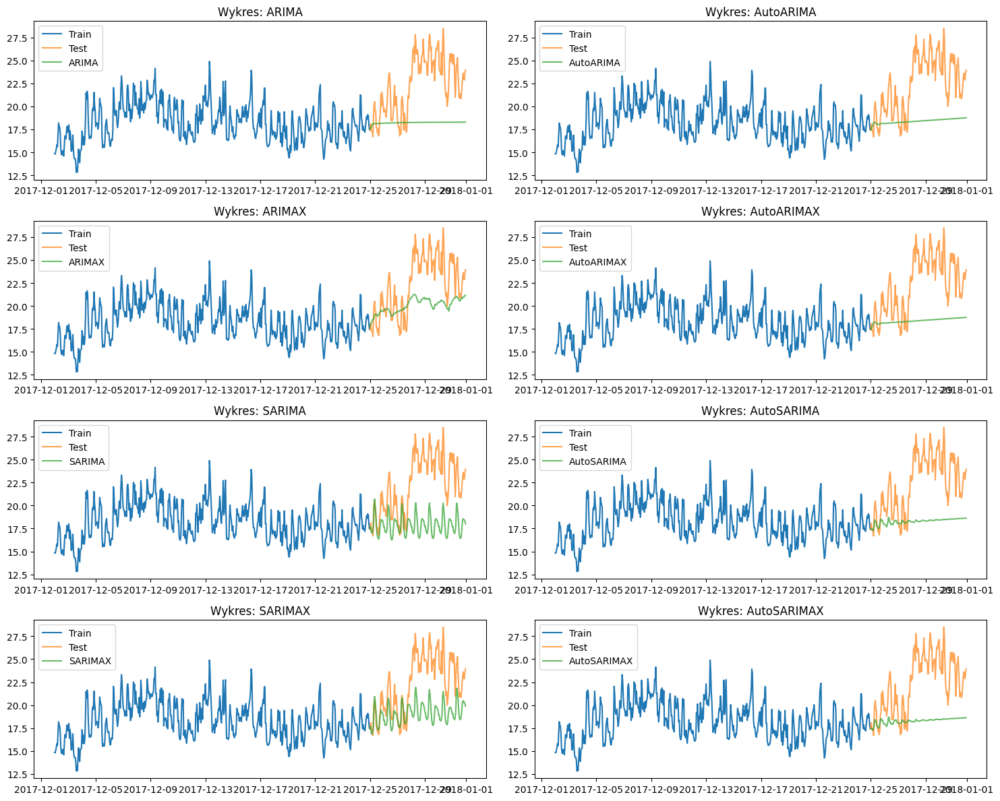


Metryki efektywności:
                 RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                   
ARIMAX       3.423351  2.784779  0.116949      10.739224        0.782267
SARIMAX      4.094547  3.343764  0.138939      65.822215       31.734582
AutoARIMA    4.902014  4.104776  0.170900       0.000000        6.390856
AutoARIMAX   4.902014  4.104776  0.170900       0.000000        6.337039
AutoSARIMA   4.968835  4.141407  0.171997       0.000000      214.159429
AutoSARIMAX  4.968835  4.141407  0.171997       0.000000      421.208217
ARIMA        5.085183  4.270153  0.177854      12.968679        0.764361
SARIMA       5.270214  4.460500  0.186813      50.369290       37.536515


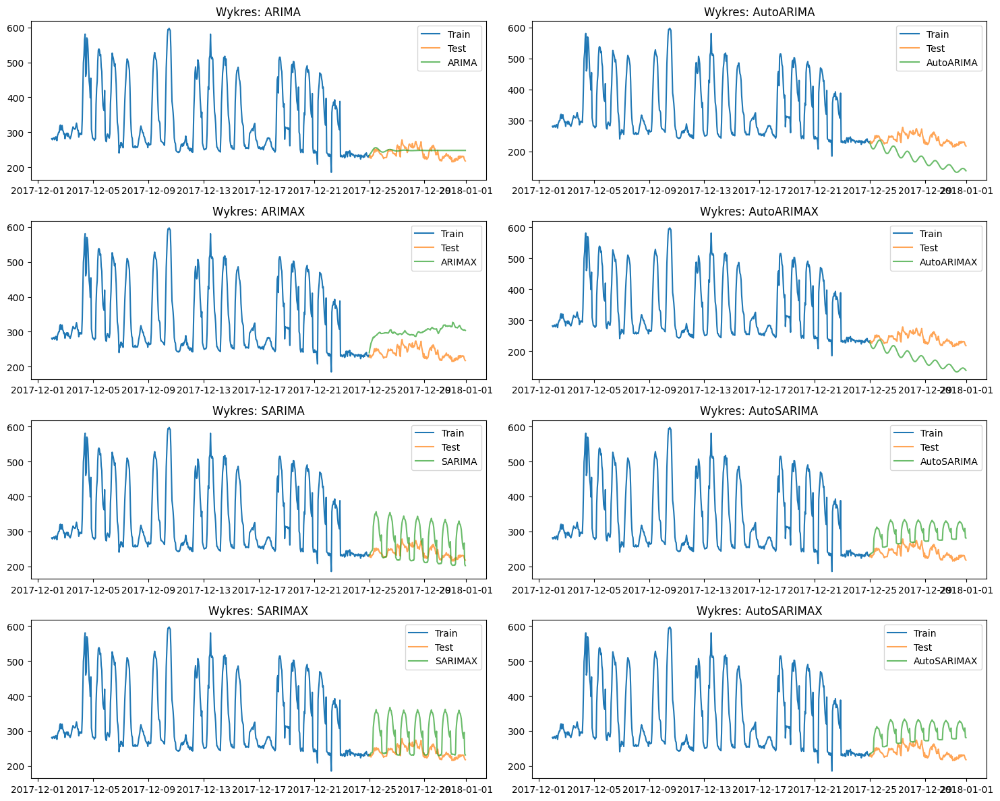


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
ARIMA        16.285547  14.086065  0.059875      19.450765        0.737905
SARIMA       56.736484  47.023476  0.193429      58.595671       43.759923
AutoSARIMA   60.782960  55.238913  0.231828       0.000000      323.683123
AutoSARIMAX  60.782960  55.238913  0.231828       0.000000     1091.329695
ARIMAX       64.027979  59.946130  0.255004      25.764031        0.731694
AutoARIMA    67.802375  62.322885  0.259003       0.000000        4.788564
AutoARIMAX   67.802375  62.322885  0.259003       0.000000        4.782627
SARIMAX      69.685192  56.953702  0.234887      91.840675       33.550023


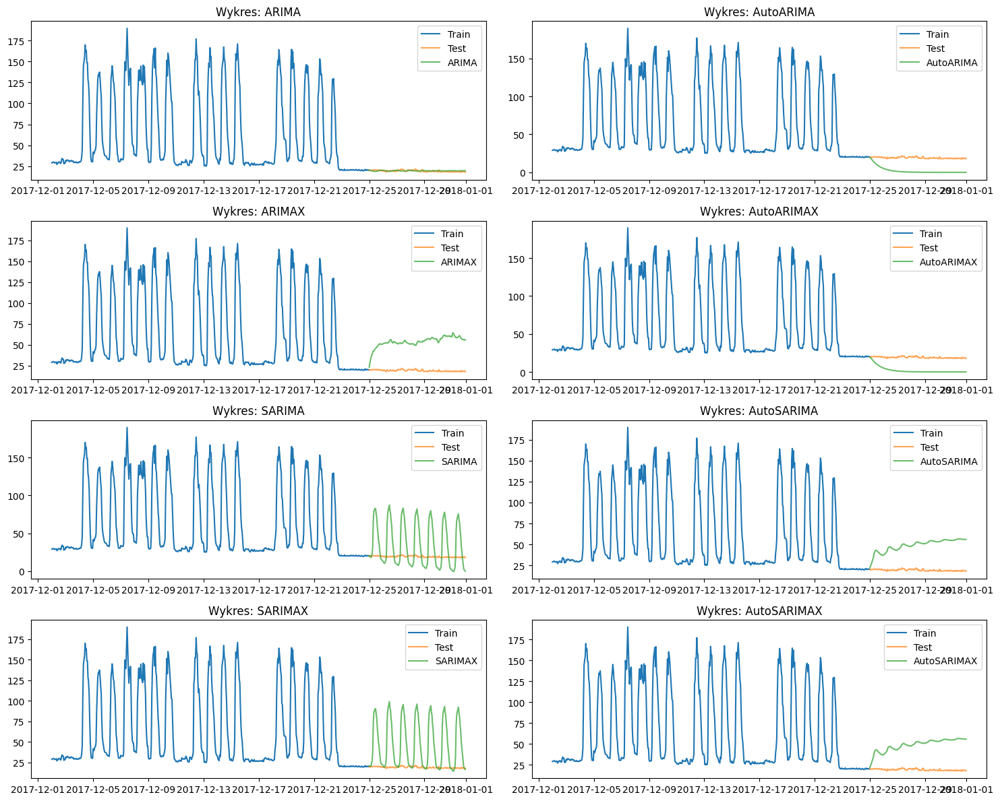


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
ARIMA         1.054229   0.924513  0.048548       9.786400        0.665734
AutoARIMA    17.479003  17.026736  0.892619       0.000000        3.924172
AutoARIMAX   17.479003  17.026736  0.892619       0.000000        3.910068
AutoSARIMA   30.651911  29.708969  1.565523       0.000000      256.412362
AutoSARIMAX  30.651911  29.708969  1.565523       0.000000      256.190303
SARIMA       32.575124  25.236204  1.313897      48.155551       39.236391
ARIMAX       35.186194  34.569401  1.820008      12.003888        0.715983
SARIMAX      40.350909  28.796341  1.499431      79.654161       30.971098


In [10]:

for j in range(len(all_results)):
    fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(15, 12))
    axes = axes.flatten()  # Spłaszczenie do 1D listy osi

    for i, col in enumerate(all_results[j].columns[:8]):
        ax = axes[i]
        data = df_final[df_final['building_id'] == selected_buildings[j]].copy()
        data['timestamp'] = pd.to_datetime(data['timestamp'])
        data = data.set_index('timestamp').sort_index()
        data = data.asfreq('h')

        train = data['energy_consumption'][-720:-168]
        test = data['energy_consumption'][-168:]
        ax.plot(train.index, train, label='Train')
        ax.plot(test.index, test, label='Test', alpha=0.7)
        ax.plot(test.index, all_results[j][col], label=col, alpha=0.7)
        ax.set_title(f'Wykres: {col}')
        ax.legend()

    plt.tight_layout()
    plt.show()

    # 10. Podsumowanie metryk
    metrics_df = pd.DataFrame(all_metrics[j]).set_index('Model')
    print("\nMetryki efektywności:")
    print(metrics_df.sort_values('RMSE'))


In [11]:
df_list = []
for iteration in all_metrics:
    df_iter = pd.DataFrame(iteration)
    df_list.append(df_iter)

full_df = pd.concat(df_list, ignore_index=True)

results = full_df[full_df['MAPE'] <2000].groupby('Model').agg({
    'RMSE': 'mean',
    'MAE': 'mean',
    'MAPE': 'mean',
    'Czas treningu': 'mean',
    'Czas predykcji': 'mean'
}).reset_index()

results = results.sort_values('RMSE').reset_index(drop=True)

results['Ranking'] = results.index + 1

results['RMSE'] = results['RMSE'].round(4)
results['MAE'] = results['MAE'].round(4)
results['MAPE'] = results['MAPE'].round(6)
results['Czas treningu'] = results['Czas treningu'].apply(lambda x: f"{x:.3f} s" if pd.notnull(x) else "Brak")
results['Czas predykcji'] = results['Czas predykcji'].round(3).astype(str) + " s"

final_results = results[['Ranking', 'Model', 'RMSE', 'MAE', 'MAPE', 'Czas treningu', 'Czas predykcji']]

print("ŚREDNIE WYNIKI DLA WSZYSTKICH MODELI:")
print(final_results.to_string(index=False))

best_model = results.iloc[0]
worst_model = results.iloc[-1]

print("\nPODSUMOWANIE:")
print(f"Najlepszy model: {best_model['Model']}")
print(f"- Średnie RMSE: {best_model['RMSE']}")
print(f"- Średnie MAE: {best_model['MAE']}")
print(f"- Średnie MAPE: {best_model['MAPE']}")
print(f"\nNajgorszy model: {worst_model['Model']}")
print(f"- Średnie RMSE: {worst_model['RMSE']}")
print(f"- Średnie MAE: {worst_model['MAE']}")
print(f"- Średnie MAPE: {worst_model['MAPE']}")

ŚREDNIE WYNIKI DLA WSZYSTKICH MODELI:
 Ranking       Model    RMSE     MAE     MAPE Czas treningu Czas predykcji
       1       ARIMA 10.2110  8.5677 0.186298      18.622 s        0.763 s
       2  AutoSARIMA 12.9438 11.2426 0.251457       0.000 s     2880.224 s
       3 AutoSARIMAX 12.9438 11.2426 0.251457       0.000 s      414.655 s
       4     SARIMAX 13.7853 10.8421 0.235842     212.950 s       29.673 s
       5      SARIMA 13.8211 11.3240 0.245165      75.257 s       32.357 s
       6      ARIMAX 15.6204 13.4561 0.293828      20.165 s        0.754 s
       7   AutoARIMA 27.2534 24.7823 0.442546       0.000 s         6.14 s
       8  AutoARIMAX 27.2534 24.7823 0.442546       0.000 s        6.161 s

PODSUMOWANIE:
Najlepszy model: ARIMA
- Średnie RMSE: 10.211
- Średnie MAE: 8.5677
- Średnie MAPE: 0.186298

Najgorszy model: AutoARIMAX
- Średnie RMSE: 27.2534
- Średnie MAE: 24.7823
- Średnie MAPE: 0.442546


In [12]:
def analizuj_wyniki_z_progowaniem(lista_list, progowanie=None):
    if progowanie is None:
        progowanie = {'RMSE': float('inf'), 
                     'MAE': float('inf'), 
                     'MAPE': float('inf'),
                     'Czas treningu': float('inf'),
                     'Czas predykcji': float('inf')}
    
    podsumowanie = {}
    liczba_analizowanych_list = 0

    for lista_modeli in lista_list:
        przefiltrowane_modele = []
        for model in lista_modeli:
            include = True
            for metryka, prog in progowanie.items():
                if metryka in model and model[metryka] >= prog:
                    include = False
                    break
            if include:
                przefiltrowane_modele.append(model)
        
        if not przefiltrowane_modele:
            continue
            
        liczba_analizowanych_list += 1
        
        for model in przefiltrowane_modele:
            if model['Model'] not in podsumowanie:
                podsumowanie[model['Model']] = {
                    'RMSE': 0,
                    'MAE': 0,
                    'MAPE': 0,
                    'Czas treningu': 0,
                    'Czas predykcji': 0,
                    'Liczba wystąpień': 0
                }
            podsumowanie[model['Model']]['Liczba wystąpień'] += 1
        
        najlepsze = {
            'RMSE': {'model': None, 'wartosc': float('inf')},
            'MAE': {'model': None, 'wartosc': float('inf')},
            'MAPE': {'model': None, 'wartosc': float('inf')},
            'Czas treningu': {'model': None, 'wartosc': float('inf')},
            'Czas predykcji': {'model': None, 'wartosc': float('inf')}
        }
        
        for model in przefiltrowane_modele:
            for metryka in najlepsze:
                if metryka in model:
                    if model[metryka] < najlepsze[metryka]['wartosc']:
                        najlepsze[metryka] = {'model': model['Model'], 'wartosc': model[metryka]}
        
        for metryka, dane in najlepsze.items():
            if dane['model']:
                podsumowanie[dane['model']][metryka] += 1
    
    wyniki = {
        'podsumowanie': podsumowanie,
        'liczba_analizowanych_list': liczba_analizowanych_list,
        'progowanie': progowanie
    }
    return wyniki

def pokaz_podsumowanie(wyniki):
    print(f"\nPodsumowanie najlepszych wyników (przeanalizowano {wyniki['liczba_analizowanych_list']} list z progami: {wyniki['progowanie']})")
    print("{:<15} {:<8} {:<8} {:<8} {:<15} {:<15} {:<10}".format(
        'Model', 'RMSE', 'MAE', 'MAPE', 'Czas treningu', 'Czas predykcji', 'Wystąpienia'))
    
    for model, dane in wyniki['podsumowanie'].items():
        print("{:<15} {:<8} {:<8} {:<8} {:<15} {:<15} {:<10}".format(
            model,
            dane['RMSE'],
            dane['MAE'],
            dane['MAPE'],
            dane['Czas treningu'],
            dane['Czas predykcji'],
            dane['Liczba wystąpień']))

wyniki = analizuj_wyniki_z_progowaniem(all_metrics,)
df_arima = pd.DataFrame(wyniki['podsumowanie']).T
df_arima[['RMSE', 'MAE', 'MAPE']].sort_values(by='RMSE', ascending=False)


,RMSE,MAE,MAPE
SARIMAX,7,6,4
AutoSARIMA,4,2,2
ARIMA,3,3,4
SARIMA,3,4,4
ARIMAX,3,5,6
AutoARIMA,0,0,0
AutoARIMAX,0,0,0
AutoSARIMAX,0,0,0


In [13]:
# Inicjalizacja struktur danych
metrics = ['RMSE', 'MAE', 'MAPE', 'Czas treningu', 'Czas predykcji']
auto_models = []
standard_models = []

# Podział na modele Auto i standardowe
for results in all_metrics:
    for model in results:
        if model['Model'].startswith('Auto'):
            auto_models.append(model)
        else:
            standard_models.append(model)

# Konwersja do DataFrame
auto_df = pd.DataFrame(auto_models)
standard_df = pd.DataFrame(standard_models)

# Filtrowanie skrajnych wartości
thresholds = {'RMSE': 20000, 'MAE': 20000, 'MAPE': 2200}

for metric, threshold in thresholds.items():
    auto_df = auto_df[auto_df[metric] < threshold]
    standard_df = standard_df[standard_df[metric] < threshold]

# Obliczenie średnich
auto_stats = auto_df.mean(numeric_only=True)
standard_stats = standard_df.mean(numeric_only=True)

# Przygotowanie wyników
comparison = pd.DataFrame({
    'Metryka': metrics,
    'Średnia (Auto)': [auto_stats.get(metric, float('nan')) for metric in metrics],
    'Średnia (Standard)': [standard_stats.get(metric, float('nan')) for metric in metrics],
    'Różnica': [auto_stats.get(metric, float('nan')) - standard_stats.get(metric, float('nan')) for metric in metrics],
    'Zmiana %': [
        ((auto_stats.get(metric, float('nan')) - standard_stats.get(metric, float('nan'))) / standard_stats.get(metric, float('nan')) * 100)
        if standard_stats.get(metric, float('nan')) != 0 else float('nan') for metric in metrics
    ]
})

# Formatowanie
float_cols = ['Średnia (Auto)', 'Średnia (Standard)', 'Różnica', 'Zmiana %']
comparison[float_cols] = comparison[float_cols].round(4)

# Wyniki
print("=== PODSUMOWANIE ===")
print(f"Liczba wyników Auto (po filtrze): {len(auto_df)}")
print(f"Liczba wyników Standard (po filtrze): {len(standard_df)}\n")

print("=== ŚREDNIE WARTOŚCI METRYK ===")
print(comparison.to_string(index=False))

print("\n=== WNIOSKI ===")
print("1. Jakość predykcji:")
better_rmse = "lepsze" if comparison.loc[0, 'Różnica'] < 0 else "gorsze"
print(f"   • Modele Auto są {better_rmse} o {abs(comparison.loc[0, 'Zmiana %']):.2f}% w RMSE")

print("\n2. Wydajność czasowa:")
train_time_diff = comparison.loc[3, 'Różnica']
print(f"   • Czas treningu: {'korzyść Auto' if train_time_diff < 0 else 'korzyść Standard'} ({abs(train_time_diff):.2f}s)")


=== PODSUMOWANIE ===
Liczba wyników Auto (po filtrze): 76
Liczba wyników Standard (po filtrze): 76

=== ŚREDNIE WARTOŚCI METRYK ===
       Metryka  Średnia (Auto)  Średnia (Standard)  Różnica  Zmiana %
          RMSE         20.0986             13.3595   6.7392   50.4449
           MAE         18.0125             11.0475   6.9650   63.0461
          MAPE          0.3470              0.2403   0.1067   44.4135
 Czas treningu          0.0000             81.7481 -81.7481 -100.0000
Czas predykcji        826.7949             15.8868 810.9081 5104.2882

=== WNIOSKI ===
1. Jakość predykcji:
   • Modele Auto są gorsze o 50.44% w RMSE

2. Wydajność czasowa:
   • Czas treningu: korzyść Auto (81.75s)


### Porównanie metod - wszystkie

Trial 10 Complete [00h 00m 10s]
val_loss: 0.020170312374830246

Best val_loss So Far: 0.006072637625038624
Total elapsed time: 00h 01m 16s
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption   lag_1   lag_2   lag_3   lag_4  \
timestamp                                                                 
2017-12-01 23:00:00              190.75     NaN     NaN     NaN     NaN   
2017-12-02 00:00:00              156.25  190.75     NaN     NaN     NaN   
2017-12-02 01:00:00              143.25  156.25  190.75     NaN     NaN   
2017-12-02 02:00:00              144.00  143.25  156.25  190.75     NaN   
2017-12-02 03:00:00              141.00  144.00  143.25  156.25  190.75   
...                                 ...     ...     ...     ...     ...   
2017-12-24 18:00:00              234.00  222.25  232.25  231.50  216.00   
2017-12-24 19:00:00              229.75  234.00  222.25  232.25  231.50   
2017-12-24 20:00:00              21

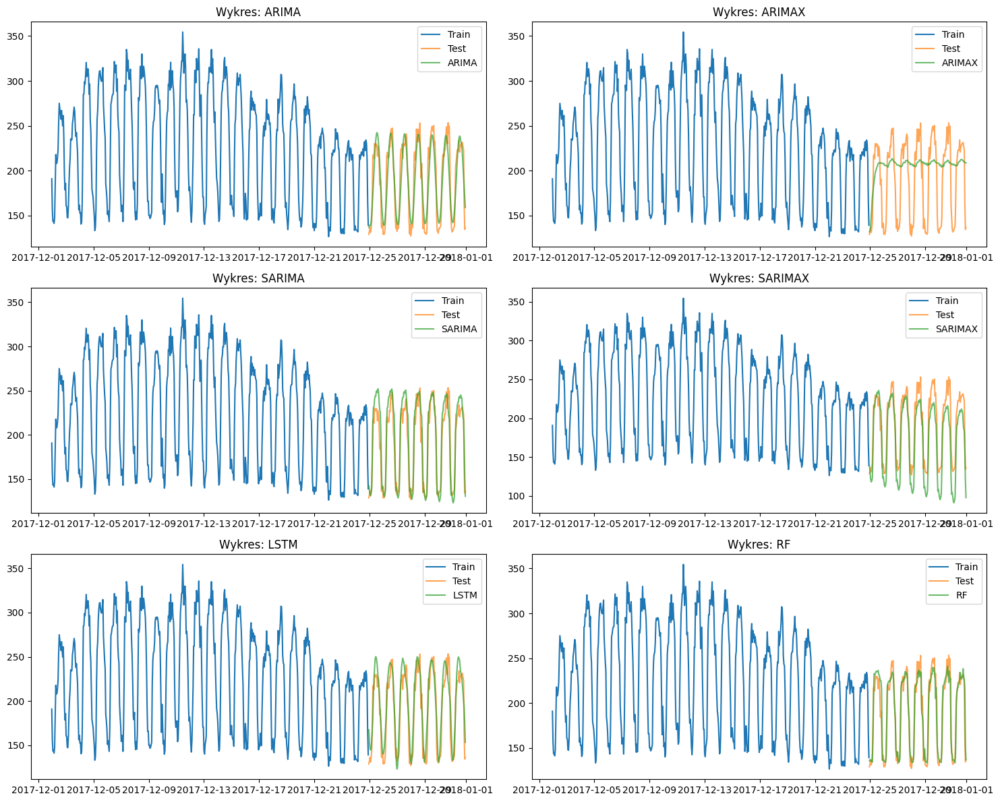


Metryki efektywności:
                    RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                       
Random Forest  11.444418   8.019263  0.042615       0.019442        0.754969
SARIMA         14.336179  11.249448  0.058616      64.117362       10.098140
LSTM           16.838304  13.685729  0.077198      76.645293        0.319879
ARIMA          17.544192  13.980997  0.075876      20.463660        0.819396
SARIMAX        23.722654  20.244622  0.114797      80.686457       29.305698
ARIMAX         43.321426  35.354315  0.222228      25.082884        0.506619


====== Processing Building Eagle_health_Reuben ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption     lag_1     lag_2     lag_3  \
timestamp                                                               
2017-11-28 21:00:00   

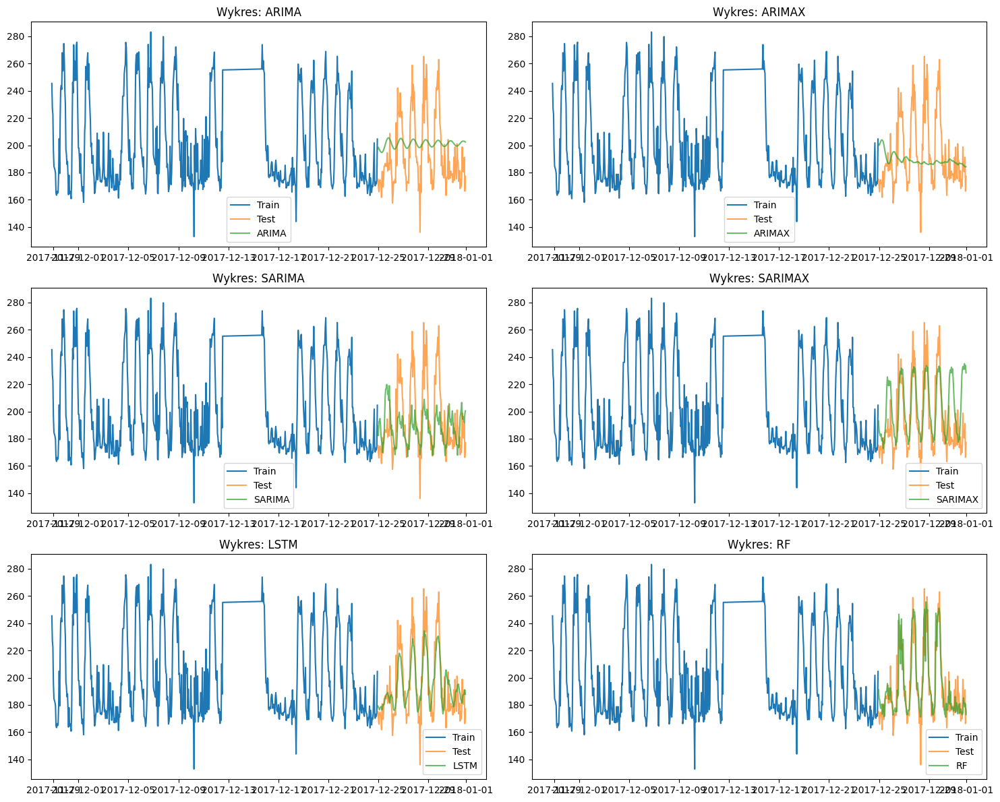


Metryki efektywności:
                    RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                       
Random Forest  13.011900   9.443427  0.047445       0.014843        0.951545
LSTM           15.464976  12.043449  0.062076       0.541978        0.317533
SARIMAX        22.931175  17.489124  0.092681      87.983509       31.725142
SARIMA         24.464953  18.372022  0.089181      66.937597       25.191337
ARIMA          25.375247  22.459771  0.116579      23.596397        0.686714
ARIMAX         27.828206  21.237558  0.103941      26.956812        0.660175


====== Processing Building Fox_assembly_Christie ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-12-02

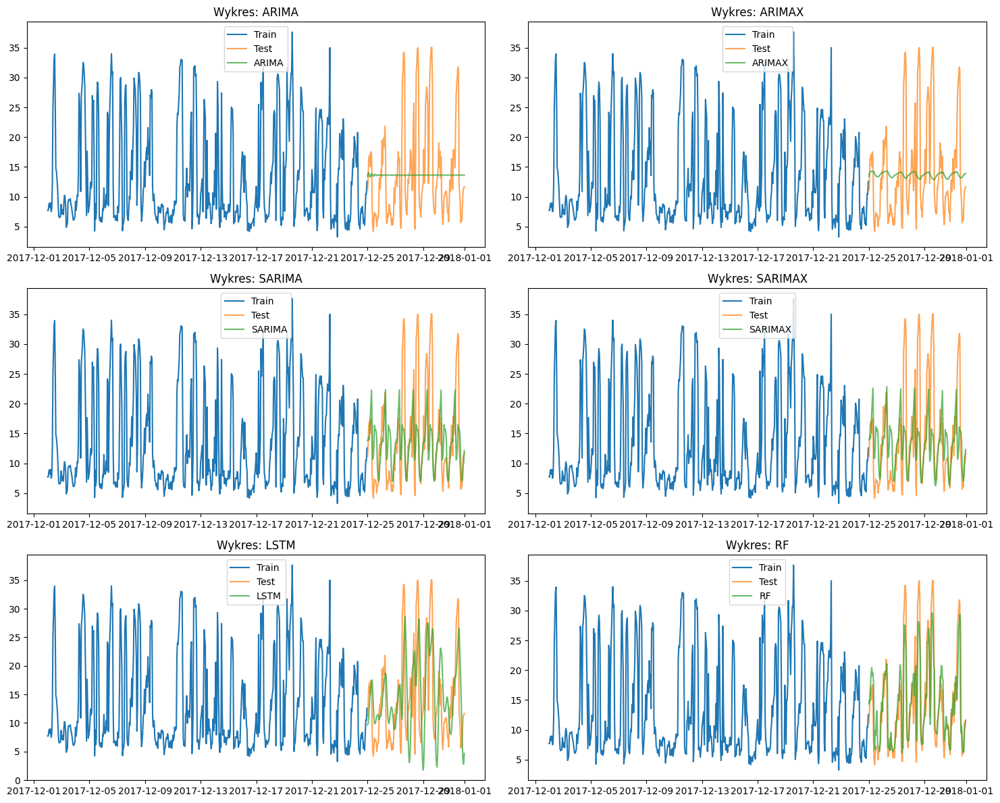


Metryki efektywności:
                   RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
Random Forest  4.464836  3.215007  0.258554       0.015595        0.882152
SARIMA         7.278682  5.062996  0.378483      86.815662       10.915736
SARIMAX        7.405720  5.118689  0.380620     101.314464        8.548904
LSTM           7.774502  6.363498  0.612280       0.533985        0.315273
ARIMA          8.249188  6.259353  0.525131      10.516620        0.409632
ARIMAX         8.267743  6.161332  0.516945      11.852692        0.423547


====== Processing Building Fox_parking_Lynelle ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-12-02 00:00:00         

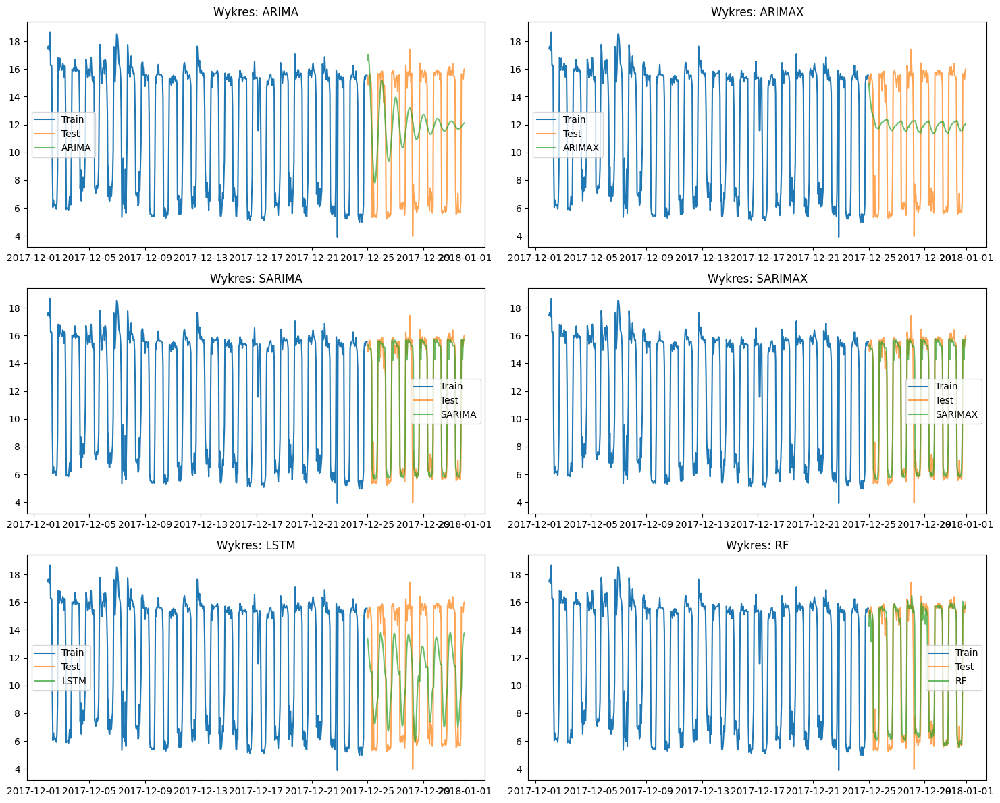


Metryki efektywności:
                   RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
SARIMAX        1.261169  0.631525  0.081779      58.680057        6.450932
SARIMA         1.262487  0.630913  0.081648      46.581494        6.214488
Random Forest  1.460915  0.748353  0.094382       0.011214        0.927131
LSTM           3.197150  2.891727  0.302789       0.512203        0.314248
ARIMA          3.962976  3.655189  0.453093      24.732140        0.583148
ARIMAX         4.611470  4.362422  0.542582      26.422907        0.308624


====== Processing Building Hog_office_Alexis ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption   lag_1   lag_2   lag_3   lag_4  \
timestamp                                                                 
2017-12-02 00:00:00              16.

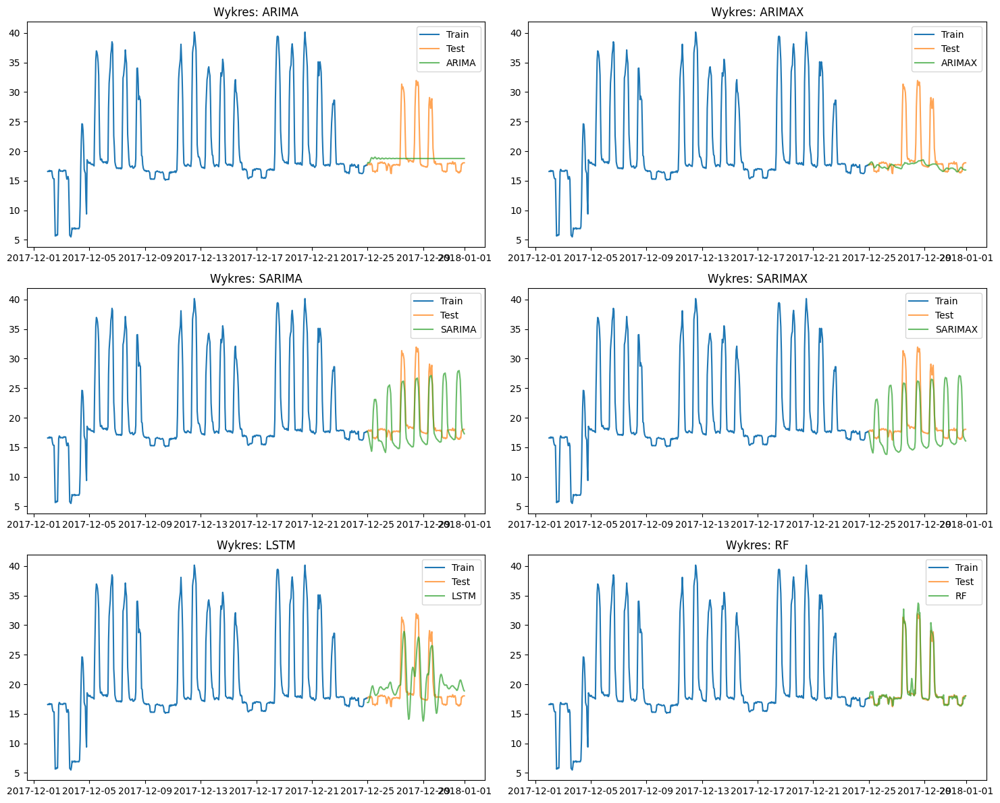


Metryki efektywności:
                   RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
Random Forest  0.884076  0.509367  0.024229       0.016047        0.901961
LSTM           2.928068  2.460186  0.127050       0.512023        0.330184
ARIMA          4.114041  2.453184  0.107400      19.194144        0.697846
ARIMAX         4.289312  2.151119  0.086368      21.436578        0.798176
SARIMA         4.364051  3.326179  0.181425      69.074963       43.226091
SARIMAX        4.441207  3.724567  0.201704      92.513652       39.533492


====== Processing Building Hog_office_Guadalupe ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-12-02 00:00:00        

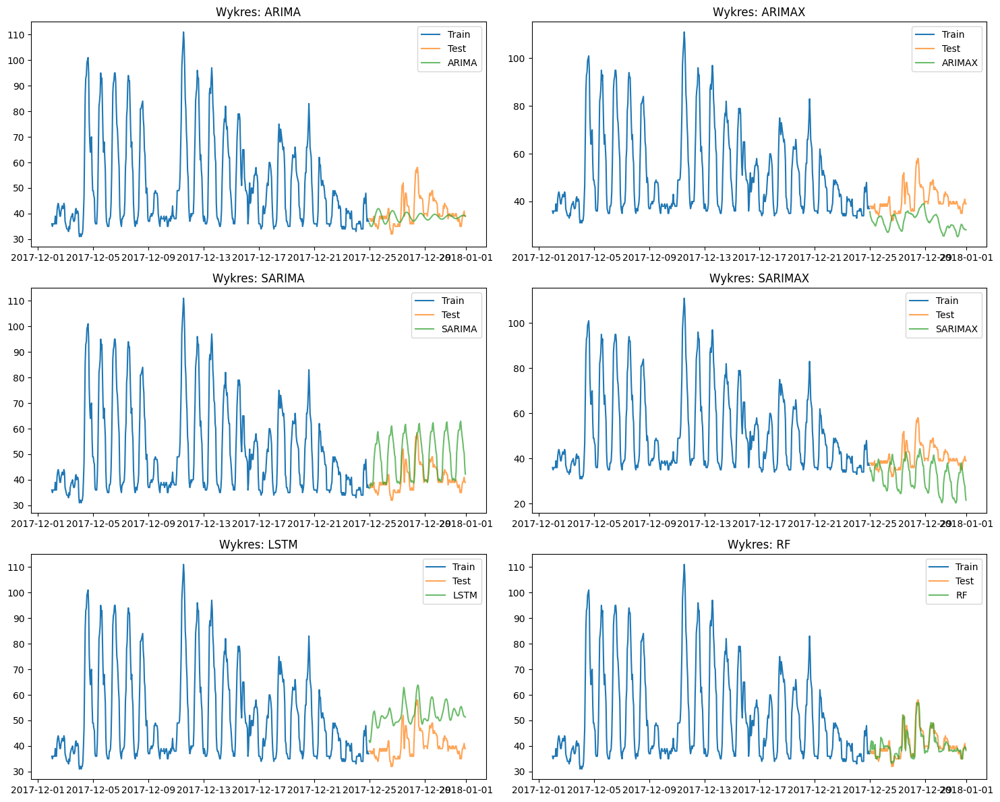


Metryki efektywności:
                    RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                       
Random Forest   2.383111   1.842381  0.045325       0.018912        0.534072
ARIMA           5.639042   4.023737  0.093612      17.224838        0.541972
ARIMAX         10.370139   9.045928  0.214539      23.172415        0.937186
SARIMAX        10.384547   9.045020  0.221168      50.722636       16.617878
SARIMA         11.807942   8.911407  0.228875      35.555235        9.715102
LSTM           12.534689  11.878717  0.304500       0.545701        0.344019


====== Processing Building Hog_office_Leanne ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption    lag_1    lag_2    lag_3    lag_4  \
timestamp                                                                     
2017-12-02 0

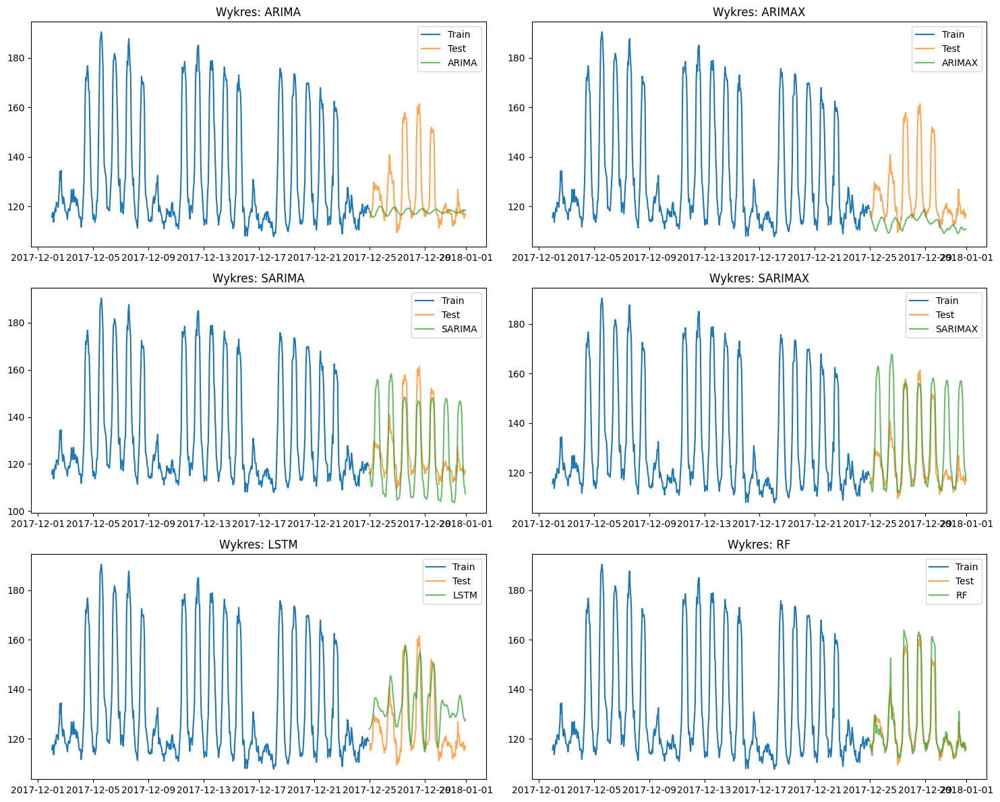


Metryki efektywności:
                    RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                       
Random Forest   4.610469   3.037036  0.023060       0.023468        0.794553
LSTM           11.732517  10.374013  0.085597       0.534417        0.341479
SARIMA         12.760085  10.340587  0.083185      73.240242       35.292880
ARIMA          14.849074   8.917259  0.063695      17.242864        0.661108
SARIMAX        15.238813   9.488796  0.076290      86.277919       35.437155
ARIMAX         17.534448  12.158123  0.089008      22.609933        0.713904


====== Processing Building Hog_office_Leon ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-12-02 00:00

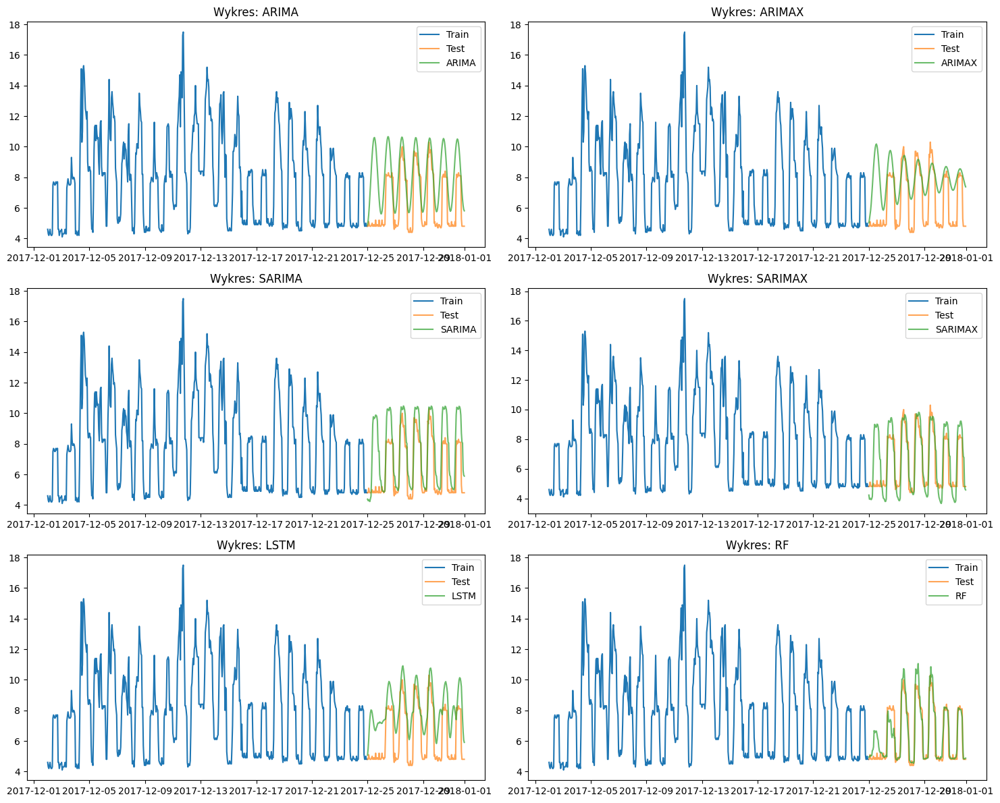


Metryki efektywności:
                   RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
Random Forest  0.760958  0.523274  0.081952       0.015215        0.618816
SARIMAX        1.321052  0.977526  0.172170      88.817251       12.122711
SARIMA         1.830964  1.355556  0.230718      78.581701       51.279260
LSTM           1.967287  1.728379  0.321598       0.544096        0.343513
ARIMAX         2.082089  1.674439  0.323900      17.006740        0.787580
ARIMA          2.226000  1.808456  0.330315      17.931690        0.997051


====== Processing Building Hog_office_Mari ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption   lag_1   lag_2   lag_3   lag_4  \
timestamp                                                                 
2017-12-02 00:00:00              28.21

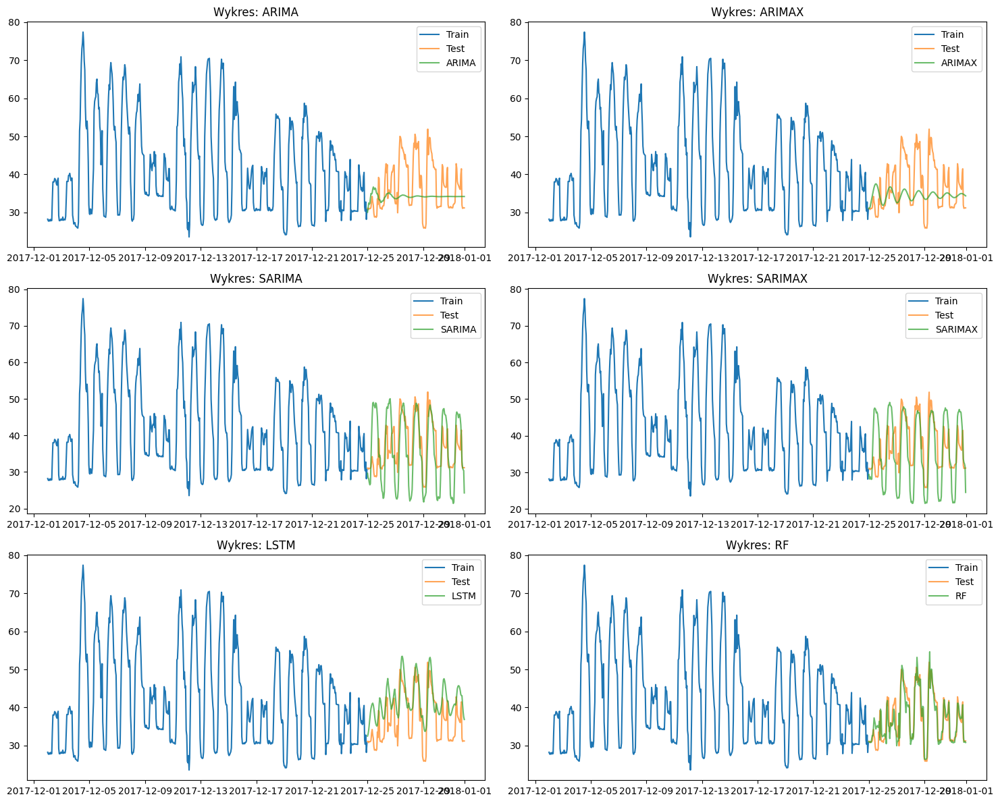


Metryki efektywności:
                   RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
Random Forest  2.930650  2.086754  0.056702       0.015630        0.782082
LSTM           6.384704  5.491965  0.162171       0.540001        0.345874
ARIMAX         6.756876  5.303423  0.134172      23.374579        0.943905
ARIMA          7.150299  5.659459  0.142850      19.389864        0.729941
SARIMA         7.721008  6.281395  0.180400      84.070623       55.505448
SARIMAX        7.751718  6.473669  0.185067     109.829601       51.067893


====== Processing Building Peacock_education_Yolanda ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption    lag_1    lag_2    lag_3    lag_4  \
timestamp                                                                     
2017-12-01 23:00:00 

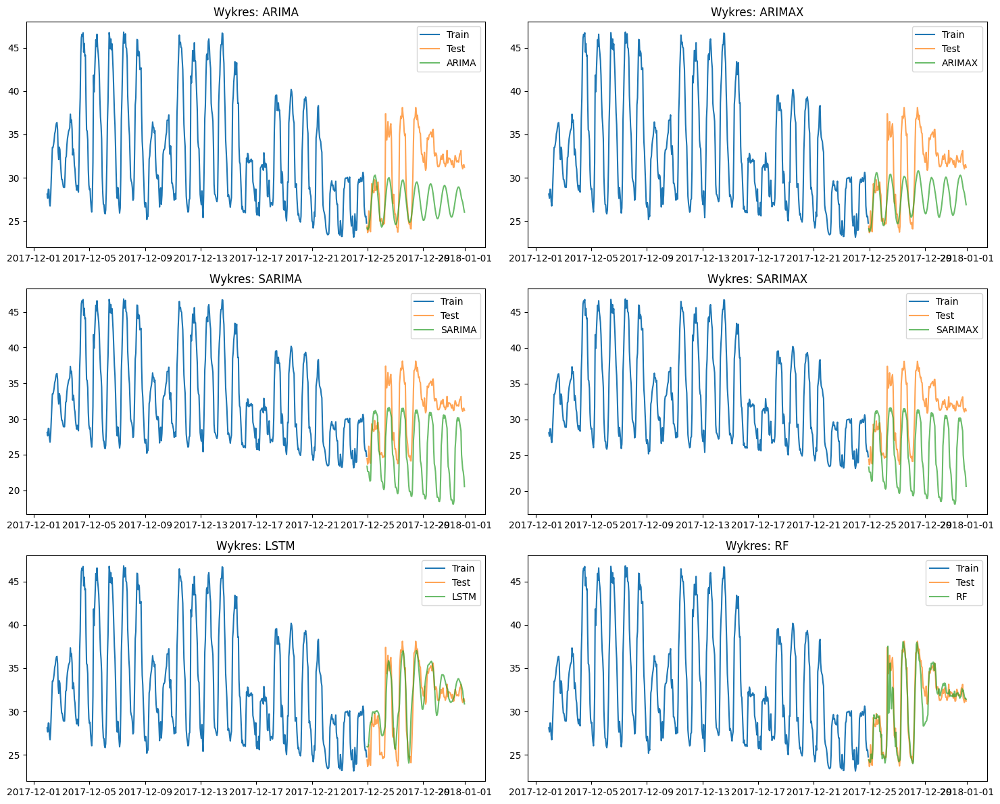


Metryki efektywności:
                   RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
Random Forest  1.665322  1.078164  0.033645       0.017449        0.779400
LSTM           1.995855  1.518838  0.051815       0.599218        0.371255
ARIMAX         4.447183  3.728929  0.112696      21.610517        0.938177
ARIMA          4.991213  4.218441  0.127225      18.520402        0.673388
SARIMAX        6.911948  5.917279  0.187277    3842.701396       41.930899
SARIMA         6.970905  5.967198  0.188959      58.777210       41.523654


====== Processing Building Peacock_office_Julian ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption    lag_1    lag_2    lag_3    lag_4  \
timestamp                                                                     
2017-12-01 23:00:00     

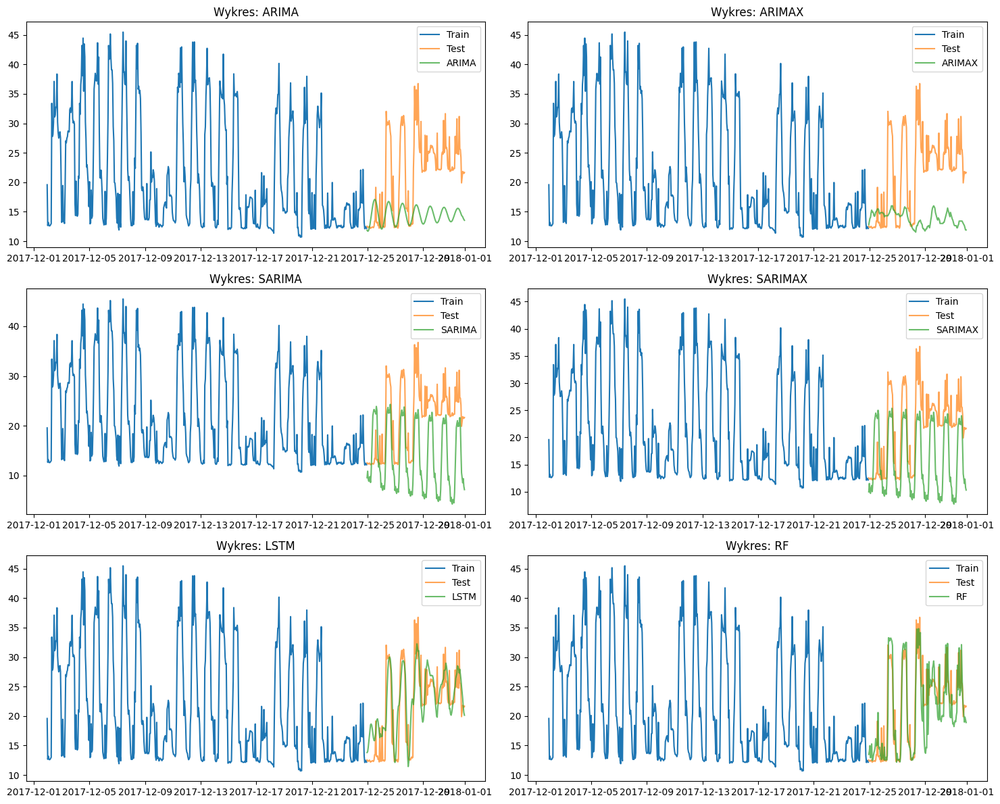


Metryki efektywności:
                    RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                      
Random Forest   3.784805  2.842922  0.127641       0.017583        0.846135
LSTM            4.075282  3.186818  0.179873       0.601460        0.369934
SARIMAX         8.351648  6.960542  0.325066      68.838203       25.076032
ARIMA           9.286660  7.727544  0.312791      19.889400        0.838824
ARIMAX         10.241785  8.565870  0.350000      23.384406        0.554269
SARIMA         10.245383  8.919040  0.419890      57.019419       37.295854


====== Processing Building Rat_assembly_Deandre ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-12-01 23:00:00

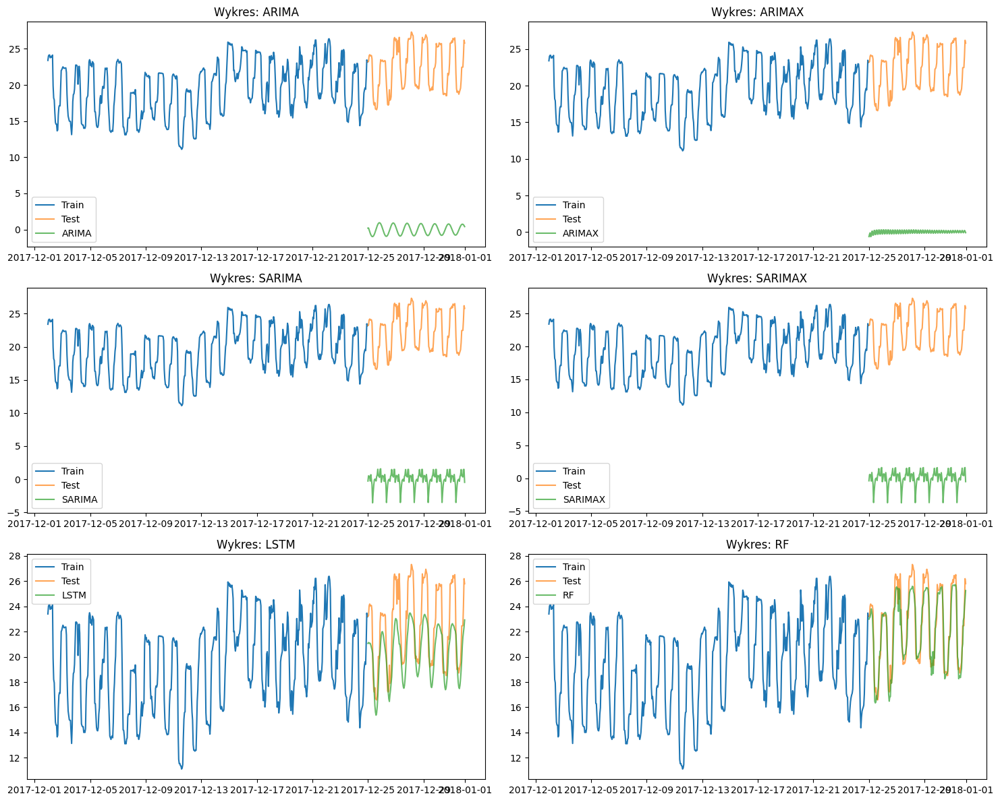


Metryki efektywności:
                    RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                       
Random Forest   0.977934   0.760268  0.033348       0.018561        0.757891
LSTM            2.486107   2.155097  0.091403       0.599842        0.361900
SARIMAX        22.610813  22.402562  0.999789     109.677759       17.804444
ARIMAX         22.618243  22.408471  0.998817      27.317958        1.050069
SARIMA         22.638792  22.432978  1.001186     107.547961        5.789737
ARIMA          22.667172  22.452396  1.000984      24.522770        0.795545


====== Processing Building Rat_education_Esther ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-12-01 

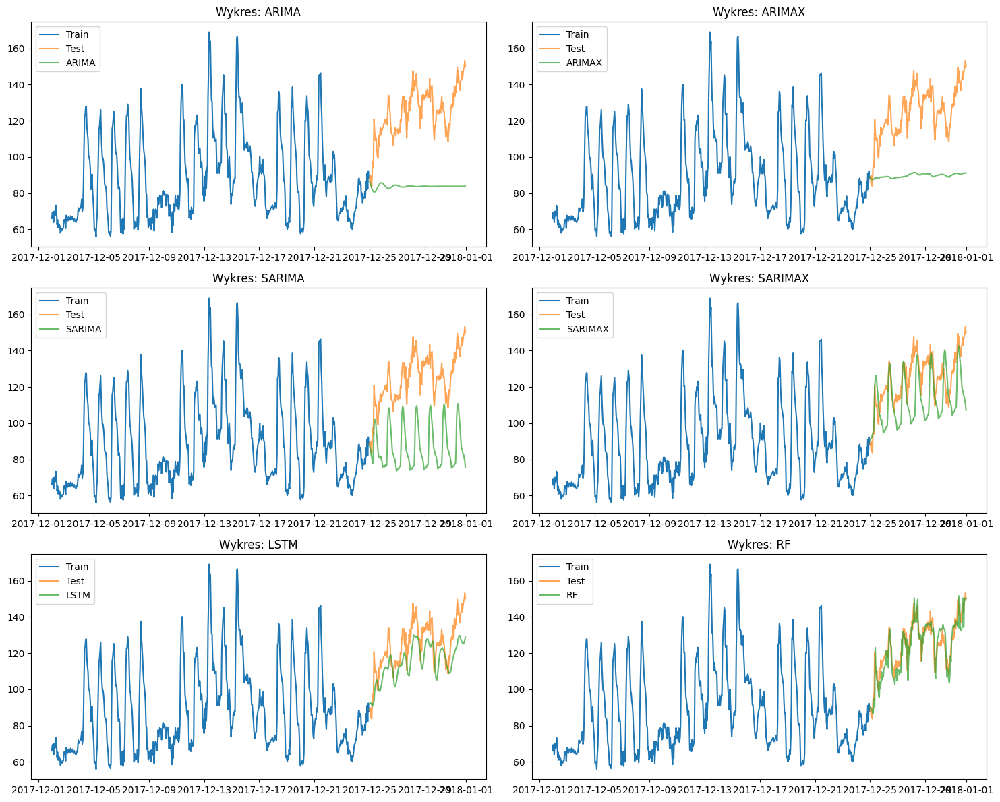


Metryki efektywności:
                    RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                       
Random Forest   7.065599   5.617240  0.045322       0.018018        0.806215
LSTM           12.098411  10.310849  0.080338       0.605641        0.365284
SARIMAX        18.411092  14.838877  0.116238      86.451903       19.715893
ARIMAX         37.138902  34.890918  0.271715       7.527252        0.167196
SARIMA         40.963500  37.674969  0.295283      67.468141       24.389522
ARIMA          43.080360  40.809957  0.318781       5.162121        0.480296


====== Processing Building Rat_public_Angelina ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-12-01 2

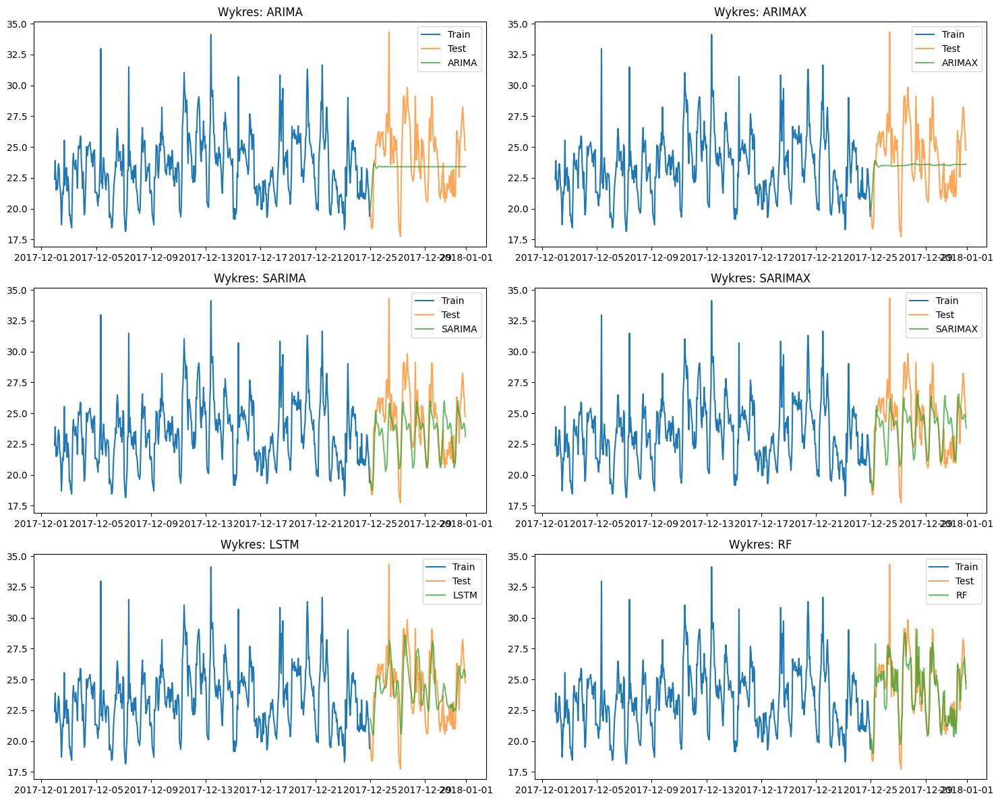


Metryki efektywności:
                   RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
Random Forest  1.504348  1.085646  0.044171       0.016543        0.801772
LSTM           2.055349  1.666163  0.070221       0.612771        0.380104
SARIMAX        2.236544  1.681925  0.068138      82.556663        5.828514
SARIMA         2.418633  1.862881  0.074441      75.672776        9.386209
ARIMAX         2.744367  2.244144  0.091666       9.361759        0.420119
ARIMA          2.785161  2.271367  0.092327       9.383563        0.726420


====== Processing Building Rat_public_Clyde ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-12-01 18:00:00            

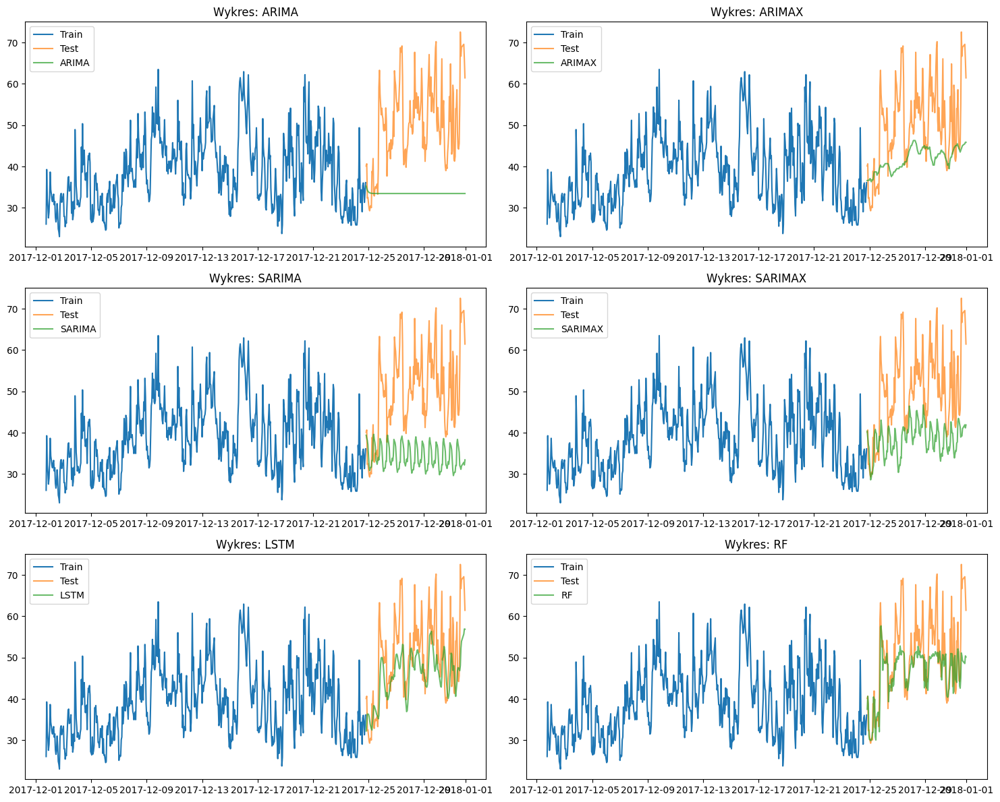


Metryki efektywności:
                    RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                       
Random Forest   7.449562   5.342324  0.097841       0.017039        0.814874
LSTM            8.569408   6.569071  0.123748       0.618743        0.365056
ARIMAX         12.092458   9.596529  0.175778       1.655835        0.141194
SARIMAX        14.920640  12.338506  0.226062      58.767996        8.471035
SARIMA         18.739868  16.345189  0.303562      40.422824        1.906871
ARIMA          19.228283  16.897714  0.313295       1.072846        0.082241


====== Processing Building Rat_public_Leo ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-12-01 23:00:

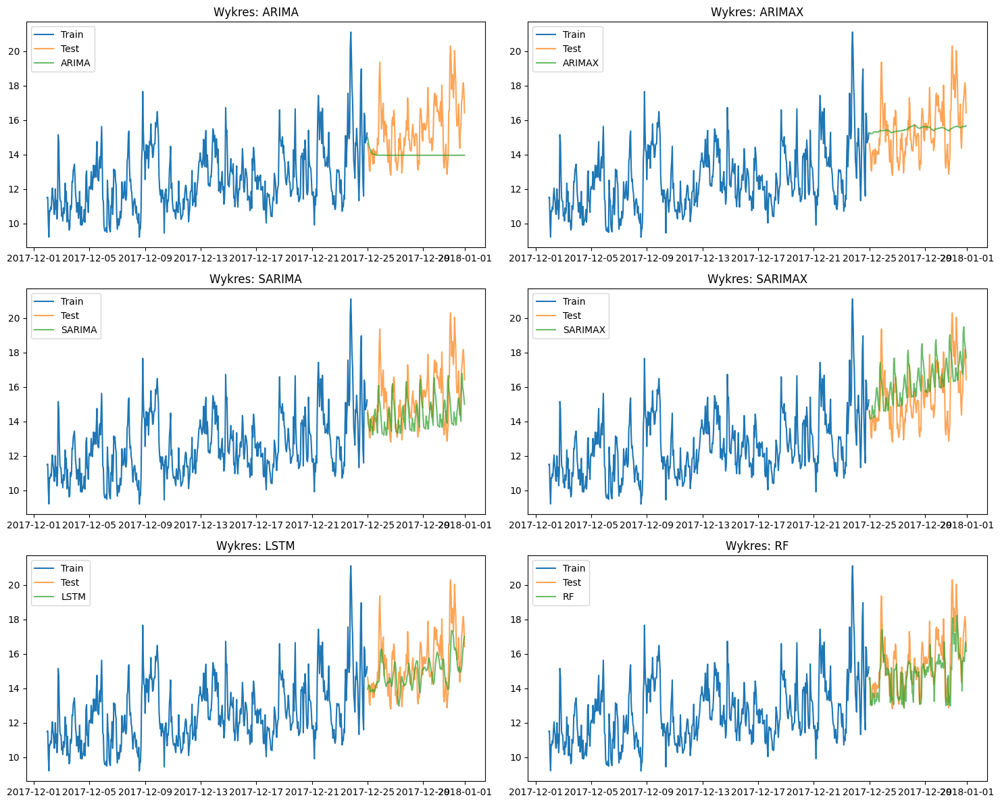


Metryki efektywności:
                   RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
Random Forest  1.174478  0.878290  0.054766       0.018680        0.795198
LSTM           1.375992  1.047488  0.065471       0.609307        0.372788
ARIMAX         1.548521  1.249677  0.080639       1.460996        0.048053
SARIMAX        1.783489  1.452828  0.096721     116.497055        1.242714
SARIMA         1.911339  1.431231  0.087954     104.661248        4.603994
ARIMA          2.184825  1.687538  0.102188       1.486347        0.124243


====== Processing Building Rat_public_Shanta ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-12-01 23:00:00           

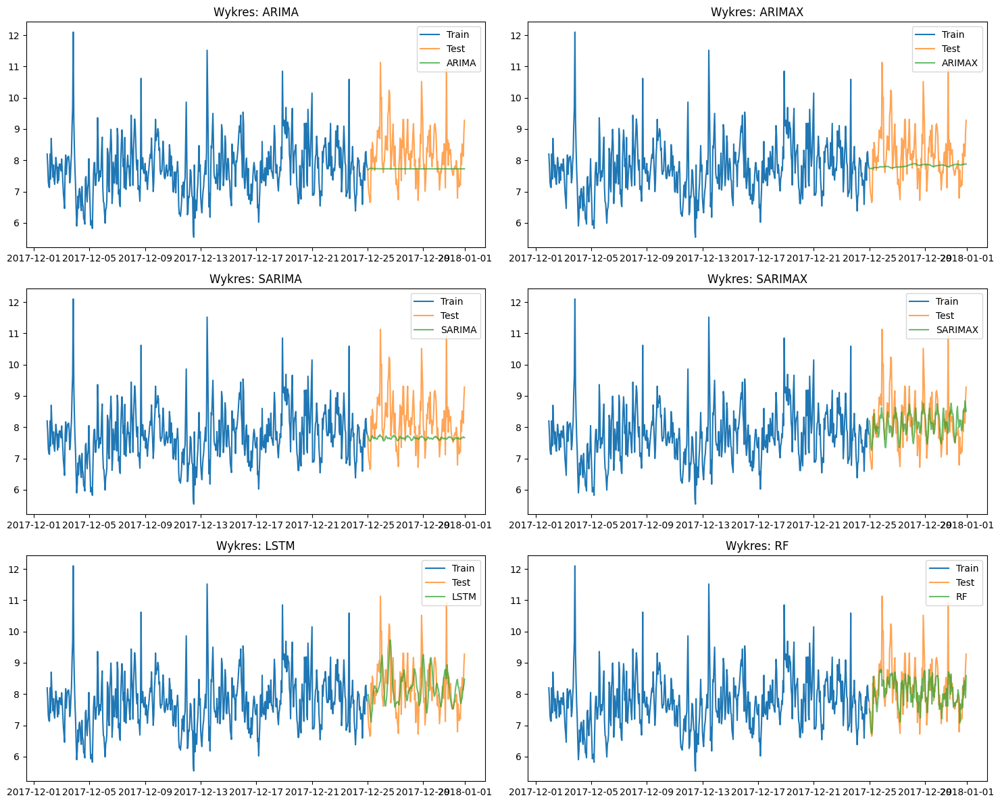


Metryki efektywności:
                   RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
Random Forest  0.643228  0.457489  0.053810       0.018046        0.827889
SARIMAX        0.716986  0.521915  0.061961      36.981345        1.027507
LSTM           0.768821  0.603025  0.073320       0.619189        0.371843
ARIMAX         0.874777  0.640896  0.074602       8.151716        0.158971
ARIMA          0.916687  0.675779  0.078230       8.633415        0.458109
SARIMA         0.944027  0.705624  0.081378      24.919453        3.086573


====== Processing Building Rat_public_Tamra ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-12-01 23:00:00            

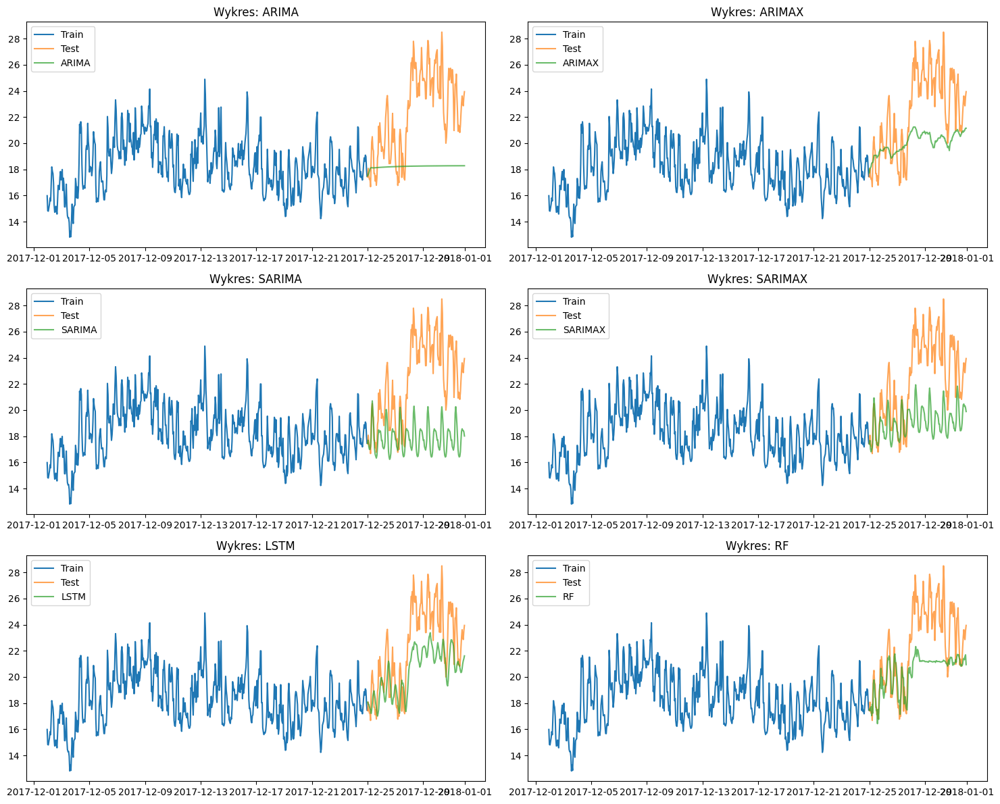


Metryki efektywności:
                   RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
LSTM           2.796096  2.304973  0.097833       0.587980        0.359253
Random Forest  2.872346  2.236446  0.092517       0.019010        0.793478
ARIMAX         3.423351  2.784779  0.116949      11.444411        0.845946
SARIMAX        4.094547  3.343764  0.138939      69.789732       33.217287
ARIMA          5.085183  4.270153  0.177854      13.956786        0.790436
SARIMA         5.270214  4.460500  0.186813      52.977535       39.286183


====== Processing Building Wolf_education_Tori ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption     lag_1     lag_2     lag_3  \
timestamp                                                               
2017-12-02 00:00:00            281.430

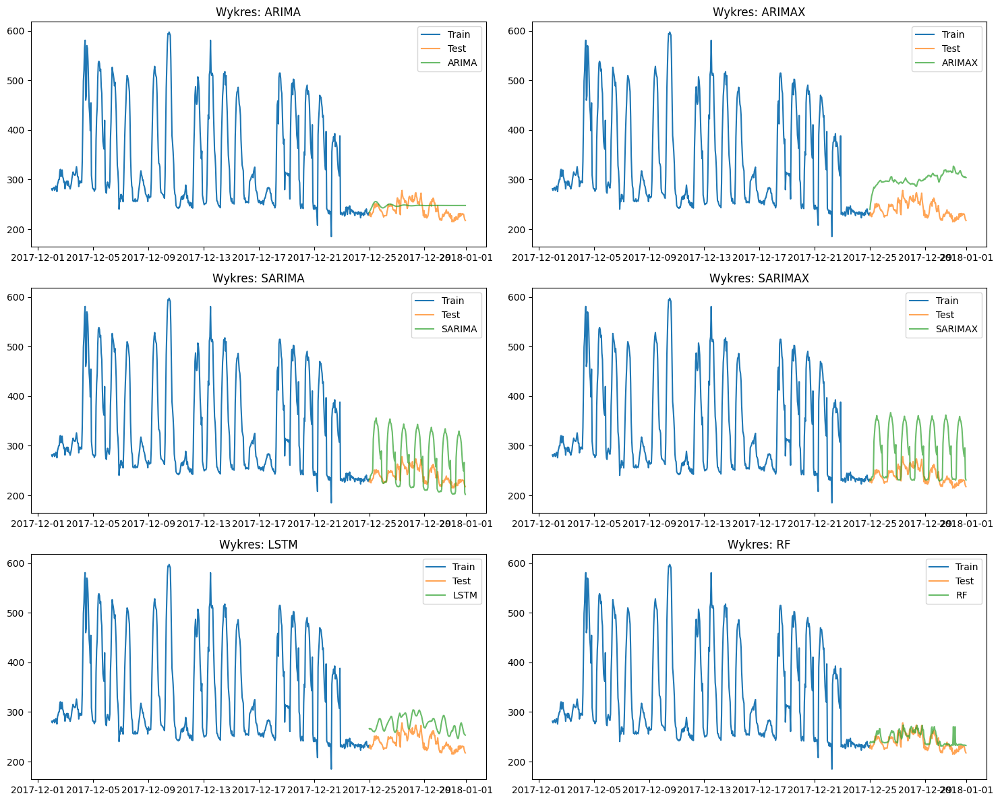


Metryki efektywności:
                    RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                       
Random Forest  11.787602   9.297016  0.039243       0.017835        0.822835
ARIMA          16.285547  14.086065  0.059875      20.010643        0.755585
LSTM           37.447238  35.317688  0.148817       0.576265        0.355490
SARIMA         56.736484  47.023476  0.193429      59.654071       44.592353
ARIMAX         64.027979  59.946130  0.255004      26.271063        0.730039
SARIMAX        69.685192  56.953702  0.234887      93.846673       34.133250


====== Processing Building Wolf_retail_Toshia ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption    lag_1    lag_2    lag_3    lag_4  \
timestamp                                                                     
2017-12-02 

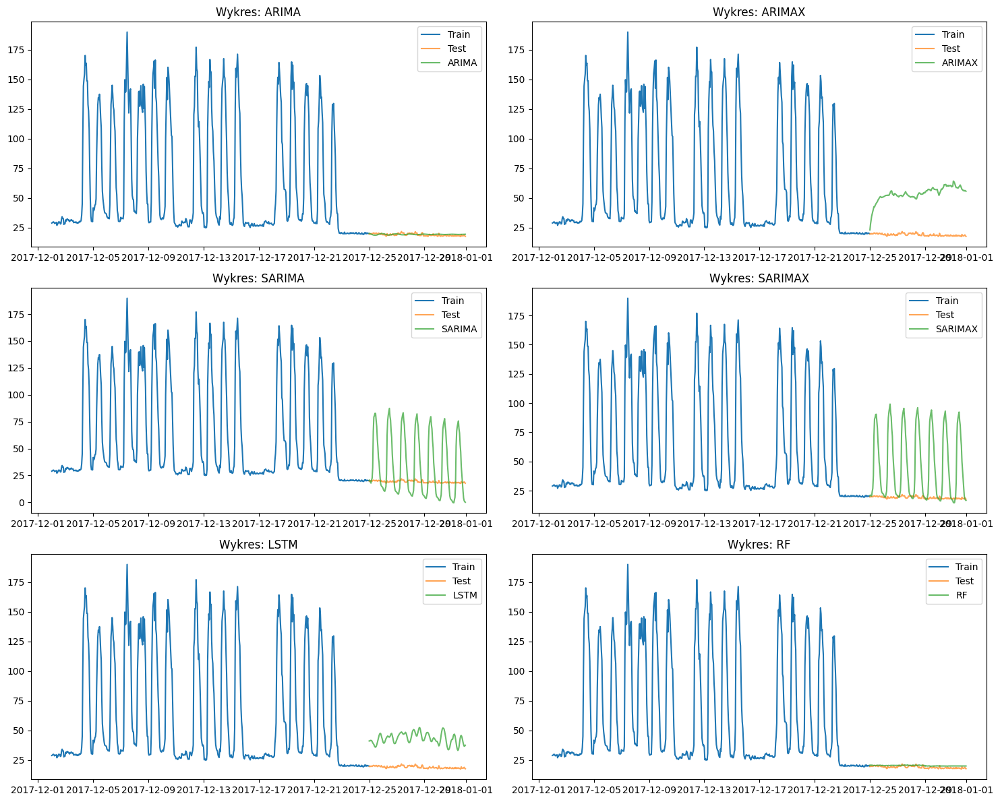


Metryki efektywności:
                    RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                       
ARIMA           1.054229   0.924513  0.048548      10.377616        0.651908
Random Forest   1.479621   1.292793  0.069341       0.015554        0.851115
LSTM           24.534199  24.138954  1.264348       0.612632        0.362543
SARIMA         32.575124  25.236204  1.313897      47.399845       39.266460
ARIMAX         35.186194  34.569401  1.820008      11.882831        0.729981
SARIMAX        40.350909  28.796341  1.499431      80.101200       31.616371


In [14]:

import warnings
warnings.filterwarnings('ignore')
warnings.filterwarnings("ignore", category=UserWarning)

sorted_buildings = sorted(df_final['building_id'].unique())
selected_buildings = sorted_buildings[:20]

all_results = []
all_metrics = []

for i in selected_buildings:
    print(f"\n\n====== Processing Building {i} ======")

    data = df_final[df_final['building_id'] == i].copy()
    data['timestamp'] = pd.to_datetime(data['timestamp'])
    data = data.set_index('timestamp').sort_index()
    data = data.asfreq('h')
    data['energy_consumption'] = data['energy_consumption'].interpolate()

    adf_result = adfuller(data['energy_consumption'].dropna())
    if adf_result[1] > 0.05:
        data['energy_diff'] = data['energy_consumption'].diff().dropna()
        adf_diff = adfuller(data['energy_diff'].dropna())
    else:
        data['energy_diff'] = data['energy_consumption']

    data = data.dropna(subset=['energy_diff', 'airTemperature'])
    train = data['energy_diff'][-720:-168]
    test = data['energy_diff'][-168:]

    X = data[['airTemperature']]
    exogTrain = X[-720:-168]
    exogTest = X[-168:]

    arimaTimes = dict()
    start = time.time()
    arima_order = find_arima_params(train)
    end = time.time()
    arimaTimes["arimaSearch"] = end - start

    start = time.time()
    seasonal_order = find_optimal_seasonal_params(train, s=24)
    end = time.time()
    arimaTimes["arimaSeasonalSearch"] = end - start

    try:
        # ARIMA
        start = time.time()
        am = ARIMA(train, order=arima_order,
                    enforce_stationarity=False,
                    enforce_invertibility=False)
        arima_model = am.fit()
        forecast_arima = arima_model.get_forecast(steps=len(test))
        forecast_arima_values = forecast_arima.predicted_mean
        end = time.time()
        arimaTimes["ARIMA"] = end - start

    except Exception as e:
        print("Błąd ARIMA:", e)
        forecast_arima_values = pd.Series([np.nan] * len(test), index=test.index)
        arimaTimes["ARIMA"] = 0

    try:
        # SARIMA
        start = time.time()
        sm = SARIMAX(train, order=arima_order, seasonal_order=seasonal_order, enforce_stationarity=False, enforce_invertibility=False)
        sarima_model = sm.fit(disp=False)
        forecast_sarima = sarima_model.get_forecast(steps=len(test))
        forecast_sarima_values = forecast_sarima.predicted_mean
        end = time.time()
        arimaTimes["SARIMA"] = end - start

    except Exception as e:
        print("Błąd SARIMA:", e)
        forecast_sarima_values = pd.Series([np.nan] * len(test), index=test.index)
        arimaTimes["SARIMA"] = 0
        
    start = time.time()
    arima_order = find_arima_params(train, trainExog=exogTrain)
    end = time.time()
    arimaTimes["arimaxSearch"] = end - start

    start = time.time()
    seasonal_order = find_optimal_seasonal_params(train, trainExog=exogTrain, s=24)
    end = time.time()
    arimaTimes["arimaxSeasonalSearch"] = end - start


    try:
        # ARIMAX
        start = time.time()
        axm = ARIMA(train, exog=exogTrain, order=arima_order, enforce_stationarity=False, enforce_invertibility=False)
        arimax_model = axm.fit()
        forecast_arimax = arimax_model.get_forecast(steps=len(test), exog=exogTest)
        forecast_arimax_values = forecast_arimax.predicted_mean
        end = time.time()
        arimaTimes["ARIMAX"] = end - start

    except Exception as e:
        print("Błąd ARIMAX:", e)
        forecast_arimax_values = pd.Series([np.nan] * len(test), index=test.index)
        arimaTimes["ARIMAX"] = 0

    try:
        # SARIMAX
        start = time.time()
        sxm = SARIMAX(train, exog=exogTrain, order=arima_order,
                                seasonal_order=seasonal_order, enforce_stationarity=False, enforce_invertibility=False)
        sarimax_model = sxm.fit()
        forecast_sarimax = sarimax_model.get_forecast(steps=len(test), exog=exogTest)
        forecast_sarimax_values = forecast_sarimax.predicted_mean
        end = time.time()
        arimaTimes["SARIMAX"] = end - start

    except Exception as e:
        print("Błąd SARIMAX:", e)
        forecast_sarimax_values = pd.Series([np.nan] * len(test), index=test.index)
        arimaTimes["SARIMAX"] = 0


    data = data.dropna(subset=['energy_consumption', 'airTemperature'])

    train = data['energy_consumption'][-720:-168]
    test = data['energy_consumption'][-168:]

    features = ['energy_consumption', 'airTemperature', 'sqm']
    target = 'energy_consumption'
    data = data[features].dropna()


    train_lstm = data.iloc[-720:-168]
    test_lstm = data.iloc[-168:]

    predictions, true_values, lstmTimes = train_and_predict(train_lstm, test_lstm, target)
    print("LSTM DONE")

    rf_model, X_test_rf, y_test_rf, rfTimes = doRandomForest(train, test)
    print("RF DONE")

    results = pd.DataFrame(index=test.index)
    metrics = []

    results['ARIMA'] = list(forecast_arima_values)
    results['ARIMAX'] = list(forecast_arimax_values)
    results['SARIMA'] = list(forecast_sarima_values)
    results['SARIMAX'] = list(forecast_sarimax_values)

    try:
        metrics.append(evaluate_model(test, results['ARIMA'], 'ARIMA', model_time=arimaTimes['ARIMA'], trening_time=arimaTimes['arimaSearch']))
    except Exception as e:
        print("Błąd w evaluate_model ARIMA:", e)

    try:
        metrics.append(evaluate_model(test, results['SARIMA'], 'SARIMA', model_time=arimaTimes['SARIMA'], trening_time=arimaTimes['arimaSeasonalSearch']))
    except Exception as e:
        print("Błąd w evaluate_model SARIMA:", e)

    try:
        metrics.append(evaluate_model(test, results['ARIMAX'], 'ARIMAX', model_time=arimaTimes['ARIMAX'], trening_time=arimaTimes['arimaxSearch']))
    except Exception as e:
        print("Błąd w evaluate_model ARIMAX:", e)

    try:
        metrics.append(evaluate_model(test, results['SARIMAX'], 'SARIMAX', model_time=arimaTimes['SARIMAX'], trening_time=arimaTimes['arimaxSeasonalSearch']))
    except Exception as e:
        print("Błąd w evaluate_model SARIMAX:", e)

    # LSTM
    results['LSTM'] = predictions
    metrics.append(evaluate_model(test, results['LSTM'], 'LSTM', model_time=lstmTimes['LSTMPredict'], trening_time=lstmTimes['LSTMTrain']))

    # Random Forest
    results['RF'] = rf_model.predict(X_test_rf)
    metrics.append(evaluate_model(test, results['RF'], 'Random Forest', trening_time=rfTimes['RFTrain'], model_time=rfTimes['RFModel']))

    fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(15, 12))
    axes = axes.flatten()

    for i, col in enumerate(results.columns[:6]):
        ax = axes[i]
        ax.plot(train, label='Train')
        ax.plot(test, label='Test', alpha=0.7)
        ax.plot(results[col], label=col, alpha=0.7)
        ax.set_title(f'Wykres: {col}')
        ax.legend()

    plt.tight_layout()
    plt.show()

    metrics_df = pd.DataFrame(metrics).set_index('Model')
    print("\nMetryki efektywności:")
    print(metrics_df.sort_values('RMSE'))

    all_results.append(results)
    all_metrics.append(metrics)


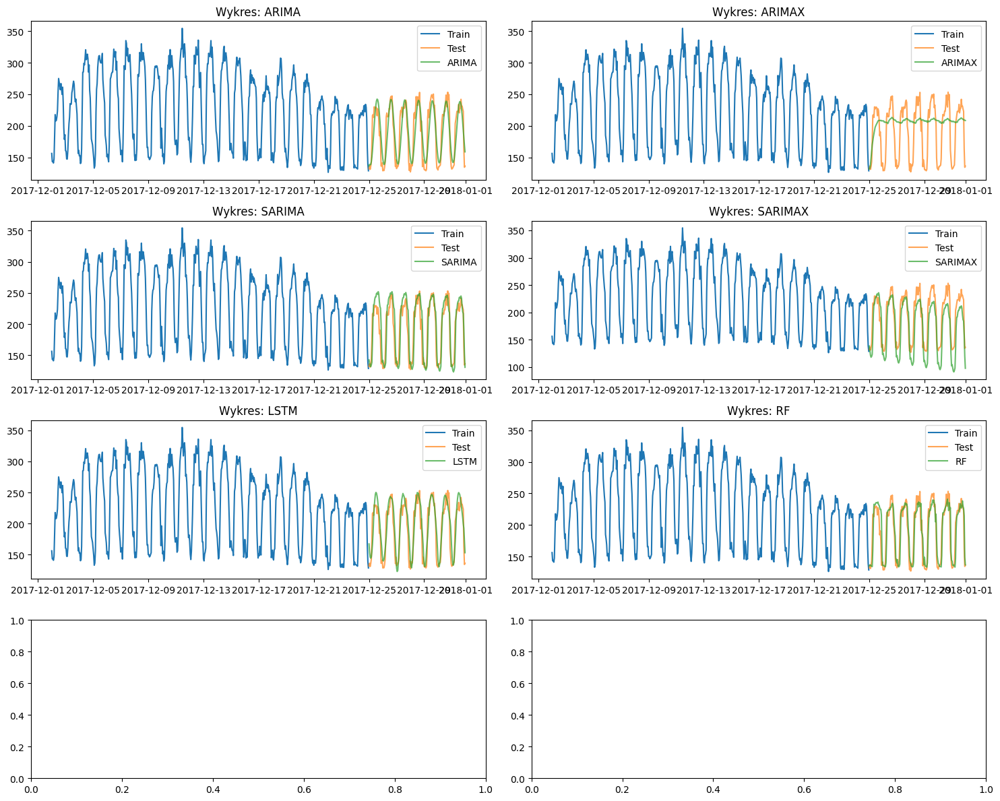


Metryki efektywności:
                    RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                       
Random Forest  11.444418   8.019263  0.042615       0.019442        0.754969
SARIMA         14.336179  11.249448  0.058616      64.117362       10.098140
LSTM           16.838304  13.685729  0.077198      76.645293        0.319879
ARIMA          17.544192  13.980997  0.075876      20.463660        0.819396
SARIMAX        23.722654  20.244622  0.114797      80.686457       29.305698
ARIMAX         43.321426  35.354315  0.222228      25.082884        0.506619


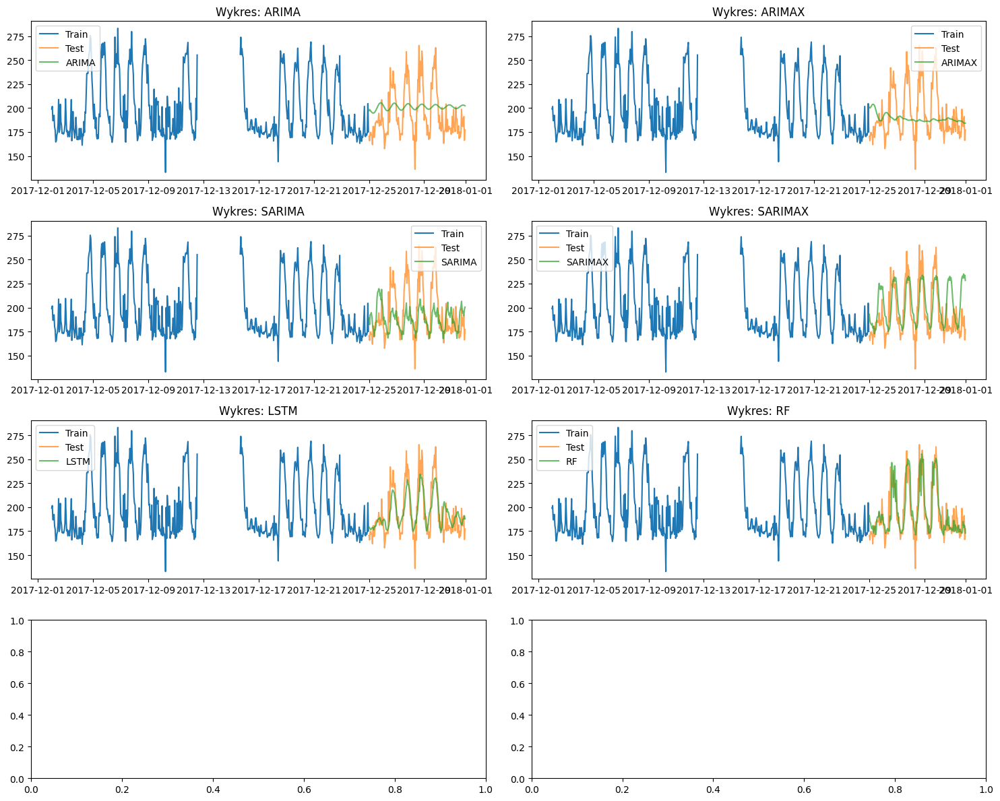


Metryki efektywności:
                    RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                       
Random Forest  13.011900   9.443427  0.047445       0.014843        0.951545
LSTM           15.464976  12.043449  0.062076       0.541978        0.317533
SARIMAX        22.931175  17.489124  0.092681      87.983509       31.725142
SARIMA         24.464953  18.372022  0.089181      66.937597       25.191337
ARIMA          25.375247  22.459771  0.116579      23.596397        0.686714
ARIMAX         27.828206  21.237558  0.103941      26.956812        0.660175


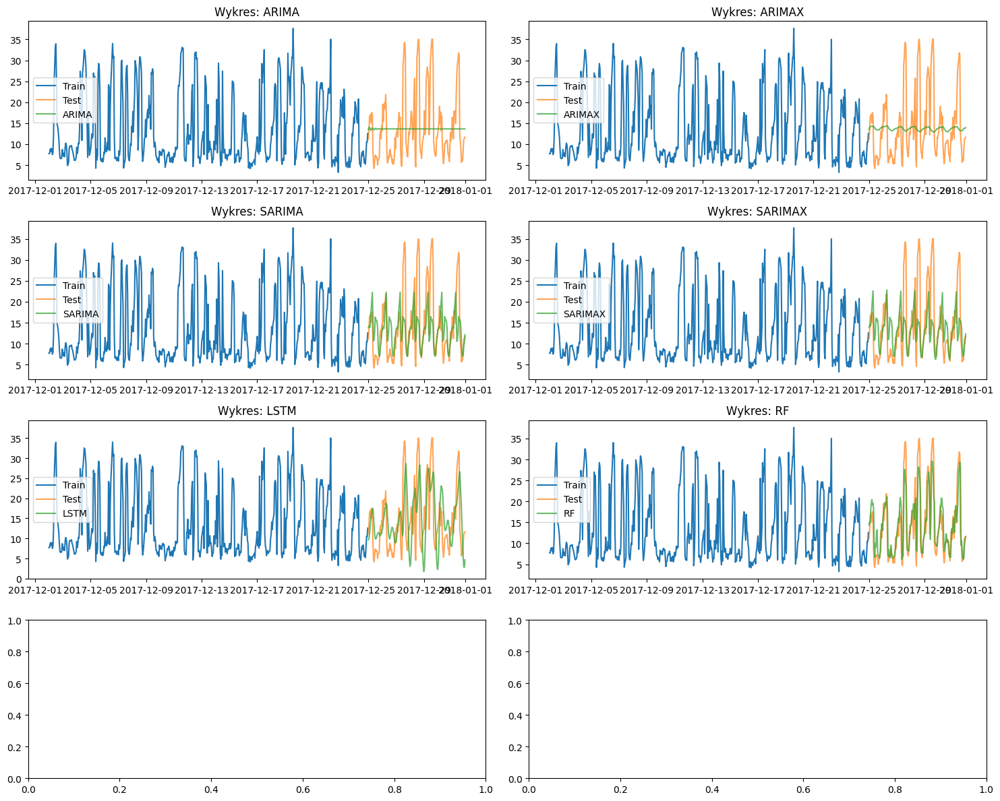


Metryki efektywności:
                   RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
Random Forest  4.464836  3.215007  0.258554       0.015595        0.882152
SARIMA         7.278682  5.062996  0.378483      86.815662       10.915736
SARIMAX        7.405720  5.118689  0.380620     101.314464        8.548904
LSTM           7.774502  6.363498  0.612280       0.533985        0.315273
ARIMA          8.249188  6.259353  0.525131      10.516620        0.409632
ARIMAX         8.267743  6.161332  0.516945      11.852692        0.423547


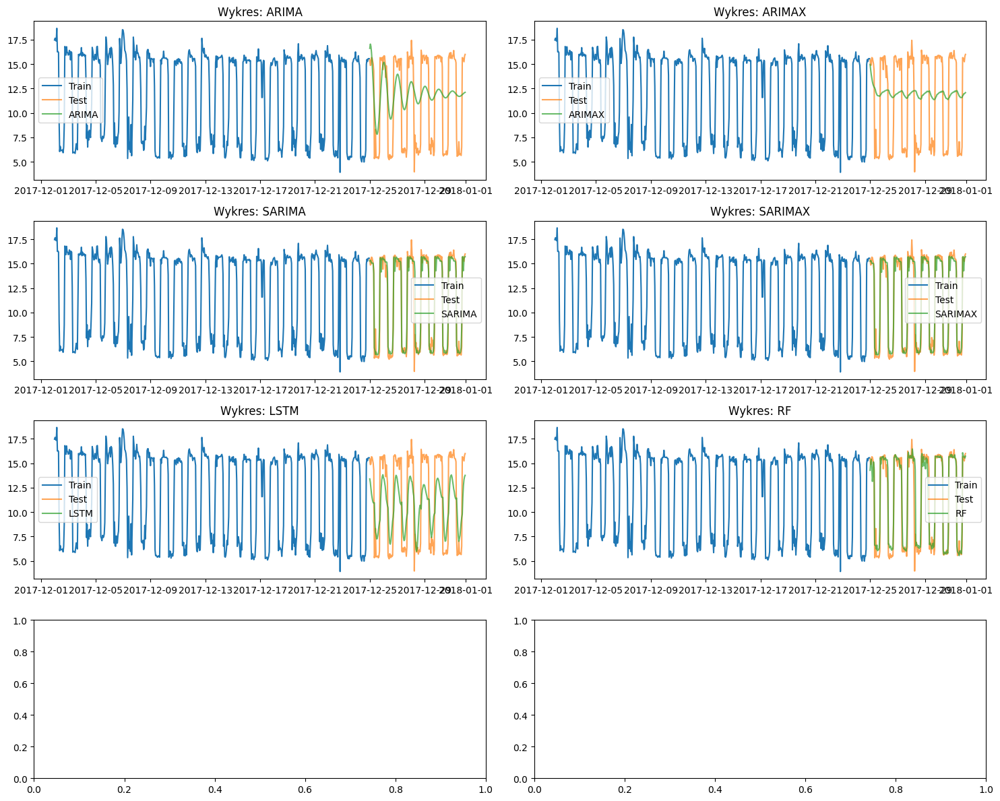


Metryki efektywności:
                   RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
SARIMAX        1.261169  0.631525  0.081779      58.680057        6.450932
SARIMA         1.262487  0.630913  0.081648      46.581494        6.214488
Random Forest  1.460915  0.748353  0.094382       0.011214        0.927131
LSTM           3.197150  2.891727  0.302789       0.512203        0.314248
ARIMA          3.962976  3.655189  0.453093      24.732140        0.583148
ARIMAX         4.611470  4.362422  0.542582      26.422907        0.308624


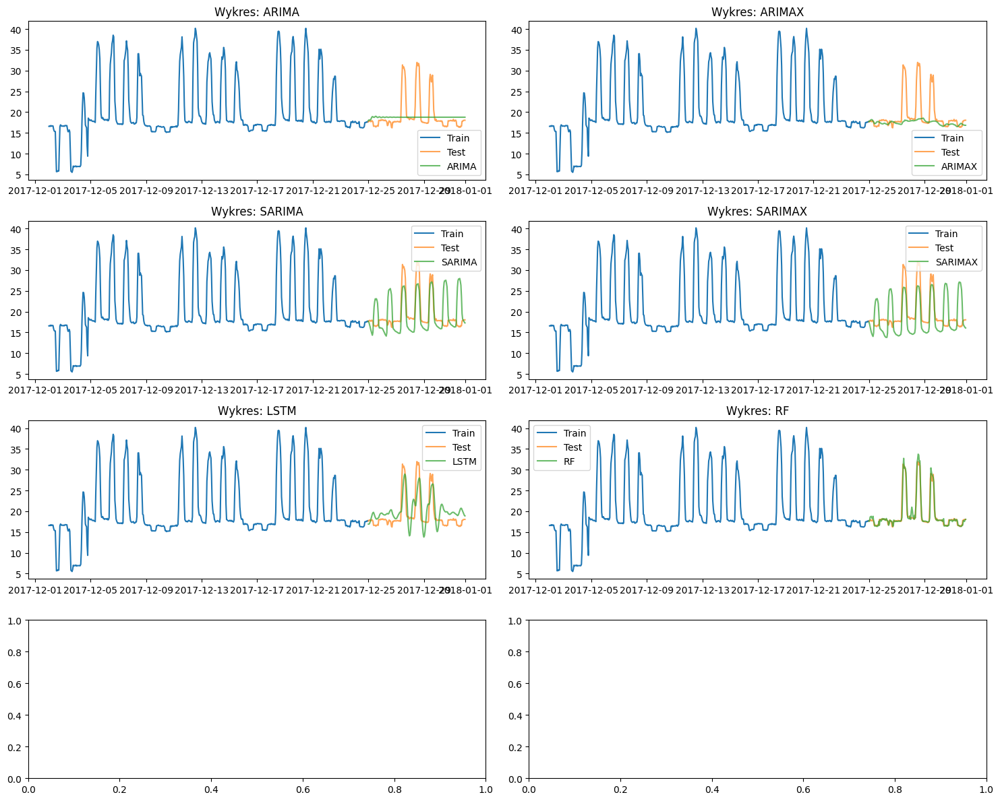


Metryki efektywności:
                   RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
Random Forest  0.884076  0.509367  0.024229       0.016047        0.901961
LSTM           2.928068  2.460186  0.127050       0.512023        0.330184
ARIMA          4.114041  2.453184  0.107400      19.194144        0.697846
ARIMAX         4.289312  2.151119  0.086368      21.436578        0.798176
SARIMA         4.364051  3.326179  0.181425      69.074963       43.226091
SARIMAX        4.441207  3.724567  0.201704      92.513652       39.533492


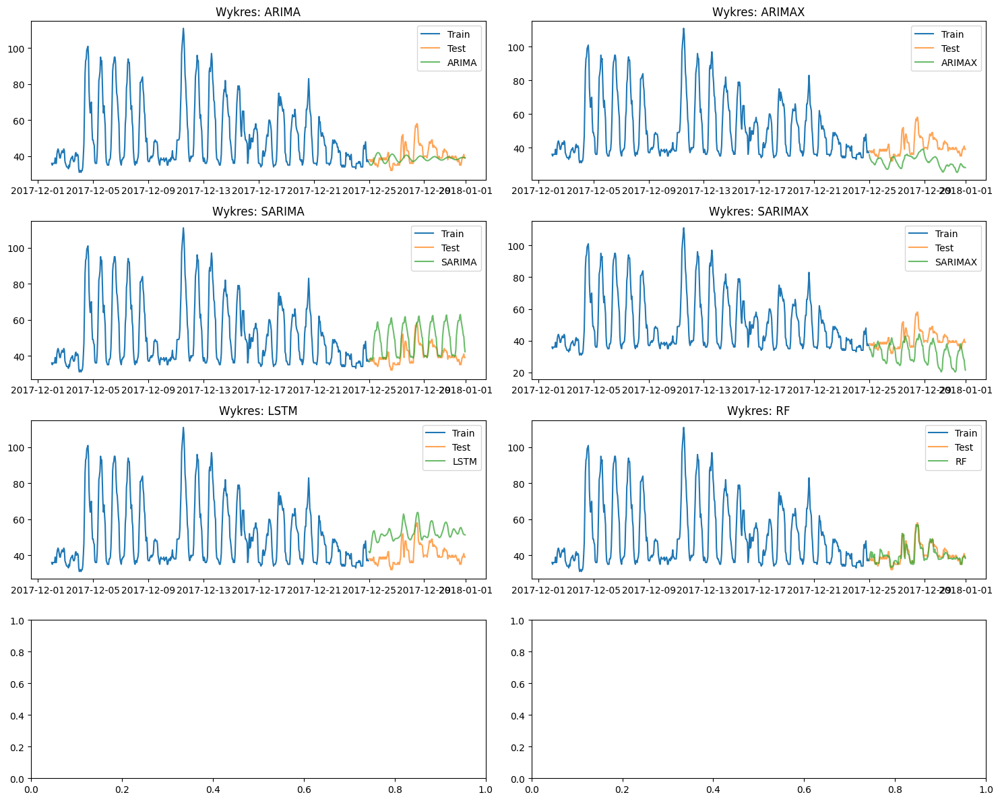


Metryki efektywności:
                    RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                       
Random Forest   2.383111   1.842381  0.045325       0.018912        0.534072
ARIMA           5.639042   4.023737  0.093612      17.224838        0.541972
ARIMAX         10.370139   9.045928  0.214539      23.172415        0.937186
SARIMAX        10.384547   9.045020  0.221168      50.722636       16.617878
SARIMA         11.807942   8.911407  0.228875      35.555235        9.715102
LSTM           12.534689  11.878717  0.304500       0.545701        0.344019


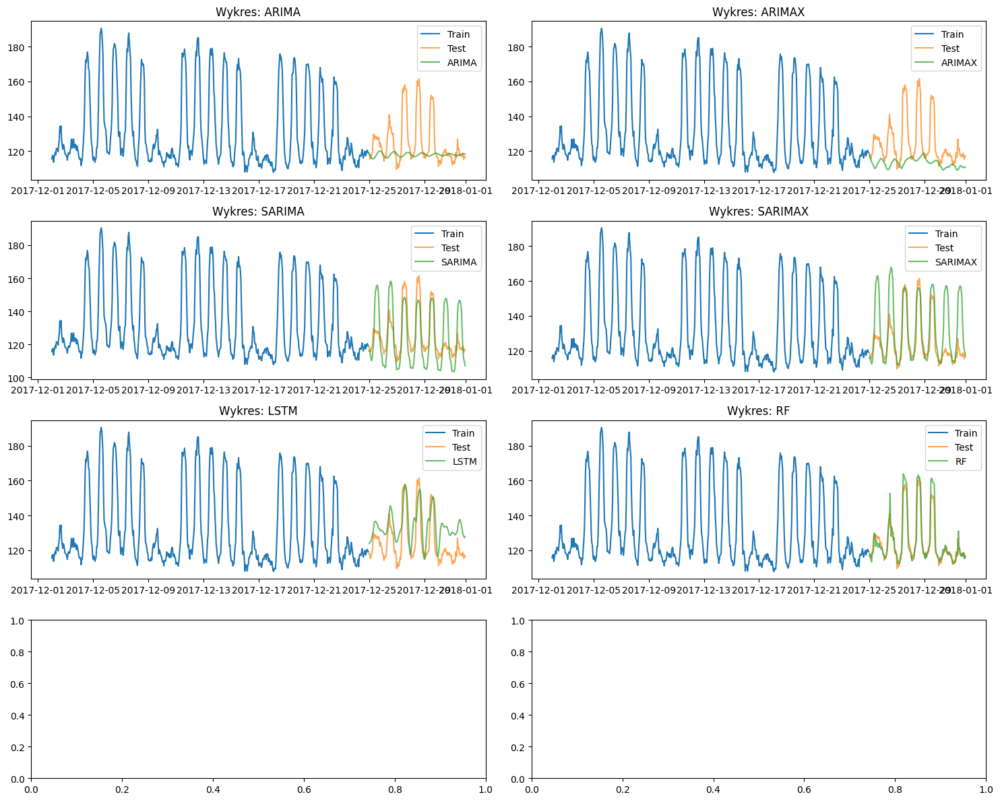


Metryki efektywności:
                    RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                       
Random Forest   4.610469   3.037036  0.023060       0.023468        0.794553
LSTM           11.732517  10.374013  0.085597       0.534417        0.341479
SARIMA         12.760085  10.340587  0.083185      73.240242       35.292880
ARIMA          14.849074   8.917259  0.063695      17.242864        0.661108
SARIMAX        15.238813   9.488796  0.076290      86.277919       35.437155
ARIMAX         17.534448  12.158123  0.089008      22.609933        0.713904


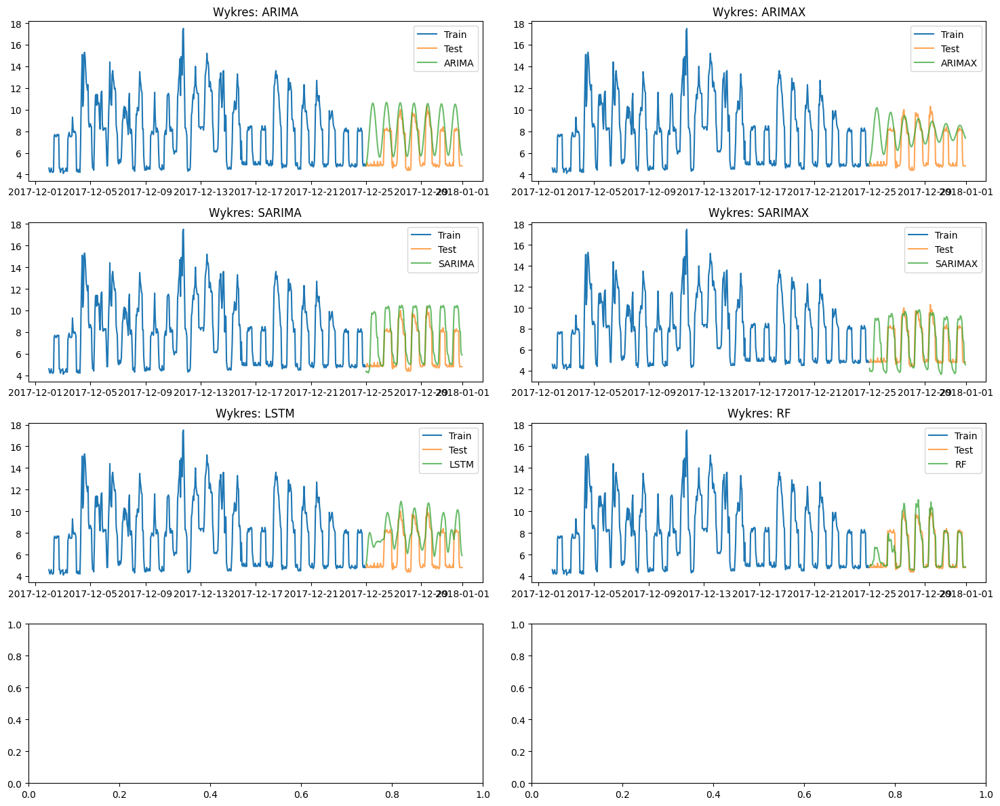


Metryki efektywności:
                   RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
Random Forest  0.760958  0.523274  0.081952       0.015215        0.618816
SARIMAX        1.321052  0.977526  0.172170      88.817251       12.122711
SARIMA         1.830964  1.355556  0.230718      78.581701       51.279260
LSTM           1.967287  1.728379  0.321598       0.544096        0.343513
ARIMAX         2.082089  1.674439  0.323900      17.006740        0.787580
ARIMA          2.226000  1.808456  0.330315      17.931690        0.997051


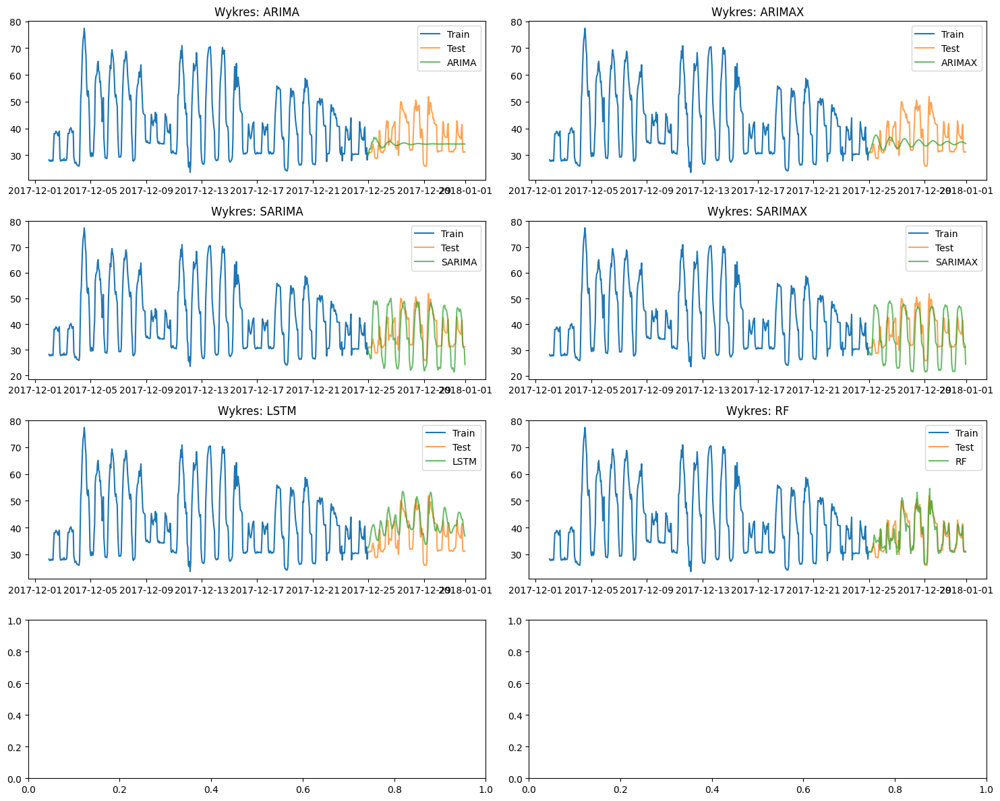


Metryki efektywności:
                   RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
Random Forest  2.930650  2.086754  0.056702       0.015630        0.782082
LSTM           6.384704  5.491965  0.162171       0.540001        0.345874
ARIMAX         6.756876  5.303423  0.134172      23.374579        0.943905
ARIMA          7.150299  5.659459  0.142850      19.389864        0.729941
SARIMA         7.721008  6.281395  0.180400      84.070623       55.505448
SARIMAX        7.751718  6.473669  0.185067     109.829601       51.067893


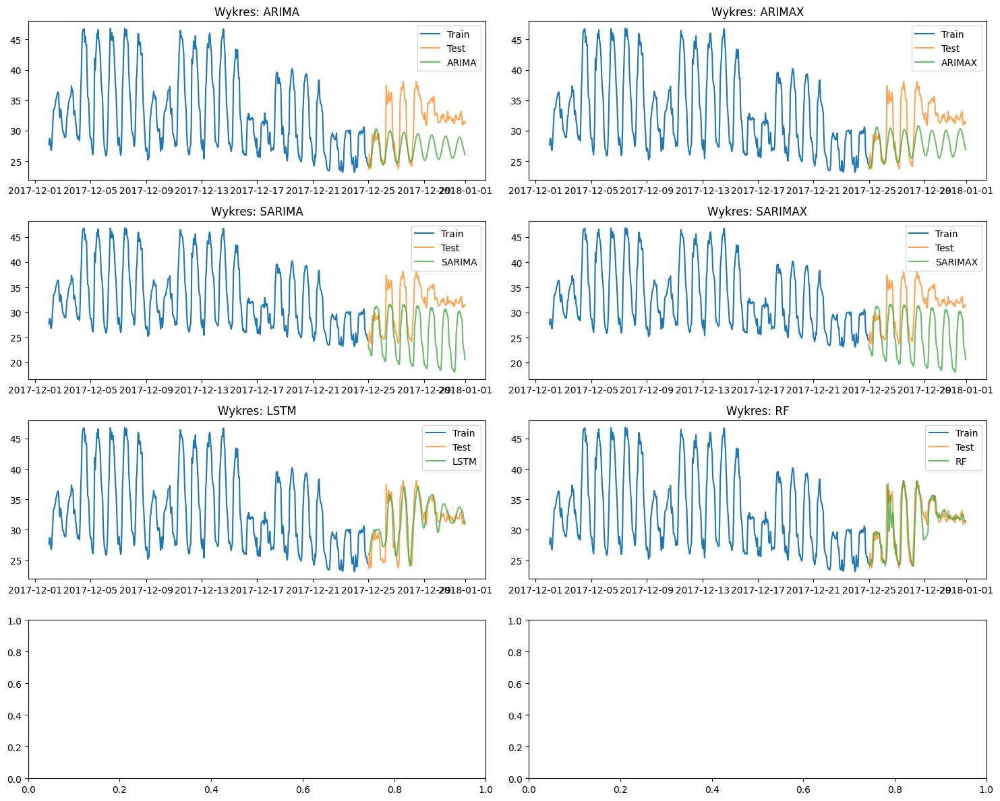


Metryki efektywności:
                   RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
Random Forest  1.665322  1.078164  0.033645       0.017449        0.779400
LSTM           1.995855  1.518838  0.051815       0.599218        0.371255
ARIMAX         4.447183  3.728929  0.112696      21.610517        0.938177
ARIMA          4.991213  4.218441  0.127225      18.520402        0.673388
SARIMAX        6.911948  5.917279  0.187277    3842.701396       41.930899
SARIMA         6.970905  5.967198  0.188959      58.777210       41.523654


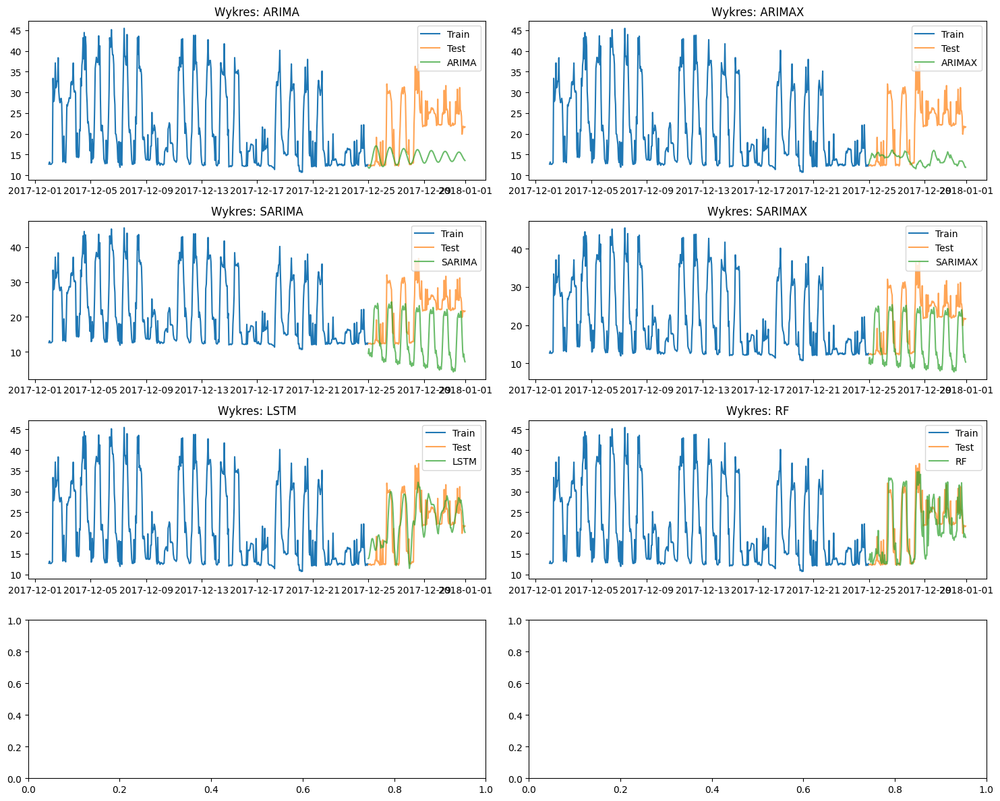


Metryki efektywności:
                    RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                      
Random Forest   3.784805  2.842922  0.127641       0.017583        0.846135
LSTM            4.075282  3.186818  0.179873       0.601460        0.369934
SARIMAX         8.351648  6.960542  0.325066      68.838203       25.076032
ARIMA           9.286660  7.727544  0.312791      19.889400        0.838824
ARIMAX         10.241785  8.565870  0.350000      23.384406        0.554269
SARIMA         10.245383  8.919040  0.419890      57.019419       37.295854


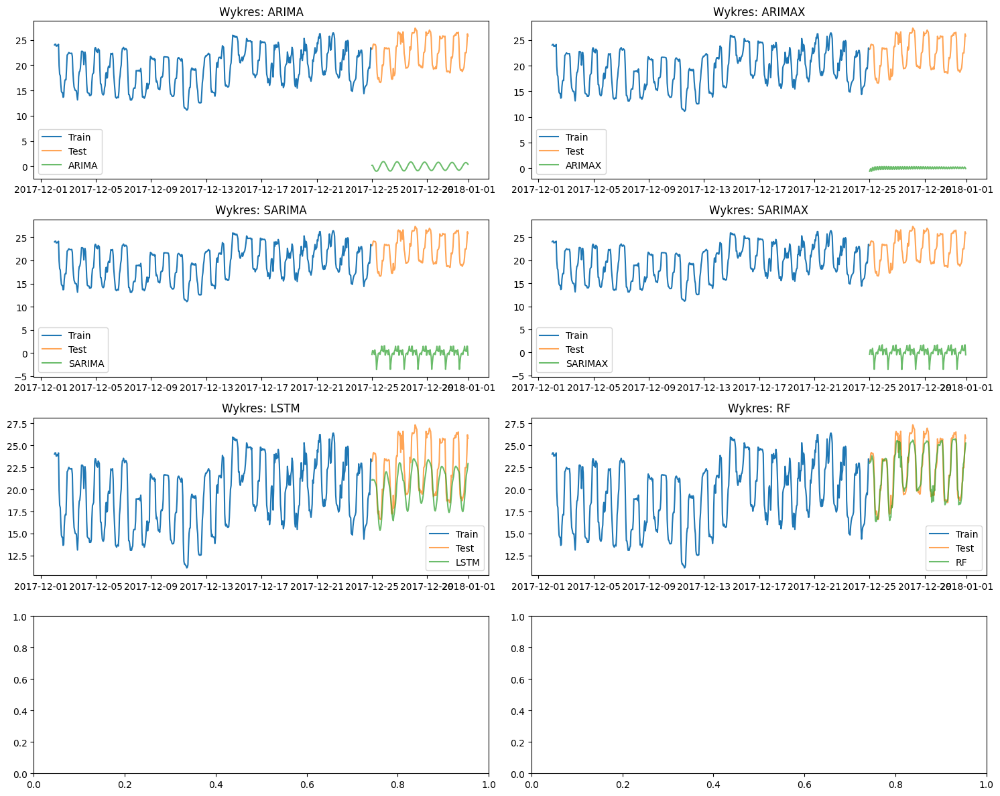


Metryki efektywności:
                    RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                       
Random Forest   0.977934   0.760268  0.033348       0.018561        0.757891
LSTM            2.486107   2.155097  0.091403       0.599842        0.361900
SARIMAX        22.610813  22.402562  0.999789     109.677759       17.804444
ARIMAX         22.618243  22.408471  0.998817      27.317958        1.050069
SARIMA         22.638792  22.432978  1.001186     107.547961        5.789737
ARIMA          22.667172  22.452396  1.000984      24.522770        0.795545


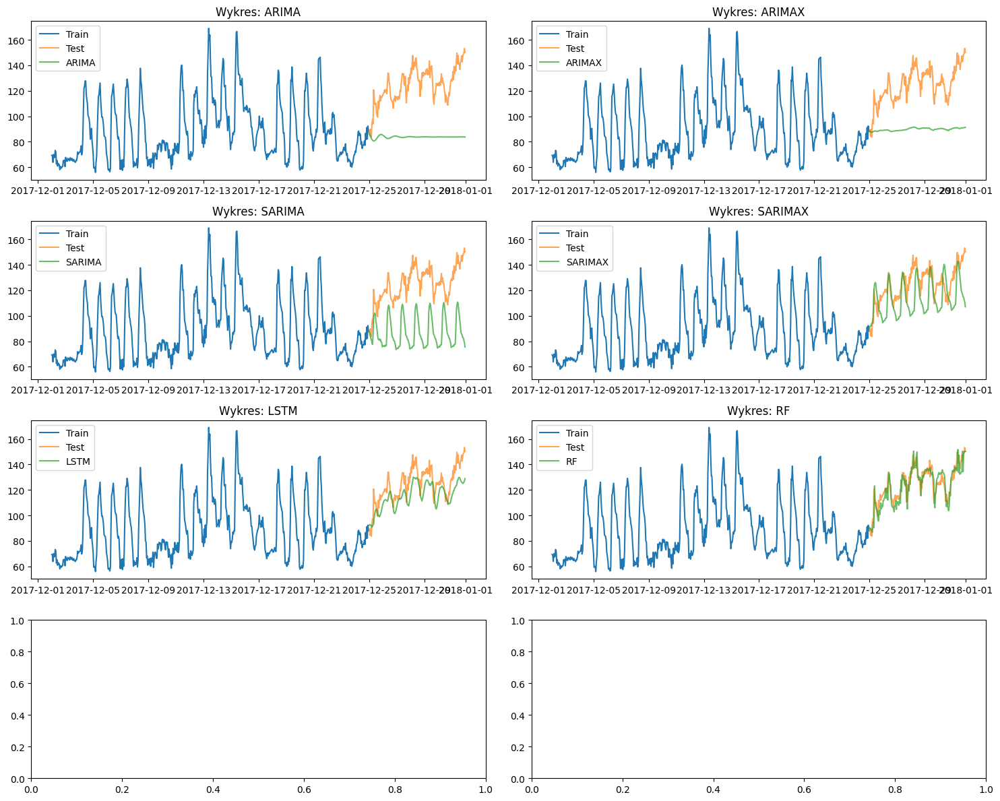


Metryki efektywności:
                    RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                       
Random Forest   7.065599   5.617240  0.045322       0.018018        0.806215
LSTM           12.098411  10.310849  0.080338       0.605641        0.365284
SARIMAX        18.411092  14.838877  0.116238      86.451903       19.715893
ARIMAX         37.138902  34.890918  0.271715       7.527252        0.167196
SARIMA         40.963500  37.674969  0.295283      67.468141       24.389522
ARIMA          43.080360  40.809957  0.318781       5.162121        0.480296


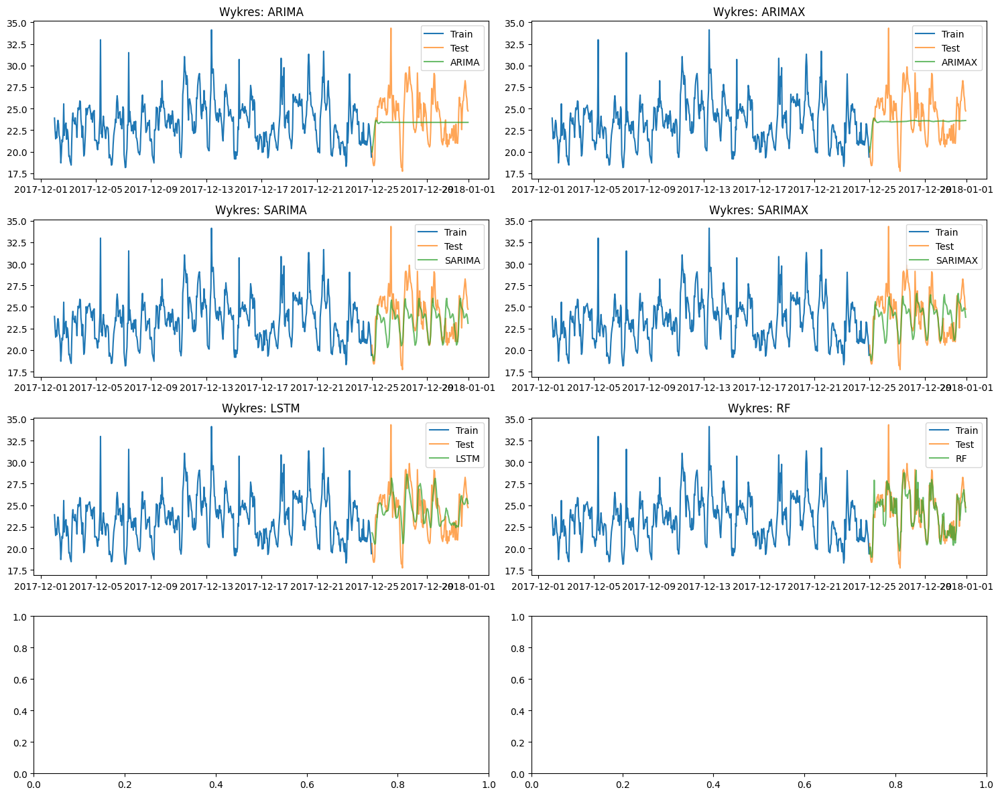


Metryki efektywności:
                   RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
Random Forest  1.504348  1.085646  0.044171       0.016543        0.801772
LSTM           2.055349  1.666163  0.070221       0.612771        0.380104
SARIMAX        2.236544  1.681925  0.068138      82.556663        5.828514
SARIMA         2.418633  1.862881  0.074441      75.672776        9.386209
ARIMAX         2.744367  2.244144  0.091666       9.361759        0.420119
ARIMA          2.785161  2.271367  0.092327       9.383563        0.726420


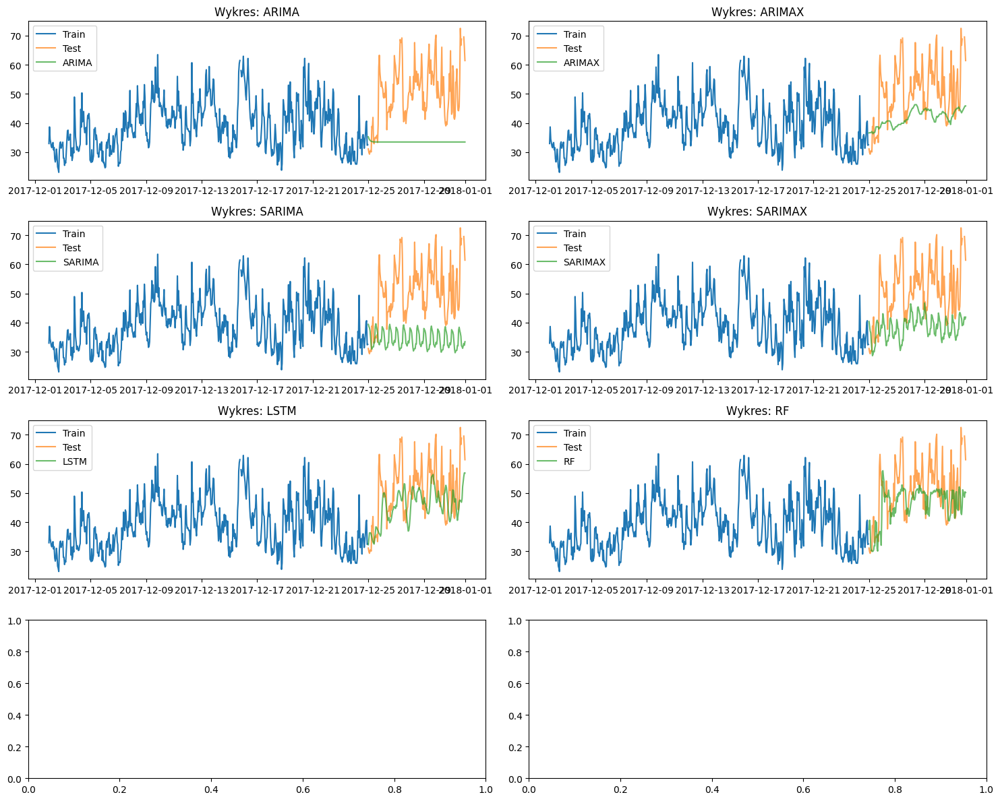


Metryki efektywności:
                    RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                       
Random Forest   7.449562   5.342324  0.097841       0.017039        0.814874
LSTM            8.569408   6.569071  0.123748       0.618743        0.365056
ARIMAX         12.092458   9.596529  0.175778       1.655835        0.141194
SARIMAX        14.920640  12.338506  0.226062      58.767996        8.471035
SARIMA         18.739868  16.345189  0.303562      40.422824        1.906871
ARIMA          19.228283  16.897714  0.313295       1.072846        0.082241


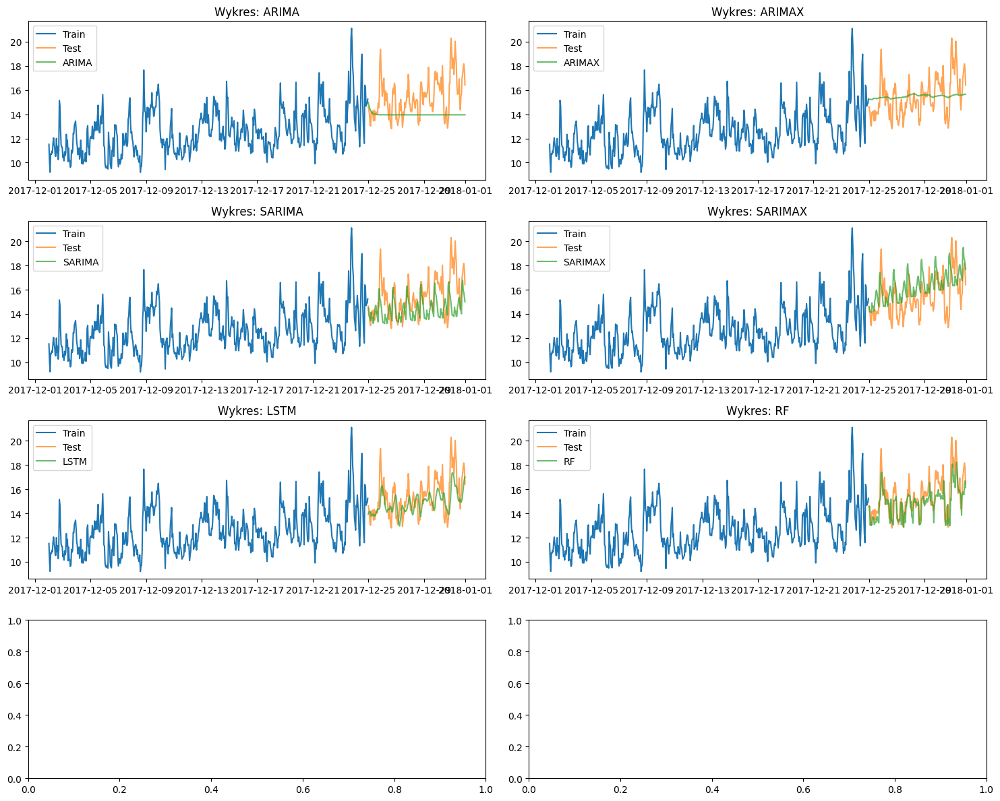


Metryki efektywności:
                   RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
Random Forest  1.174478  0.878290  0.054766       0.018680        0.795198
LSTM           1.375992  1.047488  0.065471       0.609307        0.372788
ARIMAX         1.548521  1.249677  0.080639       1.460996        0.048053
SARIMAX        1.783489  1.452828  0.096721     116.497055        1.242714
SARIMA         1.911339  1.431231  0.087954     104.661248        4.603994
ARIMA          2.184825  1.687538  0.102188       1.486347        0.124243


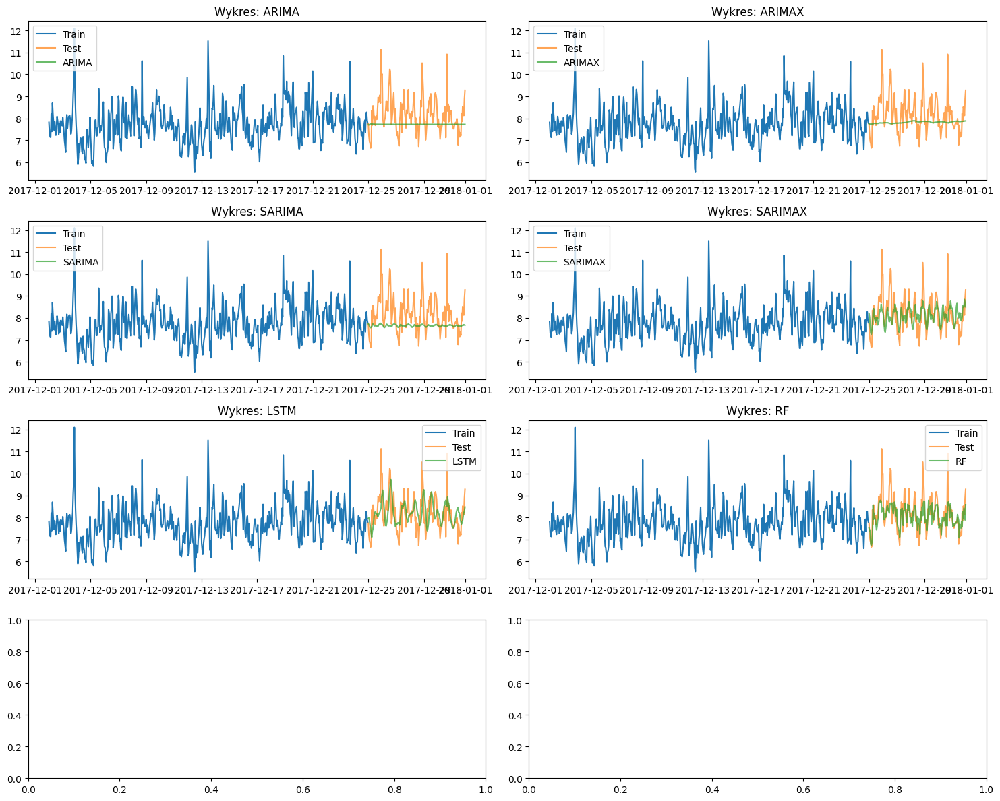


Metryki efektywności:
                   RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
Random Forest  0.643228  0.457489  0.053810       0.018046        0.827889
SARIMAX        0.716986  0.521915  0.061961      36.981345        1.027507
LSTM           0.768821  0.603025  0.073320       0.619189        0.371843
ARIMAX         0.874777  0.640896  0.074602       8.151716        0.158971
ARIMA          0.916687  0.675779  0.078230       8.633415        0.458109
SARIMA         0.944027  0.705624  0.081378      24.919453        3.086573


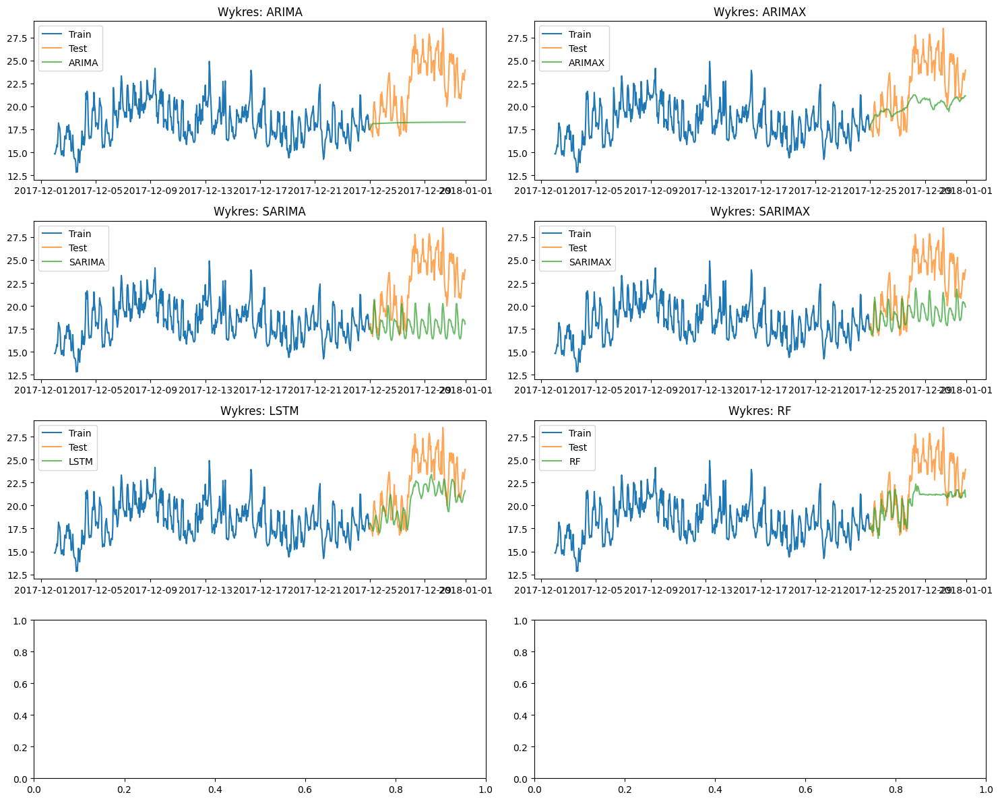


Metryki efektywności:
                   RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
LSTM           2.796096  2.304973  0.097833       0.587980        0.359253
Random Forest  2.872346  2.236446  0.092517       0.019010        0.793478
ARIMAX         3.423351  2.784779  0.116949      11.444411        0.845946
SARIMAX        4.094547  3.343764  0.138939      69.789732       33.217287
ARIMA          5.085183  4.270153  0.177854      13.956786        0.790436
SARIMA         5.270214  4.460500  0.186813      52.977535       39.286183


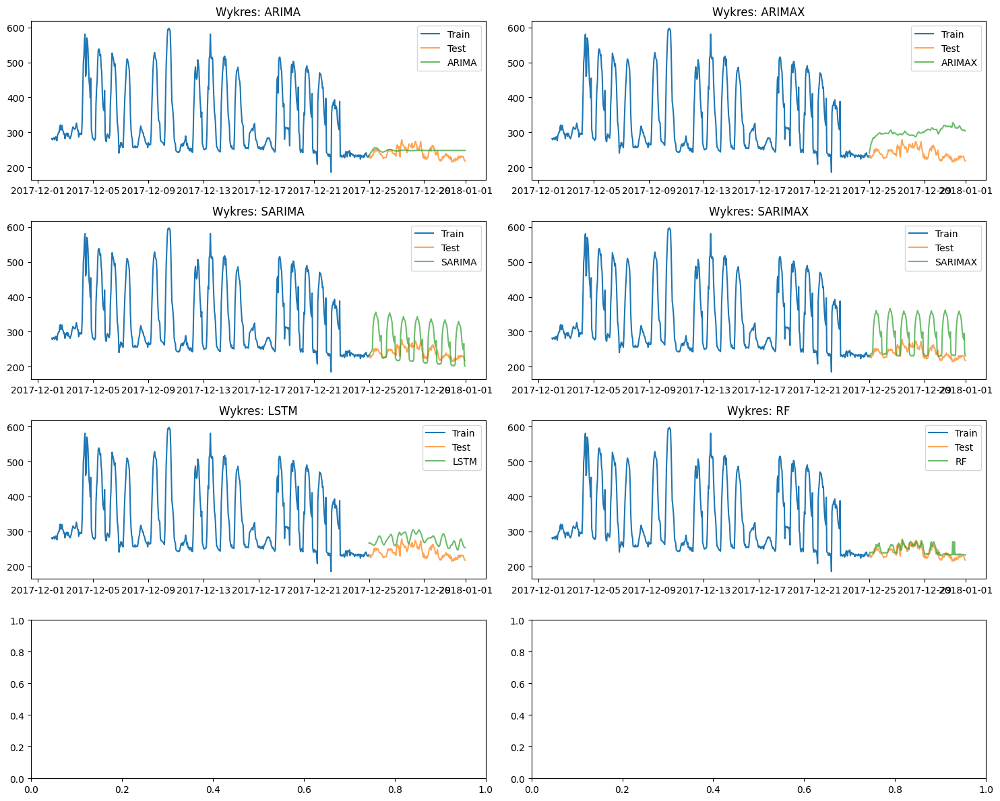


Metryki efektywności:
                    RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                       
Random Forest  11.787602   9.297016  0.039243       0.017835        0.822835
ARIMA          16.285547  14.086065  0.059875      20.010643        0.755585
LSTM           37.447238  35.317688  0.148817       0.576265        0.355490
SARIMA         56.736484  47.023476  0.193429      59.654071       44.592353
ARIMAX         64.027979  59.946130  0.255004      26.271063        0.730039
SARIMAX        69.685192  56.953702  0.234887      93.846673       34.133250


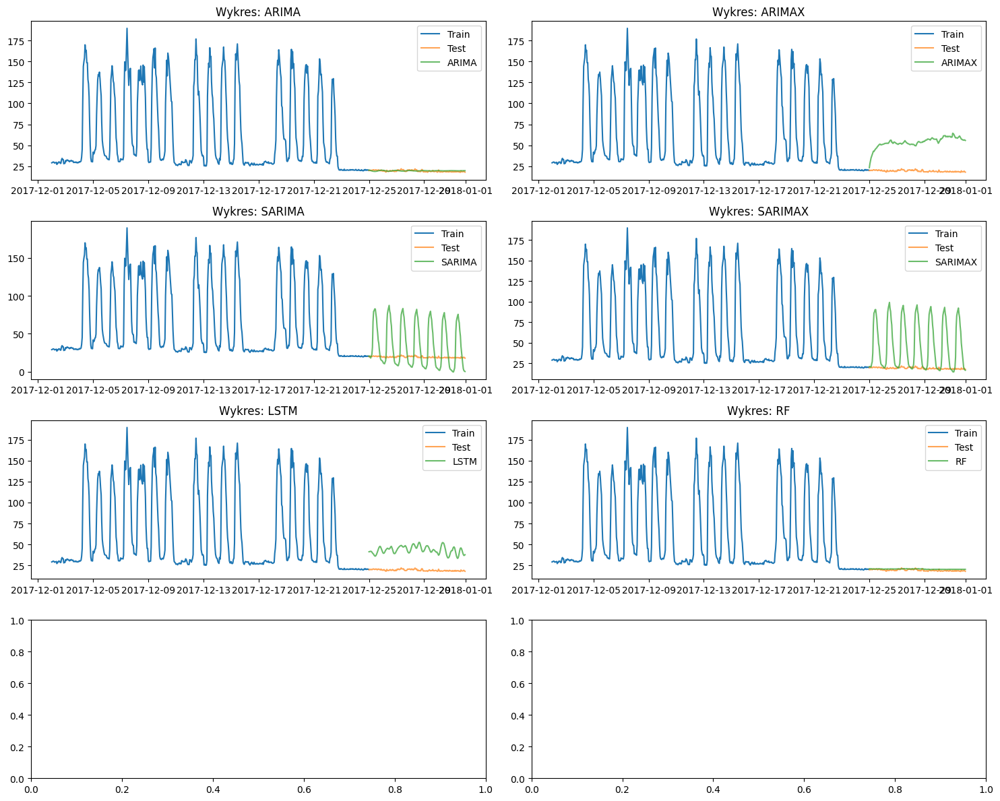


Metryki efektywności:
                    RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                       
ARIMA           1.054229   0.924513  0.048548      10.377616        0.651908
Random Forest   1.479621   1.292793  0.069341       0.015554        0.851115
LSTM           24.534199  24.138954  1.264348       0.612632        0.362543
SARIMA         32.575124  25.236204  1.313897      47.399845       39.266460
ARIMAX         35.186194  34.569401  1.820008      11.882831        0.729981
SARIMAX        40.350909  28.796341  1.499431      80.101200       31.616371


In [15]:
for j in range(len(all_results)):
    fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(15, 12))
    axes = axes.flatten()

    for i, col in enumerate(all_results[j].columns[:6]):
        ax = axes[i]
        data = df_final[df_final['building_id'] == selected_buildings[j]].copy()
        data['timestamp'] = pd.to_datetime(data['timestamp'])
        data = data.set_index('timestamp').sort_index()
        data = data.asfreq('h')

        train = data['energy_consumption'][-720:-168]
        test = data['energy_consumption'][-168:]
        ax.plot(train.index, train, label='Train')
        ax.plot(test.index, test, label='Test', alpha=0.7)
        ax.plot(test.index, all_results[j][col], label=col, alpha=0.7)
        ax.set_title(f'Wykres: {col}')
        ax.legend()

    plt.tight_layout()
    plt.show()

    metrics_df = pd.DataFrame(all_metrics[j]).set_index('Model')
    print("\nMetryki efektywności:")
    print(metrics_df.sort_values('RMSE'))


In [16]:
df_list = []
for iteration in all_metrics:
    df_iter = pd.DataFrame(iteration)
    df_list.append(df_iter)

# Łączenie wszystkich iteracji
full_df = pd.concat(df_list, ignore_index=True)

# Grupowanie po modelu i obliczanie średnich
results = full_df[full_df['RMSE'] <2000].groupby('Model').agg({
    'RMSE': 'mean',
    'MAE': 'mean',
    'MAPE': 'mean',
    'Czas treningu': 'mean',
    'Czas predykcji': 'mean'
}).reset_index()

# Sortowanie według RMSE (najlepsze na górze)
results = results.sort_values('RMSE').reset_index(drop=True)

# Dodanie rankingu
results['Ranking'] = results.index + 1

# Formatowanie wyników
results['RMSE'] = results['RMSE'].round(4)
results['MAE'] = results['MAE'].round(4)
results['MAPE'] = results['MAPE'].round(6)
results['Czas treningu'] = results['Czas treningu'].apply(lambda x: f"{x:.3f} s" if pd.notnull(x) else "Brak")
results['Czas predykcji'] = results['Czas predykcji'].round(3).astype(str) + " s"

# Wybór kolumn do wyświetlenia
final_results = results[['Ranking', 'Model', 'RMSE', 'MAE', 'MAPE', 'Czas treningu', 'Czas predykcji']]

# Wyświetlenie wyników
print("ŚREDNIE WYNIKI DLA WSZYSTKICH MODELI:")
print(final_results.to_string(index=False))

# Podsumowanie
best_model = results.iloc[0]
worst_model = results.iloc[-1]

print("\nPODSUMOWANIE:")
print(f"Najlepszy model: {best_model['Model']}")
print(f"- Średnie RMSE: {best_model['RMSE']}")
print(f"- Średnie MAE: {best_model['MAE']}")
print(f"- Średnie MAPE: {best_model['MAPE']}")
print(f"\nNajgorszy model: {worst_model['Model']}")
print(f"- Średnie RMSE: {worst_model['RMSE']}")
print(f"- Średnie MAE: {worst_model['MAE']}")
print(f"- Średnie MAPE: {worst_model['MAPE']}")

ŚREDNIE WYNIKI DLA WSZYSTKICH MODELI:
 Ranking         Model    RMSE     MAE     MAPE Czas treningu Czas predykcji
       1 Random Forest  4.1178  3.0157 0.068296       0.017 s        0.802 s
       2          LSTM  8.8512  7.7868 0.215122       4.378 s         0.35 s
       3         ARIMA 10.8338  9.2619 0.227032      15.165 s        0.625 s
       4       SARIMAX 14.2266 11.4201 0.274039     270.152 s       22.544 s
       5        SARIMA 14.2620 11.8795 0.282966      65.075 s       24.928 s
       6        ARIMAX 15.9703 13.9037 0.329078      17.399 s        0.593 s

PODSUMOWANIE:
Najlepszy model: Random Forest
- Średnie RMSE: 4.1178
- Średnie MAE: 3.0157
- Średnie MAPE: 0.068296

Najgorszy model: ARIMAX
- Średnie RMSE: 15.9703
- Średnie MAE: 13.9037
- Średnie MAPE: 0.329078


In [17]:
def analizuj_wyniki_z_progowaniem(lista_list, progowanie=None):
    if progowanie is None:
        progowanie = {'RMSE': float('inf'), 
                     'MAE': float('inf'), 
                     'MAPE': float('inf'),
                     'Czas treningu': float('inf'),
                     'Czas predykcji': float('inf')}
    
    podsumowanie = {}
    liczba_analizowanych_list = 0

    for lista_modeli in lista_list:
        # Filtruj modele według progów
        przefiltrowane_modele = []
        for model in lista_modeli:
            include = True
            for metryka, prog in progowanie.items():
                if metryka in model and model[metryka] >= prog:
                    include = False
                    break
            if include:
                przefiltrowane_modele.append(model)
        
        if not przefiltrowane_modele:
            continue
            
        liczba_analizowanych_list += 1
        
        # Inicjalizacja modeli jeśli nie istnieją
        for model in przefiltrowane_modele:
            if model['Model'] not in podsumowanie:
                podsumowanie[model['Model']] = {
                    'RMSE': 0,
                    'MAE': 0,
                    'MAPE': 0,
                    'Czas treningu': 0,
                    'Czas predykcji': 0,
                    'Liczba wystąpień': 0
                }
            podsumowanie[model['Model']]['Liczba wystąpień'] += 1
        
        # Znajdź najlepsze w każdej kategorii
        najlepsze = {
            'RMSE': {'model': None, 'wartosc': float('inf')},
            'MAE': {'model': None, 'wartosc': float('inf')},
            'MAPE': {'model': None, 'wartosc': float('inf')},
            'Czas treningu': {'model': None, 'wartosc': float('inf')},
            'Czas predykcji': {'model': None, 'wartosc': float('inf')}
        }
        
        for model in przefiltrowane_modele:
            for metryka in najlepsze:
                if metryka in model:
                    if model[metryka] < najlepsze[metryka]['wartosc']:
                        najlepsze[metryka] = {'model': model['Model'], 'wartosc': model[metryka]}
        
        # Zaktualizuj podsumowanie
        for metryka, dane in najlepsze.items():
            if dane['model']:
                podsumowanie[dane['model']][metryka] += 1
    
    # Przygotuj wyniki do prezentacji
    wyniki = {
        'podsumowanie': podsumowanie,
        'liczba_analizowanych_list': liczba_analizowanych_list,
        'progowanie': progowanie
    }
    return wyniki

def pokaz_podsumowanie(wyniki):
    print(f"\nPodsumowanie najlepszych wyników (przeanalizowano {wyniki['liczba_analizowanych_list']} list z progami: {wyniki['progowanie']})")
    print("{:<15} {:<8} {:<8} {:<8} {:<15} {:<15} {:<10}".format(
        'Model', 'RMSE', 'MAE', 'MAPE', 'Czas treningu', 'Czas predykcji', 'Wystąpienia'))
    
    for model, dane in wyniki['podsumowanie'].items():
        print("{:<15} {:<8} {:<8} {:<8} {:<15} {:<15} {:<10}".format(
            model,
            dane['RMSE'],
            dane['MAE'],
            dane['MAPE'],
            dane['Czas treningu'],
            dane['Czas predykcji'],
            dane['Liczba wystąpień']))

wyniki = analizuj_wyniki_z_progowaniem(all_metrics)
df_arima = pd.DataFrame(wyniki['podsumowanie']).T
df_arima[['RMSE', 'MAE', 'MAPE']].sort_values(by='RMSE', ascending=False)


,RMSE,MAE,MAPE
Random Forest,17,18,18
ARIMA,1,1,1
SARIMAX,1,0,0
LSTM,1,0,0
SARIMA,0,1,1
ARIMAX,0,0,0


### LSTM i RF - różne długości



====== Processing Building Bear_assembly_Jose ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption   lag_1   lag_2   lag_3   lag_4  \
timestamp                                                                 
2017-12-01 23:00:00              190.75     NaN     NaN     NaN     NaN   
2017-12-02 00:00:00              156.25  190.75     NaN     NaN     NaN   
2017-12-02 01:00:00              143.25  156.25  190.75     NaN     NaN   
2017-12-02 02:00:00              144.00  143.25  156.25  190.75     NaN   
2017-12-02 03:00:00              141.00  144.00  143.25  156.25  190.75   
...                                 ...     ...     ...     ...     ...   
2017-12-24 18:00:00              234.00  222.25  232.25  231.50  216.00   
2017-12-24 19:00:00              229.75  234.00  222.25  232.25  231.50   
2017-12-24 20:00:00              212.00  229.75  234.00  2

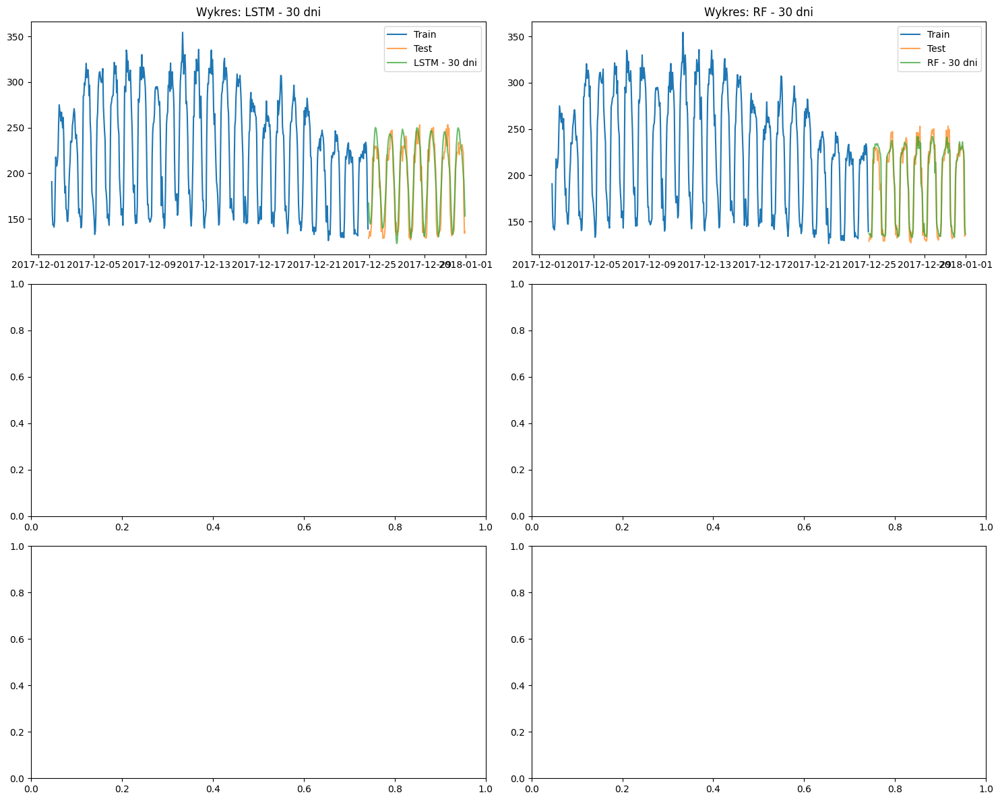


Metryki efektywności:
                             RMSE        MAE      MAPE  Czas treningu  \
Model                                                                   
Random Forest - 30 dni  11.394316   8.045520  0.043139       0.017514   
LSTM - 30 dni           16.838304  13.685729  0.077198       0.767167   

                        Czas predykcji  
Model                                   
Random Forest - 30 dni        0.765007  
LSTM - 30 dni                 0.346947  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption   lag_1   lag_2   lag_3   lag_4  \
timestamp                                                                 
2017-10-01 10:00:00              281.75     NaN     NaN     NaN     NaN   
2017-10-01 11:00:00              300.75  281.75     NaN     NaN     NaN   
2017-10-01 12:00:00              334.00  300.75  281.75     NaN     NaN   
2017-10-

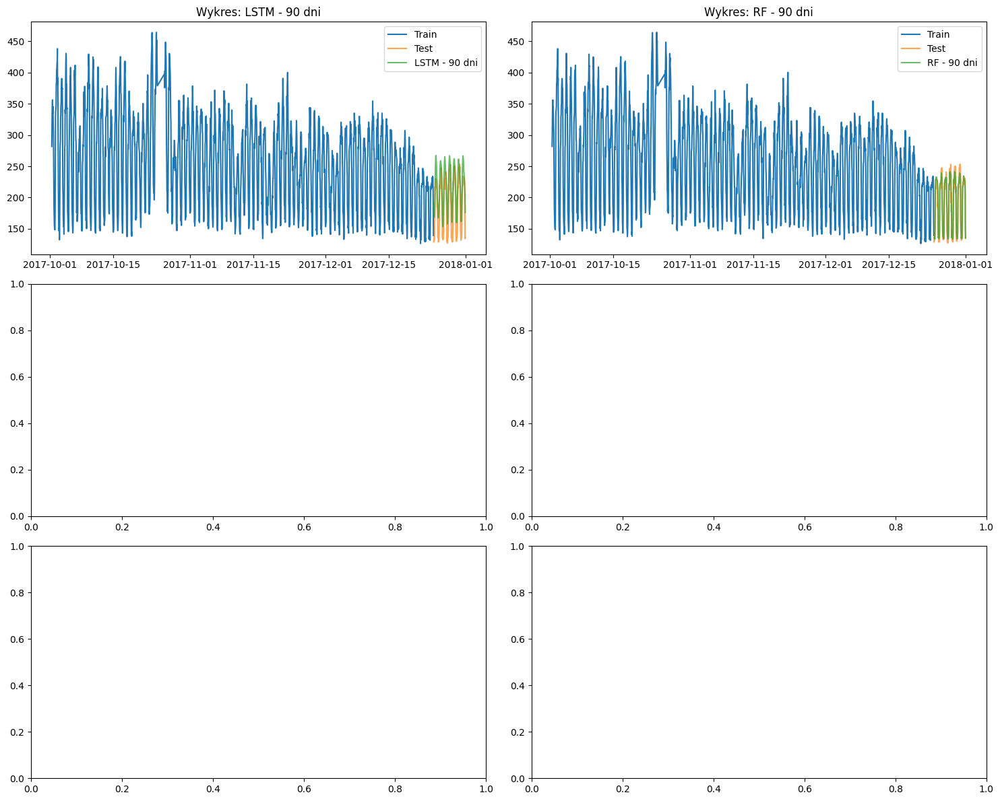


Metryki efektywności:
                             RMSE        MAE      MAPE  Czas treningu  \
Model                                                                   
Random Forest - 90 dni  10.887013   7.922864  0.042463       0.019055   
LSTM - 90 dni           30.527676  26.611887  0.159291       0.831143   

                        Czas predykcji  
Model                                   
Random Forest - 90 dni        3.094712  
LSTM - 90 dni                 0.348707  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption   lag_1   lag_2   lag_3   lag_4  \
timestamp                                                                 
2017-07-03 10:00:00              279.25     NaN     NaN     NaN     NaN   
2017-07-03 11:00:00              288.25  279.25     NaN     NaN     NaN   
2017-07-03 12:00:00              296.50  288.25  279.25     NaN     NaN   
2017-07-

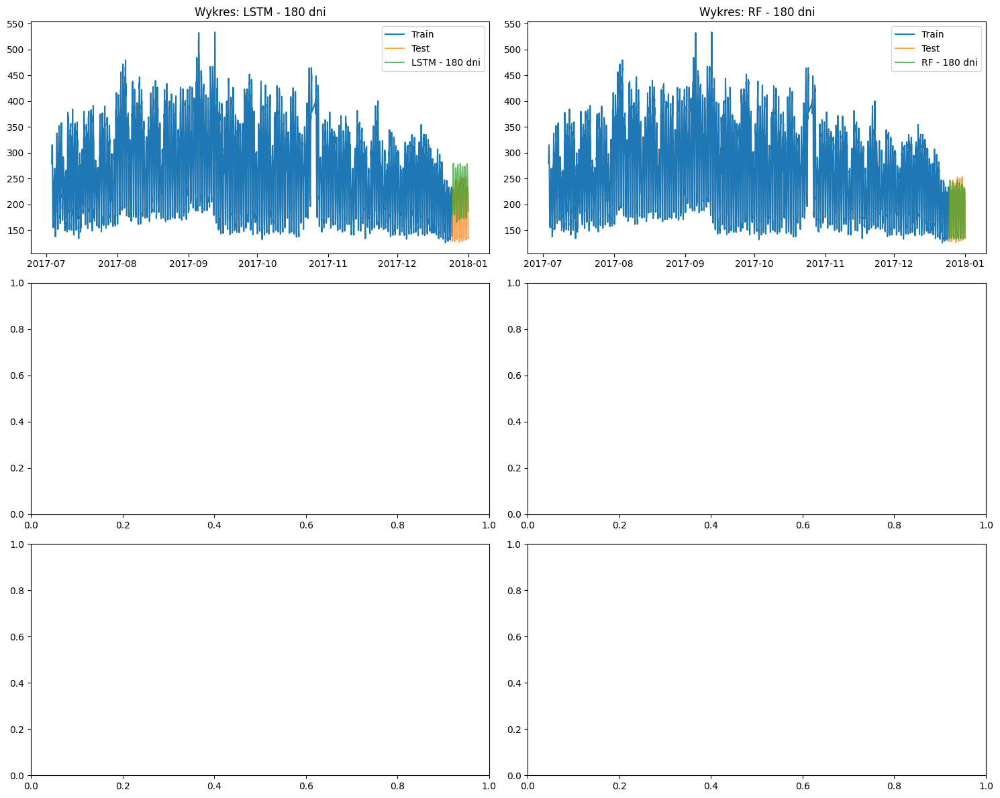


Metryki efektywności:
                              RMSE        MAE      MAPE  Czas treningu  \
Model                                                                    
Random Forest - 180 dni  12.041348   8.912962  0.047039       0.018808   
LSTM - 180 dni           40.873101  37.040032  0.219338       0.639388   

                         Czas predykcji  
Model                                    
Random Forest - 180 dni        7.053481  
LSTM - 180 dni                 0.345657  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption   lag_1   lag_2   lag_3   lag_4  \
timestamp                                                                 
2017-01-04 09:00:00              248.50     NaN     NaN     NaN     NaN   
2017-01-04 10:00:00              250.25  248.50     NaN     NaN     NaN   
2017-01-04 11:00:00              261.75  250.25  248.50     NaN     NaN   


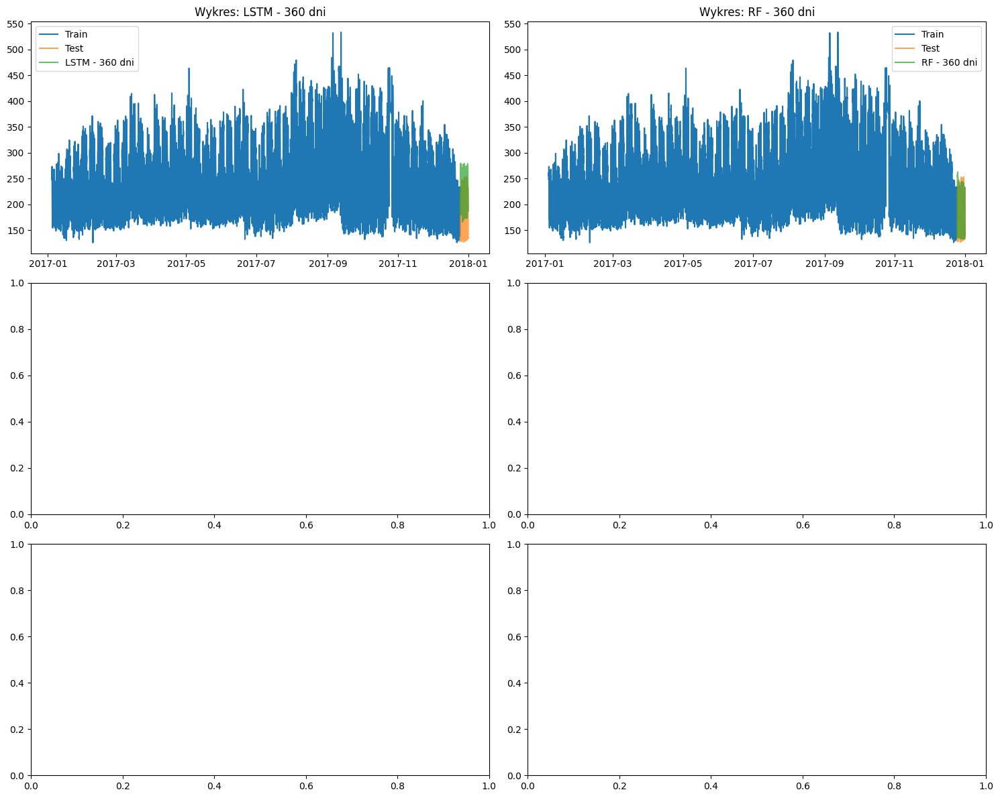


Metryki efektywności:
                              RMSE        MAE      MAPE  Czas treningu  \
Model                                                                    
Random Forest - 360 dni  15.068808  10.392894  0.054643       0.019724   
LSTM - 360 dni           40.811416  36.976957  0.218967       0.591906   

                         Czas predykcji  
Model                                    
Random Forest - 360 dni       15.429483  
LSTM - 360 dni                 0.329217  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption   lag_1   lag_2   lag_3   lag_4  \
timestamp                                                                 
2016-01-01 00:00:00              148.50     NaN     NaN     NaN     NaN   
2016-01-01 01:00:00              152.00  148.50     NaN     NaN     NaN   
2016-01-01 02:00:00              153.25  152.00  148.50     NaN     NaN   


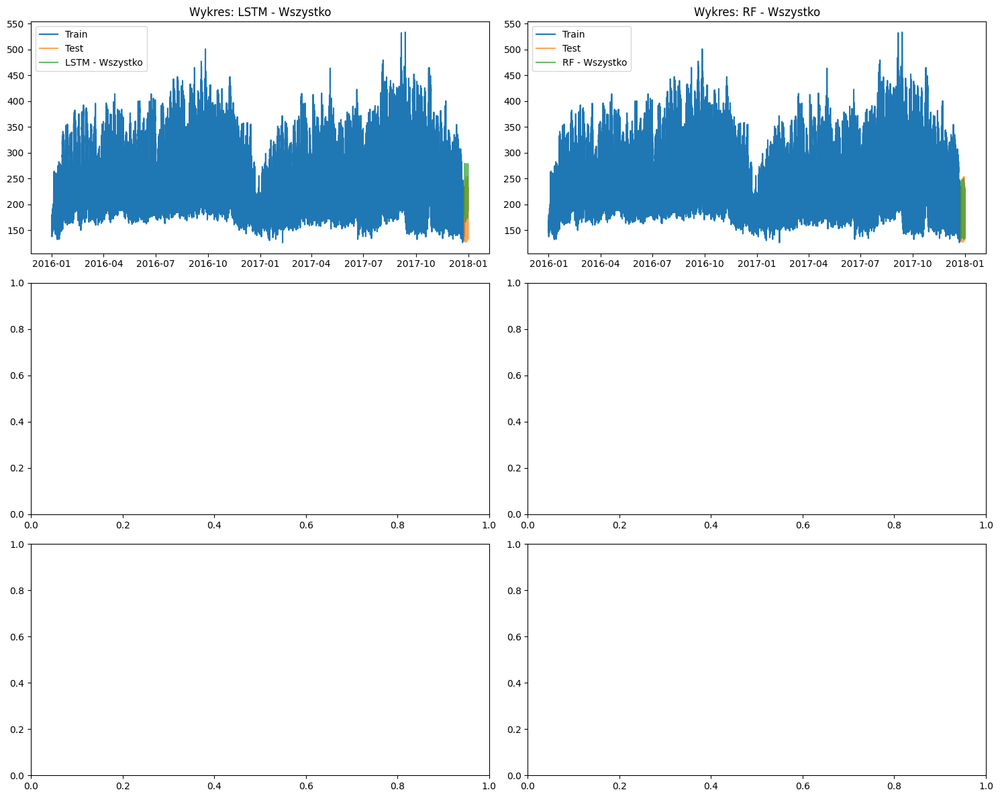


Metryki efektywności:
                               RMSE        MAE      MAPE  Czas treningu  \
Model                                                                     
Random Forest - Wszystko  10.859122   8.020555  0.043628       0.025383   
LSTM - Wszystko           40.811416  36.976957  0.218967       0.584490   

                          Czas predykcji  
Model                                     
Random Forest - Wszystko       33.871384  
LSTM - Wszystko                 0.344745  


====== Processing Building Eagle_health_Reuben ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption     lag_1     lag_2     lag_3  \
timestamp                                                               
2017-11-28 21:00:00            245.3623       NaN       NaN       NaN   
2017-11-28 22:00:00            227.0477  245.3623       NaN       NaN   
2017-11-28 23:00:00

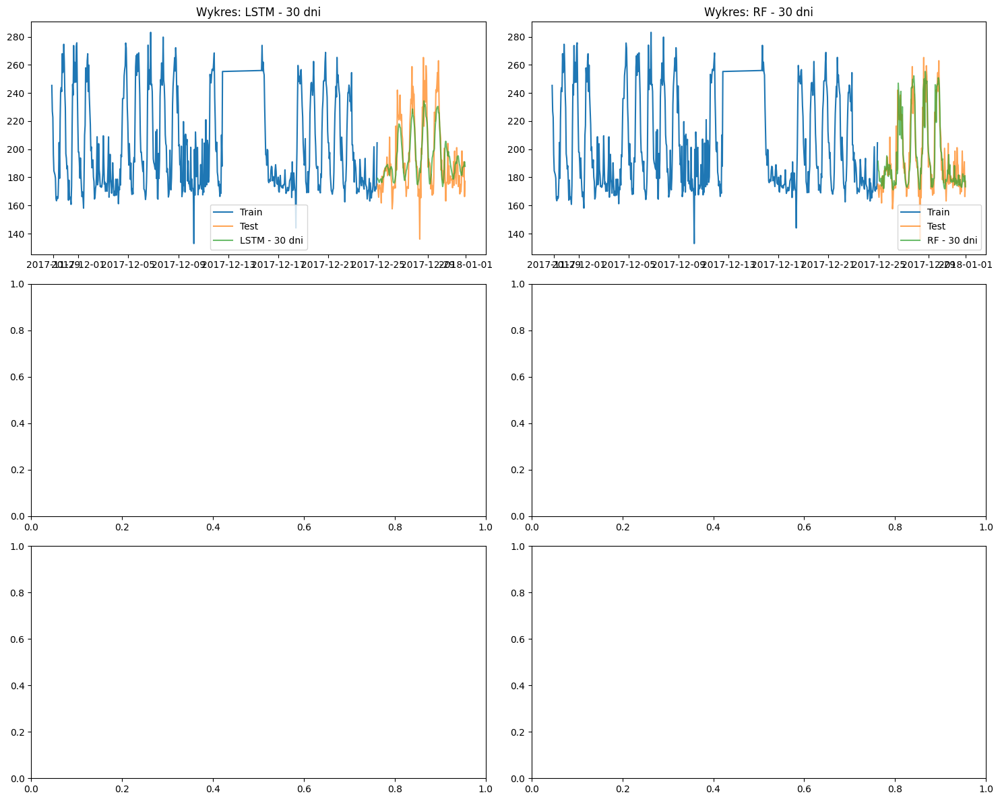


Metryki efektywności:
                             RMSE        MAE      MAPE  Czas treningu  \
Model                                                                   
Random Forest - 30 dni  13.196187   9.618658  0.048213       0.016049   
LSTM - 30 dni           15.464976  12.043449  0.062076       0.592579   

                        Czas predykcji  
Model                                   
Random Forest - 30 dni        0.924787  
LSTM - 30 dni                 0.335784  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption     lag_1     lag_2     lag_3  \
timestamp                                                               
2017-09-29 20:00:00            250.9030       NaN       NaN       NaN   
2017-09-29 21:00:00            231.1949  250.9030       NaN       NaN   
2017-09-29 22:00:00            218.9292  231.1949  250.9030       NaN   
2017-09-29 23:00:0

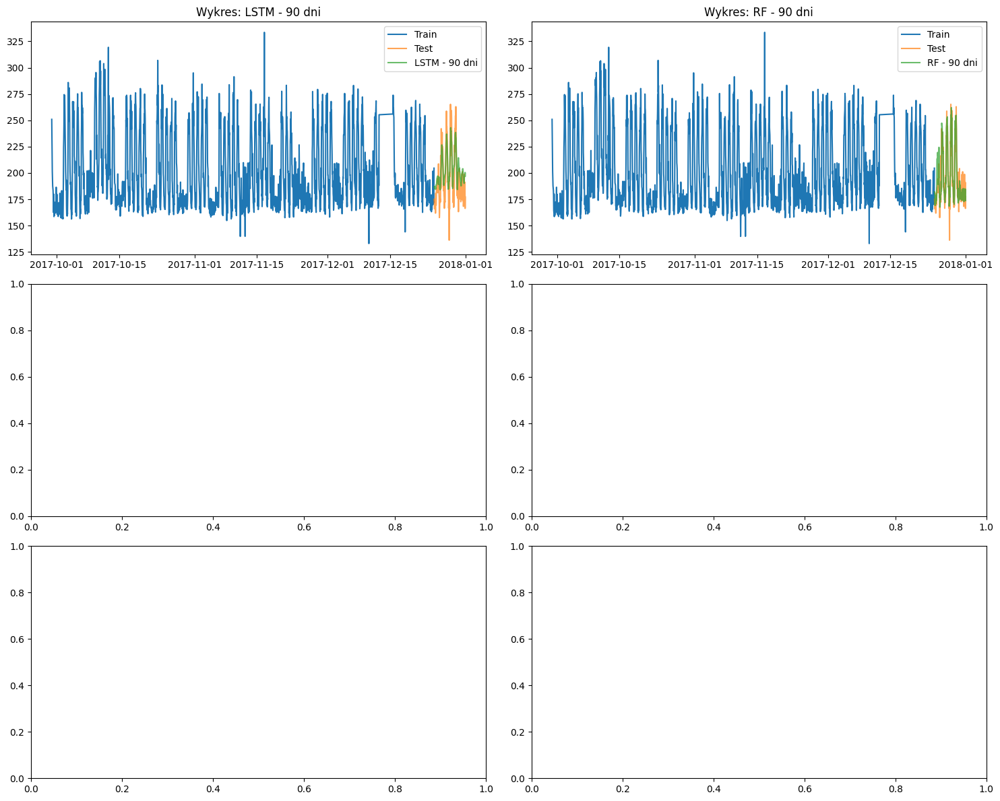


Metryki efektywności:
                            RMSE        MAE      MAPE  Czas treningu  \
Model                                                                  
Random Forest - 90 dni  14.55468  10.516435  0.053496       0.018097   
LSTM - 90 dni           17.91524  14.461562  0.078410       0.594863   

                        Czas predykcji  
Model                                   
Random Forest - 90 dni        4.033183  
LSTM - 90 dni                 0.332053  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption     lag_1     lag_2     lag_3  \
timestamp                                                               
2017-07-01 08:00:00            166.0000       NaN       NaN       NaN   
2017-07-01 09:00:00            167.0000  166.0000       NaN       NaN   
2017-07-01 10:00:00            179.0000  167.0000  166.0000       NaN   
2017-07-01 11:00:00   

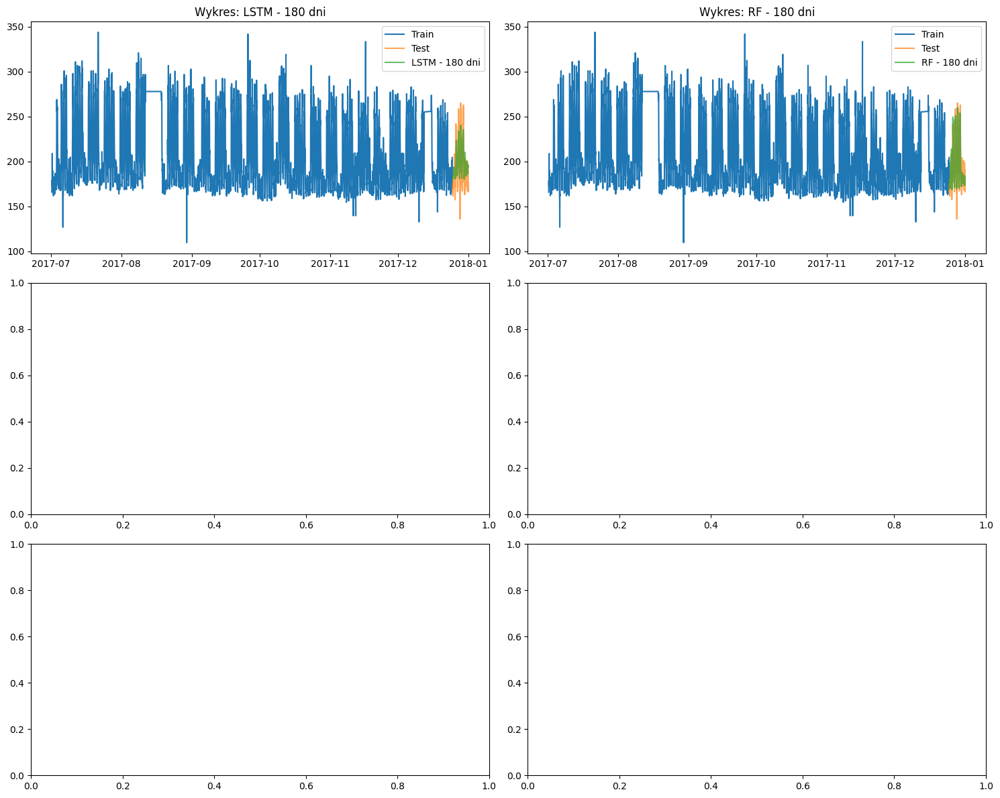


Metryki efektywności:
                              RMSE        MAE      MAPE  Czas treningu  \
Model                                                                    
Random Forest - 180 dni  13.468198   9.732863  0.048753       0.017339   
LSTM - 180 dni           16.357784  13.039651  0.069553       0.585033   

                         Czas predykcji  
Model                                    
Random Forest - 180 dni        8.123687  
LSTM - 180 dni                 0.334160  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption     lag_1     lag_2     lag_3  \
timestamp                                                               
2017-01-01 12:00:00            192.0000       NaN       NaN       NaN   
2017-01-01 13:00:00            207.0000  192.0000       NaN       NaN   
2017-01-01 14:00:00            192.0000  207.0000  192.0000       NaN   
2017-01-01

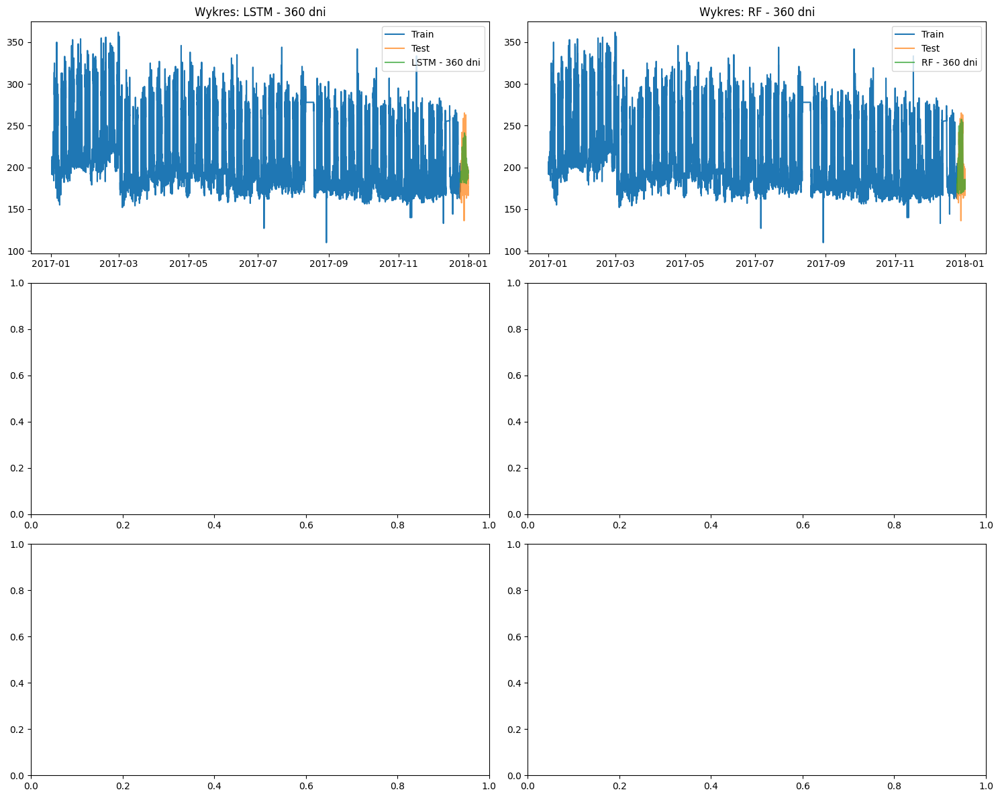


Metryki efektywności:
                              RMSE        MAE      MAPE  Czas treningu  \
Model                                                                    
Random Forest - 360 dni  12.792169   9.268026  0.046703       0.026552   
LSTM - 360 dni           16.473573  13.232699  0.070917       0.600994   

                         Czas predykcji  
Model                                    
Random Forest - 360 dni       15.675412  
LSTM - 360 dni                 0.337047  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption     lag_1     lag_2     lag_3  \
timestamp                                                               
2016-01-01 00:00:00            198.0000       NaN       NaN       NaN   
2016-01-01 01:00:00            227.0000  198.0000       NaN       NaN   
2016-01-01 02:00:00            209.0000  227.0000  198.0000       NaN   
2016-01-01

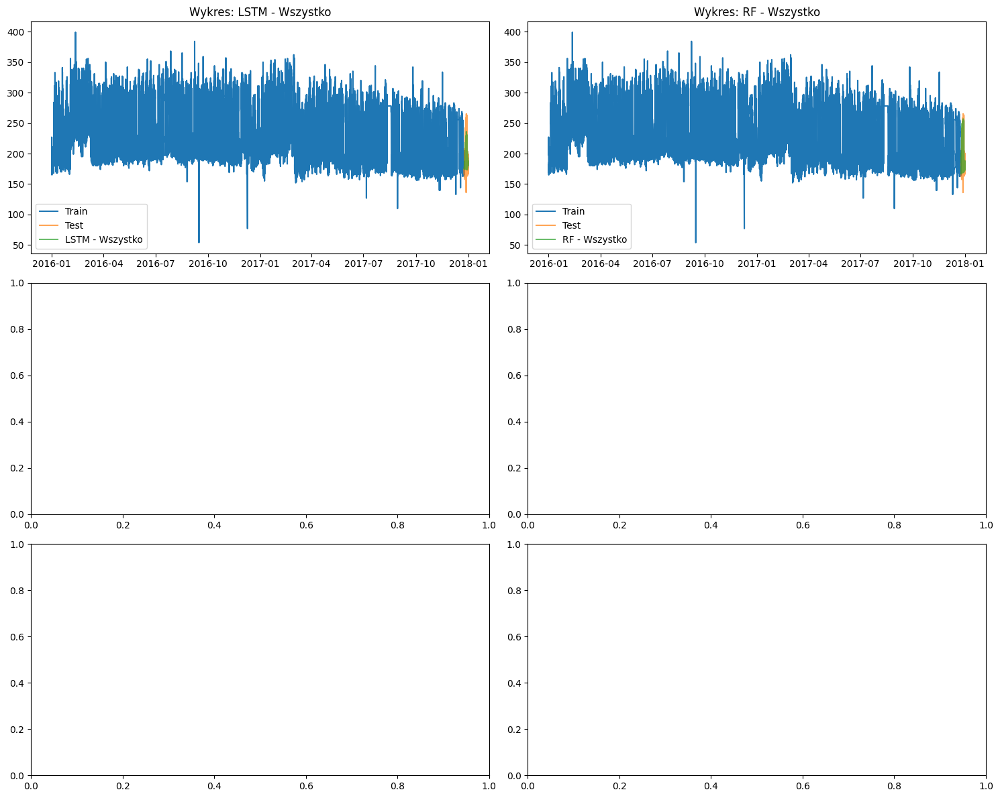


Metryki efektywności:
                               RMSE        MAE      MAPE  Czas treningu  \
Model                                                                     
Random Forest - Wszystko  12.753801   9.283518  0.047274       0.025823   
LSTM - Wszystko           15.268728  11.817806  0.060354       0.657446   

                          Czas predykcji  
Model                                     
Random Forest - Wszystko       30.536972  
LSTM - Wszystko                 0.339278  


====== Processing Building Fox_assembly_Christie ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-12-02 00:00:00                7.72    NaN    NaN    NaN    NaN    NaN   
2017-12-02 01:00:00                7.72   7.72    NaN    NaN    NaN    NaN 

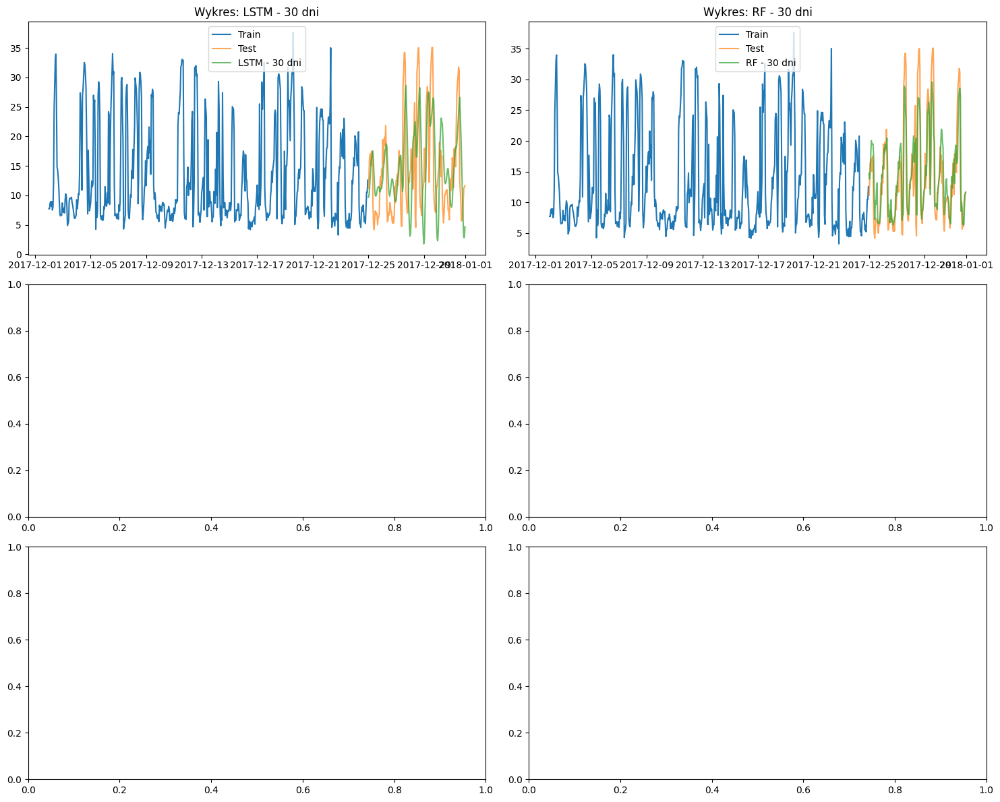


Metryki efektywności:
                            RMSE       MAE      MAPE  Czas treningu  \
Model                                                                 
Random Forest - 30 dni  4.518106  3.323483  0.270506       0.017563   
LSTM - 30 dni           7.774502  6.363498  0.612280       0.589332   

                        Czas predykcji  
Model                                   
Random Forest - 30 dni        0.906625  
LSTM - 30 dni                 0.339894  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-10-03 00:00:00                6.90    NaN    NaN    NaN    NaN    NaN   
2017-10-03 01:00:00                7.18   6.90    NaN    NaN    NaN    NaN   
2017-10-03 02:00:00                5.28   7.18   6.90    NaN    NaN    NaN   
2

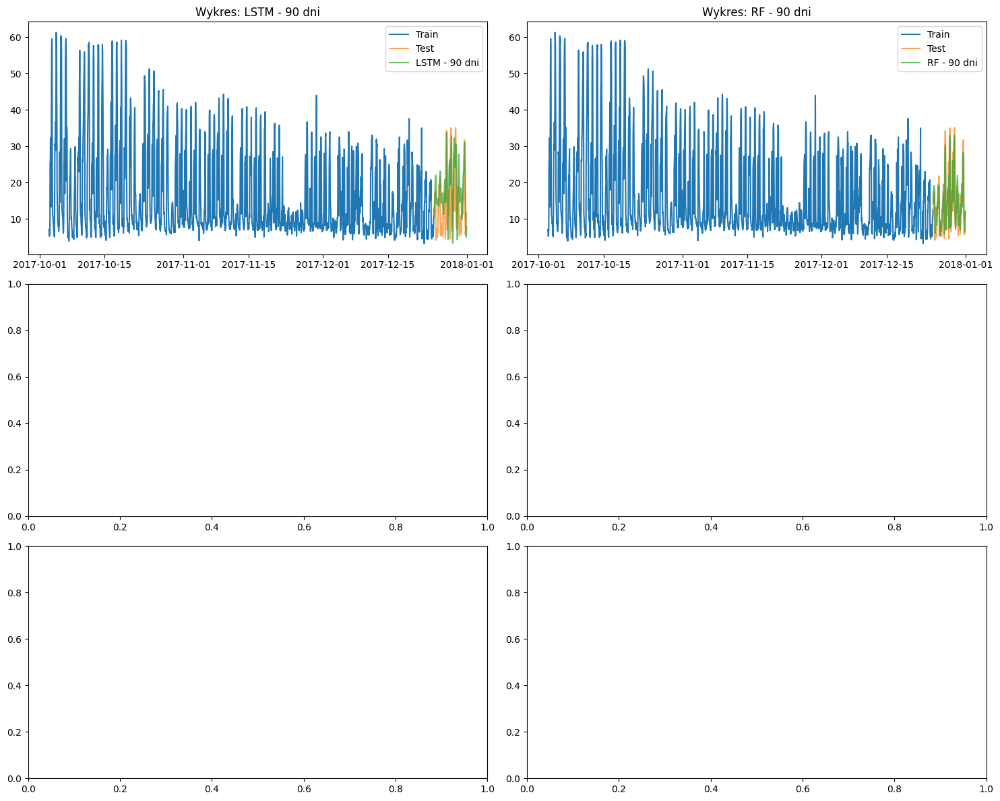


Metryki efektywności:
                            RMSE       MAE      MAPE  Czas treningu  \
Model                                                                 
Random Forest - 90 dni  3.967038  2.862639  0.243615       0.020576   
LSTM - 90 dni           8.993068  7.196107  0.788213       0.610801   

                        Czas predykcji  
Model                                   
Random Forest - 90 dni        3.830834  
LSTM - 90 dni                 0.328690  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-07-05 00:00:00               29.04    NaN    NaN    NaN    NaN    NaN   
2017-07-05 01:00:00               22.46  29.04    NaN    NaN    NaN    NaN   
2017-07-05 02:00:00               18.07  22.46  29.04    NaN    NaN    NaN   
2

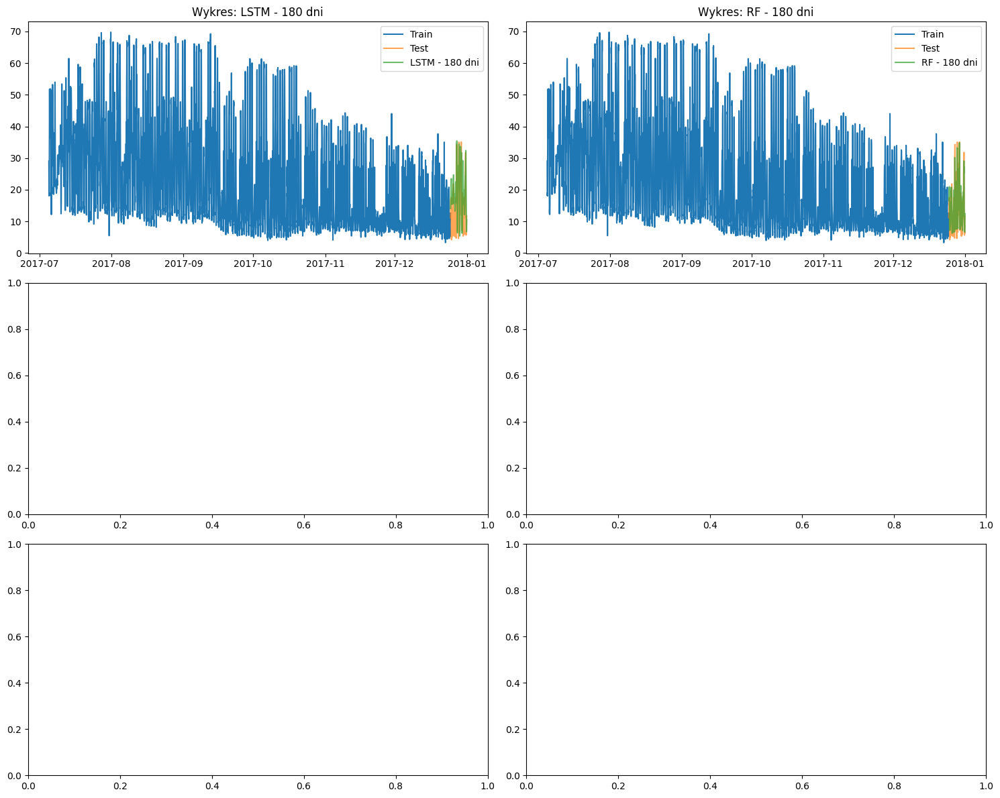


Metryki efektywności:
                             RMSE       MAE      MAPE  Czas treningu  \
Model                                                                  
Random Forest - 180 dni  4.248307  3.090694  0.264028       0.019943   
LSTM - 180 dni           9.667843  7.821318  0.869492       0.611040   

                         Czas predykcji  
Model                                    
Random Forest - 180 dni        8.335146  
LSTM - 180 dni                 0.337635  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-01-05 12:00:00               28.43    NaN    NaN    NaN    NaN    NaN   
2017-01-05 13:00:00               20.59  28.43    NaN    NaN    NaN    NaN   
2017-01-05 14:00:00               10.97  20.59  28.43    NaN    NaN    

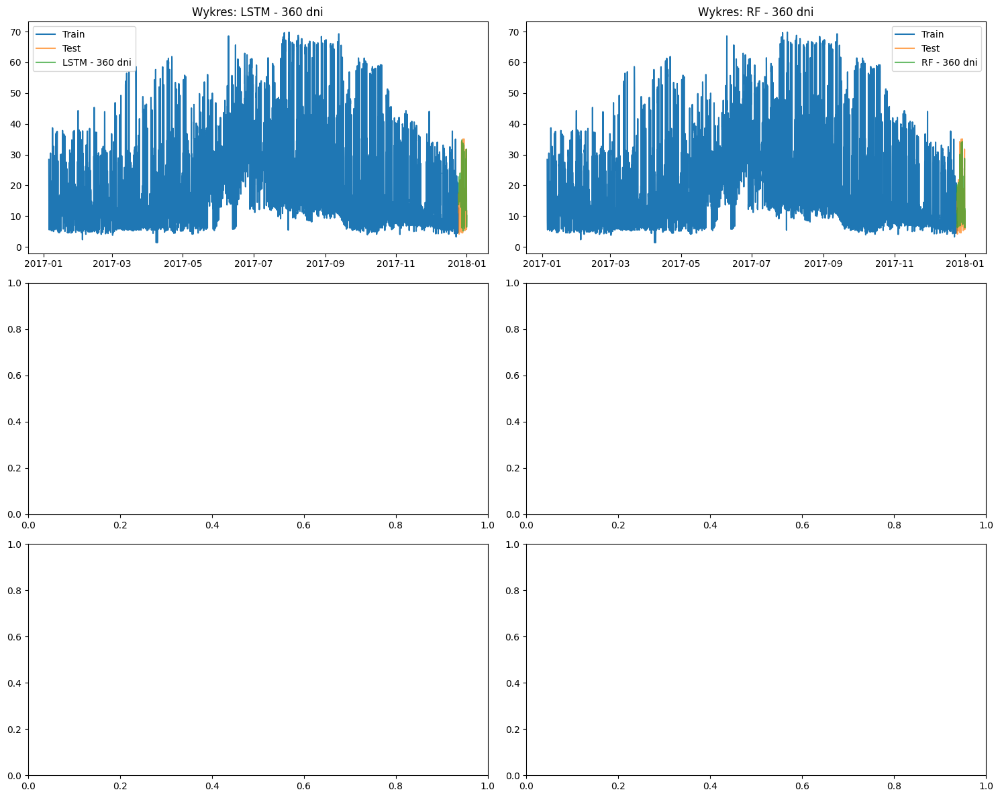


Metryki efektywności:
                             RMSE       MAE      MAPE  Czas treningu  \
Model                                                                  
Random Forest - 360 dni  4.132156  3.000260  0.263815       0.023594   
LSTM - 360 dni           9.335562  7.508662  0.831750       0.588602   

                         Czas predykcji  
Model                                    
Random Forest - 360 dni       18.902060  
LSTM - 360 dni                 0.338372  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2016-01-01 00:00:00               24.74    NaN    NaN    NaN    NaN    NaN   
2016-01-01 01:00:00               25.02  24.74    NaN    NaN    NaN    NaN   
2016-01-01 02:00:00               24.91  25.02  24.74    NaN    NaN    

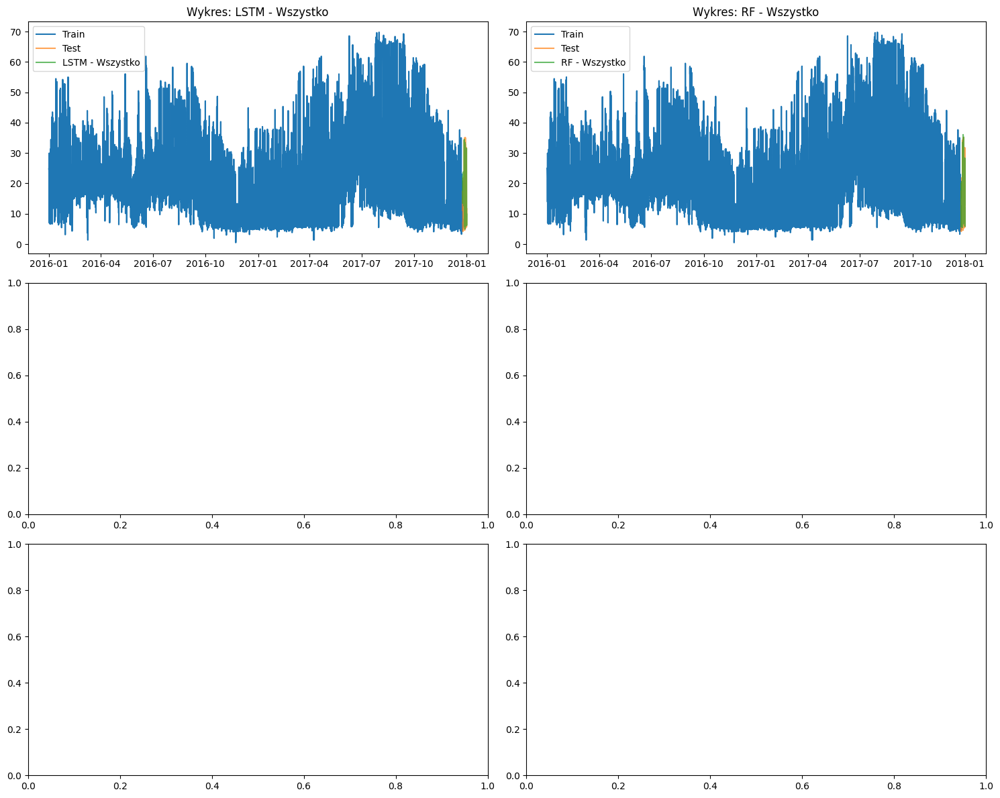


Metryki efektywności:
                              RMSE       MAE      MAPE  Czas treningu  \
Model                                                                   
Random Forest - Wszystko  3.859575  2.710495  0.228627       0.028543   
LSTM - Wszystko           9.224883  7.396104  0.818056       0.614844   

                          Czas predykcji  
Model                                     
Random Forest - Wszystko       43.247057  
LSTM - Wszystko                 0.344511  


====== Processing Building Fox_parking_Lynelle ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-12-02 00:00:00               17.46    NaN    NaN    NaN    NaN    NaN   
2017-12-02 01:00:00               17.65  17.46    NaN    NaN    NaN    NaN   
2017-12

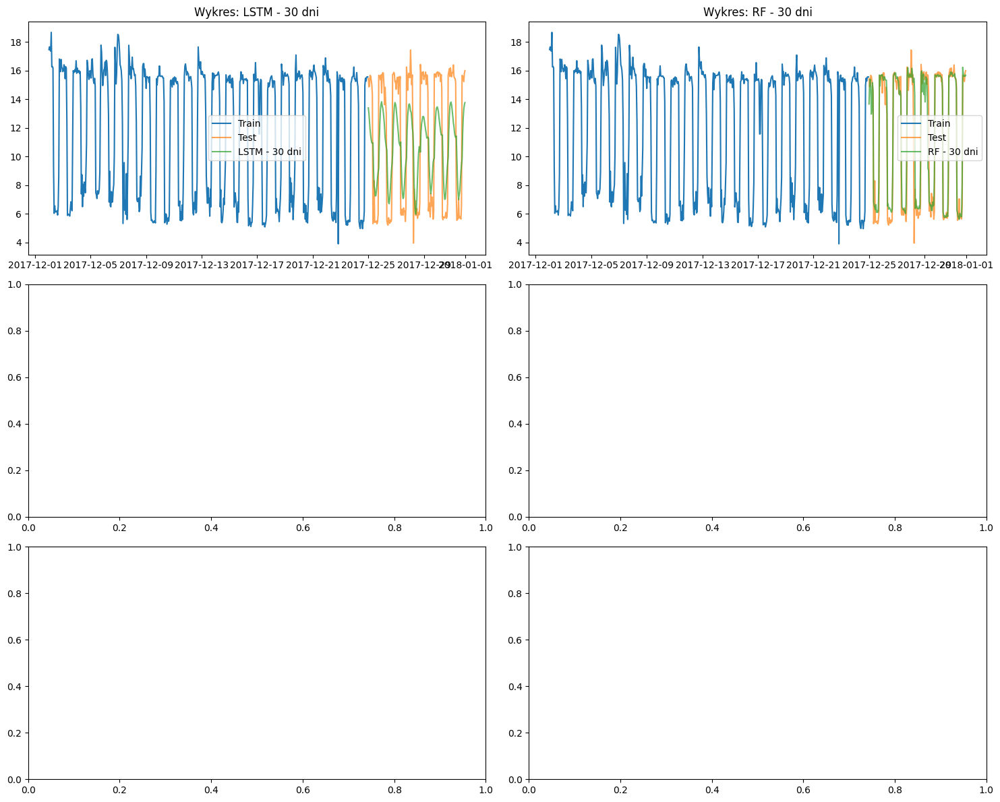


Metryki efektywności:
                            RMSE       MAE      MAPE  Czas treningu  \
Model                                                                 
Random Forest - 30 dni  1.511959  0.775689  0.096956       0.017232   
LSTM - 30 dni           3.197150  2.891727  0.302789       0.608985   

                        Czas predykcji  
Model                                   
Random Forest - 30 dni         0.93889  
LSTM - 30 dni                  0.33313  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-10-03 00:00:00               20.29    NaN    NaN    NaN    NaN    NaN   
2017-10-03 01:00:00               19.10  20.29    NaN    NaN    NaN    NaN   
2017-10-03 02:00:00               20.33  19.10  20.29    NaN    NaN    NaN   
2

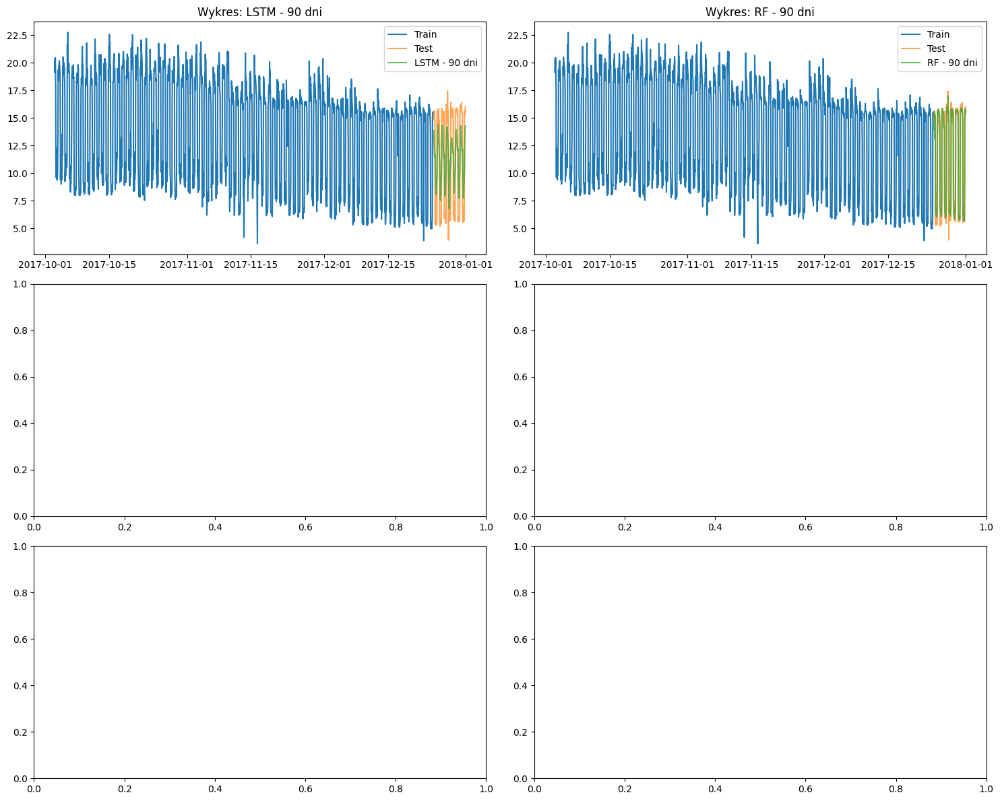


Metryki efektywności:
                            RMSE       MAE      MAPE  Czas treningu  \
Model                                                                 
Random Forest - 90 dni  1.548604  0.765927  0.093084       0.018925   
LSTM - 90 dni           3.218207  2.923726  0.334492       0.701911   

                        Czas predykcji  
Model                                   
Random Forest - 90 dni        3.343993  
LSTM - 90 dni                 0.339997  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-07-05 00:00:00               19.75    NaN    NaN    NaN    NaN    NaN   
2017-07-05 01:00:00               19.82  19.75    NaN    NaN    NaN    NaN   
2017-07-05 02:00:00               19.49  19.82  19.75    NaN    NaN    NaN   
2

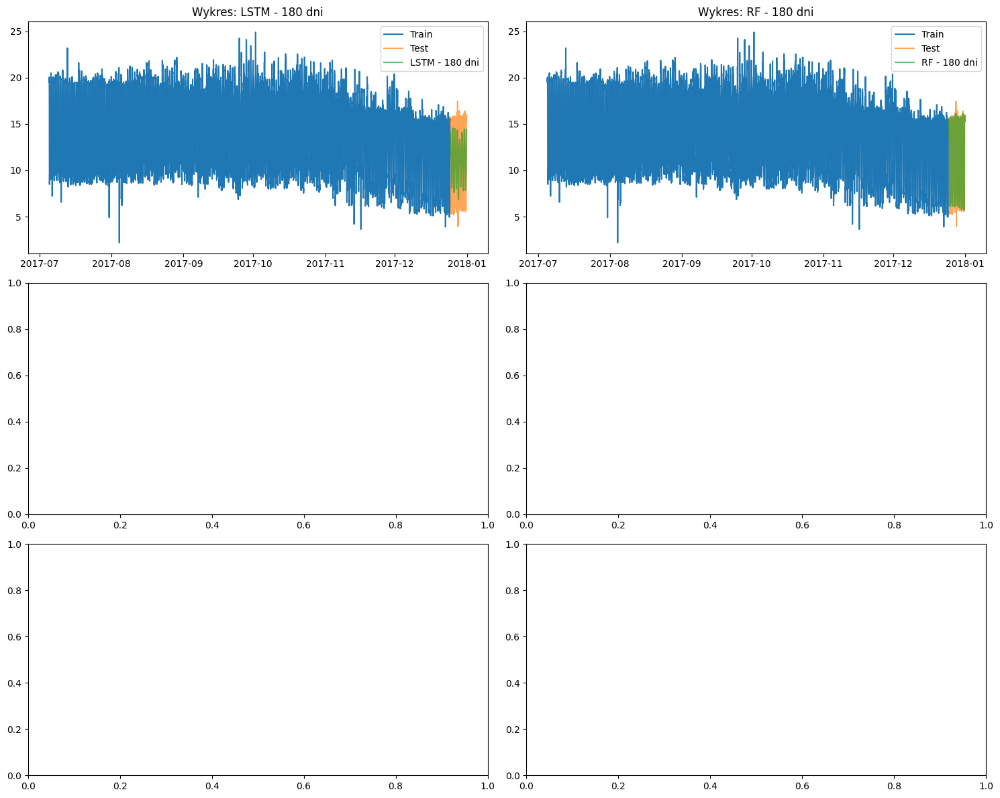


Metryki efektywności:
                             RMSE       MAE      MAPE  Czas treningu  \
Model                                                                  
Random Forest - 180 dni  1.487982  0.758967  0.092553       0.019953   
LSTM - 180 dni           3.202059  2.895702  0.333126       0.594229   

                         Czas predykcji  
Model                                    
Random Forest - 180 dni         8.12199  
LSTM - 180 dni                  0.33615  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-01-05 23:00:00               15.75    NaN    NaN    NaN    NaN    NaN   
2017-01-06 00:00:00               16.05  15.75    NaN    NaN    NaN    NaN   
2017-01-06 01:00:00               16.39  16.05  15.75    NaN    NaN    

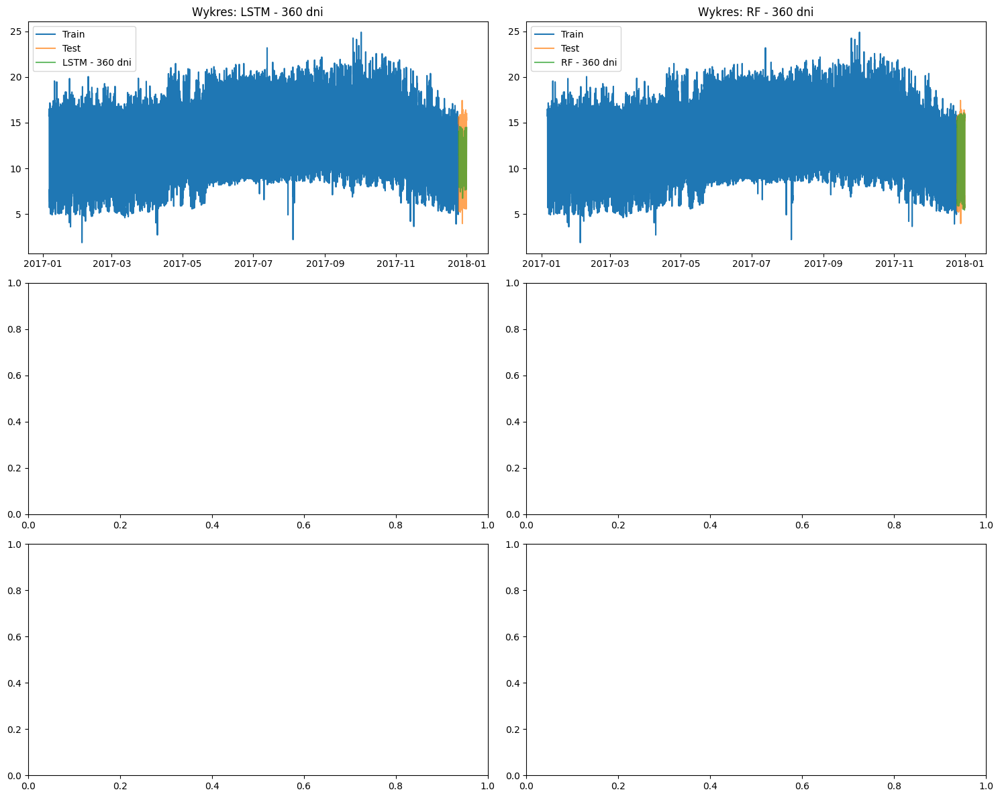


Metryki efektywności:
                             RMSE       MAE      MAPE  Czas treningu  \
Model                                                                  
Random Forest - 360 dni  1.486087  0.748249  0.090601       0.023175   
LSTM - 360 dni           3.160851  2.847442  0.323501       0.588340   

                         Czas predykcji  
Model                                    
Random Forest - 360 dni       18.014801  
LSTM - 360 dni                 0.359547  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2016-01-01 00:00:00               16.74    NaN    NaN    NaN    NaN    NaN   
2016-01-01 01:00:00               16.74  16.74    NaN    NaN    NaN    NaN   
2016-01-01 02:00:00               15.88  16.74  16.74    NaN    NaN    

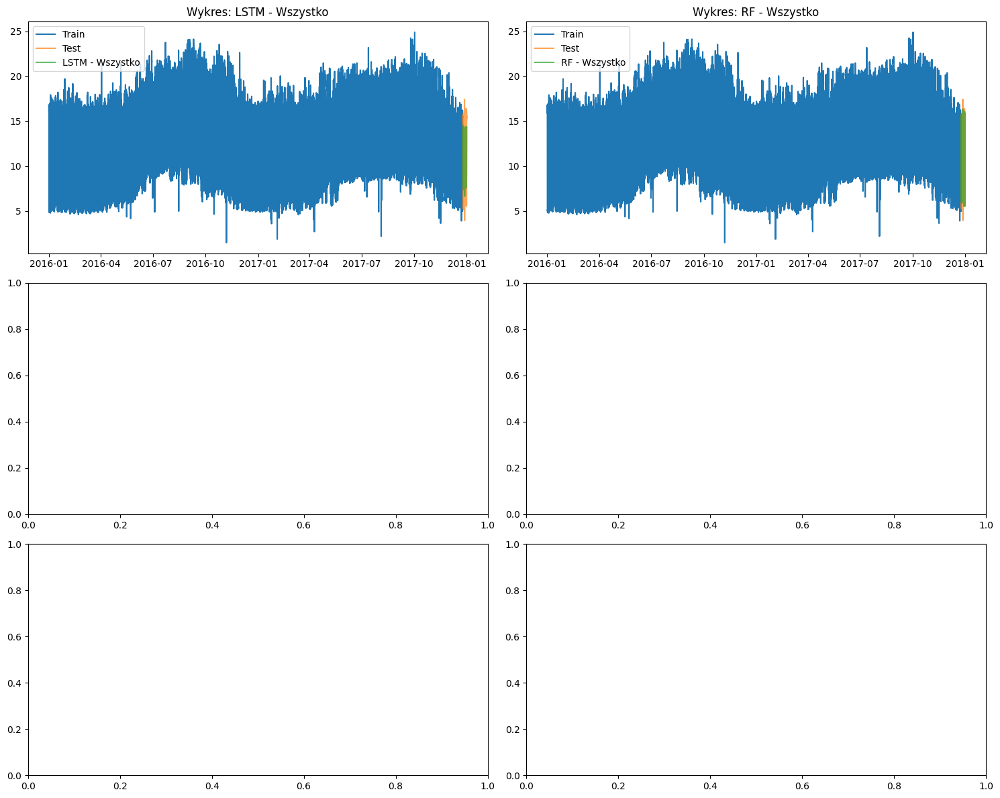


Metryki efektywności:
                              RMSE       MAE      MAPE  Czas treningu  \
Model                                                                   
Random Forest - Wszystko  1.494341  0.704851  0.085971       0.025039   
LSTM - Wszystko           3.171540  2.862717  0.321192       0.588898   

                          Czas predykcji  
Model                                     
Random Forest - Wszystko       39.128824  
LSTM - Wszystko                 0.331288  


====== Processing Building Hog_office_Alexis ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption   lag_1   lag_2   lag_3   lag_4  \
timestamp                                                                 
2017-12-02 00:00:00              16.571     NaN     NaN     NaN     NaN   
2017-12-02 01:00:00              16.630  16.571     NaN     NaN     NaN   
2017-12-02 02:00:00  

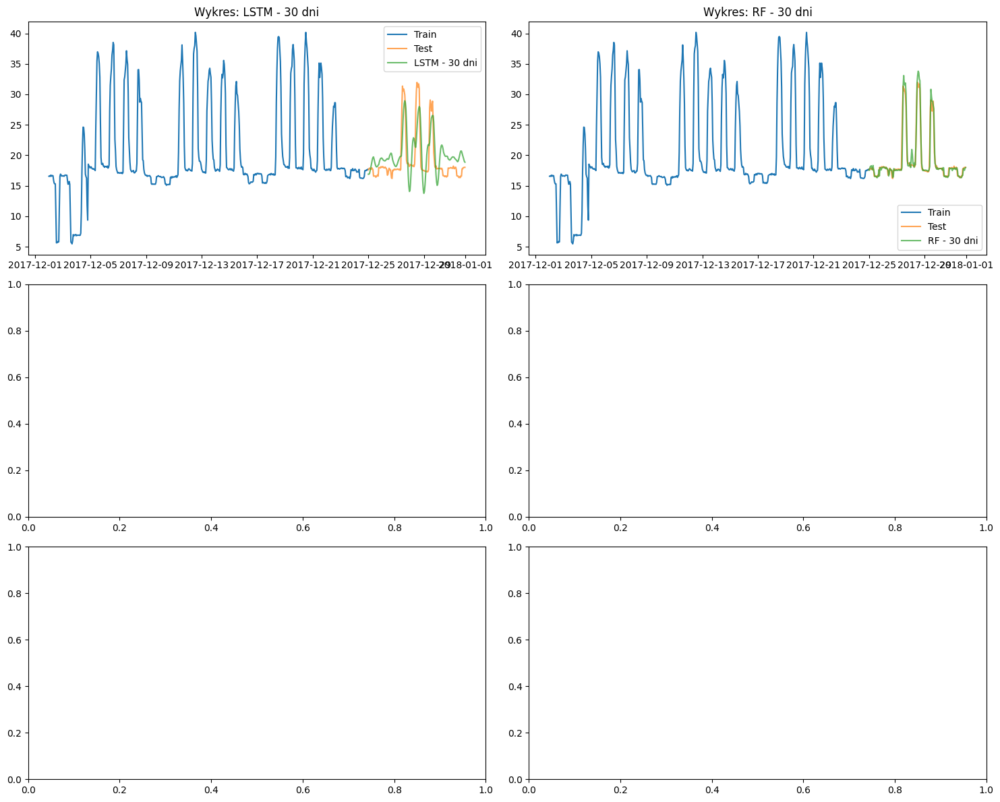


Metryki efektywności:
                            RMSE       MAE      MAPE  Czas treningu  \
Model                                                                 
Random Forest - 30 dni  0.916737  0.519565  0.023997       0.015126   
LSTM - 30 dni           2.928068  2.460186  0.127050       0.608985   

                        Czas predykcji  
Model                                   
Random Forest - 30 dni        0.914918  
LSTM - 30 dni                 0.345956  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption   lag_1   lag_2   lag_3   lag_4  \
timestamp                                                                 
2017-10-02 22:00:00              10.053     NaN     NaN     NaN     NaN   
2017-10-02 23:00:00               7.793  10.053     NaN     NaN     NaN   
2017-10-03 00:00:00               8.772   7.793  10.053     NaN     NaN   
2017-10-03 01:00

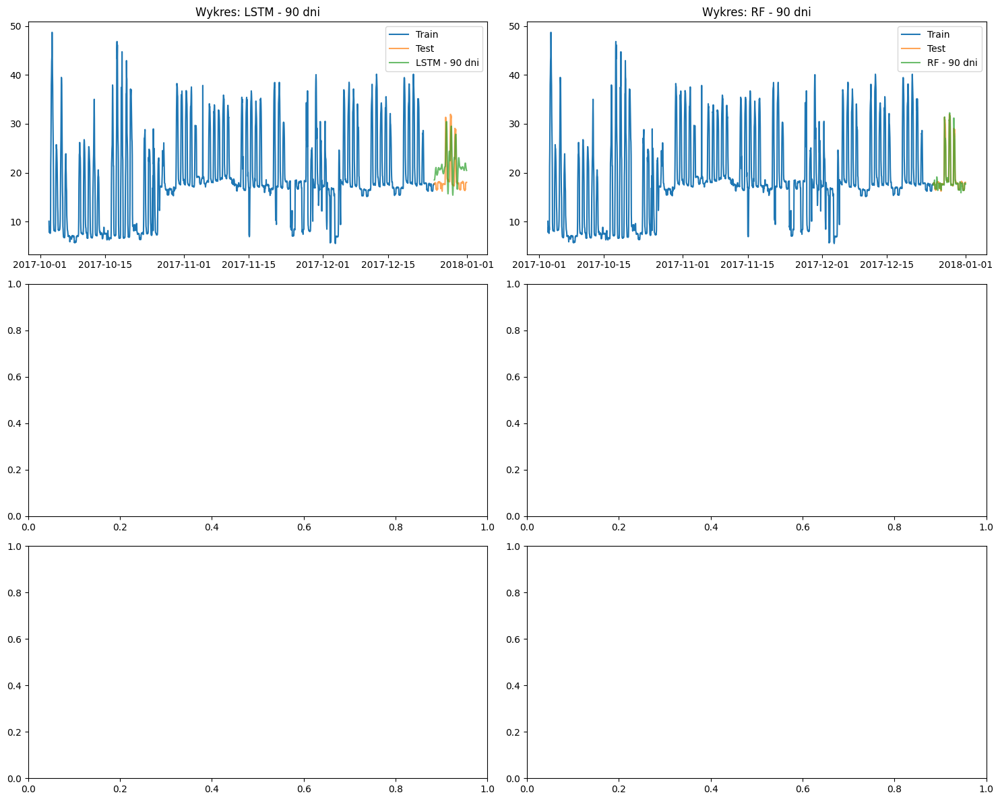


Metryki efektywności:
                            RMSE       MAE      MAPE  Czas treningu  \
Model                                                                 
Random Forest - 90 dni  1.019610  0.577424  0.026860       0.018192   
LSTM - 90 dni           3.607735  3.249065  0.174791       0.604567   

                        Czas predykcji  
Model                                   
Random Forest - 90 dni        4.011952  
LSTM - 90 dni                 0.338801  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption   lag_1   lag_2   lag_3   lag_4  \
timestamp                                                                 
2017-07-04 22:00:00              12.544     NaN     NaN     NaN     NaN   
2017-07-04 23:00:00              14.102  12.544     NaN     NaN     NaN   
2017-07-05 00:00:00              11.654  14.102  12.544     NaN     NaN   
2017-07-05 01:00

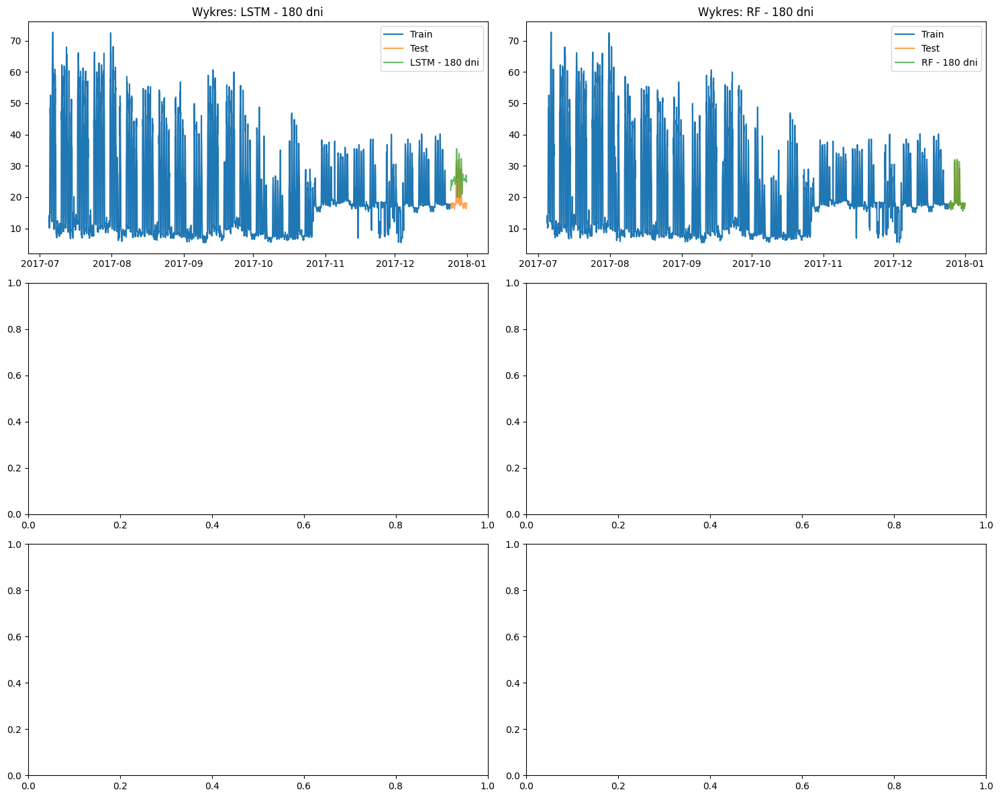


Metryki efektywności:
                             RMSE       MAE      MAPE  Czas treningu  \
Model                                                                  
Random Forest - 180 dni  0.906407  0.541761  0.026018       0.020324   
LSTM - 180 dni           7.334903  6.875588  0.380703       0.585938   

                         Czas predykcji  
Model                                    
Random Forest - 180 dni        9.118774  
LSTM - 180 dni                 0.336342  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption   lag_1   lag_2   lag_3   lag_4  \
timestamp                                                                 
2017-01-05 22:00:00              18.405     NaN     NaN     NaN     NaN   
2017-01-05 23:00:00              18.410  18.405     NaN     NaN     NaN   
2017-01-06 00:00:00              18.231  18.410  18.405     NaN     NaN   
2017-01-

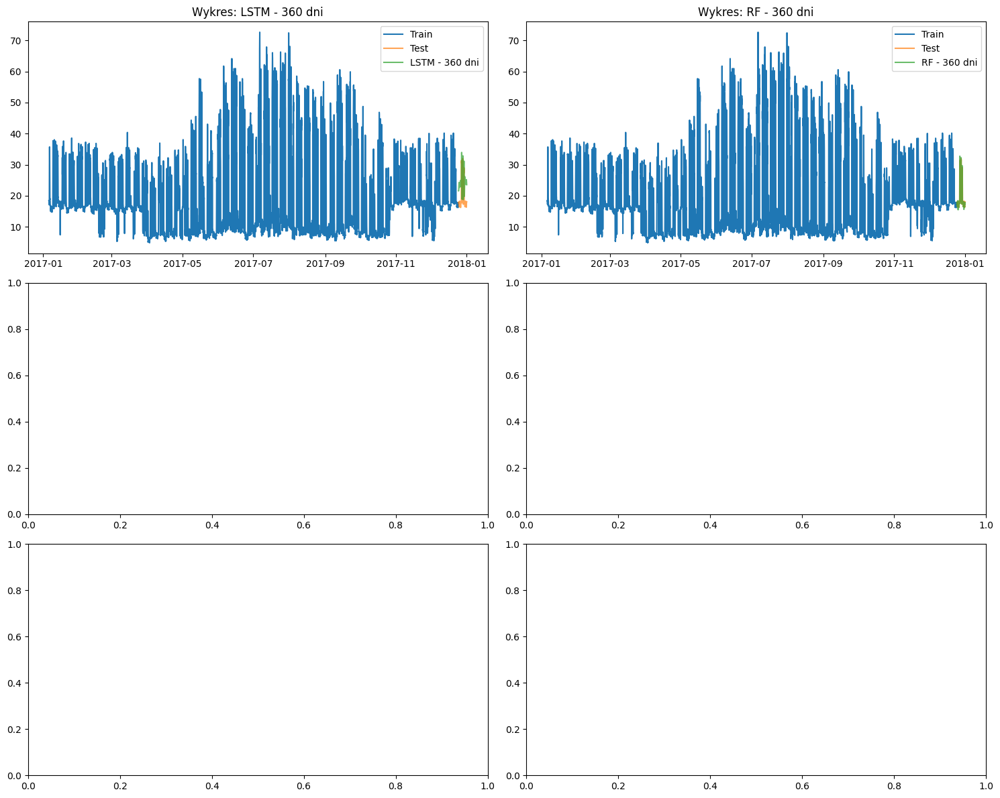


Metryki efektywności:
                             RMSE       MAE      MAPE  Czas treningu  \
Model                                                                  
Random Forest - 360 dni  0.820030  0.467534  0.022844       0.018936   
LSTM - 360 dni           6.126228  5.690822  0.314806       0.597305   

                         Czas predykcji  
Model                                    
Random Forest - 360 dni       20.880223  
LSTM - 360 dni                 0.338252  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption   lag_1   lag_2   lag_3   lag_4  \
timestamp                                                                 
2016-01-01 00:00:00              19.970     NaN     NaN     NaN     NaN   
2016-01-01 01:00:00              19.970  19.970     NaN     NaN     NaN   
2016-01-01 02:00:00              19.987  19.970  19.970     NaN     NaN   
2016-01-

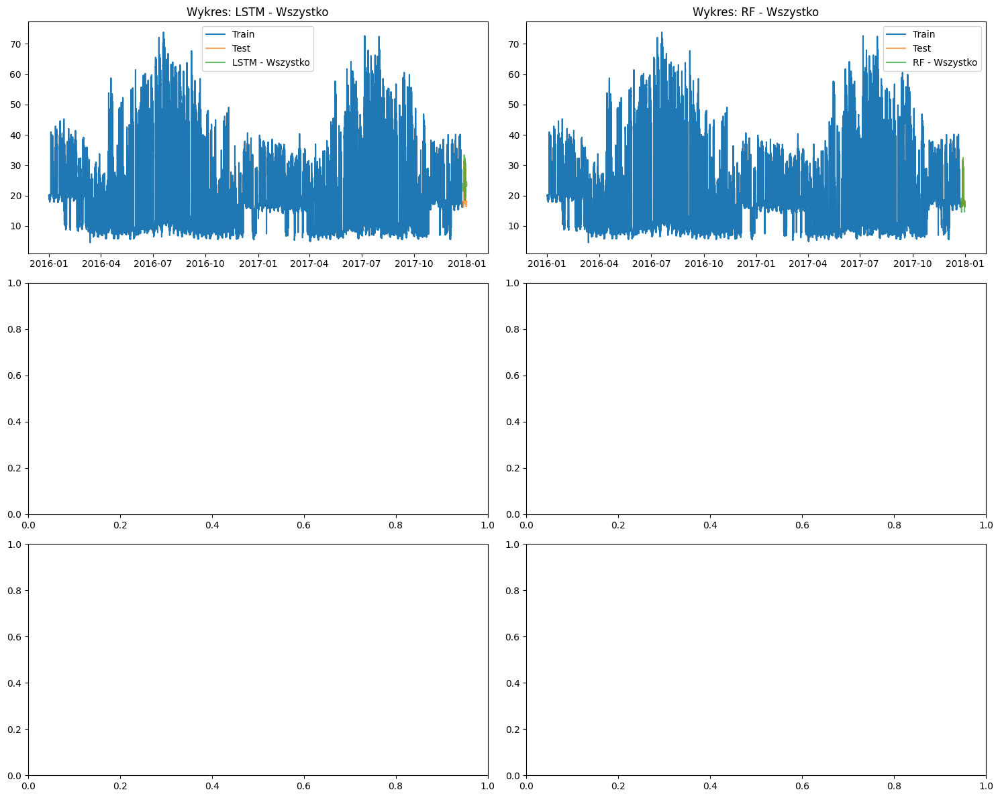


Metryki efektywności:
                              RMSE       MAE      MAPE  Czas treningu  \
Model                                                                   
Random Forest - Wszystko  0.815330  0.463241  0.022897       0.029593   
LSTM - Wszystko           5.721345  5.293972  0.292568       0.588093   

                          Czas predykcji  
Model                                     
Random Forest - Wszystko     9606.401542  
LSTM - Wszystko                 0.334737  


====== Processing Building Hog_office_Guadalupe ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 60ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-12-02 00:00:00                36.0    NaN    NaN    NaN    NaN    NaN   
2017-12-02 01:00:00                35.0   36.0    NaN    NaN    NaN    NaN   
2017-1

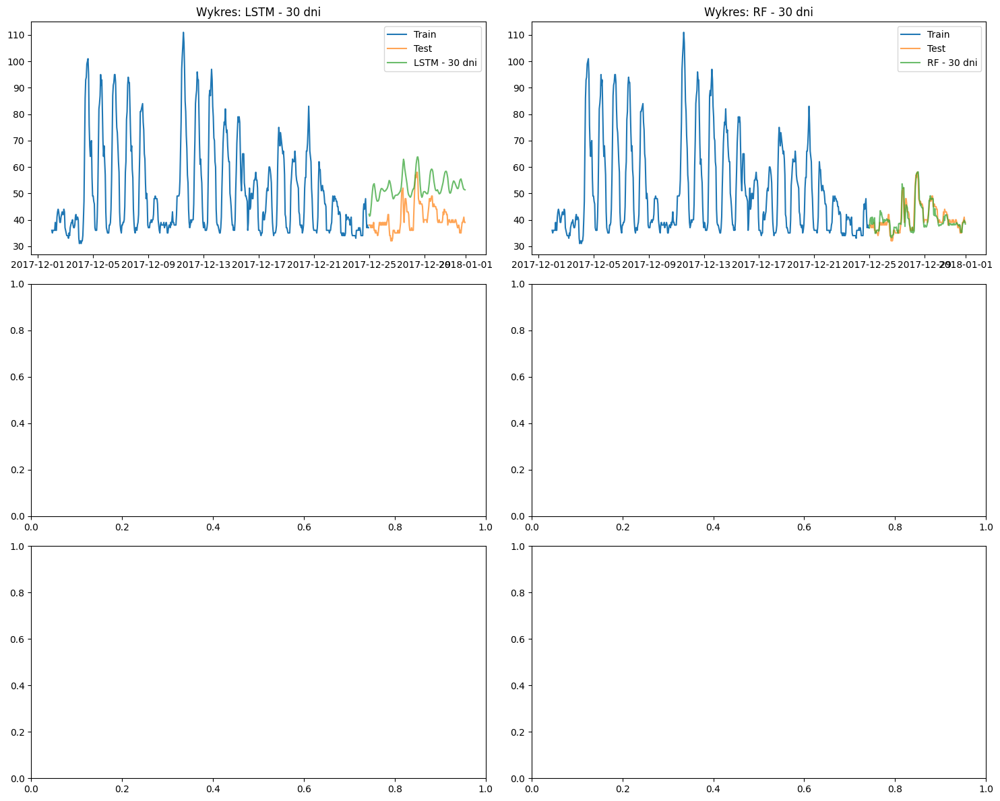


Metryki efektywności:
                             RMSE        MAE    MAPE  Czas treningu  \
Model                                                                 
Random Forest - 30 dni   2.331513   1.758214  0.0433       0.020902   
LSTM - 30 dni           12.534689  11.878717  0.3045       1.754434   

                        Czas predykcji  
Model                                   
Random Forest - 30 dni        0.789024  
LSTM - 30 dni                 0.657886  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 129ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-10-02 22:00:00                36.0    NaN    NaN    NaN    NaN    NaN   
2017-10-02 23:00:00                34.0   36.0    NaN    NaN    NaN    NaN   
2017-10-03 00:00:00                30.0   34.0   36.0    NaN    NaN    NaN   


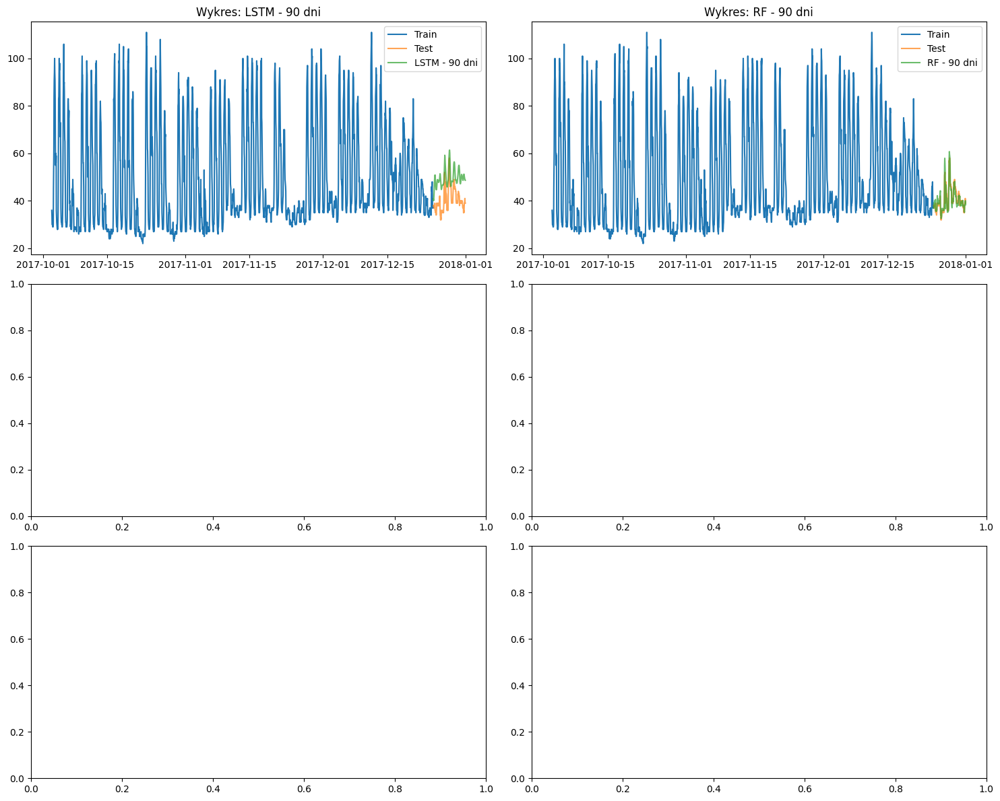


Metryki efektywności:
                            RMSE       MAE      MAPE  Czas treningu  \
Model                                                                 
Random Forest - 90 dni  2.298522  1.642143  0.039753       0.056646   
LSTM - 90 dni           9.735295  9.036109  0.232976       0.914267   

                        Czas predykcji  
Model                                   
Random Forest - 90 dni        2.925390  
LSTM - 90 dni                 0.985133  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-07-04 22:00:00                23.0    NaN    NaN    NaN    NaN    NaN   
2017-07-04 23:00:00                25.0   23.0    NaN    NaN    NaN    NaN   
2017-07-05 00:00:00                23.0   25.0   23.0    NaN    NaN    NaN   
2

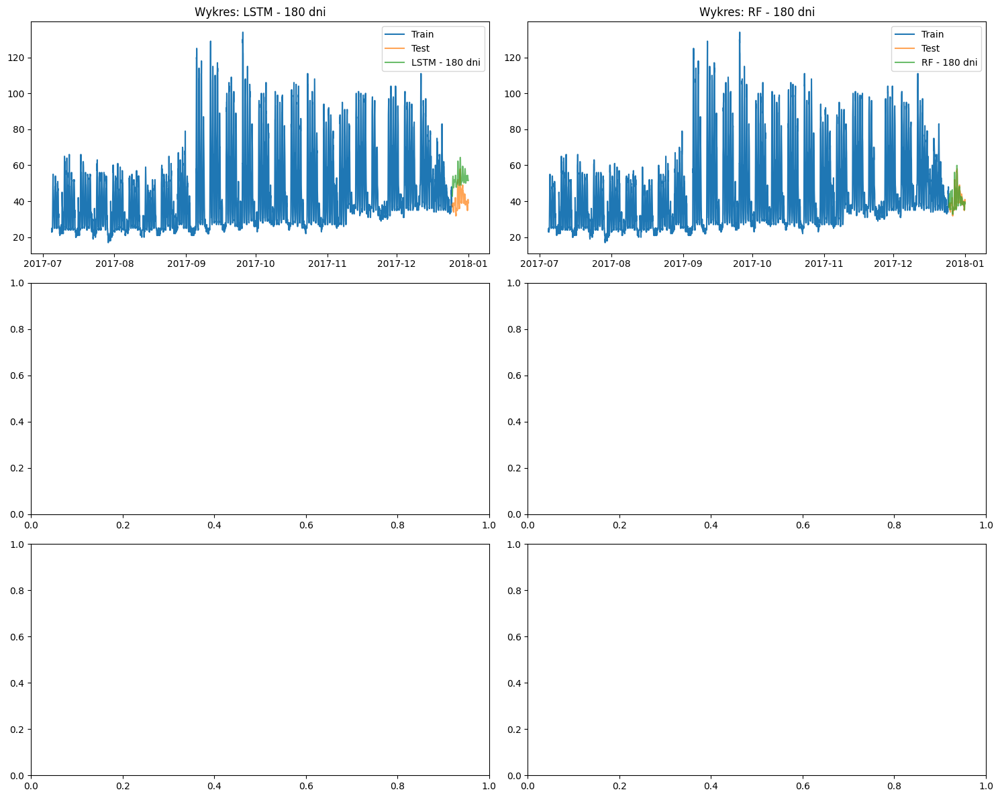


Metryki efektywności:
                              RMSE        MAE      MAPE  Czas treningu  \
Model                                                                    
Random Forest - 180 dni   2.536884   1.830655  0.045086       0.029003   
LSTM - 180 dni           12.524581  11.946950  0.305984       0.835434   

                         Czas predykcji  
Model                                    
Random Forest - 180 dni        4.770065  
LSTM - 180 dni                 0.524434  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-01-05 22:00:00                37.0    NaN    NaN    NaN    NaN    NaN   
2017-01-05 23:00:00                36.0   37.0    NaN    NaN    NaN    NaN   
2017-01-06 00:00:00                35.0   36.0   37.0    NaN   

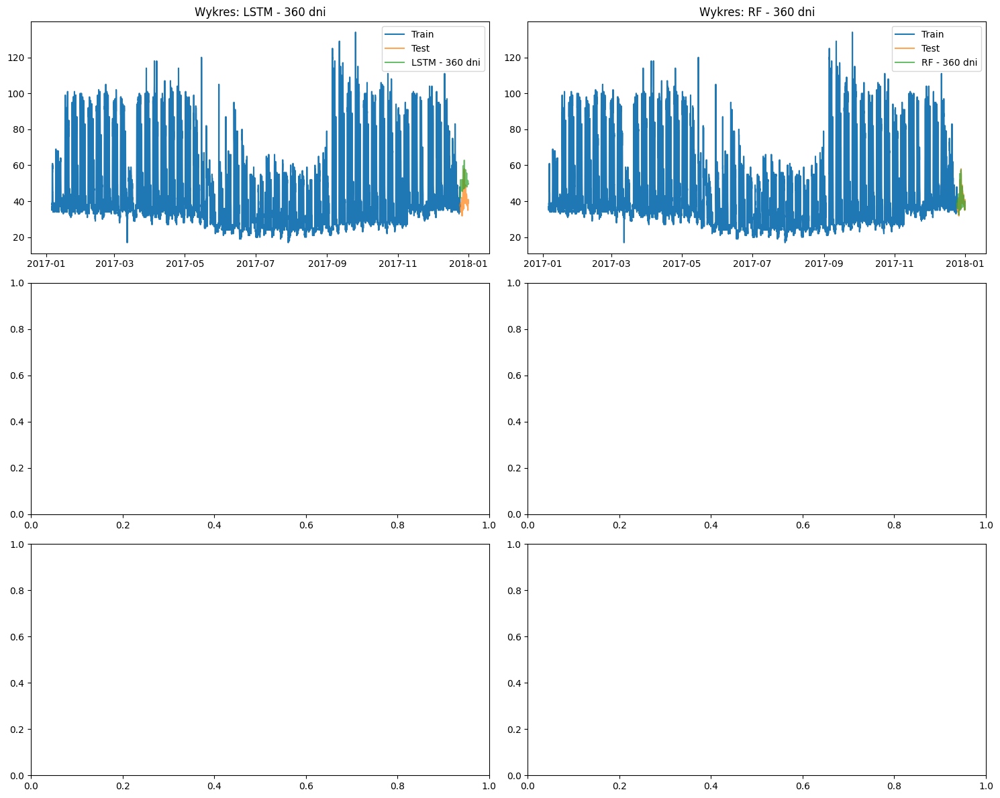


Metryki efektywności:
                              RMSE       MAE      MAPE  Czas treningu  \
Model                                                                   
Random Forest - 360 dni   2.140196  1.588036  0.038851       0.034577   
LSTM - 360 dni           10.561813  9.952276  0.255871       0.687025   

                         Czas predykcji  
Model                                    
Random Forest - 360 dni       10.216302  
LSTM - 360 dni                 0.384352  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2016-01-01 00:00:00                45.0    NaN    NaN    NaN    NaN    NaN   
2016-01-01 01:00:00                45.0   45.0    NaN    NaN    NaN    NaN   
2016-01-01 02:00:00                45.0   45.0   45.0    NaN    NaN

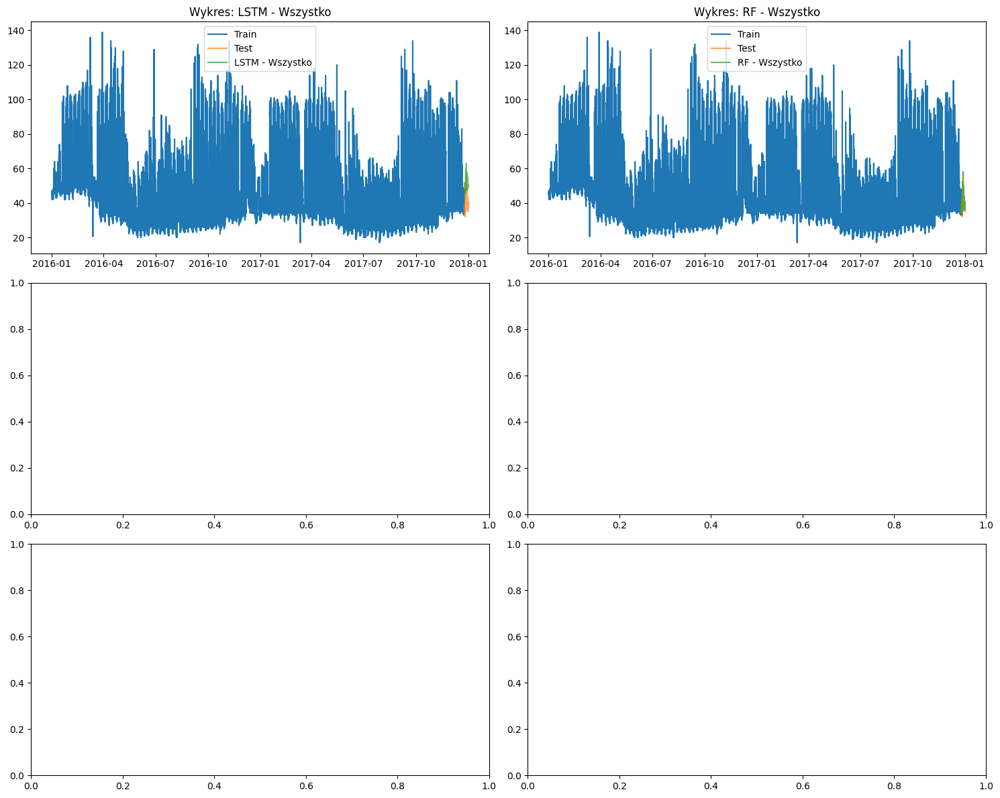


Metryki efektywności:
                               RMSE       MAE      MAPE  Czas treningu  \
Model                                                                    
Random Forest - Wszystko   2.004829  1.428542  0.035236       0.031984   
LSTM - Wszystko           10.429949  9.839045  0.252943       0.723759   

                          Czas predykcji  
Model                                     
Random Forest - Wszystko       21.561216  
LSTM - Wszystko                 0.341556  


====== Processing Building Hog_office_Leanne ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption    lag_1    lag_2    lag_3    lag_4  \
timestamp                                                                     
2017-12-02 00:00:00             115.657      NaN      NaN      NaN      NaN   
2017-12-02 01:00:00             117.297  115.657      NaN      NaN      NaN   
2

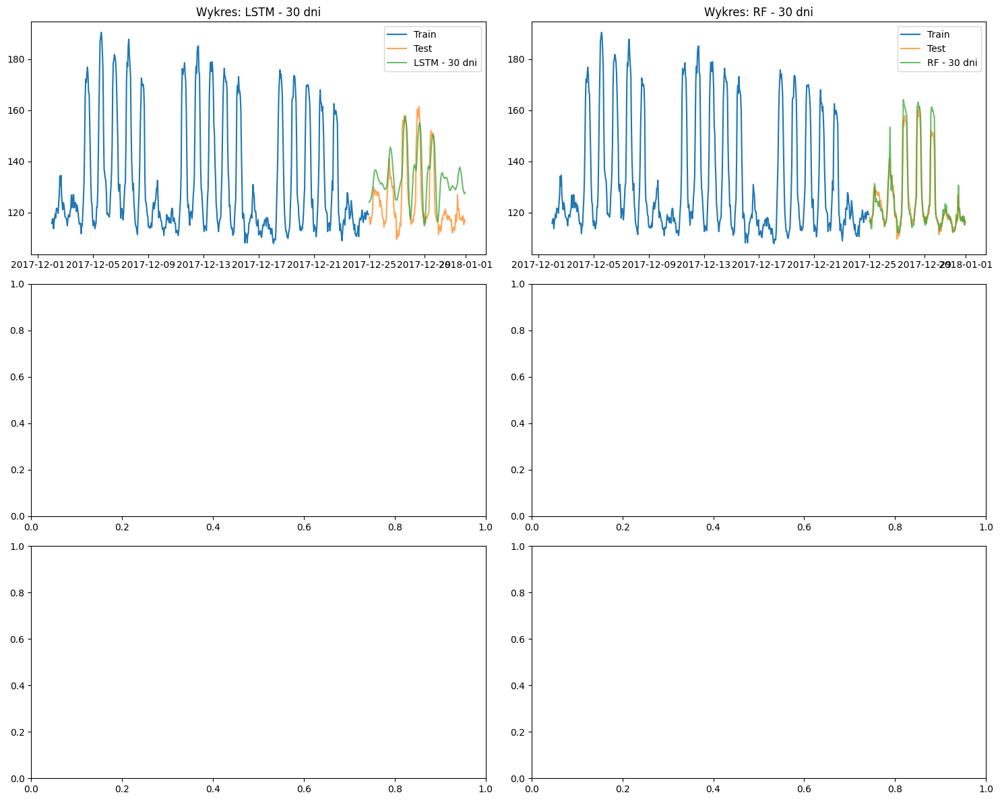


Metryki efektywności:
                             RMSE        MAE      MAPE  Czas treningu  \
Model                                                                   
Random Forest - 30 dni   4.607406   3.044660  0.023171       0.017343   
LSTM - 30 dni           11.732517  10.374013  0.085597       0.619354   

                        Czas predykcji  
Model                                   
Random Forest - 30 dni        0.791897  
LSTM - 30 dni                 0.349794  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption    lag_1    lag_2    lag_3    lag_4  \
timestamp                                                                     
2017-10-02 21:00:00             123.833      NaN      NaN      NaN      NaN   
2017-10-02 22:00:00             124.016  123.833      NaN      NaN      NaN   
2017-10-02 23:00:00             117.167  124.016  123.833      NaN 

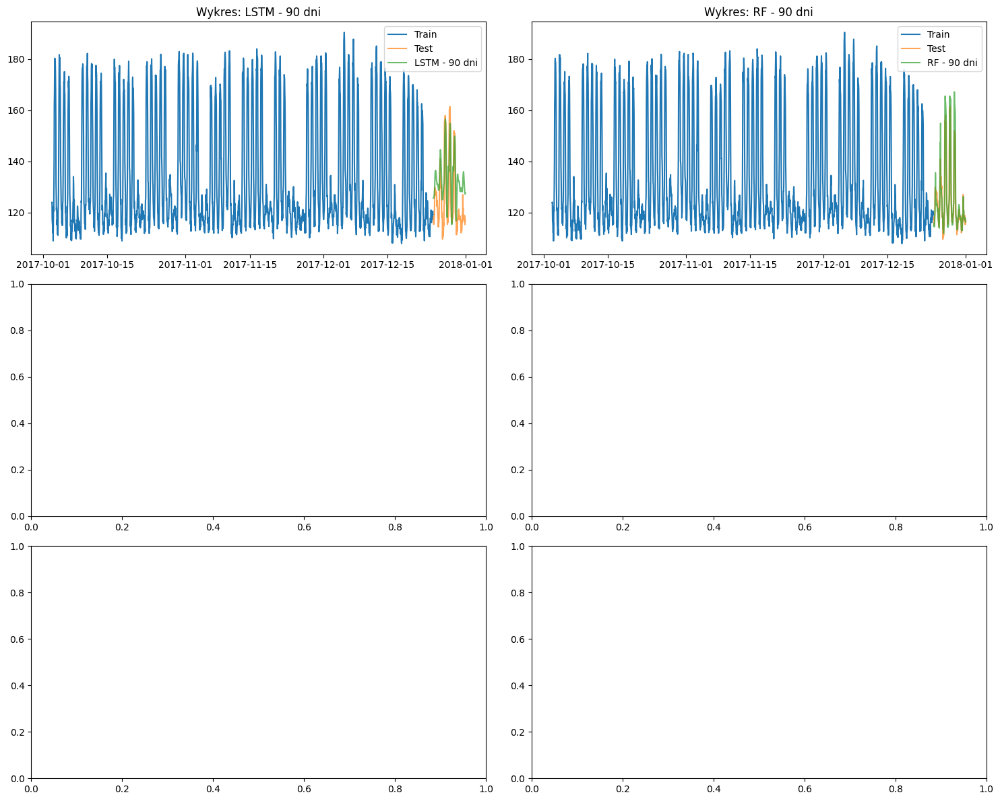


Metryki efektywności:
                             RMSE        MAE      MAPE  Czas treningu  \
Model                                                                   
Random Forest - 90 dni   4.767716   3.211085  0.024116       0.022058   
LSTM - 90 dni           11.359732  10.083348  0.083104       0.690034   

                        Czas predykcji  
Model                                   
Random Forest - 90 dni        3.570354  
LSTM - 90 dni                 0.339636  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption    lag_1    lag_2    lag_3    lag_4  \
timestamp                                                                     
2017-07-04 21:00:00             121.350      NaN      NaN      NaN      NaN   
2017-07-04 22:00:00             123.329  121.350      NaN      NaN      NaN   
2017-07-04 23:00:00             118.624  123.329  121.350      NaN 

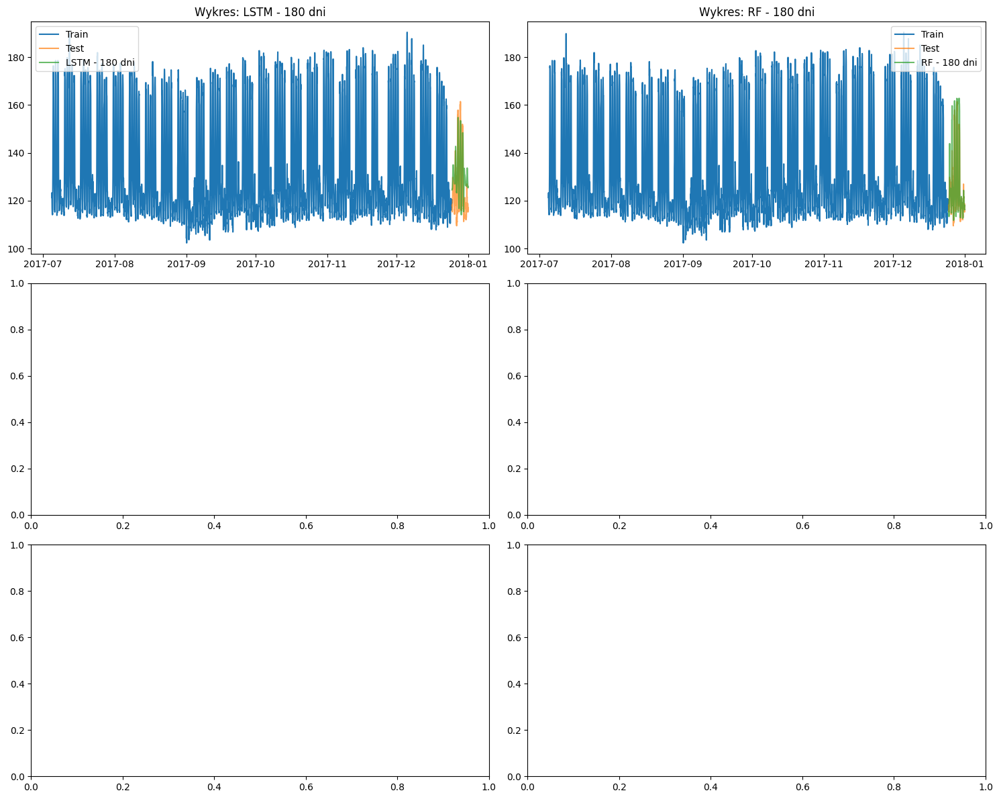


Metryki efektywności:
                              RMSE       MAE      MAPE  Czas treningu  \
Model                                                                   
Random Forest - 180 dni   4.817553  2.966534  0.022406       0.023680   
LSTM - 180 dni           10.144084  8.949126  0.073343       0.692846   

                         Czas predykcji  
Model                                    
Random Forest - 180 dni       10.178785  
LSTM - 180 dni                 0.376674  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption    lag_1    lag_2    lag_3    lag_4  \
timestamp                                                                     
2017-01-05 21:00:00             133.425      NaN      NaN      NaN      NaN   
2017-01-05 22:00:00             129.538  133.425      NaN      NaN      NaN   
2017-01-05 23:00:00             119.120  129.538  133.425      

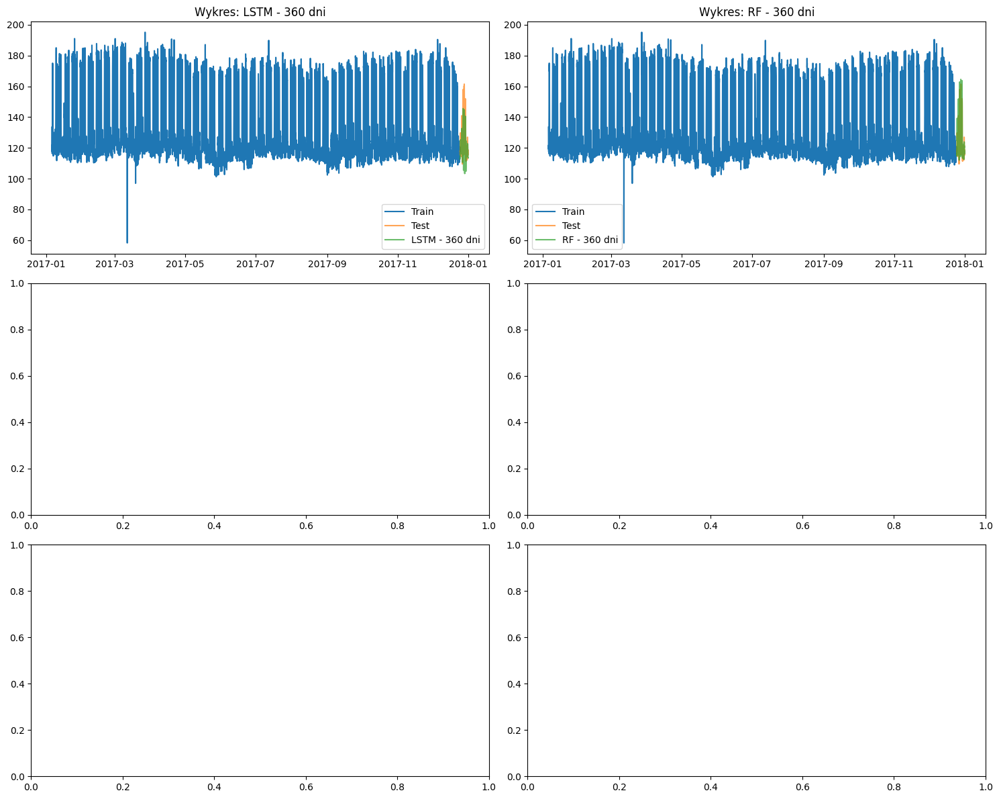


Metryki efektywności:
                             RMSE       MAE      MAPE  Czas treningu  \
Model                                                                  
Random Forest - 360 dni  4.218468  2.686402  0.020372       0.025245   
LSTM - 360 dni           7.873600  5.799868  0.044119       0.650464   

                         Czas predykcji  
Model                                    
Random Forest - 360 dni       20.970991  
LSTM - 360 dni                 0.409275  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption    lag_1    lag_2    lag_3    lag_4  \
timestamp                                                                     
2016-01-01 00:00:00             110.911      NaN      NaN      NaN      NaN   
2016-01-01 01:00:00             110.911  110.911      NaN      NaN      NaN   
2016-01-01 02:00:00             111.210  110.911  110.911      NaN 

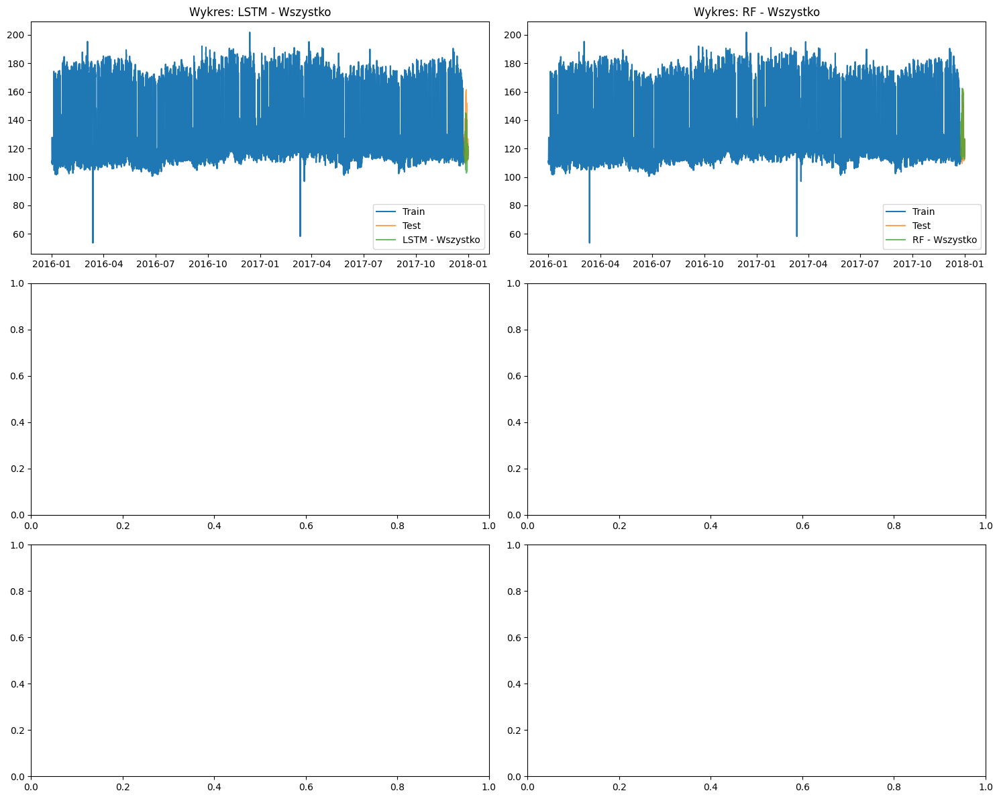


Metryki efektywności:
                              RMSE       MAE      MAPE  Czas treningu  \
Model                                                                   
Random Forest - Wszystko  3.679903  2.345713  0.018060       0.030608   
LSTM - Wszystko           8.107900  5.995863  0.045585       0.654636   

                          Czas predykcji  
Model                                     
Random Forest - Wszystko       47.168054  
LSTM - Wszystko                 0.363111  


====== Processing Building Hog_office_Leon ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-12-02 00:00:00                 4.6    NaN    NaN    NaN    NaN    NaN   
2017-12-02 01:00:00                 4.3    4.6    NaN    NaN    NaN    NaN   
2017-12-02 

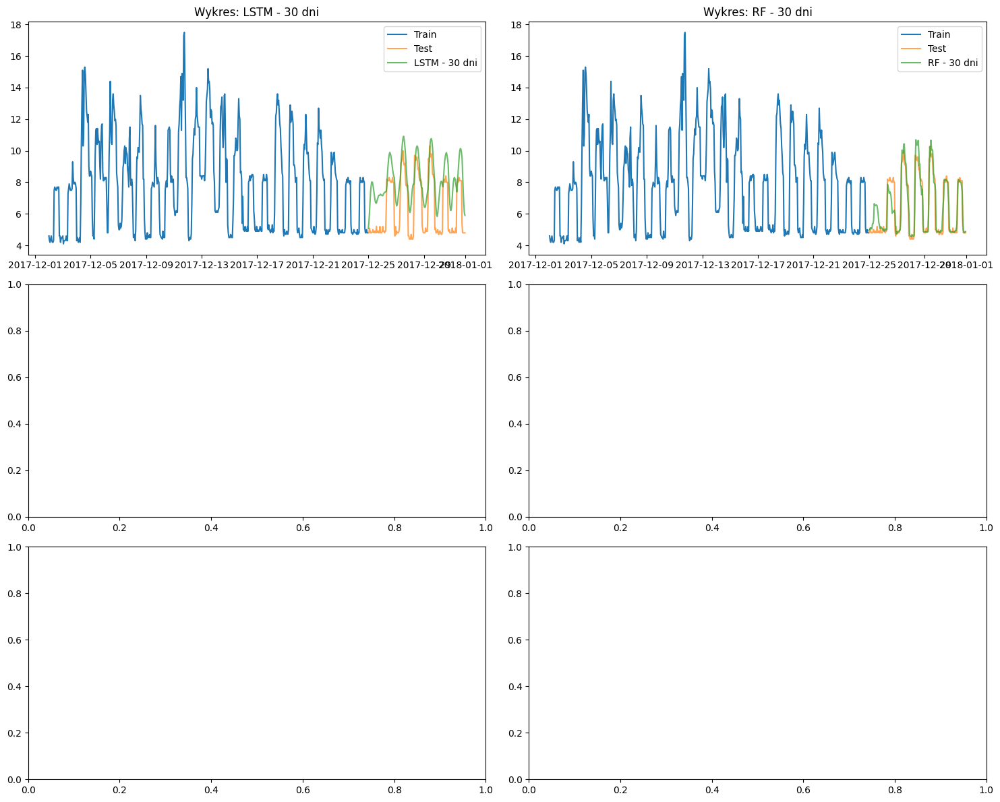


Metryki efektywności:
                            RMSE       MAE      MAPE  Czas treningu  \
Model                                                                 
Random Forest - 30 dni  0.745693  0.509042  0.079789       0.018061   
LSTM - 30 dni           1.967287  1.728379  0.321598       0.637505   

                        Czas predykcji  
Model                                   
Random Forest - 30 dni        0.710216  
LSTM - 30 dni                 0.379671  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-10-02 22:00:00                 5.8    NaN    NaN    NaN    NaN    NaN   
2017-10-02 23:00:00                 6.0    5.8    NaN    NaN    NaN    NaN   
2017-10-03 00:00:00                 5.8    6.0    5.8    NaN    NaN    NaN   
2

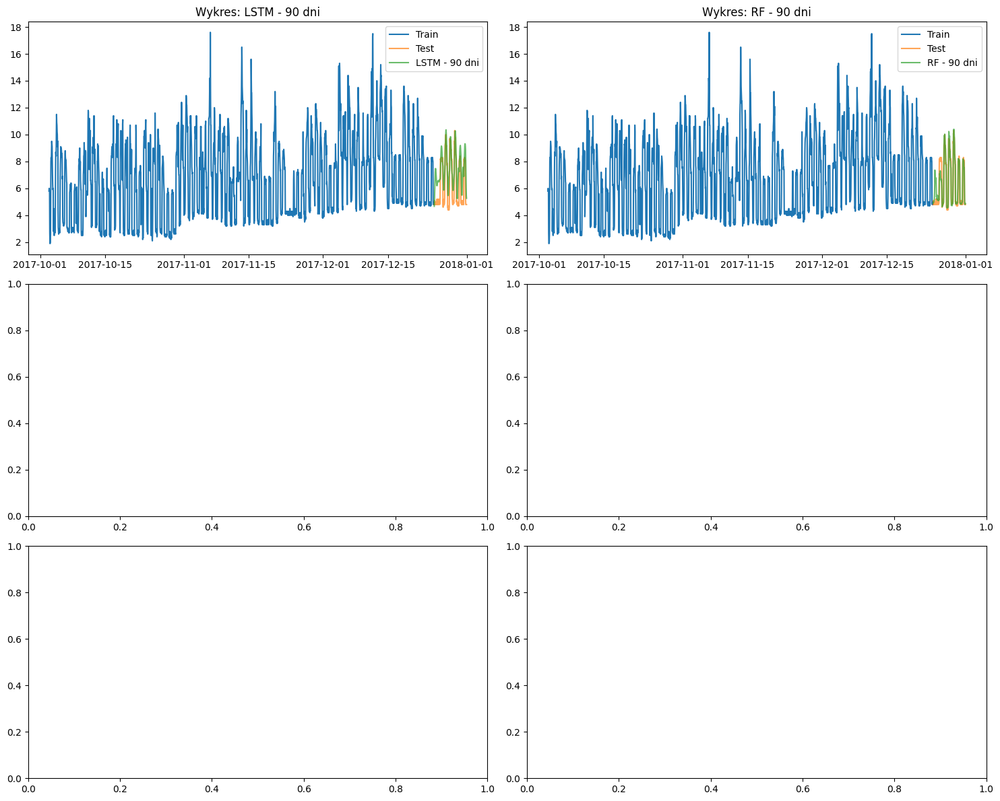


Metryki efektywności:
                            RMSE       MAE      MAPE  Czas treningu  \
Model                                                                 
Random Forest - 90 dni  0.723400  0.483714  0.078765       0.021090   
LSTM - 90 dni           1.473312  1.240925  0.232260       0.664728   

                        Czas predykcji  
Model                                   
Random Forest - 90 dni        2.864892  
LSTM - 90 dni                 0.380867  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-07-04 22:00:00                 3.8    NaN    NaN    NaN    NaN    NaN   
2017-07-04 23:00:00                 3.5    3.8    NaN    NaN    NaN    NaN   
2017-07-05 00:00:00                 3.3    3.5    3.8    NaN    NaN    NaN   
2

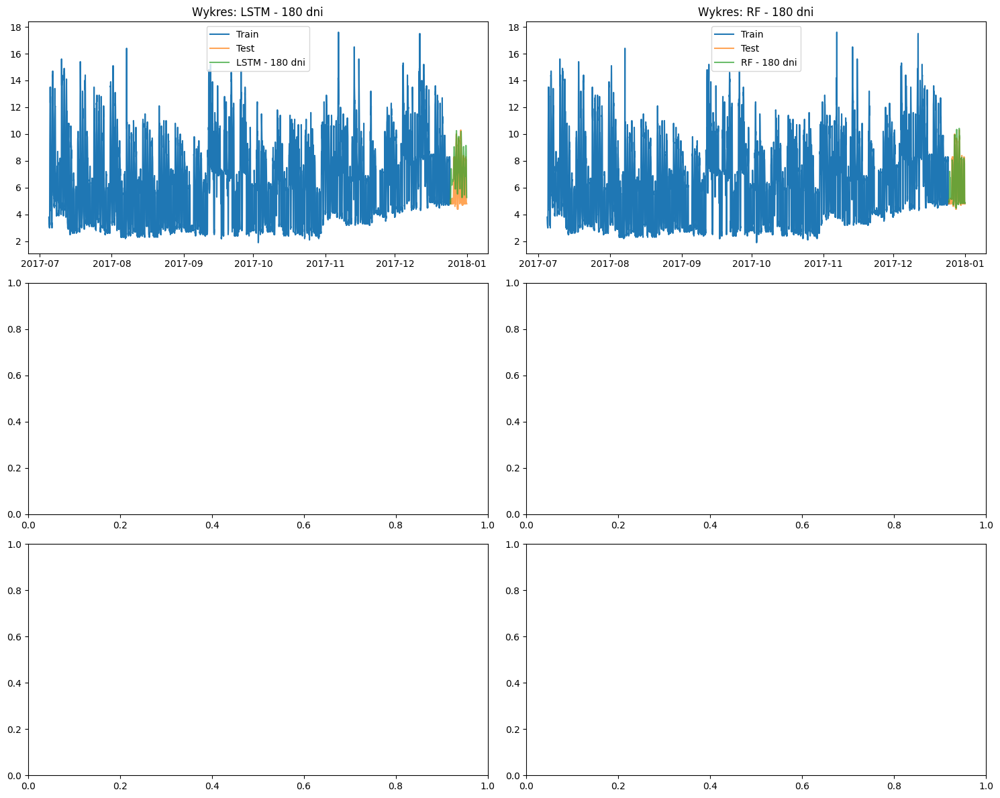


Metryki efektywności:
                             RMSE       MAE      MAPE  Czas treningu  \
Model                                                                  
Random Forest - 180 dni  0.655508  0.425131  0.070792       0.021622   
LSTM - 180 dni           1.450211  1.217301  0.228875       0.647450   

                         Czas predykcji  
Model                                    
Random Forest - 180 dni        6.173993  
LSTM - 180 dni                 0.382479  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-01-05 22:00:00                 4.2    NaN    NaN    NaN    NaN    NaN   
2017-01-05 23:00:00                 4.3    4.2    NaN    NaN    NaN    NaN   
2017-01-06 00:00:00                 4.2    4.3    4.2    NaN    NaN    

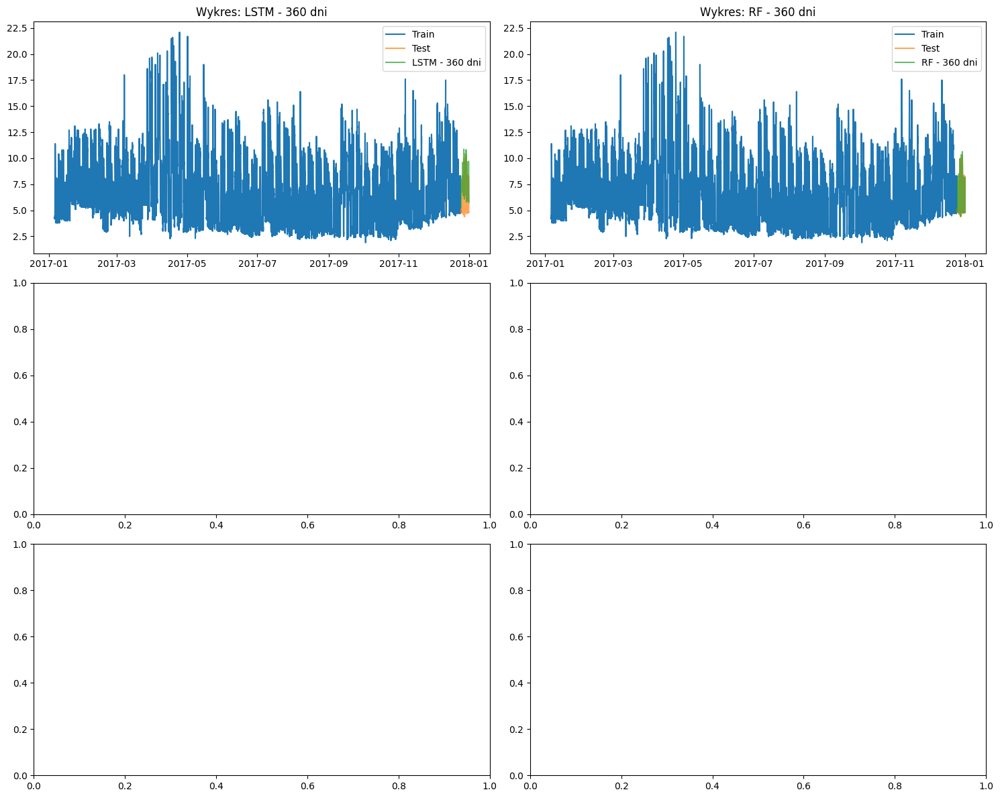


Metryki efektywności:
                             RMSE       MAE      MAPE  Czas treningu  \
Model                                                                  
Random Forest - 360 dni  0.673163  0.392762  0.065854       0.025768   
LSTM - 360 dni           1.853070  1.622869  0.303149       0.670059   

                         Czas predykcji  
Model                                    
Random Forest - 360 dni       13.603401  
LSTM - 360 dni                 0.395874  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2016-01-01 00:00:00                 3.5    NaN    NaN    NaN    NaN    NaN   
2016-01-01 01:00:00                 3.5    3.5    NaN    NaN    NaN    NaN   
2016-01-01 02:00:00                 3.2    3.5    3.5    NaN    NaN    

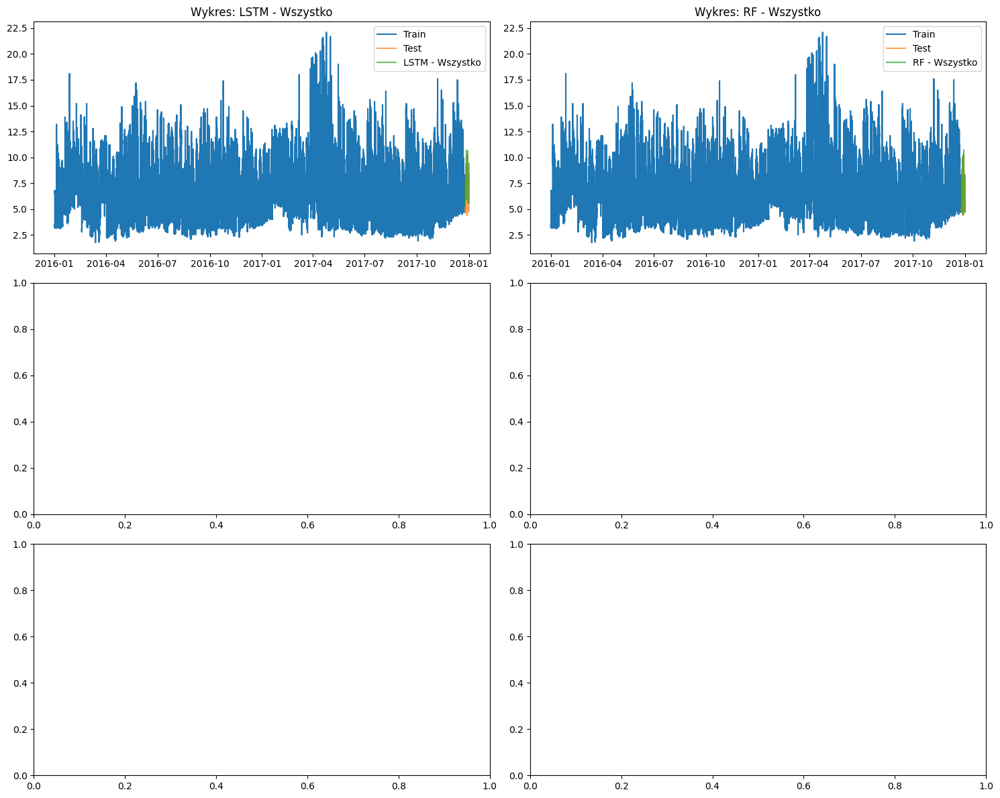


Metryki efektywności:
                              RMSE       MAE      MAPE  Czas treningu  \
Model                                                                   
Random Forest - Wszystko  0.590674  0.320714  0.054271       0.030991   
LSTM - Wszystko           1.695551  1.465940  0.274751       0.655103   

                          Czas predykcji  
Model                                     
Random Forest - Wszystko       29.607440  
LSTM - Wszystko                 0.391069  


====== Processing Building Hog_office_Mari ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption   lag_1   lag_2   lag_3   lag_4  \
timestamp                                                                 
2017-12-02 00:00:00              28.211     NaN     NaN     NaN     NaN   
2017-12-02 01:00:00              27.763  28.211     NaN     NaN     NaN   
2017-12-02 02:00:00    

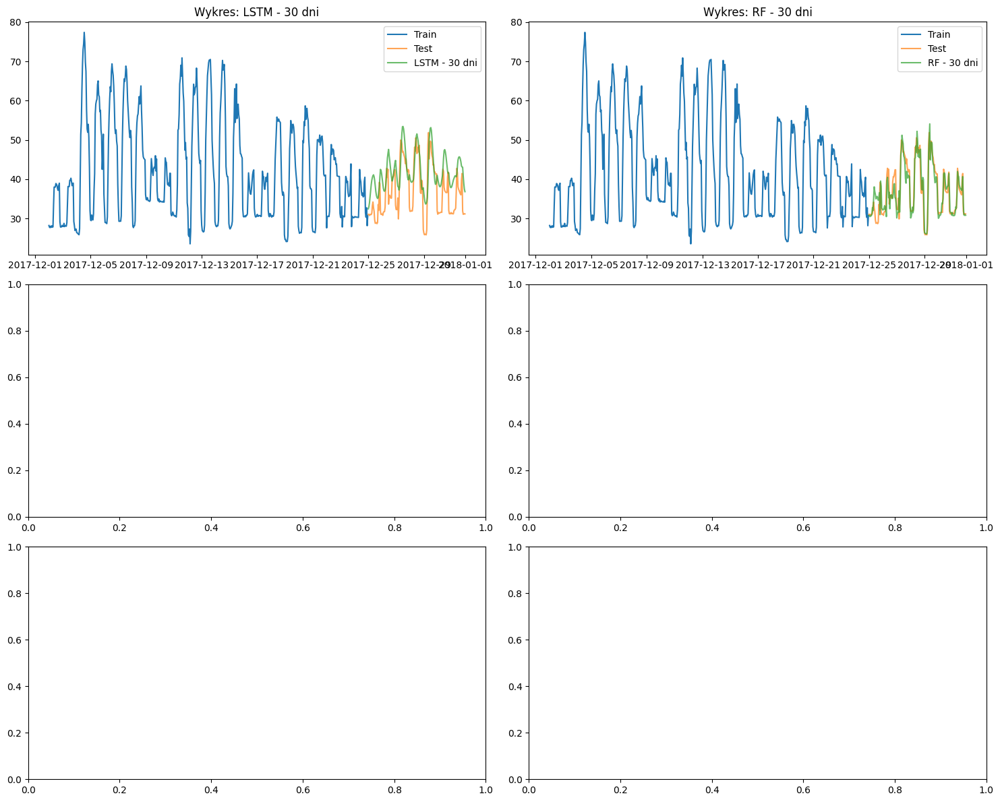


Metryki efektywności:
                            RMSE       MAE      MAPE  Czas treningu  \
Model                                                                 
Random Forest - 30 dni  2.873561  2.061366  0.056098       0.024270   
LSTM - 30 dni           6.384704  5.491965  0.162171       0.662678   

                        Czas predykcji  
Model                                   
Random Forest - 30 dni         0.98275  
LSTM - 30 dni                  0.42460  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption   lag_1   lag_2   lag_3   lag_4  \
timestamp                                                                 
2017-10-02 22:00:00              88.435     NaN     NaN     NaN     NaN   
2017-10-02 23:00:00              33.079  88.435     NaN     NaN     NaN   
2017-10-03 00:00:00              26.783  33.079  88.435     NaN     NaN   
2017-10-03 01:00

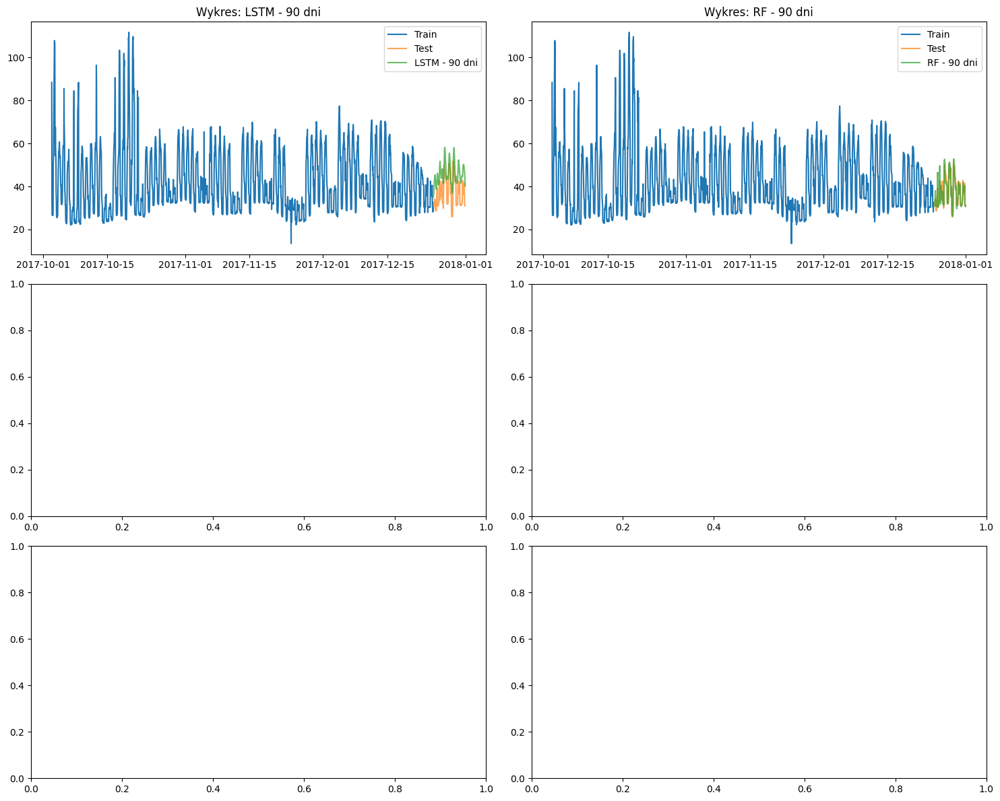


Metryki efektywności:
                            RMSE       MAE      MAPE  Czas treningu  \
Model                                                                 
Random Forest - 90 dni  2.900460  2.045268  0.053762       0.020463   
LSTM - 90 dni           9.652766  8.704943  0.254069       0.670742   

                        Czas predykcji  
Model                                   
Random Forest - 90 dni        4.687094  
LSTM - 90 dni                 0.416410  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption   lag_1   lag_2   lag_3   lag_4  \
timestamp                                                                 
2017-07-04 22:00:00              92.068     NaN     NaN     NaN     NaN   
2017-07-04 23:00:00              31.320  92.068     NaN     NaN     NaN   
2017-07-05 00:00:00              24.801  31.320  92.068     NaN     NaN   
2017-07-05 01:00

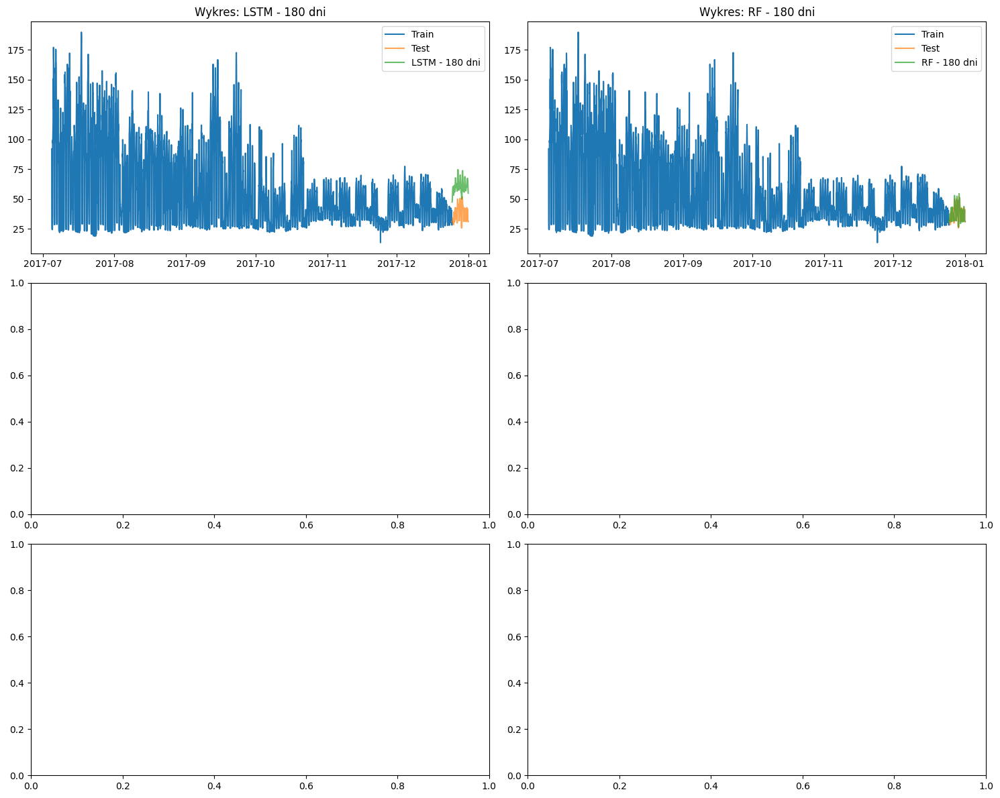


Metryki efektywności:
                              RMSE        MAE      MAPE  Czas treningu  \
Model                                                                    
Random Forest - 180 dni   2.873555   2.002556  0.053723       0.022547   
LSTM - 180 dni           24.128491  23.643428  0.668995       0.648122   

                         Czas predykcji  
Model                                    
Random Forest - 180 dni       10.482508  
LSTM - 180 dni                 0.403246  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption   lag_1   lag_2   lag_3   lag_4  \
timestamp                                                                 
2017-01-05 22:00:00              36.591     NaN     NaN     NaN     NaN   
2017-01-05 23:00:00              29.822  36.591     NaN     NaN     NaN   
2017-01-06 00:00:00              28.826  29.822  36.591     NaN     NaN   


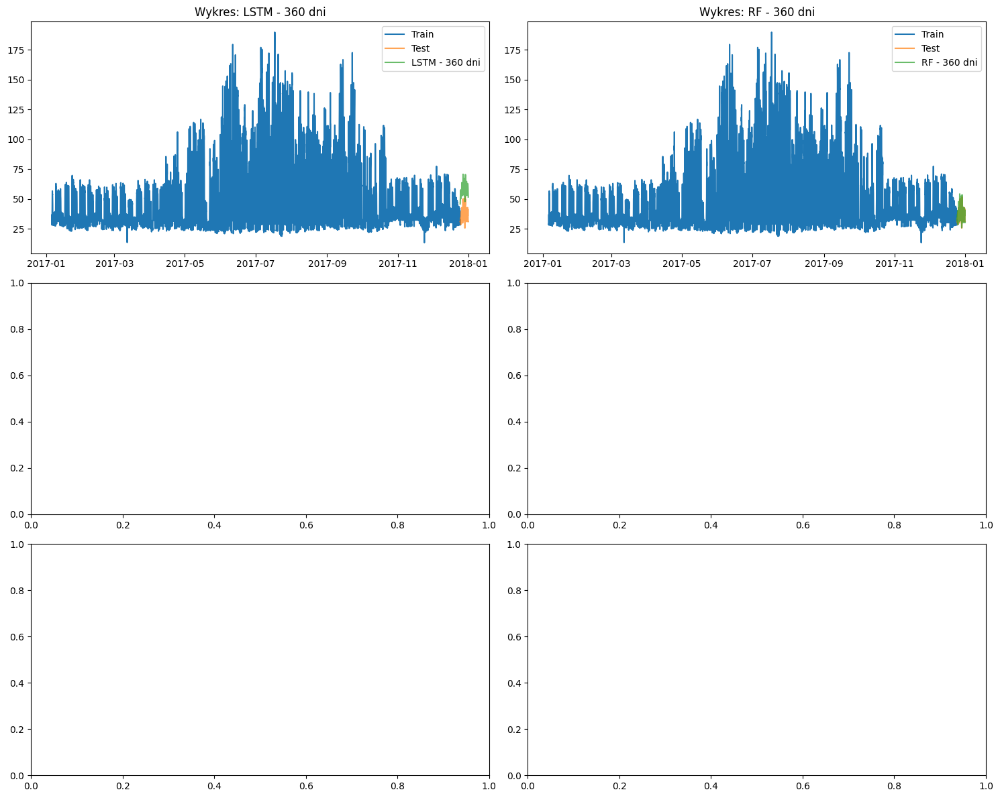


Metryki efektywności:
                              RMSE        MAE      MAPE  Czas treningu  \
Model                                                                    
Random Forest - 360 dni   2.692457   1.819372  0.047956       0.023295   
LSTM - 360 dni           20.842546  20.322143  0.577373       0.574804   

                         Czas predykcji  
Model                                    
Random Forest - 360 dni       24.906409  
LSTM - 360 dni                 0.349808  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption   lag_1   lag_2   lag_3   lag_4  \
timestamp                                                                 
2016-01-01 00:00:00              28.284     NaN     NaN     NaN     NaN   
2016-01-01 01:00:00              28.284  28.284     NaN     NaN     NaN   
2016-01-01 02:00:00              29.069  28.284  28.284     NaN     NaN   


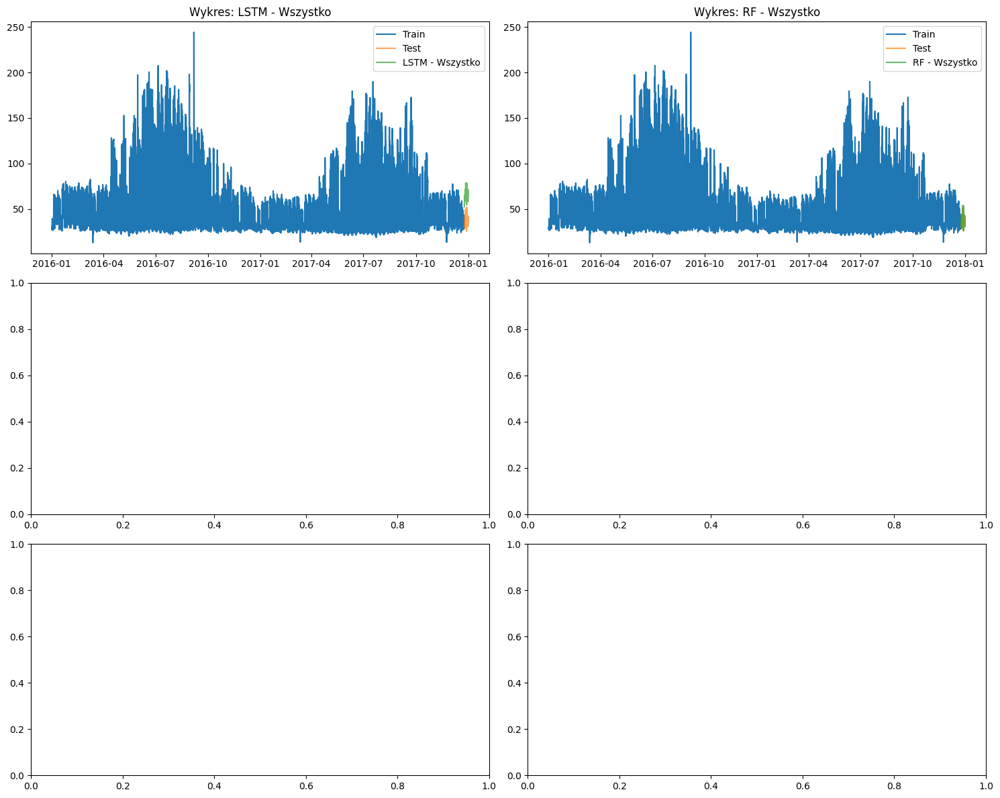


Metryki efektywności:
                               RMSE        MAE      MAPE  Czas treningu  \
Model                                                                     
Random Forest - Wszystko   2.573099   1.722877  0.045351       0.029243   
LSTM - Wszystko           28.076713  27.675910  0.780874       0.574008   

                          Czas predykcji  
Model                                     
Random Forest - Wszystko       58.841642  
LSTM - Wszystko                 0.354876  


====== Processing Building Peacock_education_Yolanda ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption    lag_1    lag_2    lag_3    lag_4  \
timestamp                                                                     
2017-12-01 23:00:00             28.1158      NaN      NaN      NaN      NaN   
2017-12-02 00:00:00             27.6433  28.1158      NaN      NaN  

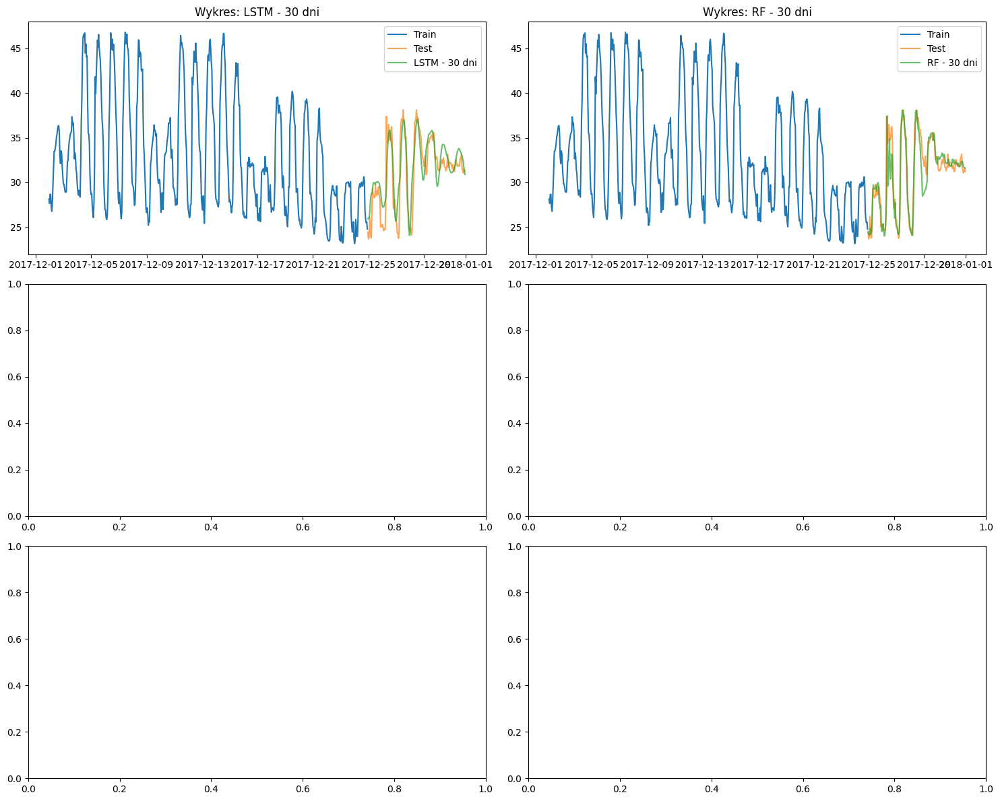


Metryki efektywności:
                            RMSE       MAE      MAPE  Czas treningu  \
Model                                                                 
Random Forest - 30 dni  1.631636  1.083040  0.033891       0.019345   
LSTM - 30 dni           1.995855  1.518838  0.051815       0.646810   

                        Czas predykcji  
Model                                   
Random Forest - 30 dni        0.991229  
LSTM - 30 dni                 0.416303  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption    lag_1    lag_2    lag_3    lag_4  \
timestamp                                                                     
2017-10-02 22:00:00             32.9622      NaN      NaN      NaN      NaN   
2017-10-02 23:00:00             30.1231  32.9622      NaN      NaN      NaN   
2017-10-03 00:00:00             28.6428  30.1231  32.9622      NaN      NaN

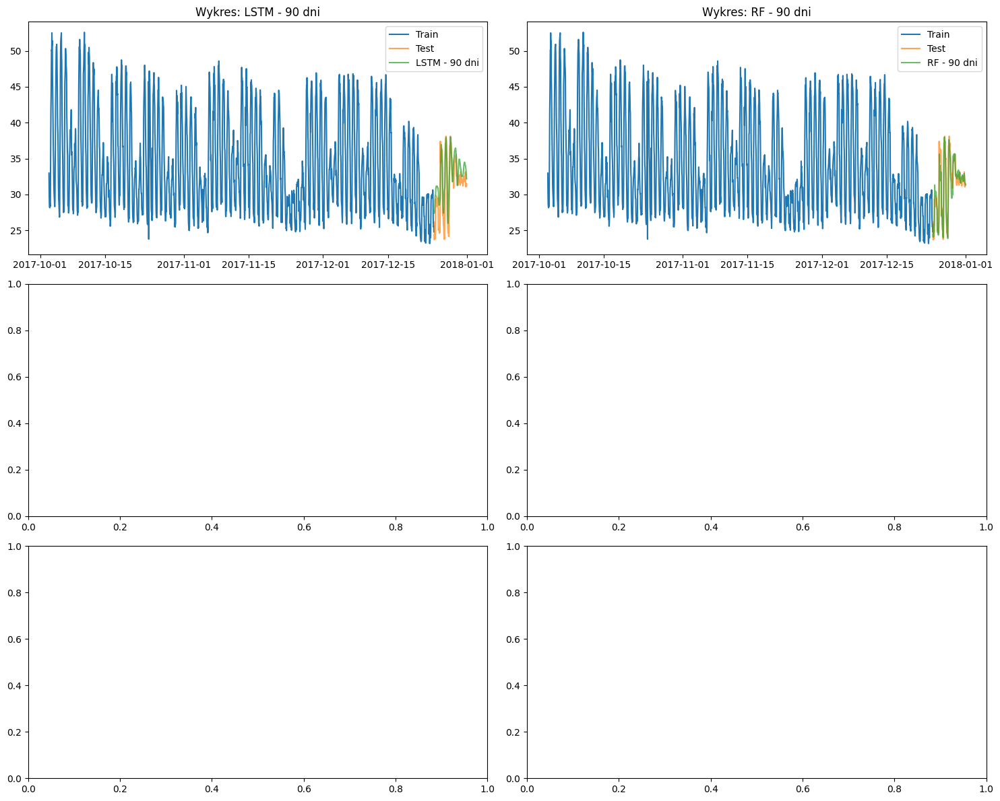


Metryki efektywności:
                            RMSE       MAE      MAPE  Czas treningu  \
Model                                                                 
Random Forest - 90 dni  1.378846  0.981963  0.031147       0.019363   
LSTM - 90 dni           2.481675  1.967009  0.068717       0.632575   

                        Czas predykcji  
Model                                   
Random Forest - 90 dni        4.441313  
LSTM - 90 dni                 0.404914  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption    lag_1    lag_2    lag_3    lag_4  \
timestamp                                                                     
2017-07-04 21:00:00             30.8506      NaN      NaN      NaN      NaN   
2017-07-04 22:00:00             29.4597  30.8506      NaN      NaN      NaN   
2017-07-04 23:00:00             29.0622  29.4597  30.8506      NaN      NaN

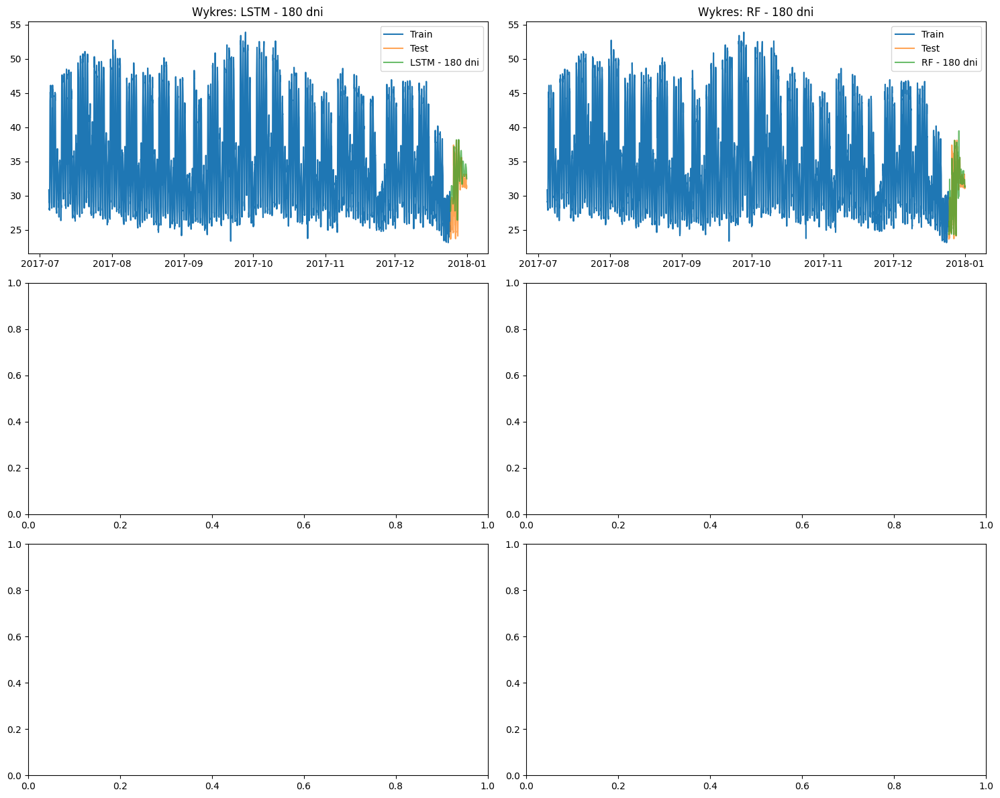


Metryki efektywności:
                             RMSE       MAE      MAPE  Czas treningu  \
Model                                                                  
Random Forest - 180 dni  1.469412  1.040521  0.033101       0.022002   
LSTM - 180 dni           2.649030  2.139985  0.074840       0.633538   

                         Czas predykcji  
Model                                    
Random Forest - 180 dni       10.425558  
LSTM - 180 dni                 0.411904  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption    lag_1    lag_2    lag_3    lag_4  \
timestamp                                                                     
2017-01-05 18:00:00             37.0597      NaN      NaN      NaN      NaN   
2017-01-05 19:00:00             32.7928  37.0597      NaN      NaN      NaN   
2017-01-05 20:00:00             31.9947  32.7928  37.0597      NaN 

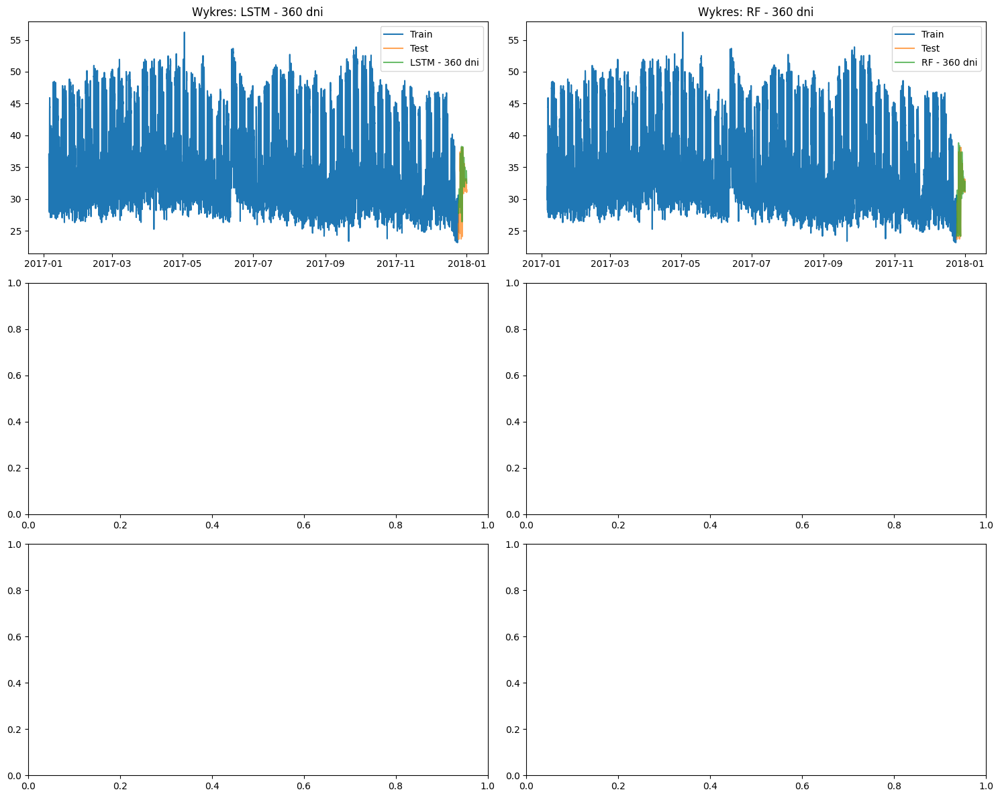


Metryki efektywności:
                             RMSE       MAE      MAPE  Czas treningu  \
Model                                                                  
Random Forest - 360 dni  1.364987  0.940841  0.029885       0.024272   
LSTM - 360 dni           2.593382  2.097283  0.073344       0.614402   

                         Czas predykcji  
Model                                    
Random Forest - 360 dni       21.156939  
LSTM - 360 dni                 0.373601  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption    lag_1    lag_2    lag_3    lag_4  \
timestamp                                                                     
2016-01-01 00:00:00             26.6689      NaN      NaN      NaN      NaN   
2016-01-01 01:00:00             27.8858  26.6689      NaN      NaN      NaN   
2016-01-01 02:00:00             27.5111  27.8858  26.6689      NaN 

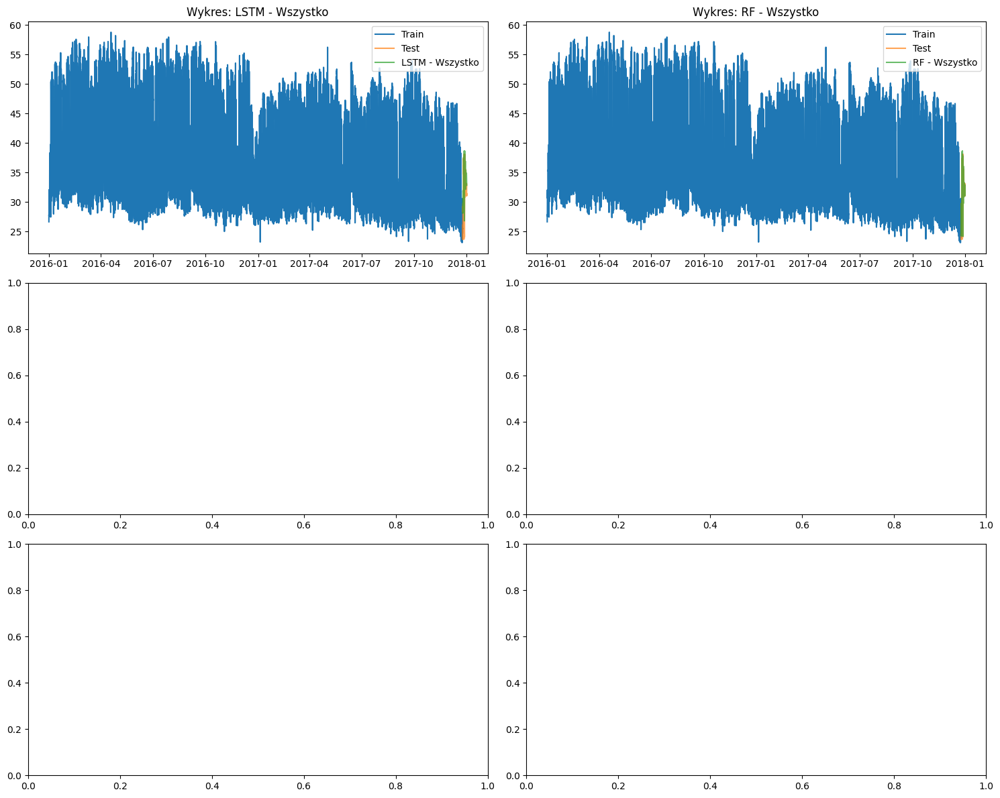


Metryki efektywności:
                              RMSE       MAE      MAPE  Czas treningu  \
Model                                                                   
Random Forest - Wszystko  1.346028  0.950207  0.030047       0.030720   
LSTM - Wszystko           2.880418  2.402335  0.083648       0.572158   

                          Czas predykcji  
Model                                     
Random Forest - Wszystko       48.024004  
LSTM - Wszystko                 0.355811  


====== Processing Building Peacock_office_Julian ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption    lag_1    lag_2    lag_3    lag_4  \
timestamp                                                                     
2017-12-01 23:00:00             19.5833      NaN      NaN      NaN      NaN   
2017-12-02 00:00:00             12.6667  19.5833      NaN      NaN      NaN   
2

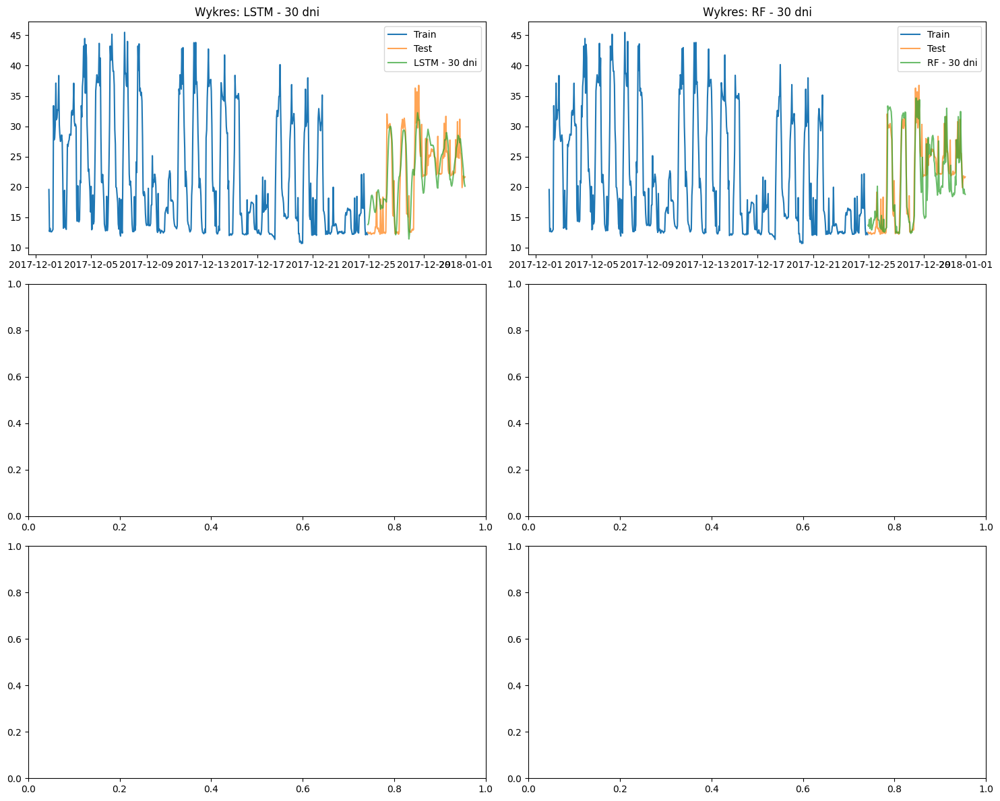


Metryki efektywności:
                            RMSE       MAE      MAPE  Czas treningu  \
Model                                                                 
Random Forest - 30 dni  3.672698  2.754181  0.124277       0.006632   
LSTM - 30 dni           4.075282  3.186818  0.179873       0.593744   

                        Czas predykcji  
Model                                   
Random Forest - 30 dni        0.938563  
LSTM - 30 dni                 0.356629  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption    lag_1    lag_2    lag_3    lag_4  \
timestamp                                                                     
2017-10-02 22:00:00             18.5000      NaN      NaN      NaN      NaN   
2017-10-02 23:00:00             20.7333  18.5000      NaN      NaN      NaN   
2017-10-03 00:00:00             13.9000  20.7333  18.5000      NaN      NaN

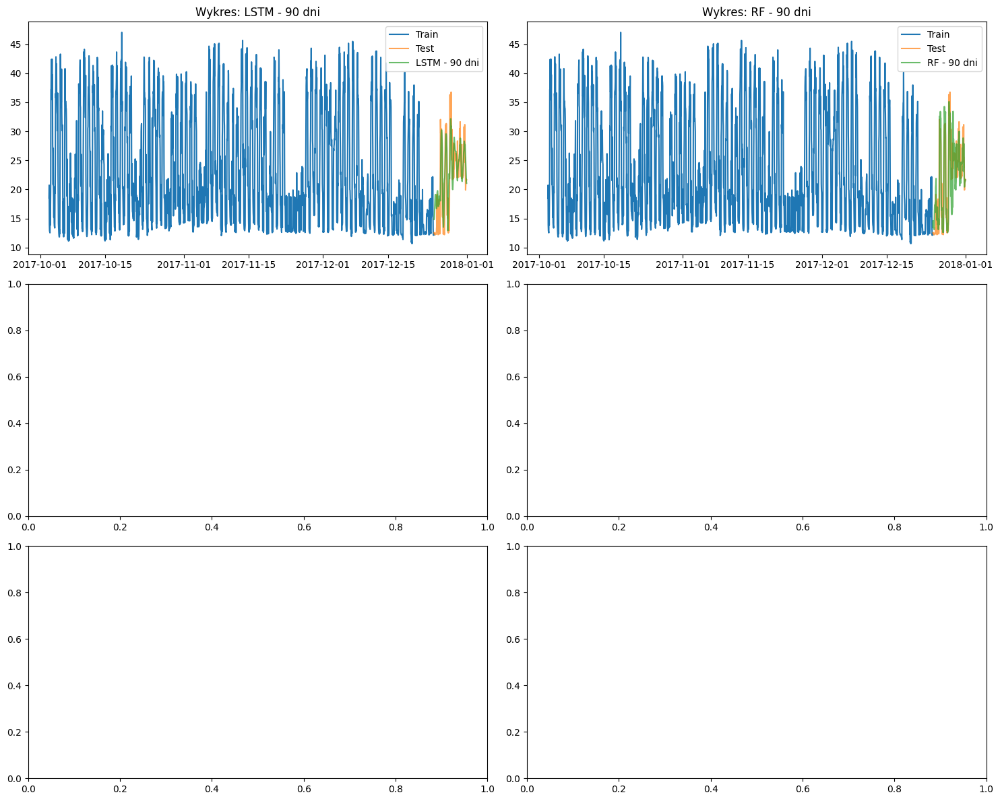


Metryki efektywności:
                            RMSE       MAE      MAPE  Czas treningu  \
Model                                                                 
Random Forest - 90 dni  3.785341  2.891895  0.138211       0.017650   
LSTM - 90 dni           4.148455  3.220040  0.188361       0.581615   

                        Czas predykcji  
Model                                   
Random Forest - 90 dni        3.854942  
LSTM - 90 dni                 0.346497  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption    lag_1    lag_2    lag_3    lag_4  \
timestamp                                                                     
2017-07-04 21:00:00             12.5000      NaN      NaN      NaN      NaN   
2017-07-04 22:00:00             12.5667  12.5000      NaN      NaN      NaN   
2017-07-04 23:00:00             18.6667  12.5667  12.5000      NaN      NaN

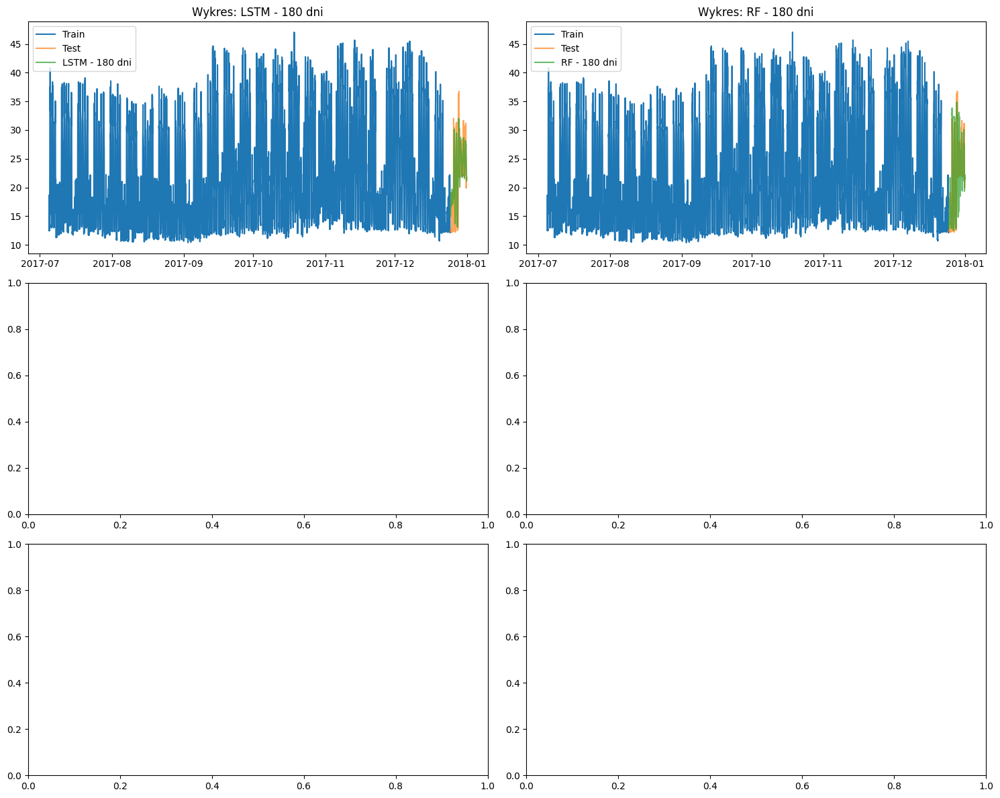


Metryki efektywności:
                             RMSE       MAE      MAPE  Czas treningu  \
Model                                                                  
Random Forest - 180 dni  3.920230  2.872497  0.136115       0.019651   
LSTM - 180 dni           4.126872  3.190431  0.187209       0.573595   

                         Czas predykcji  
Model                                    
Random Forest - 180 dni        8.760401  
LSTM - 180 dni                 0.342670  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption    lag_1    lag_2    lag_3    lag_4  \
timestamp                                                                     
2017-01-05 18:00:00             16.4333      NaN      NaN      NaN      NaN   
2017-01-05 19:00:00             21.9167  16.4333      NaN      NaN      NaN   
2017-01-05 20:00:00             15.3500  21.9167  16.4333      NaN 

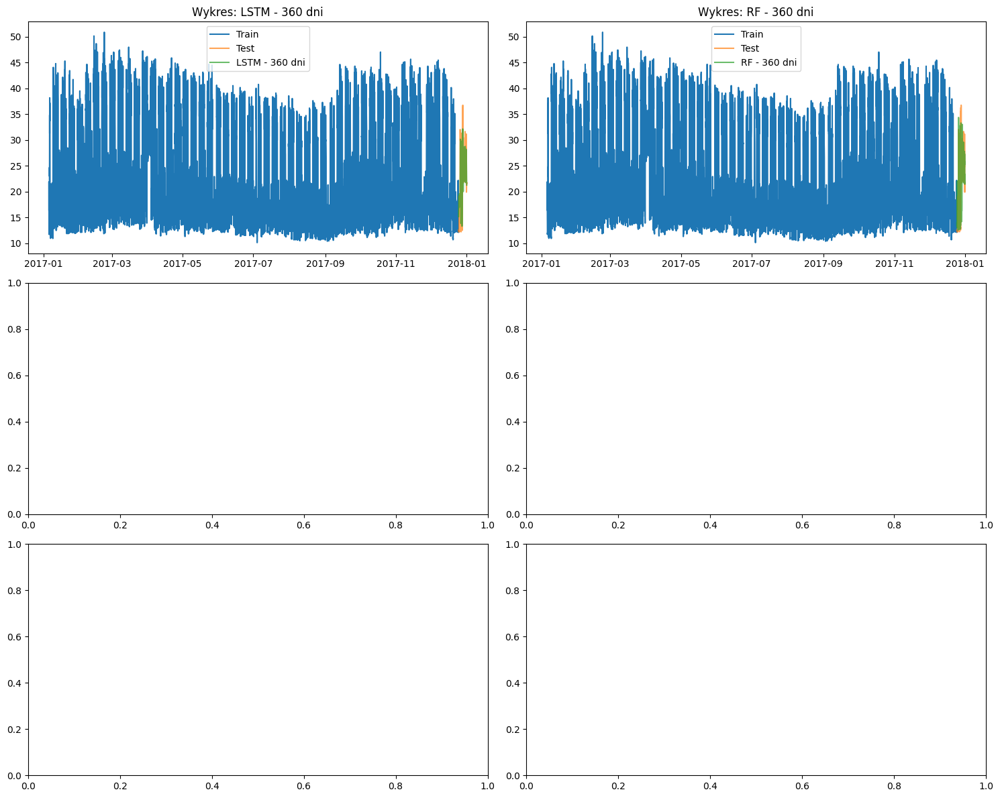


Metryki efektywności:
                             RMSE       MAE     MAPE  Czas treningu  \
Model                                                                 
Random Forest - 360 dni  3.757399  2.716140  0.13242       0.021987   
LSTM - 360 dni           4.110097  3.190183  0.18732       0.583358   

                         Czas predykcji  
Model                                    
Random Forest - 360 dni       19.860390  
LSTM - 360 dni                 0.351616  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption    lag_1    lag_2    lag_3    lag_4  \
timestamp                                                                     
2016-01-01 00:00:00             19.3167      NaN      NaN      NaN      NaN   
2016-01-01 01:00:00             13.1000  19.3167      NaN      NaN      NaN   
2016-01-01 02:00:00             13.8500  13.1000  19.3167      NaN     

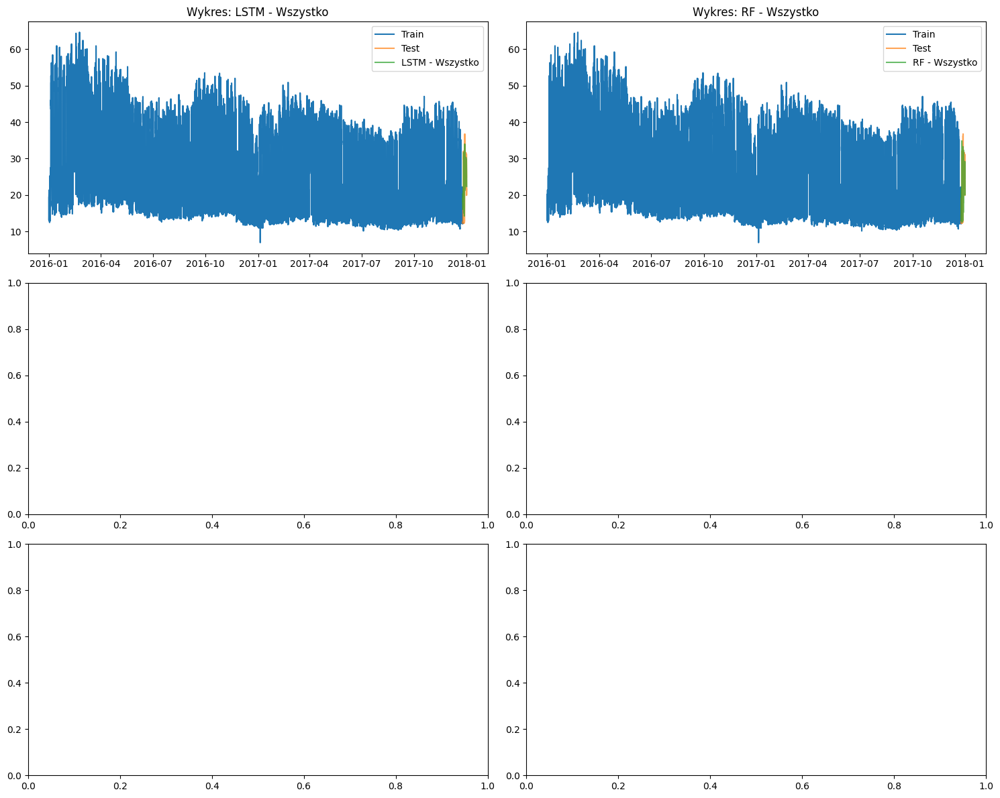


Metryki efektywności:
                              RMSE       MAE      MAPE  Czas treningu  \
Model                                                                   
Random Forest - Wszystko  3.407843  2.539995  0.127021       0.027345   
LSTM - Wszystko           4.752059  3.876668  0.230069       0.570153   

                          Czas predykcji  
Model                                     
Random Forest - Wszystko       43.395022  
LSTM - Wszystko                 0.350763  


====== Processing Building Rat_assembly_Deandre ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-12-01 23:00:00               23.40    NaN    NaN    NaN    NaN    NaN   
2017-12-02 00:00:00               24.01  23.40    NaN    NaN    NaN    NaN   
2017-1

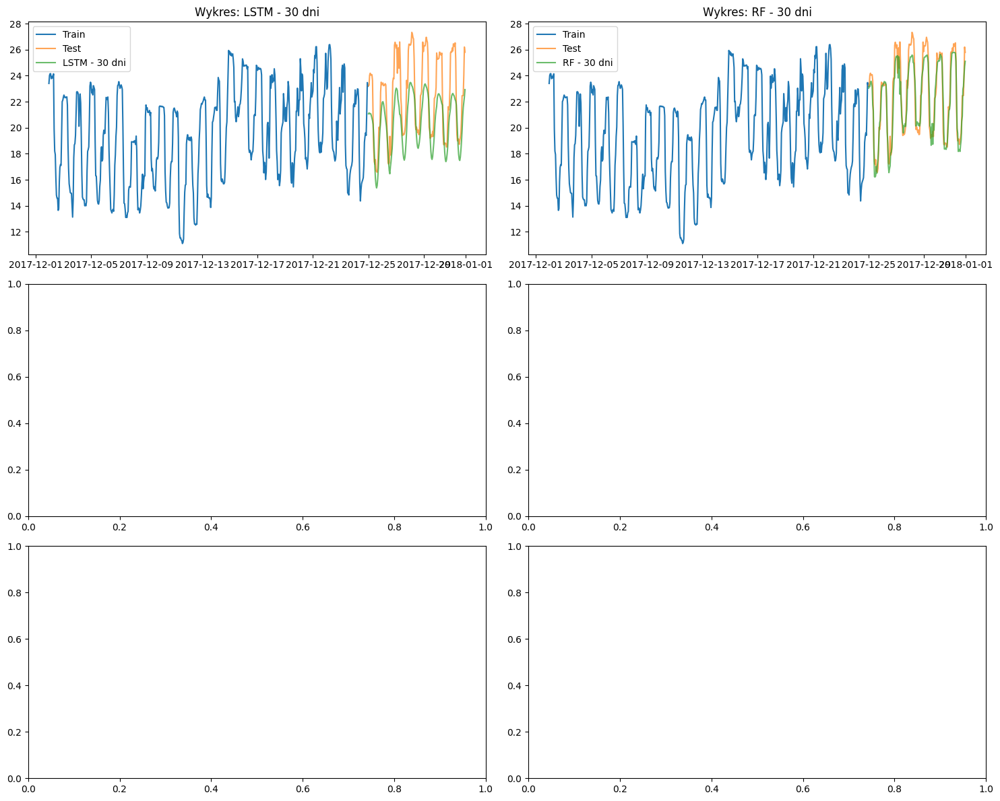


Metryki efektywności:
                            RMSE       MAE      MAPE  Czas treningu  \
Model                                                                 
Random Forest - 30 dni  0.993284  0.770035  0.033916       0.020643   
LSTM - 30 dni           2.486107  2.155097  0.091403       0.649856   

                        Czas predykcji  
Model                                   
Random Forest - 30 dni        0.840055  
LSTM - 30 dni                 0.400281  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-10-02 22:00:00               22.69    NaN    NaN    NaN    NaN    NaN   
2017-10-02 23:00:00               22.73  22.69    NaN    NaN    NaN    NaN   
2017-10-03 00:00:00               23.73  22.73  22.69    NaN    NaN    NaN   
2

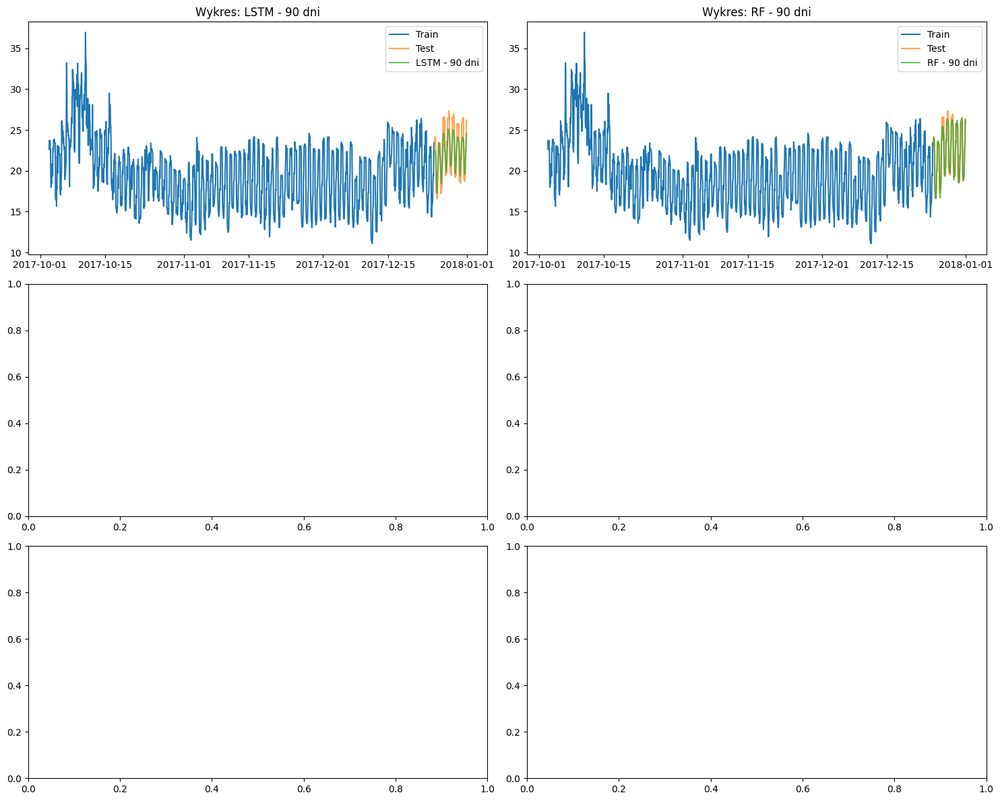


Metryki efektywności:
                            RMSE       MAE      MAPE  Czas treningu  \
Model                                                                 
Random Forest - 90 dni  0.846312  0.618283  0.027339       0.019510   
LSTM - 90 dni           1.579092  1.336917  0.059098       0.616524   

                        Czas predykcji  
Model                                   
Random Forest - 90 dni        3.597754  
LSTM - 90 dni                 0.364597  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-07-04 21:00:00               47.72    NaN    NaN    NaN    NaN    NaN   
2017-07-04 22:00:00               46.66  47.72    NaN    NaN    NaN    NaN   
2017-07-04 23:00:00               43.11  46.66  47.72    NaN    NaN    NaN   
2

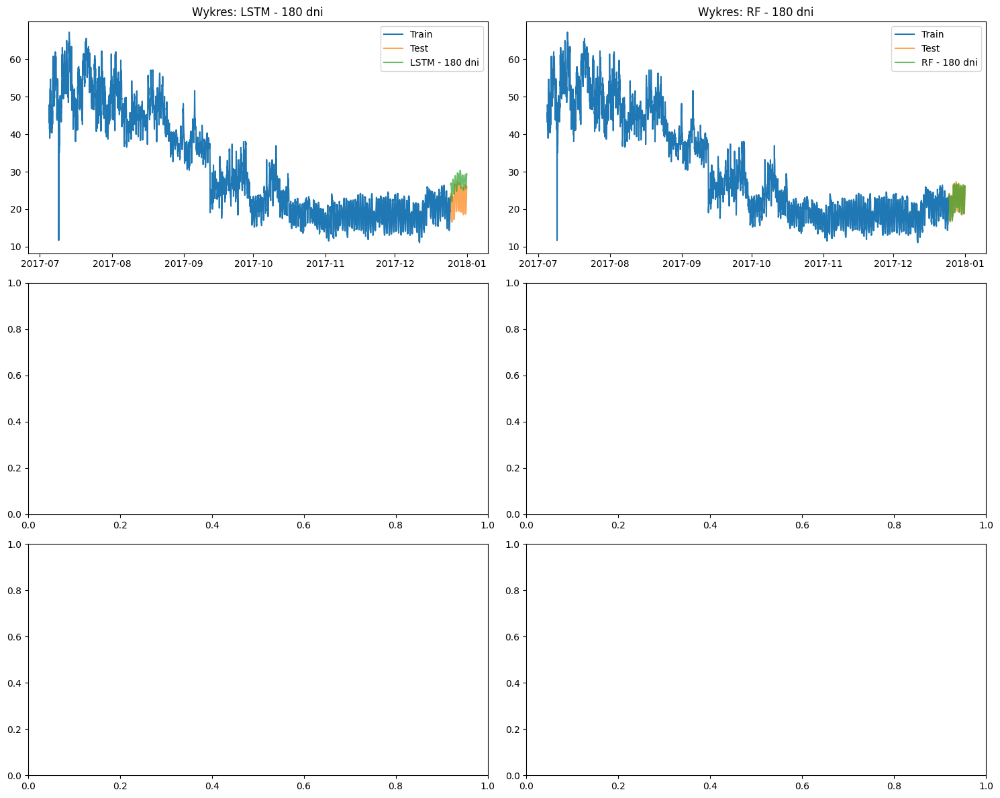


Metryki efektywności:
                             RMSE       MAE      MAPE  Czas treningu  \
Model                                                                  
Random Forest - 180 dni  0.932954  0.674692  0.030366       0.021153   
LSTM - 180 dni           5.087772  4.743279  0.225446       0.589261   

                         Czas predykcji  
Model                                    
Random Forest - 180 dni        8.751742  
LSTM - 180 dni                 0.363255  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-01-03 19:00:00               26.36    NaN    NaN    NaN    NaN    NaN   
2017-01-03 20:00:00               29.34  26.36    NaN    NaN    NaN    NaN   
2017-01-03 21:00:00               27.86  29.34  26.36    NaN    NaN    

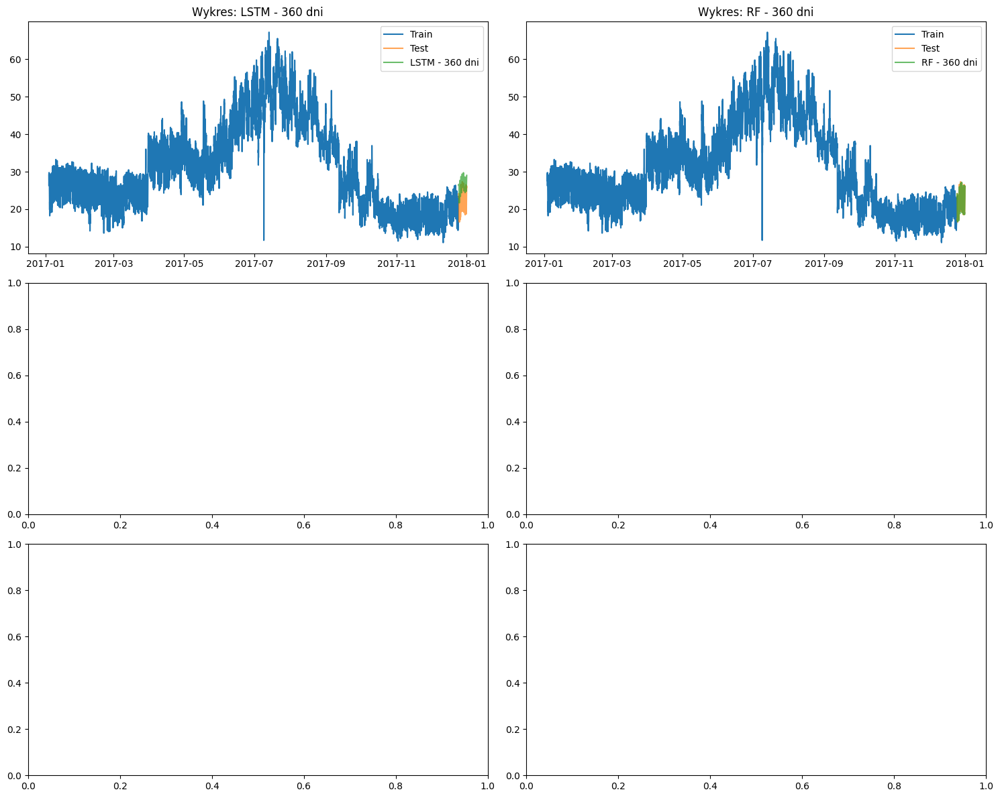


Metryki efektywności:
                             RMSE       MAE      MAPE  Czas treningu  \
Model                                                                  
Random Forest - 360 dni  0.803957  0.586330  0.026383       0.025436   
LSTM - 360 dni           4.629453  4.279141  0.204091       0.589164   

                         Czas predykcji  
Model                                    
Random Forest - 360 dni       18.636338  
LSTM - 360 dni                 0.346602  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2016-01-01 00:00:00               15.93    NaN    NaN    NaN    NaN    NaN   
2016-01-01 01:00:00               15.95  15.93    NaN    NaN    NaN    NaN   
2016-01-01 02:00:00               15.90  15.95  15.93    NaN    NaN    

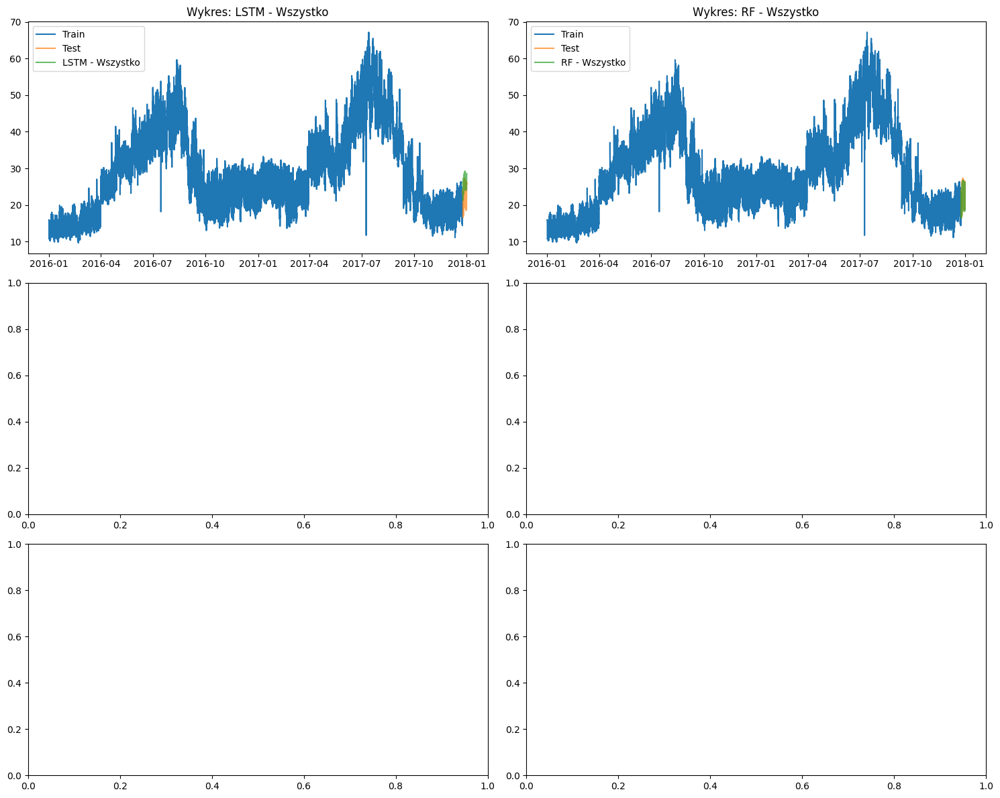


Metryki efektywności:
                              RMSE       MAE      MAPE  Czas treningu  \
Model                                                                   
Random Forest - Wszystko  0.819399  0.616461  0.027407       0.033582   
LSTM - Wszystko           4.235607  3.864778  0.185112       0.613229   

                          Czas predykcji  
Model                                     
Random Forest - Wszystko       39.527085  
LSTM - Wszystko                 0.339613  


====== Processing Building Rat_education_Esther ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-12-01 23:00:00               66.02    NaN    NaN    NaN    NaN    NaN   
2017-12-02 00:00:00               69.33  66.02    NaN    NaN    NaN    NaN   
2017-1

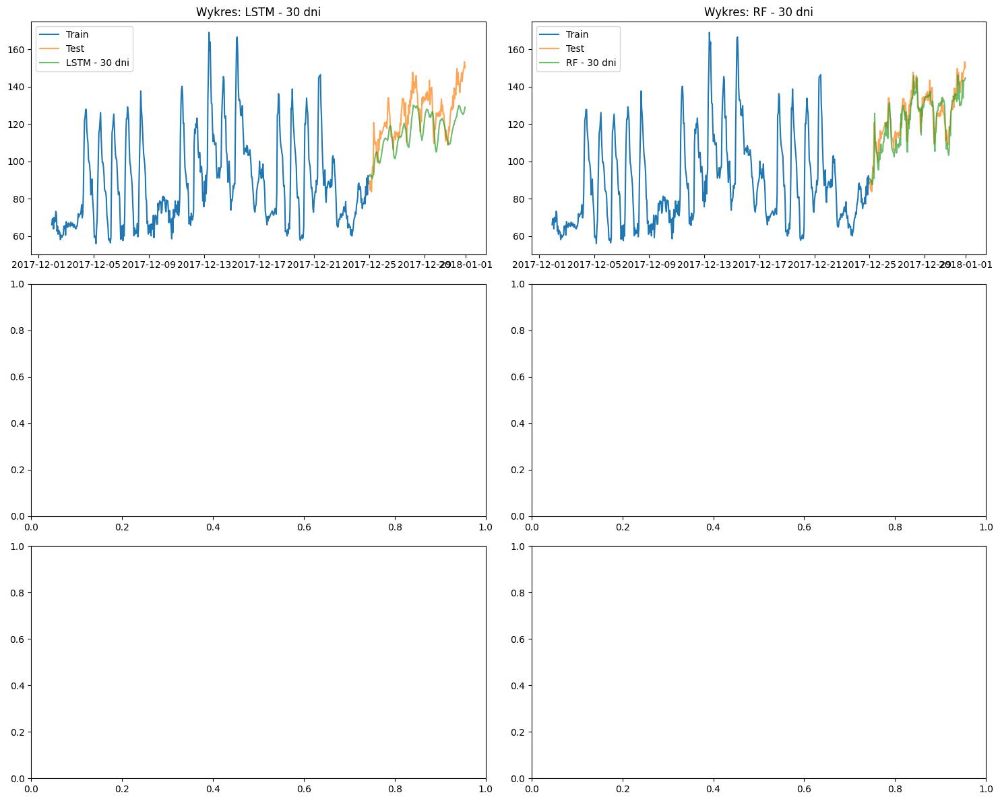


Metryki efektywności:
                             RMSE        MAE      MAPE  Czas treningu  \
Model                                                                   
Random Forest - 30 dni   7.234842   5.733221  0.046172       0.017060   
LSTM - 30 dni           12.098411  10.310849  0.080338       0.562585   

                        Czas predykcji  
Model                                   
Random Forest - 30 dni        0.819108  
LSTM - 30 dni                 0.331341  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-10-02 22:00:00               70.39    NaN    NaN    NaN    NaN    NaN   
2017-10-02 23:00:00               69.13  70.39    NaN    NaN    NaN    NaN   
2017-10-03 00:00:00               65.79  69.13  70.39    NaN    NaN    

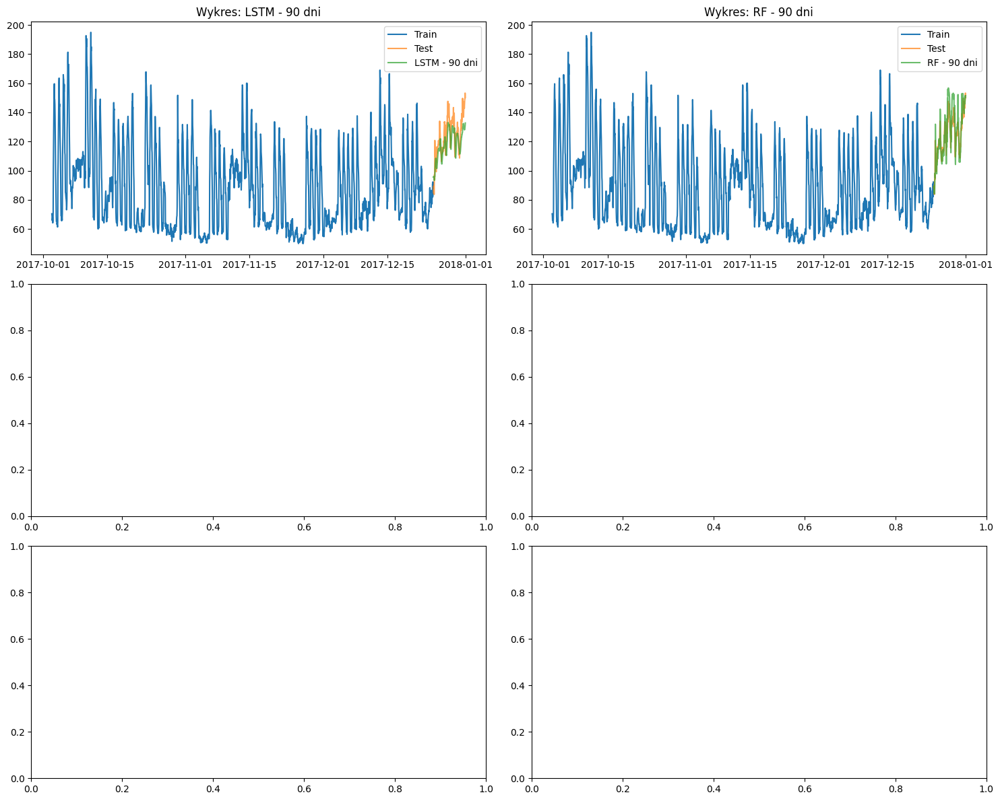


Metryki efektywności:
                            RMSE       MAE      MAPE  Czas treningu  \
Model                                                                 
Random Forest - 90 dni  9.308104  7.160980  0.056884       0.017960   
LSTM - 90 dni           9.909135  8.218991  0.064527       0.597015   

                        Czas predykcji  
Model                                   
Random Forest - 90 dni         3.59682  
LSTM - 90 dni                  0.33322  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption   lag_1   lag_2   lag_3  lag_4  lag_5  \
timestamp                                                                       
2017-07-03 21:00:00               98.51     NaN     NaN     NaN    NaN    NaN   
2017-07-03 22:00:00              100.29   98.51     NaN     NaN    NaN    NaN   
2017-07-03 23:00:00               99.73  100.29   98.51     NaN    

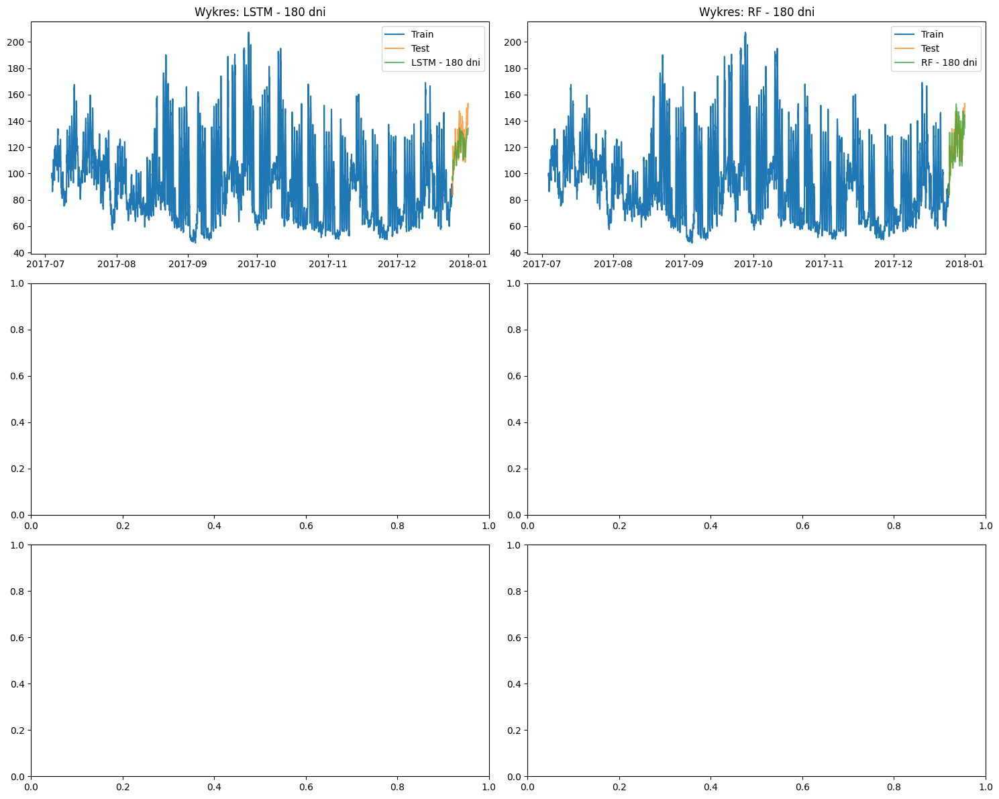


Metryki efektywności:
                             RMSE       MAE      MAPE  Czas treningu  \
Model                                                                  
Random Forest - 180 dni  7.230919  5.630226  0.044631       0.018674   
LSTM - 180 dni           9.016965  7.353209  0.058167       0.563790   

                         Czas predykcji  
Model                                    
Random Forest - 180 dni        8.389380  
LSTM - 180 dni                 0.337916  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-01-03 19:00:00               99.22    NaN    NaN    NaN    NaN    NaN   
2017-01-03 20:00:00               92.89  99.22    NaN    NaN    NaN    NaN   
2017-01-03 21:00:00               91.64  92.89  99.22    NaN    NaN    

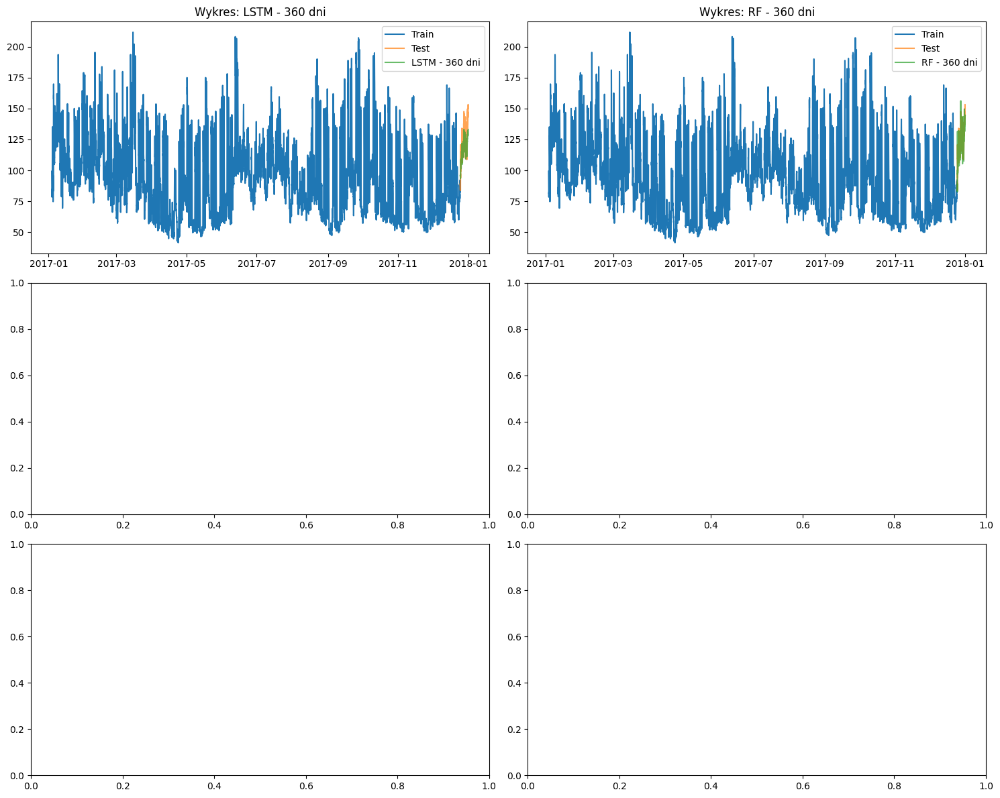


Metryki efektywności:
                             RMSE       MAE      MAPE  Czas treningu  \
Model                                                                  
Random Forest - 360 dni  6.760305  5.264873  0.042082       0.020429   
LSTM - 360 dni           9.839094  8.158566  0.064024       0.607173   

                         Czas predykcji  
Model                                    
Random Forest - 360 dni       20.702113  
LSTM - 360 dni                 0.346519  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2016-01-01 00:00:00               57.77    NaN    NaN    NaN    NaN    NaN   
2016-01-01 01:00:00               53.86  57.77    NaN    NaN    NaN    NaN   
2016-01-01 02:00:00               57.94  53.86  57.77    NaN    NaN    

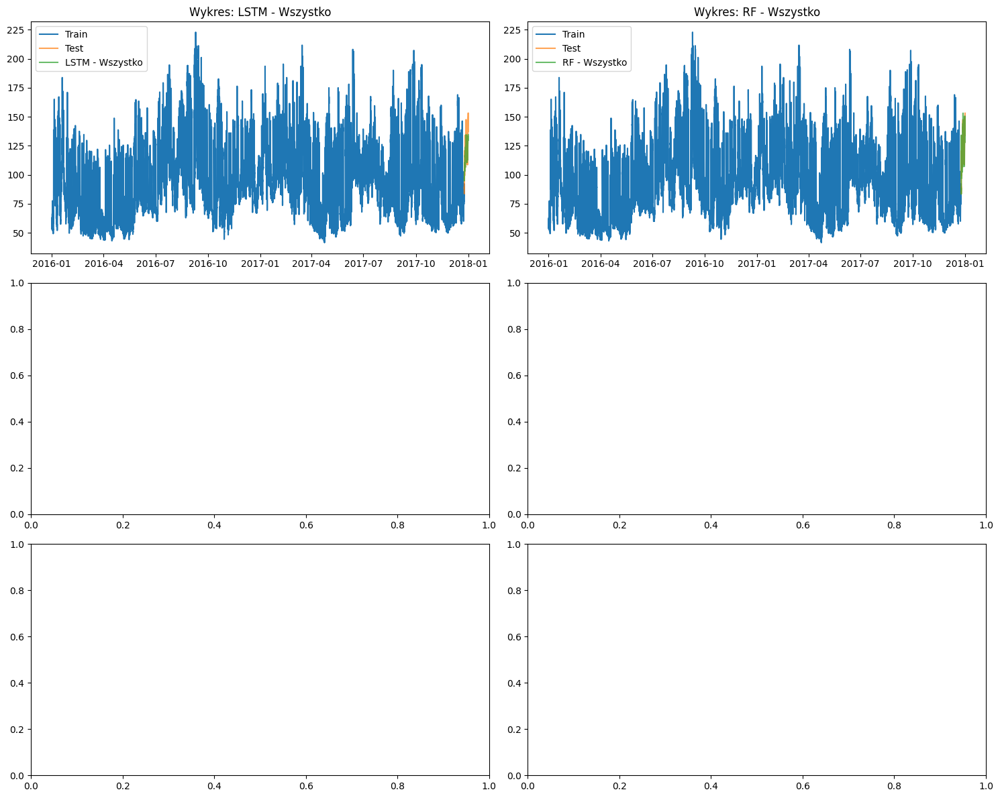


Metryki efektywności:
                              RMSE       MAE      MAPE  Czas treningu  \
Model                                                                   
Random Forest - Wszystko  6.442498  4.957103  0.039640       0.027117   
LSTM - Wszystko           8.943855  7.275477  0.057576       0.630880   

                          Czas predykcji  
Model                                     
Random Forest - Wszystko       45.090687  
LSTM - Wszystko                 0.382910  


====== Processing Building Rat_public_Angelina ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-12-01 23:00:00               22.38    NaN    NaN    NaN    NaN    NaN   
2017-12-02 00:00:00               23.90  22.38    NaN    NaN    NaN    NaN   
2017-12

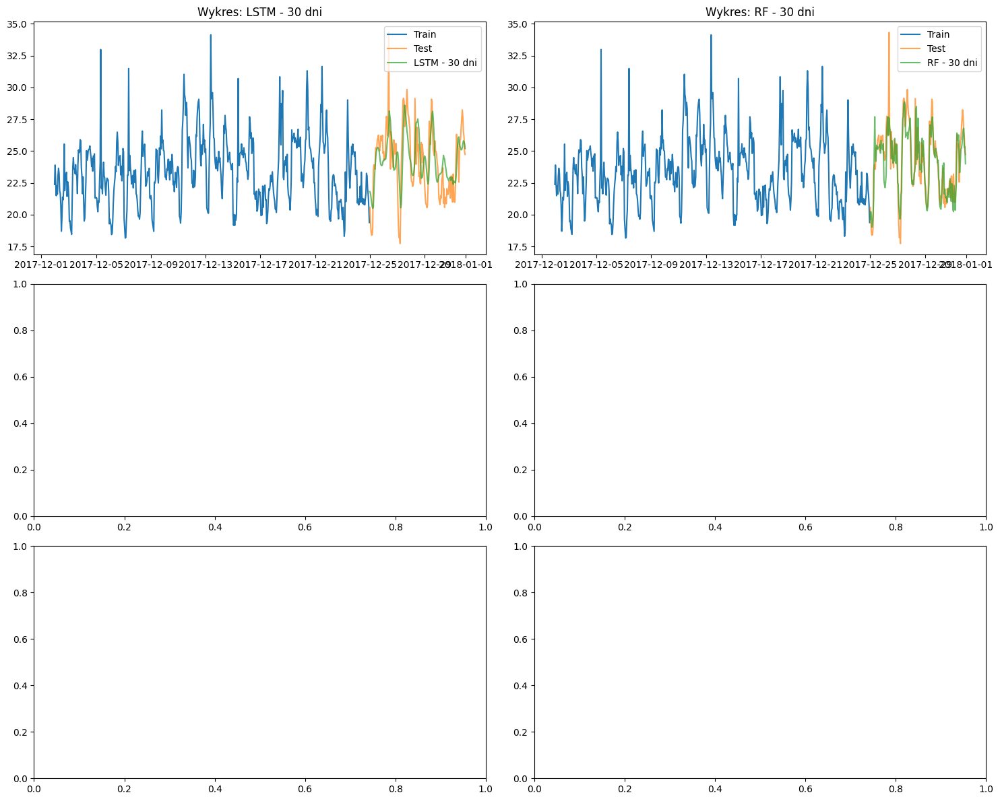


Metryki efektywności:
                            RMSE       MAE      MAPE  Czas treningu  \
Model                                                                 
Random Forest - 30 dni  1.480498  1.083146  0.044131       0.013659   
LSTM - 30 dni           2.055349  1.666163  0.070221       0.594490   

                        Czas predykcji  
Model                                   
Random Forest - 30 dni        0.958566  
LSTM - 30 dni                 0.353646  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-10-02 22:00:00               37.43    NaN    NaN    NaN    NaN    NaN   
2017-10-02 23:00:00               36.40  37.43    NaN    NaN    NaN    NaN   
2017-10-03 00:00:00               36.25  36.40  37.43    NaN    NaN    NaN   
2

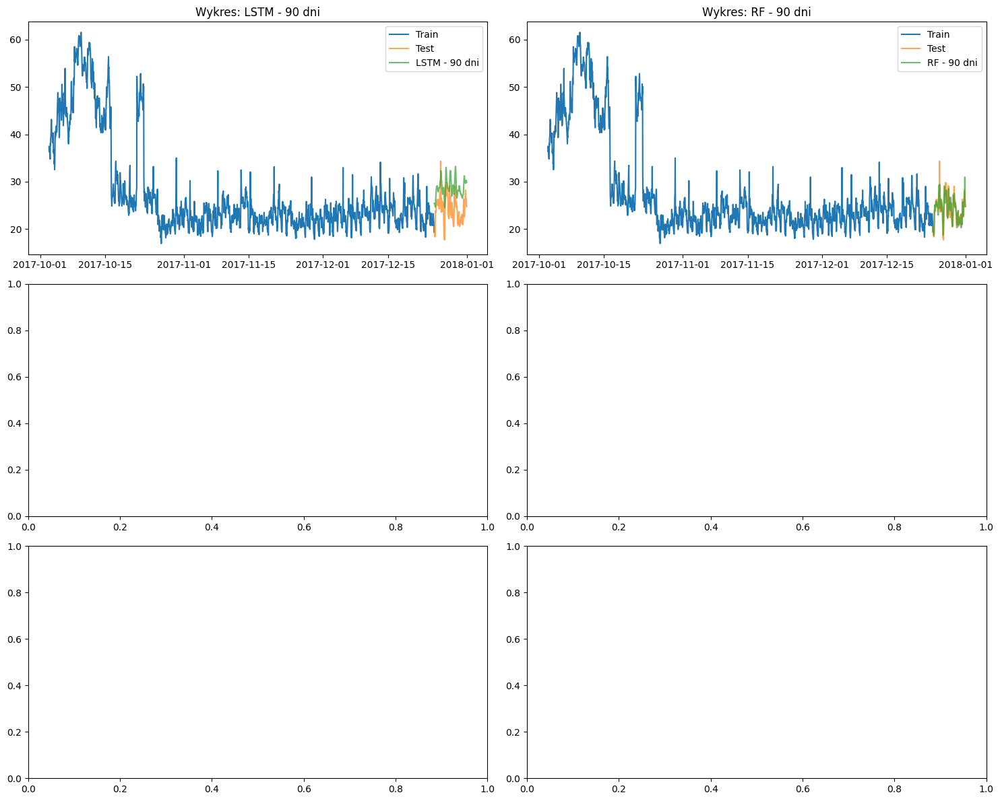


Metryki efektywności:
                            RMSE       MAE      MAPE  Czas treningu  \
Model                                                                 
Random Forest - 90 dni  1.447274  1.073209  0.043468       0.028359   
LSTM - 90 dni           4.977785  4.510976  0.195387       0.881268   

                        Czas predykcji  
Model                                   
Random Forest - 90 dni        3.890452  
LSTM - 90 dni                 0.484529  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-07-03 21:00:00               47.15    NaN    NaN    NaN    NaN    NaN   
2017-07-03 22:00:00               47.51  47.15    NaN    NaN    NaN    NaN   
2017-07-03 23:00:00               45.55  47.51  47.15    NaN    NaN    NaN   
2

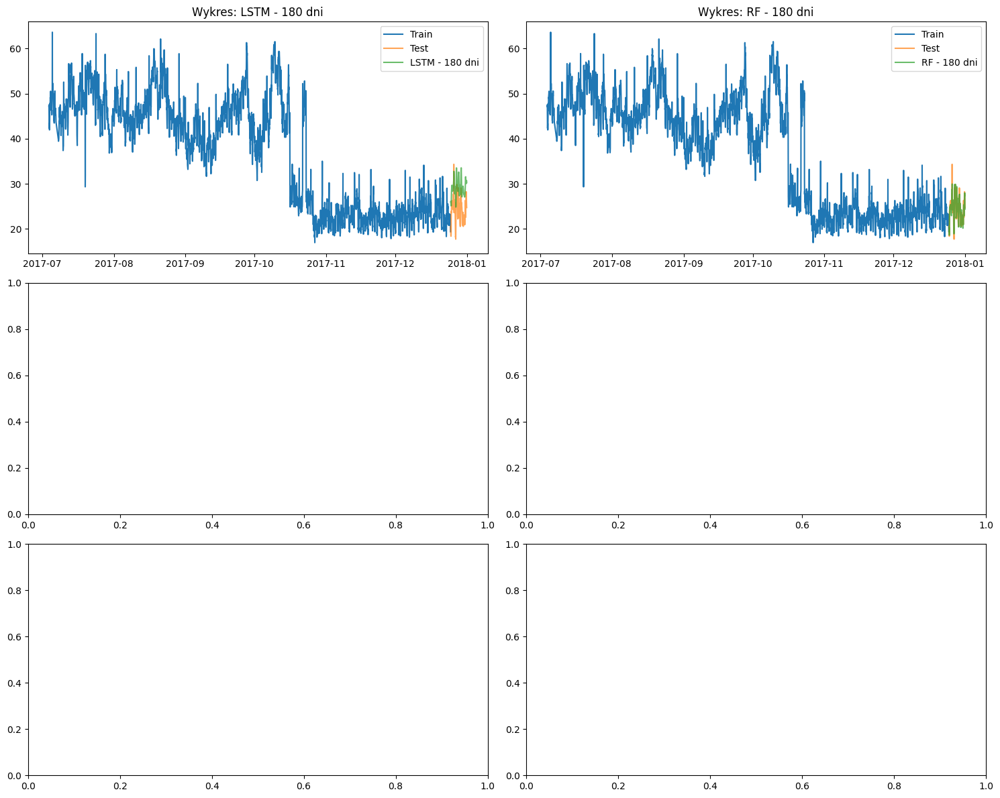


Metryki efektywności:
                             RMSE       MAE      MAPE  Czas treningu  \
Model                                                                  
Random Forest - 180 dni  1.456878  1.082476  0.043900       0.020919   
LSTM - 180 dni           5.353354  4.931414  0.213028       0.635023   

                         Czas predykcji  
Model                                    
Random Forest - 180 dni        9.205847  
LSTM - 180 dni                 0.347452  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-01-02 19:00:00               21.51    NaN    NaN    NaN    NaN    NaN   
2017-01-02 20:00:00               22.71  21.51    NaN    NaN    NaN    NaN   
2017-01-02 21:00:00               21.20  22.71  21.51    NaN    NaN    

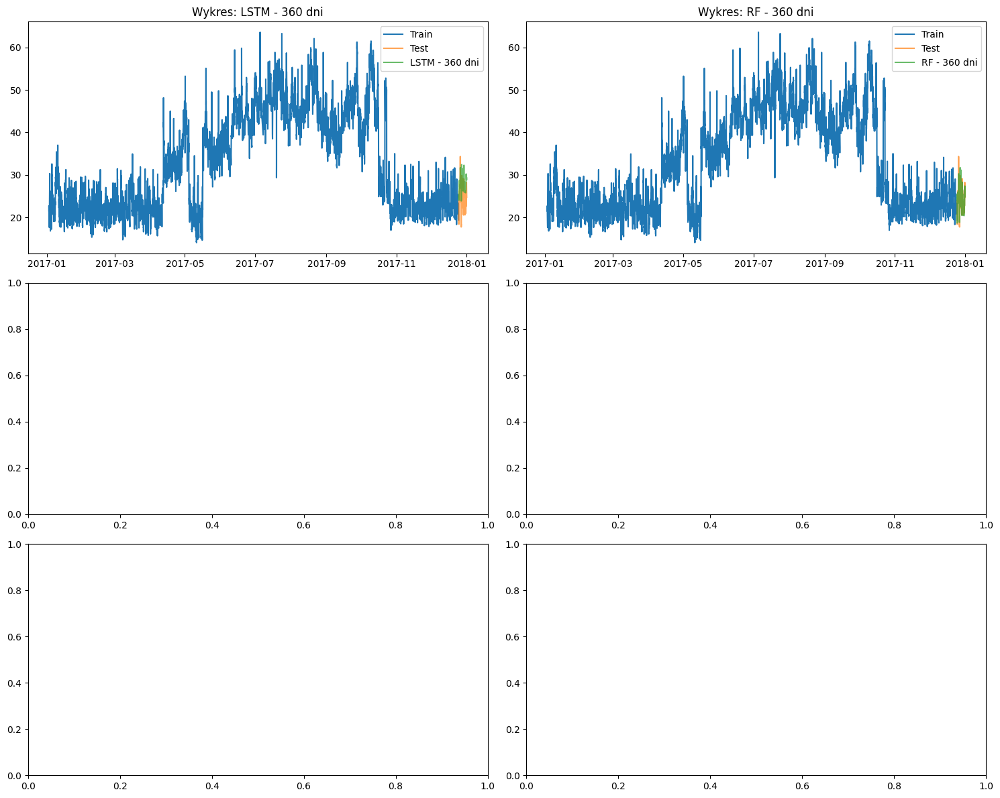


Metryki efektywności:
                             RMSE       MAE      MAPE  Czas treningu  \
Model                                                                  
Random Forest - 360 dni  1.465591  1.078831  0.043599       0.030529   
LSTM - 360 dni           4.279878  3.770282  0.164219       1.140635   

                         Czas predykcji  
Model                                    
Random Forest - 360 dni       19.533450  
LSTM - 360 dni                 0.483774  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2016-01-01 00:00:00               22.23    NaN    NaN    NaN    NaN    NaN   
2016-01-01 01:00:00               21.68  22.23    NaN    NaN    NaN    NaN   
2016-01-01 02:00:00               21.00  21.68  22.23    NaN    NaN    

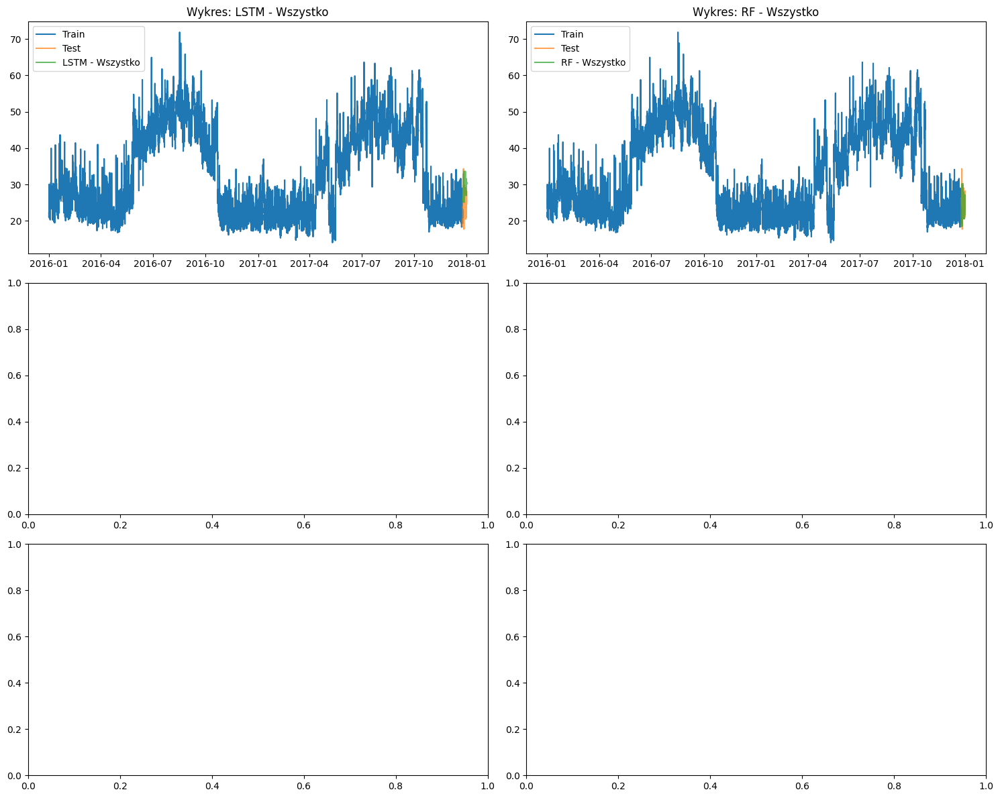


Metryki efektywności:
                              RMSE       MAE      MAPE  Czas treningu  \
Model                                                                   
Random Forest - Wszystko  1.412430  1.035096  0.042053       0.033946   
LSTM - Wszystko           5.414247  4.997472  0.215774       0.576717   

                          Czas predykcji  
Model                                     
Random Forest - Wszystko       42.871058  
LSTM - Wszystko                 0.340050  


====== Processing Building Rat_public_Clyde ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-12-01 18:00:00               26.08    NaN    NaN    NaN    NaN    NaN   
2017-12-01 19:00:00               39.28  26.08    NaN    NaN    NaN    NaN   
2017-12-01

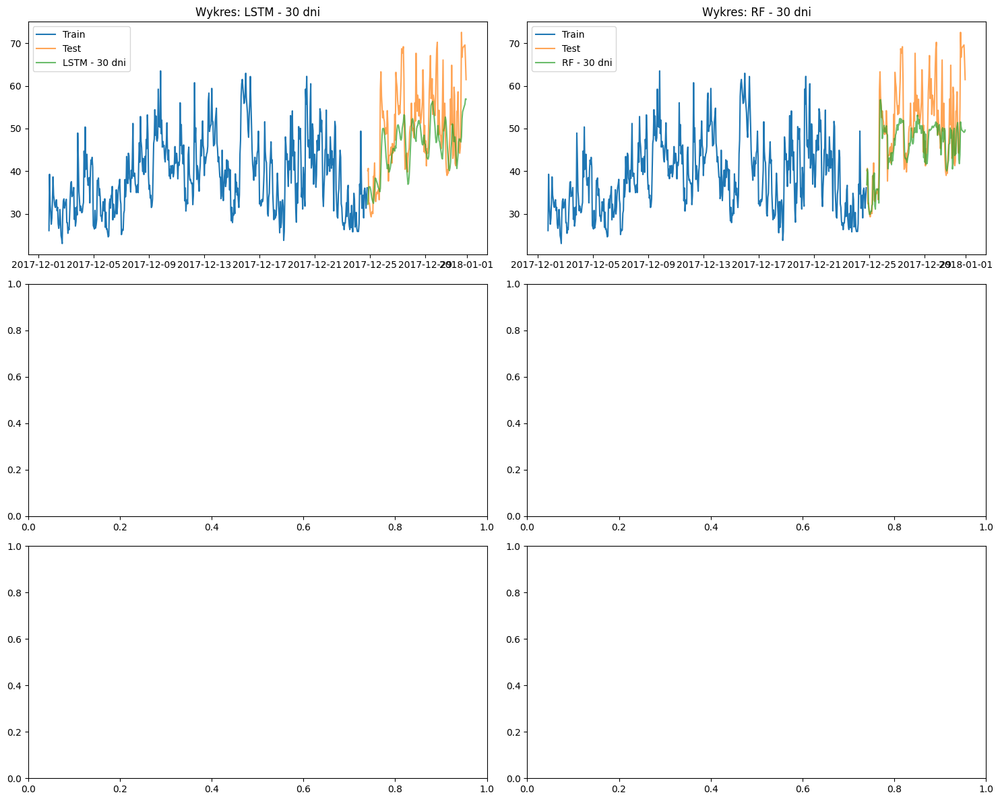


Metryki efektywności:
                            RMSE       MAE      MAPE  Czas treningu  \
Model                                                                 
Random Forest - 30 dni  7.626391  5.517000  0.100563       0.016114   
LSTM - 30 dni           8.569408  6.569071  0.123748       0.597551   

                        Czas predykcji  
Model                                   
Random Forest - 30 dni        0.835756  
LSTM - 30 dni                 0.318515  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-10-02 18:00:00               23.60    NaN    NaN    NaN    NaN    NaN   
2017-10-02 19:00:00               25.92  23.60    NaN    NaN    NaN    NaN   
2017-10-02 20:00:00               25.74  25.92  23.60    NaN    NaN    NaN   
2

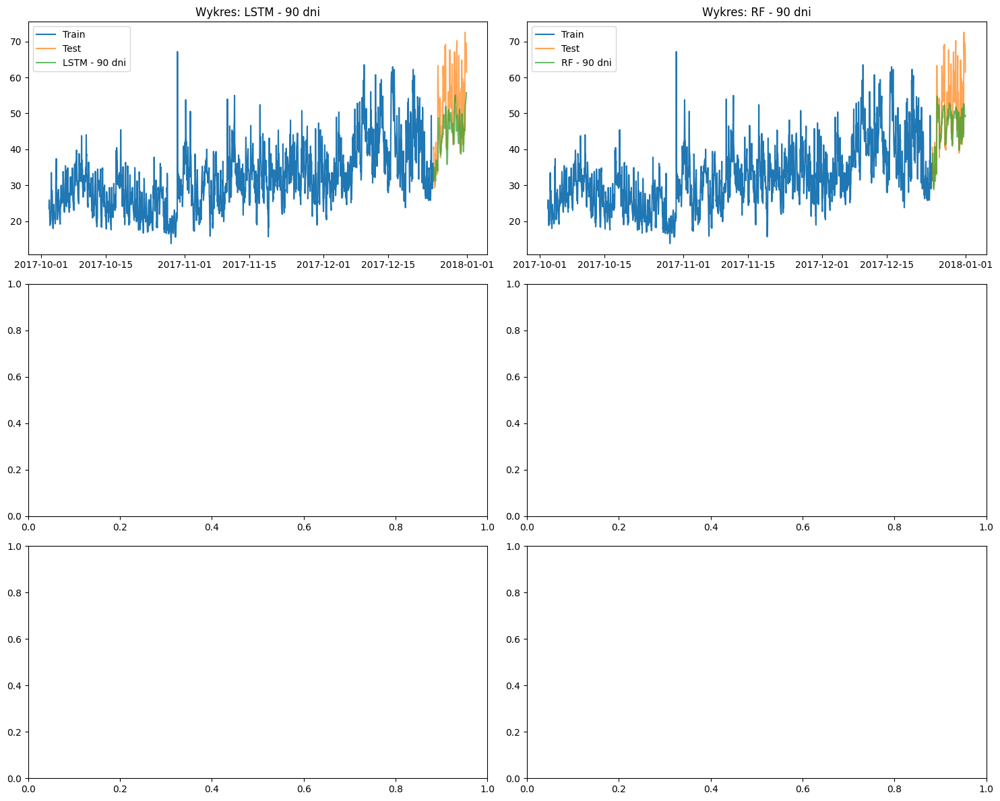


Metryki efektywności:
                            RMSE       MAE      MAPE  Czas treningu  \
Model                                                                 
Random Forest - 90 dni  7.784058  5.622070  0.102089       0.020492   
LSTM - 90 dni           9.374000  7.257483  0.134561       0.564928   

                        Czas predykcji  
Model                                   
Random Forest - 90 dni        3.700970  
LSTM - 90 dni                 0.325786  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-07-04 17:00:00               38.47    NaN    NaN    NaN    NaN    NaN   
2017-07-04 18:00:00               40.20  38.47    NaN    NaN    NaN    NaN   
2017-07-04 19:00:00               49.45  40.20  38.47    NaN    NaN    NaN   
2

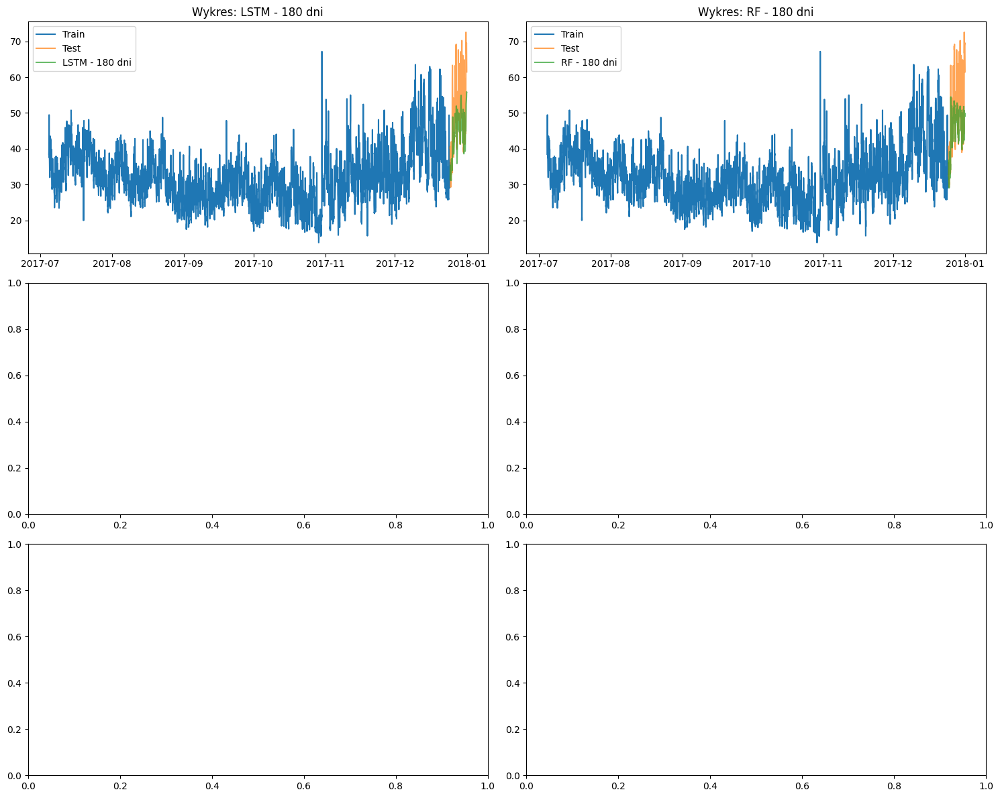


Metryki efektywności:
                             RMSE       MAE      MAPE  Czas treningu  \
Model                                                                  
Random Forest - 180 dni  7.502065  5.407688  0.098540       0.021998   
LSTM - 180 dni           9.364290  7.255430  0.134657       0.612556   

                         Czas predykcji  
Model                                    
Random Forest - 180 dni       10.140416  
LSTM - 180 dni                 0.381916  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-01-03 10:00:00               48.97    NaN    NaN    NaN    NaN    NaN   
2017-01-03 11:00:00               34.85  48.97    NaN    NaN    NaN    NaN   
2017-01-03 12:00:00               32.14  34.85  48.97    NaN    NaN    

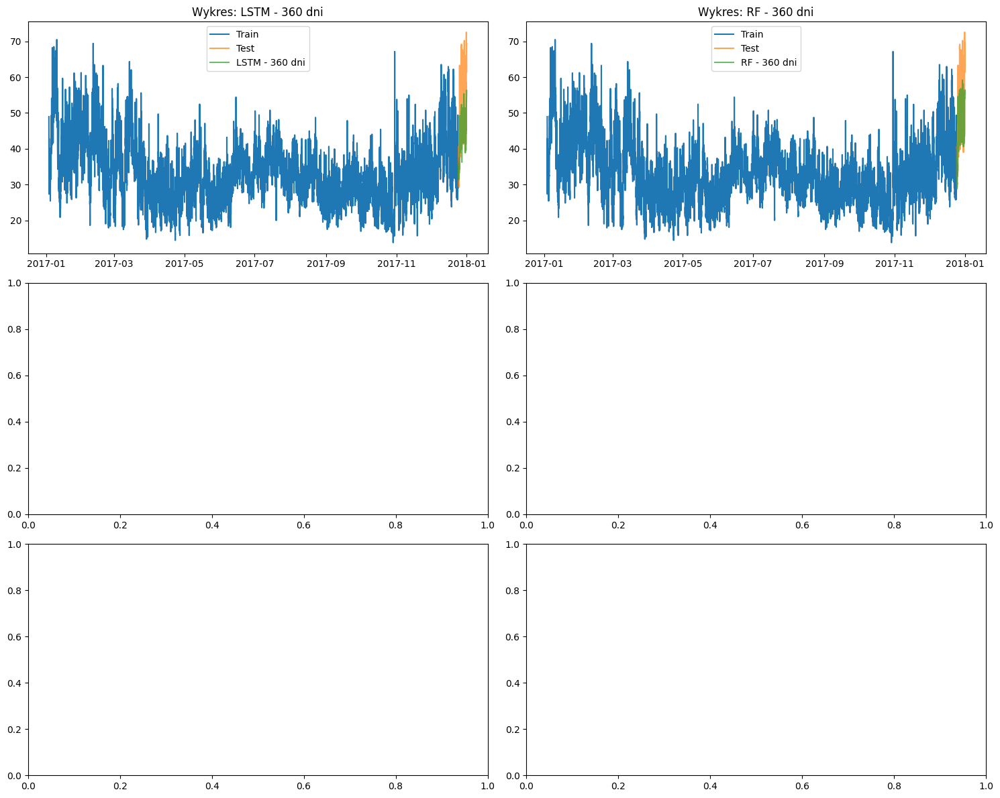


Metryki efektywności:
                             RMSE       MAE      MAPE  Czas treningu  \
Model                                                                  
Random Forest - 360 dni  6.191335  4.391101  0.082732       0.024697   
LSTM - 360 dni           9.173940  7.082004  0.131856       0.774151   

                         Czas predykcji  
Model                                    
Random Forest - 360 dni       22.605958  
LSTM - 360 dni                 0.456846  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2016-01-01 00:00:00               23.67    NaN    NaN    NaN    NaN    NaN   
2016-01-01 01:00:00               24.83  23.67    NaN    NaN    NaN    NaN   
2016-01-01 02:00:00               24.91  24.83  23.67    NaN    NaN    

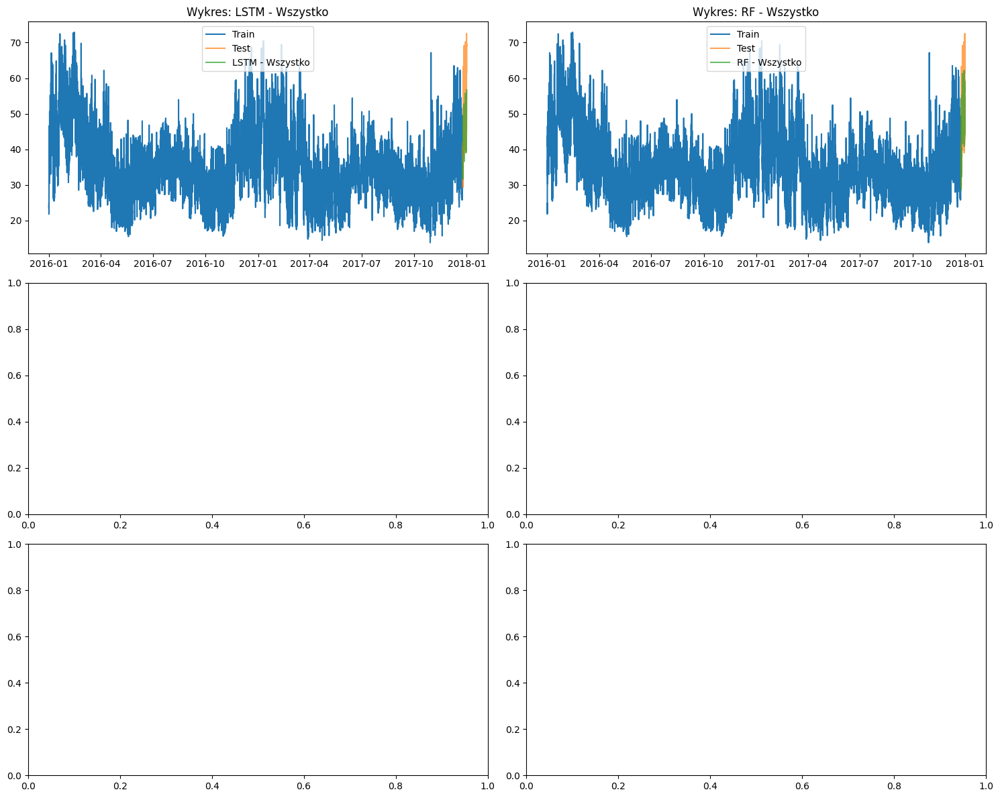


Metryki efektywności:
                              RMSE       MAE      MAPE  Czas treningu  \
Model                                                                   
Random Forest - Wszystko  5.886872  4.191628  0.080450       0.035939   
LSTM - Wszystko           8.979536  6.911747  0.129178       0.587998   

                          Czas predykcji  
Model                                     
Random Forest - Wszystko        45.93058  
LSTM - Wszystko                  0.36163  


====== Processing Building Rat_public_Leo ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-12-01 23:00:00               11.50    NaN    NaN    NaN    NaN    NaN   
2017-12-02 00:00:00               11.52  11.50    NaN    NaN    NaN    NaN   
2017-12-02 0

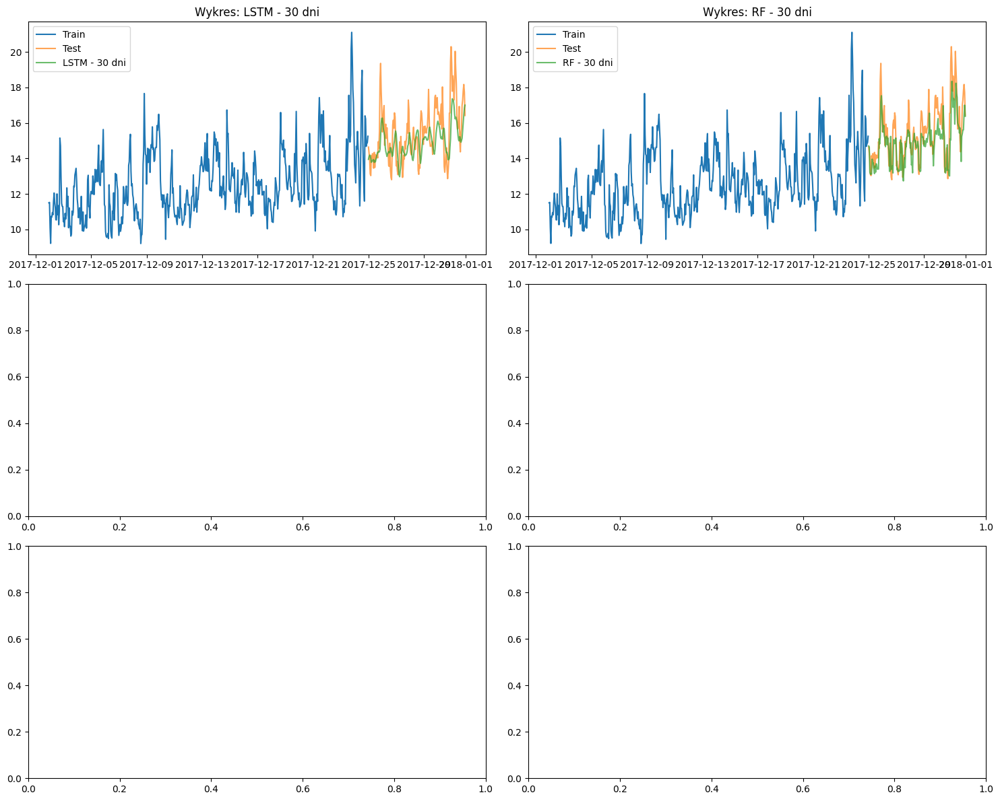


Metryki efektywności:
                            RMSE       MAE      MAPE  Czas treningu  \
Model                                                                 
Random Forest - 30 dni  1.175525  0.875207  0.054451       0.012179   
LSTM - 30 dni           1.375992  1.047488  0.065471       0.610785   

                        Czas predykcji  
Model                                   
Random Forest - 30 dni        0.873970  
LSTM - 30 dni                 0.337318  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-10-02 22:00:00               15.66    NaN    NaN    NaN    NaN    NaN   
2017-10-02 23:00:00               14.66  15.66    NaN    NaN    NaN    NaN   
2017-10-03 00:00:00               14.76  14.66  15.66    NaN    NaN    NaN   
2

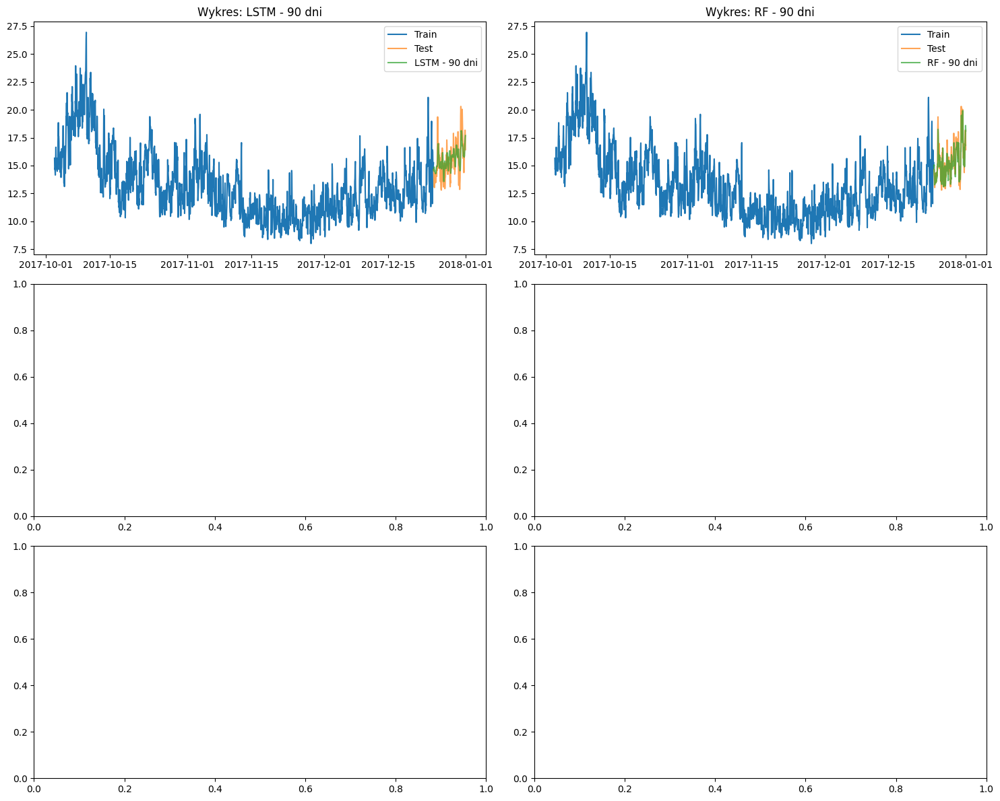


Metryki efektywności:
                            RMSE       MAE      MAPE  Czas treningu  \
Model                                                                 
Random Forest - 90 dni  0.943911  0.745995  0.047622       0.022797   
LSTM - 90 dni           1.289628  1.017597  0.066379       0.582747   

                        Czas predykcji  
Model                                   
Random Forest - 90 dni        3.509254  
LSTM - 90 dni                 0.333865  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-07-04 21:00:00               20.26    NaN    NaN    NaN    NaN    NaN   
2017-07-04 22:00:00               18.55  20.26    NaN    NaN    NaN    NaN   
2017-07-04 23:00:00               18.90  18.55  20.26    NaN    NaN    NaN   
2

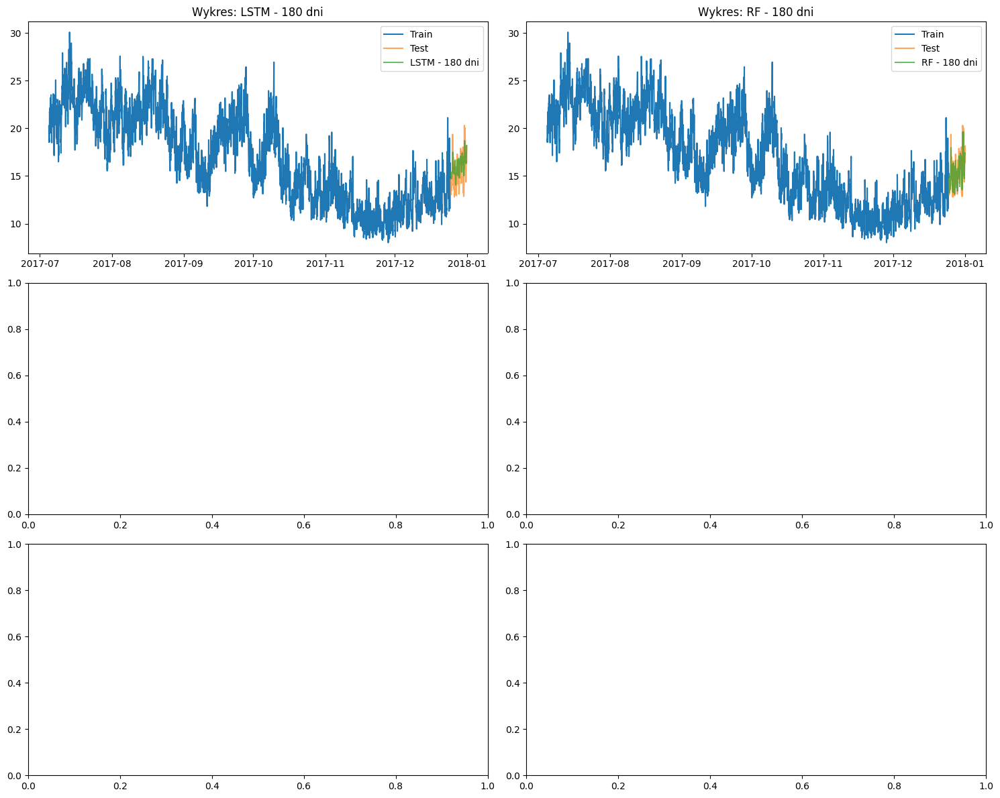


Metryki efektywności:
                             RMSE       MAE      MAPE  Czas treningu  \
Model                                                                  
Random Forest - 180 dni  0.913716  0.708071  0.045200       0.023379   
LSTM - 180 dni           1.439806  1.191467  0.079837       0.599498   

                         Czas predykcji  
Model                                    
Random Forest - 180 dni        7.986267  
LSTM - 180 dni                 0.341954  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-01-04 19:00:00               17.60    NaN    NaN    NaN    NaN    NaN   
2017-01-04 20:00:00               18.52  17.60    NaN    NaN    NaN    NaN   
2017-01-04 21:00:00               19.65  18.52  17.60    NaN    NaN    

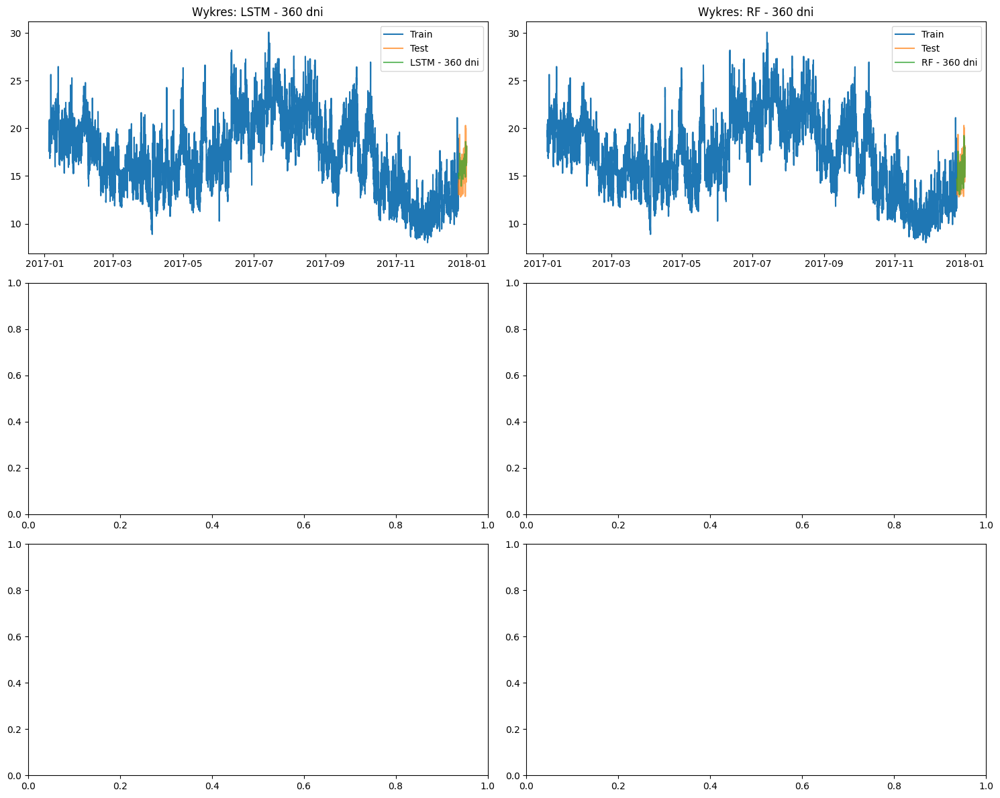


Metryki efektywności:
                             RMSE       MAE      MAPE  Czas treningu  \
Model                                                                  
Random Forest - 360 dni  0.882226  0.660329  0.042197       0.022192   
LSTM - 360 dni           1.373406  1.126139  0.075060       0.605170   

                         Czas predykcji  
Model                                    
Random Forest - 360 dni       17.990496  
LSTM - 360 dni                 0.341109  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2016-01-01 00:00:00               20.25    NaN    NaN    NaN    NaN    NaN   
2016-01-01 01:00:00               19.57  20.25    NaN    NaN    NaN    NaN   
2016-01-01 02:00:00               20.22  19.57  20.25    NaN    NaN    

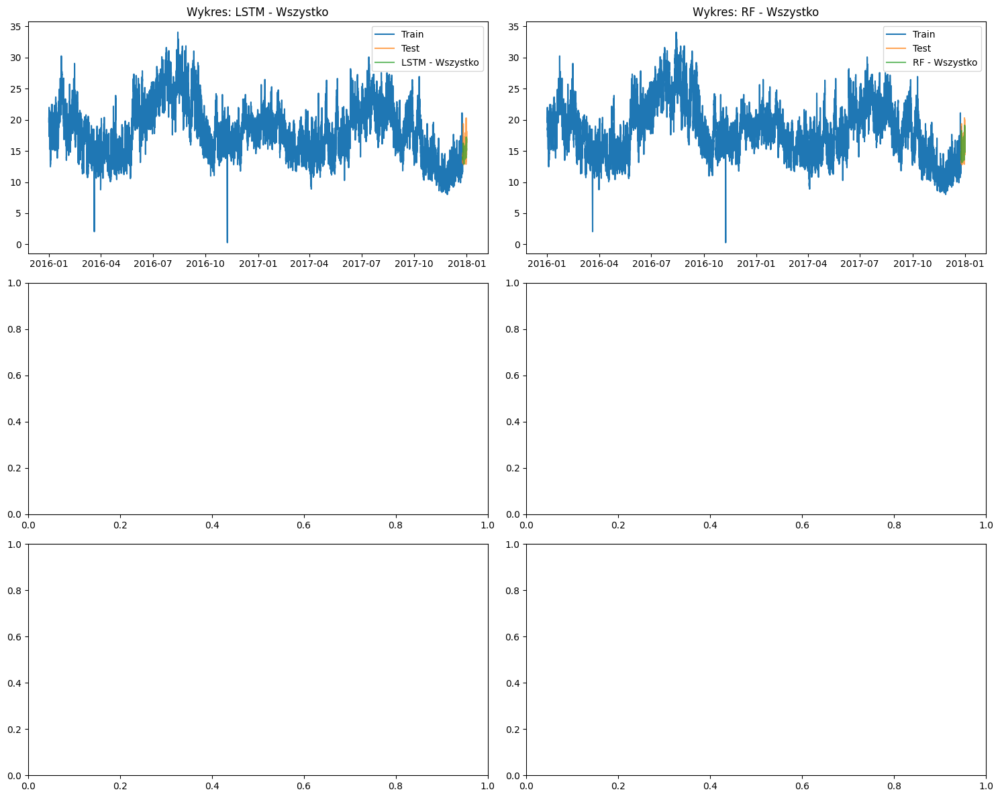


Metryki efektywności:
                              RMSE       MAE      MAPE  Czas treningu  \
Model                                                                   
Random Forest - Wszystko  0.913615  0.689719  0.044164       0.035504   
LSTM - Wszystko           1.437542  1.096703  0.068373       0.588794   

                          Czas predykcji  
Model                                     
Random Forest - Wszystko       41.055684  
LSTM - Wszystko                 0.339941  


====== Processing Building Rat_public_Shanta ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-12-01 23:00:00                8.20    NaN    NaN    NaN    NaN    NaN   
2017-12-02 00:00:00                7.82   8.20    NaN    NaN    NaN    NaN   
2017-12-0

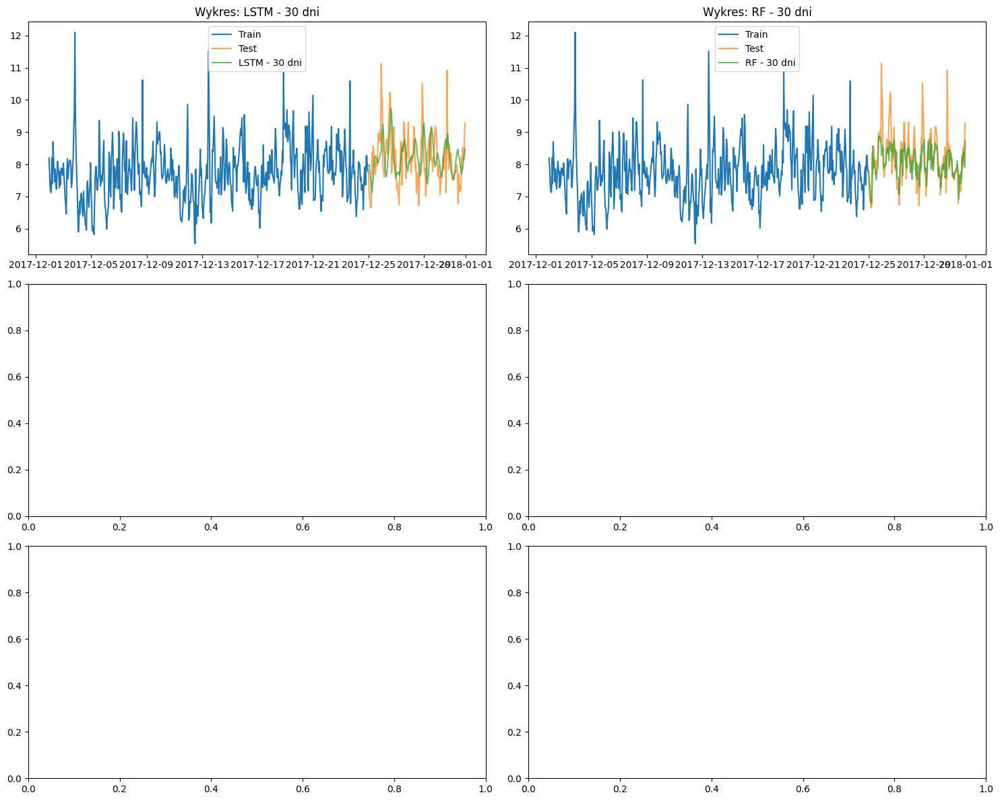


Metryki efektywności:
                            RMSE       MAE      MAPE  Czas treningu  \
Model                                                                 
Random Forest - 30 dni  0.642303  0.454760  0.053538       0.020489   
LSTM - 30 dni           0.768821  0.603025  0.073320       0.612045   

                        Czas predykcji  
Model                                   
Random Forest - 30 dni        0.988535  
LSTM - 30 dni                 0.375409  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-10-02 22:00:00               11.80    NaN    NaN    NaN    NaN    NaN   
2017-10-02 23:00:00               10.70  11.80    NaN    NaN    NaN    NaN   
2017-10-03 00:00:00               11.31  10.70  11.80    NaN    NaN    NaN   
2

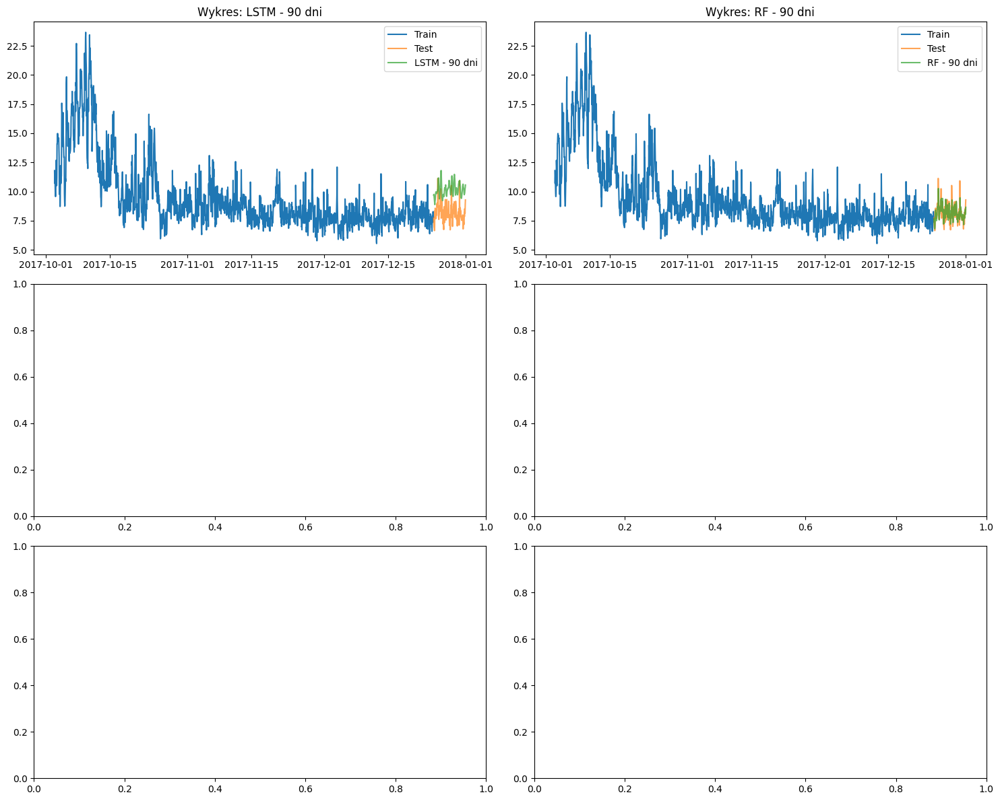


Metryki efektywności:
                            RMSE       MAE      MAPE  Czas treningu  \
Model                                                                 
Random Forest - 90 dni  0.613710  0.442090  0.052688       0.022615   
LSTM - 90 dni           2.137104  1.984488  0.250778       0.631986   

                        Czas predykcji  
Model                                   
Random Forest - 90 dni        4.149463  
LSTM - 90 dni                 0.389988  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-07-04 21:00:00               23.52    NaN    NaN    NaN    NaN    NaN   
2017-07-04 22:00:00               21.90  23.52    NaN    NaN    NaN    NaN   
2017-07-04 23:00:00               21.46  21.90  23.52    NaN    NaN    NaN   
2

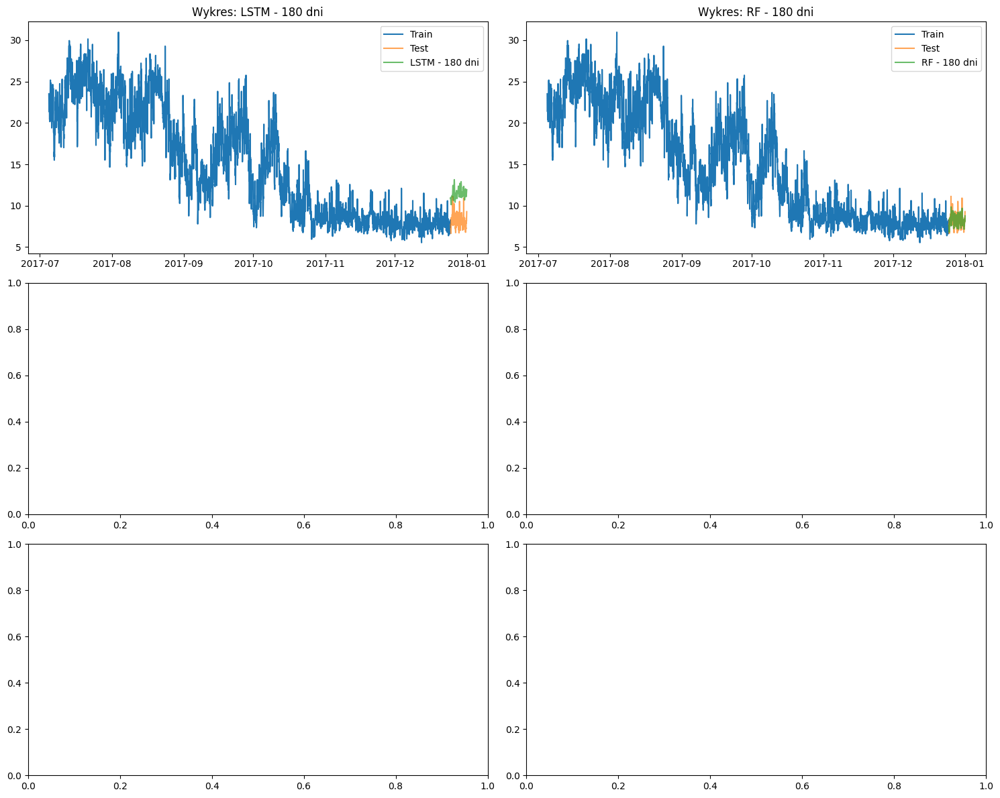


Metryki efektywności:
                             RMSE       MAE      MAPE  Czas treningu  \
Model                                                                  
Random Forest - 180 dni  0.613239  0.446655  0.053295       0.024108   
LSTM - 180 dni           3.402499  3.288609  0.411977       0.605160   

                         Czas predykcji  
Model                                    
Random Forest - 180 dni        8.646797  
LSTM - 180 dni                 0.367066  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-01-02 19:00:00                8.61    NaN    NaN    NaN    NaN    NaN   
2017-01-02 20:00:00                8.83   8.61    NaN    NaN    NaN    NaN   
2017-01-02 21:00:00                7.57   8.83   8.61    NaN    NaN    

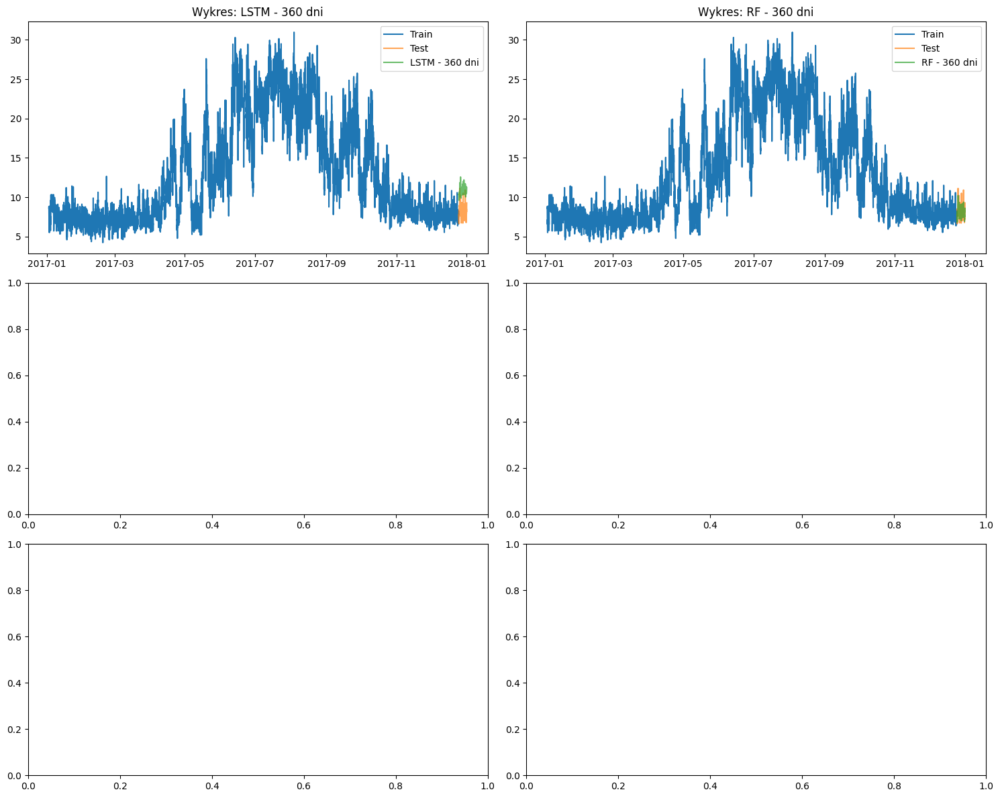


Metryki efektywności:
                             RMSE       MAE      MAPE  Czas treningu  \
Model                                                                  
Random Forest - 360 dni  0.606855  0.441861  0.052744       0.027835   
LSTM - 360 dni           2.807896  2.678128  0.336724       0.600649   

                         Czas predykcji  
Model                                    
Random Forest - 360 dni       17.706275  
LSTM - 360 dni                 0.353877  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2016-01-01 00:00:00                7.55    NaN    NaN    NaN    NaN    NaN   
2016-01-01 01:00:00                8.09   7.55    NaN    NaN    NaN    NaN   
2016-01-01 02:00:00                7.79   8.09   7.55    NaN    NaN    

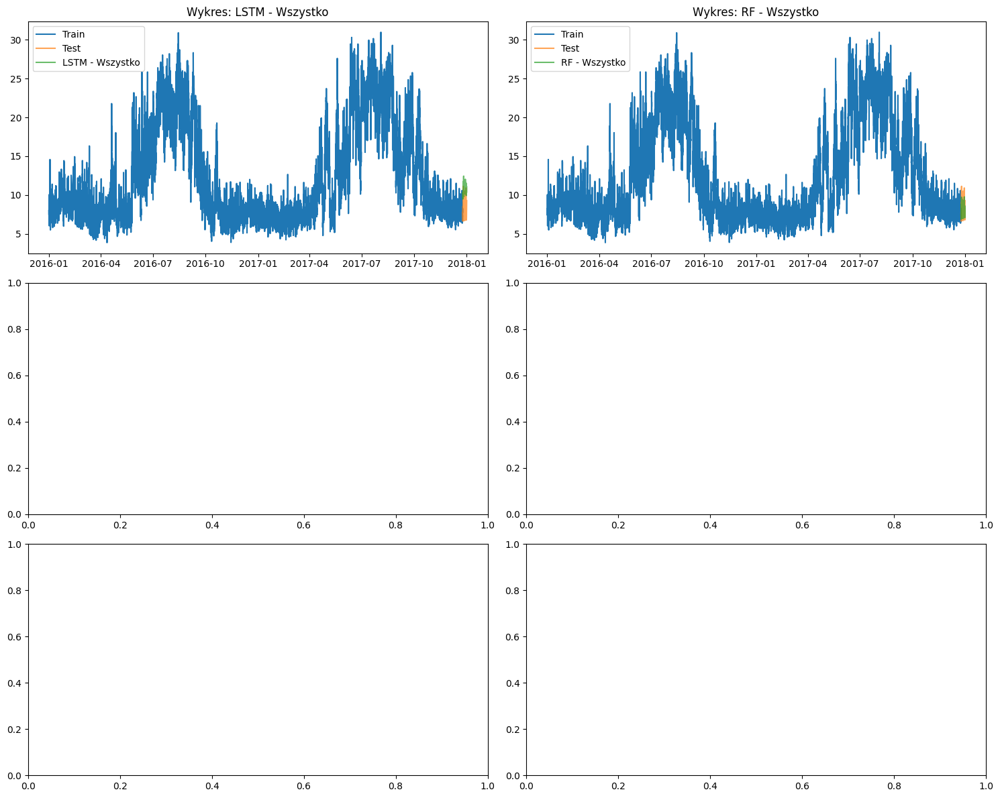


Metryki efektywności:
                              RMSE       MAE      MAPE  Czas treningu  \
Model                                                                   
Random Forest - Wszystko  0.615869  0.445851  0.053242       0.030625   
LSTM - Wszystko           2.676331  2.544244  0.320171       0.617639   

                          Czas predykcji  
Model                                     
Random Forest - Wszystko       47.157155  
LSTM - Wszystko                 0.341431  


====== Processing Building Rat_public_Tamra ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-12-01 23:00:00               15.99    NaN    NaN    NaN    NaN    NaN   
2017-12-02 00:00:00               14.84  15.99    NaN    NaN    NaN    NaN   
2017-12-02

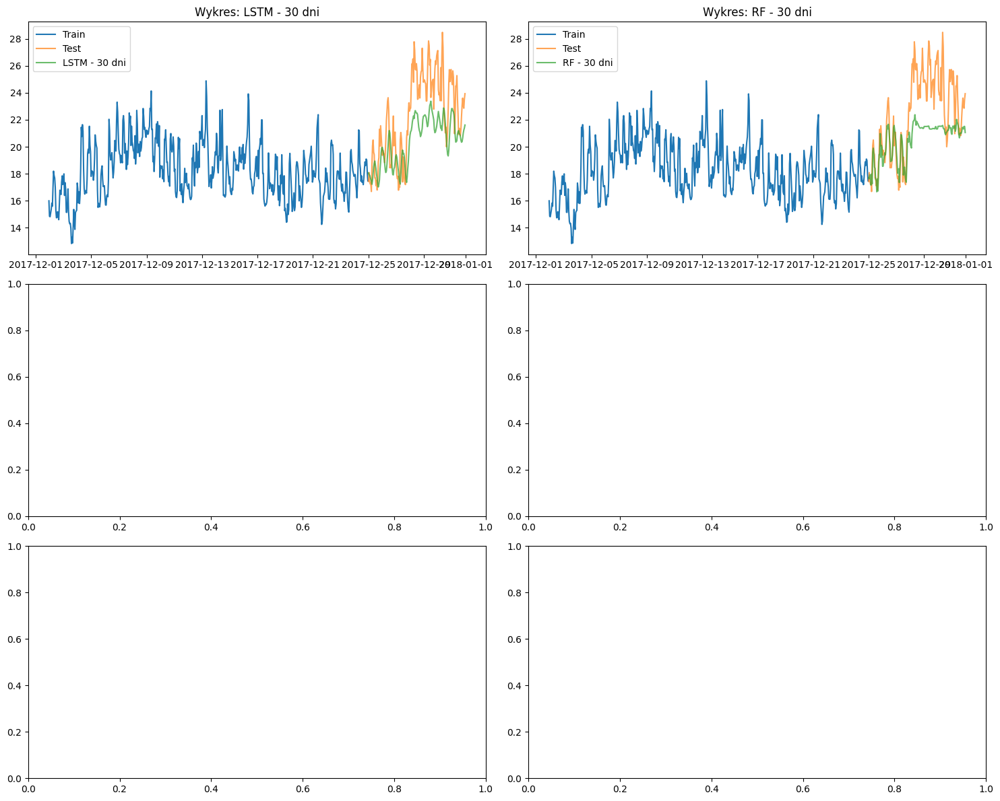


Metryki efektywności:
                            RMSE       MAE      MAPE  Czas treningu  \
Model                                                                 
Random Forest - 30 dni  2.758798  2.146745  0.088892       0.032378   
LSTM - 30 dni           2.796096  2.304973  0.097833       0.665022   

                        Czas predykcji  
Model                                   
Random Forest - 30 dni        0.921862  
LSTM - 30 dni                 0.373903  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-10-02 22:00:00               16.55    NaN    NaN    NaN    NaN    NaN   
2017-10-02 23:00:00               15.86  16.55    NaN    NaN    NaN    NaN   
2017-10-03 00:00:00               14.74  15.86  16.55    NaN    NaN    NaN   
2

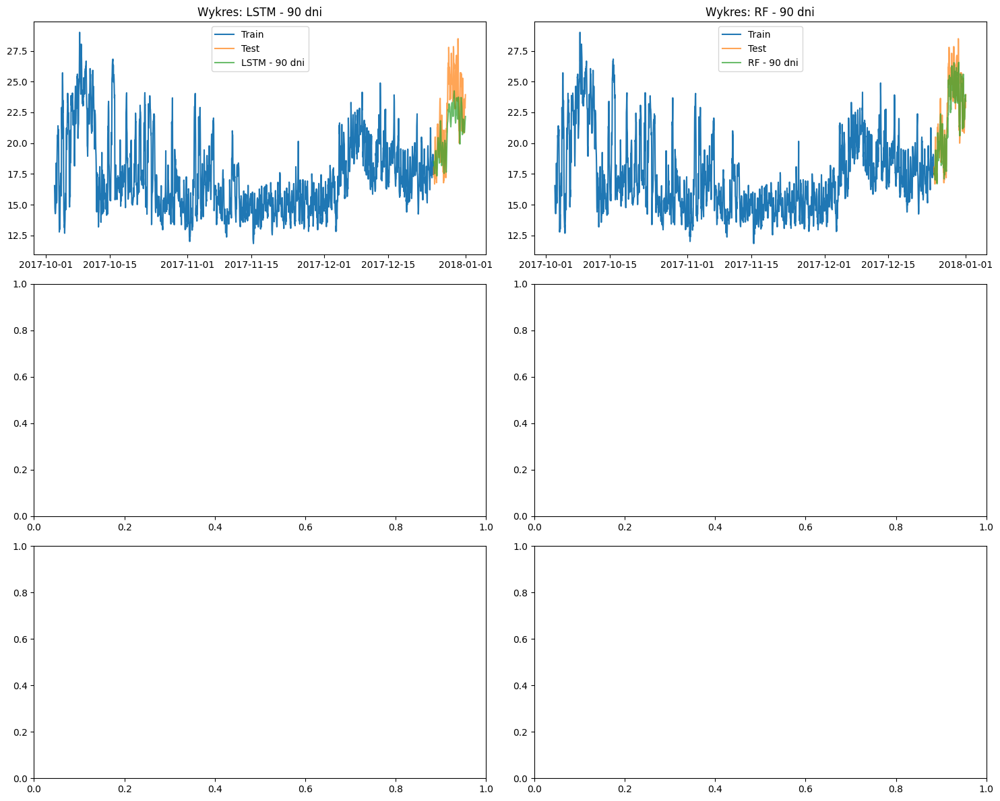


Metryki efektywności:
                            RMSE       MAE      MAPE  Czas treningu  \
Model                                                                 
Random Forest - 90 dni  1.306636  0.999684  0.044225       0.021942   
LSTM - 90 dni           2.401345  1.990847  0.086024       0.658431   

                        Czas predykcji  
Model                                   
Random Forest - 90 dni        3.788073  
LSTM - 90 dni                 0.361185  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-07-04 21:00:00               28.36    NaN    NaN    NaN    NaN    NaN   
2017-07-04 22:00:00               26.78  28.36    NaN    NaN    NaN    NaN   
2017-07-04 23:00:00               27.13  26.78  28.36    NaN    NaN    NaN   
2

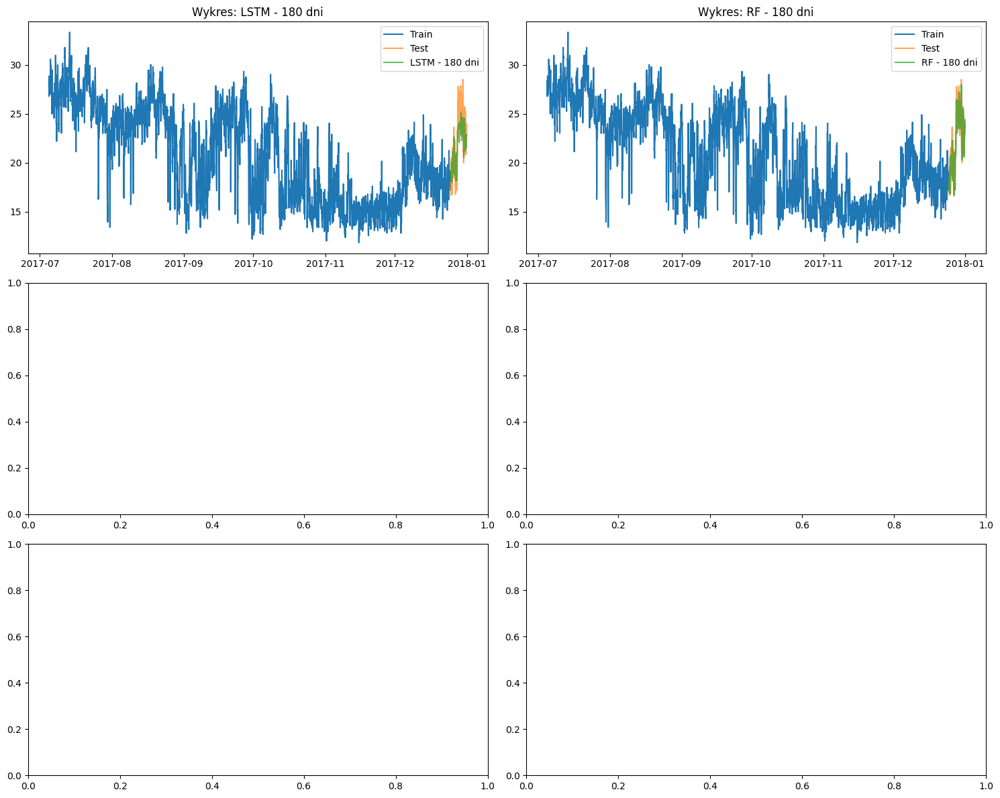


Metryki efektywności:
                             RMSE       MAE      MAPE  Czas treningu  \
Model                                                                  
Random Forest - 180 dni  1.185887  0.920526  0.041451       0.024316   
LSTM - 180 dni           2.076943  1.738677  0.077640       0.667647   

                         Czas predykcji  
Model                                    
Random Forest - 180 dni        8.843391  
LSTM - 180 dni                 0.380951  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2017-01-03 19:00:00               17.29    NaN    NaN    NaN    NaN    NaN   
2017-01-03 20:00:00               16.97  17.29    NaN    NaN    NaN    NaN   
2017-01-03 21:00:00               16.55  16.97  17.29    NaN    NaN    

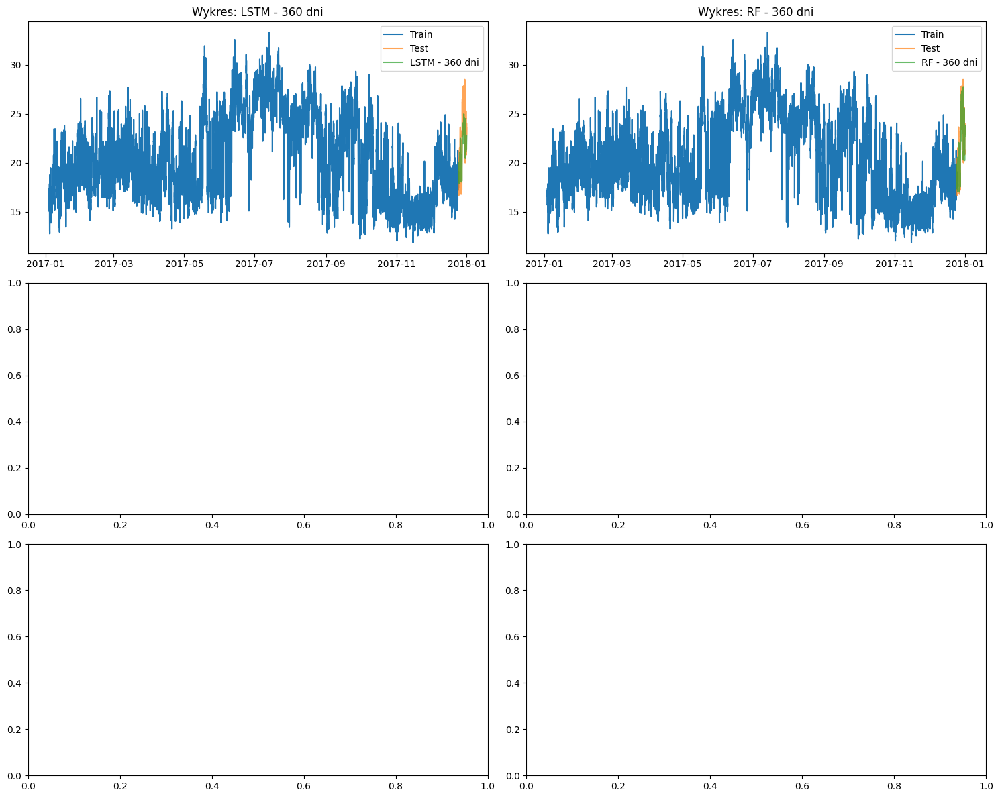


Metryki efektywności:
                             RMSE       MAE      MAPE  Czas treningu  \
Model                                                                  
Random Forest - 360 dni  1.176656  0.920823  0.040824       0.030749   
LSTM - 360 dni           2.114477  1.766561  0.078503       0.657599   

                         Czas predykcji  
Model                                    
Random Forest - 360 dni       19.251441  
LSTM - 360 dni                 0.361089  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption  lag_1  lag_2  lag_3  lag_4  lag_5  \
timestamp                                                                    
2016-01-01 00:00:00               16.08    NaN    NaN    NaN    NaN    NaN   
2016-01-01 01:00:00               16.24  16.08    NaN    NaN    NaN    NaN   
2016-01-01 02:00:00               16.57  16.24  16.08    NaN    NaN    

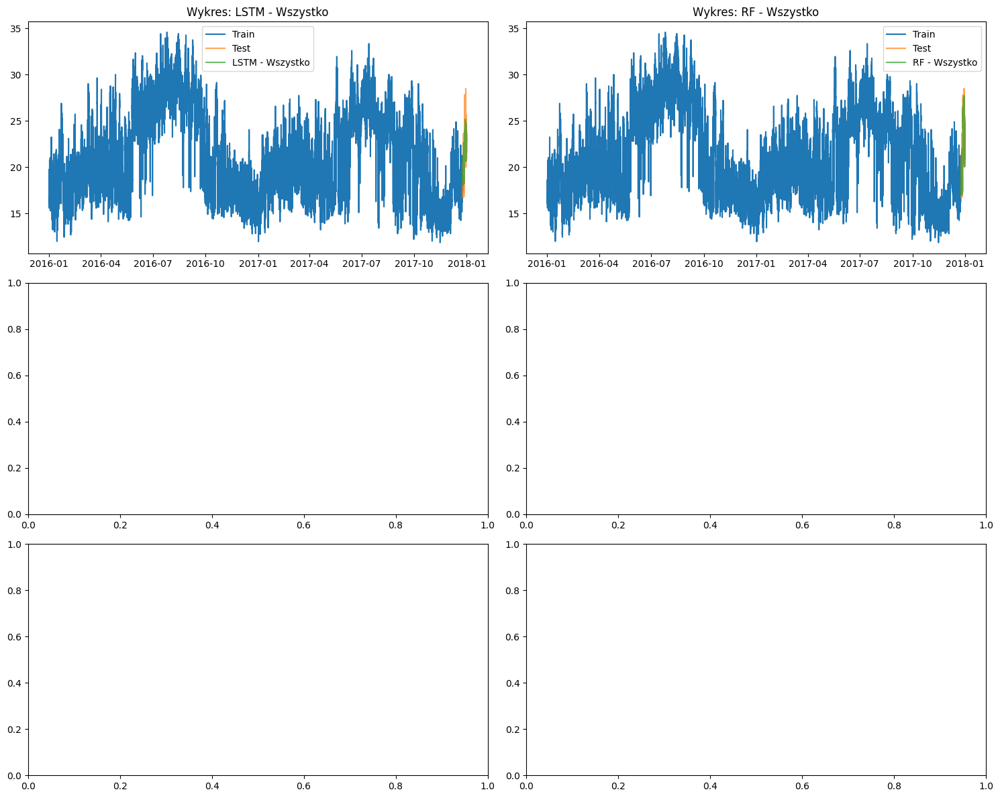


Metryki efektywności:
                              RMSE      MAE      MAPE  Czas treningu  \
Model                                                                  
Random Forest - Wszystko  1.177906  0.91473  0.040537       0.031472   
LSTM - Wszystko           2.061255  1.72775  0.077449       0.850841   

                          Czas predykcji  
Model                                     
Random Forest - Wszystko       44.254906  
LSTM - Wszystko                 0.461969  


====== Processing Building Wolf_education_Tori ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption     lag_1     lag_2     lag_3  \
timestamp                                                               
2017-12-02 00:00:00            281.4300       NaN       NaN       NaN   
2017-12-02 01:00:00            278.2525  281.4300       NaN       NaN   
2017-12-02 02:00:00            

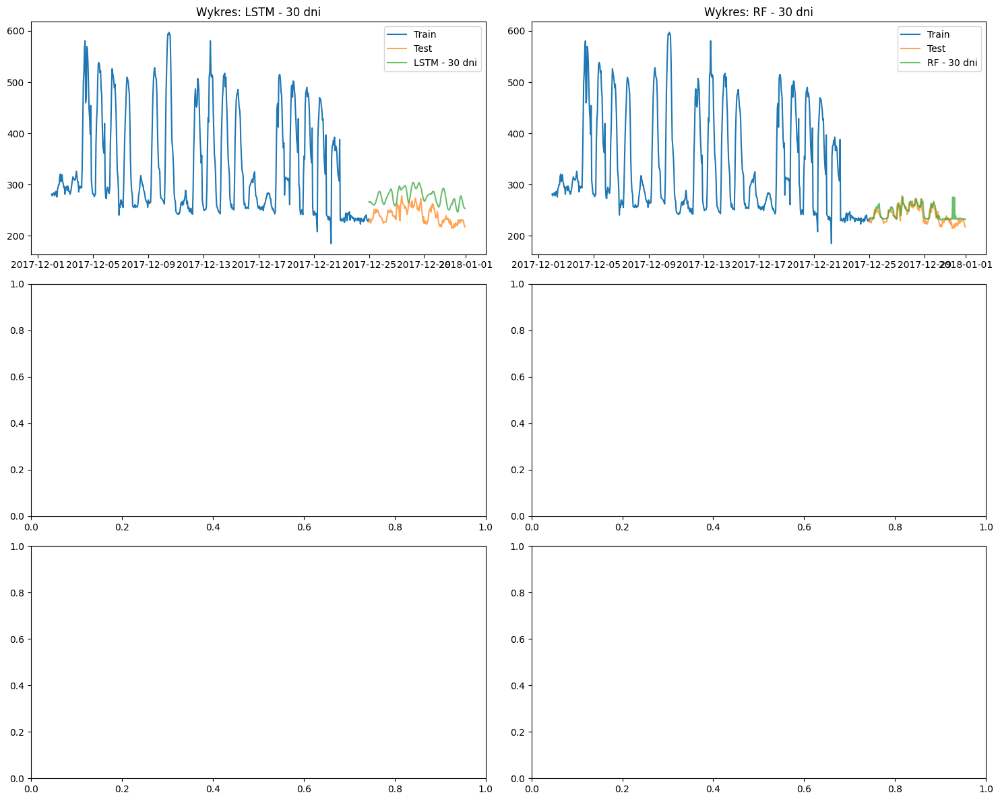


Metryki efektywności:
                             RMSE        MAE      MAPE  Czas treningu  \
Model                                                                   
Random Forest - 30 dni  11.040322   7.836443  0.033167       0.019255   
LSTM - 30 dni           37.447238  35.317688  0.148817       0.663746   

                        Czas predykcji  
Model                                   
Random Forest - 30 dni        0.996612  
LSTM - 30 dni                 0.375843  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption     lag_1     lag_2     lag_3  \
timestamp                                                               
2017-10-02 23:00:00            300.3650       NaN       NaN       NaN   
2017-10-03 00:00:00            283.1625  300.3650       NaN       NaN   
2017-10-03 01:00:00            286.2825  283.1625  300.3650       NaN   
2017-10-03 02:00:0

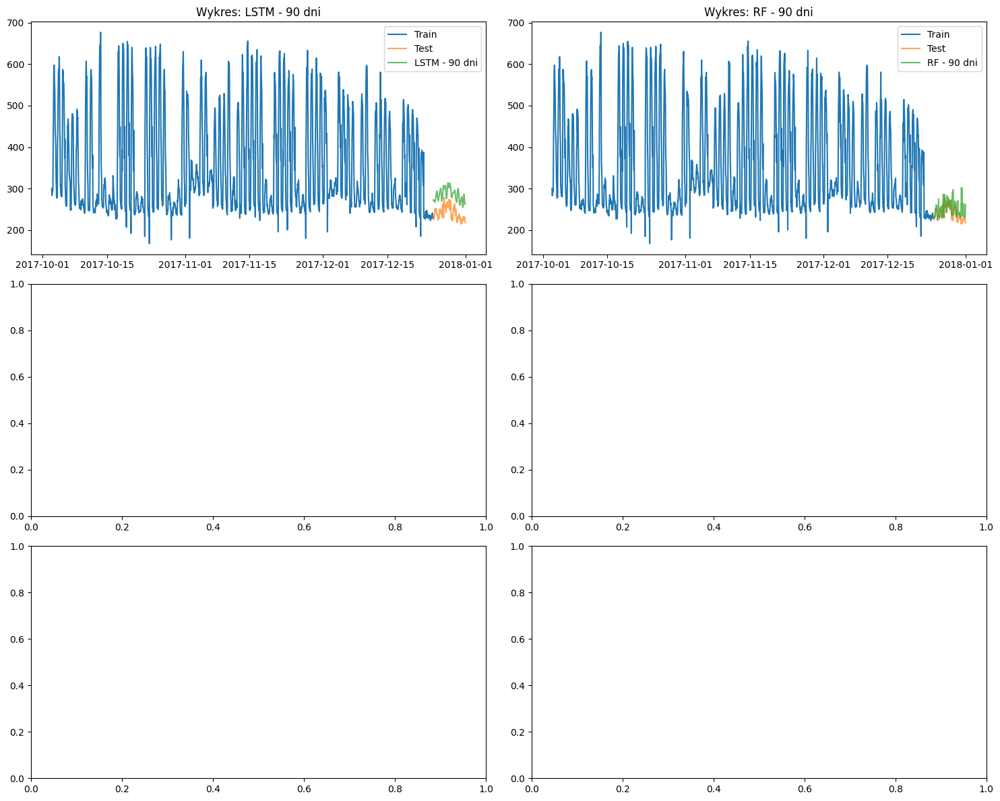


Metryki efektywności:
                             RMSE        MAE      MAPE  Czas treningu  \
Model                                                                   
Random Forest - 90 dni  21.371693  13.760981  0.059277       0.019476   
LSTM - 90 dni           45.886126  44.210298  0.185796       0.710449   

                        Czas predykcji  
Model                                   
Random Forest - 90 dni        4.406895  
LSTM - 90 dni                 0.389550  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption     lag_1     lag_2     lag_3  \
timestamp                                                               
2017-07-04 17:00:00            388.1900       NaN       NaN       NaN   
2017-07-04 18:00:00            369.0725  388.1900       NaN       NaN   
2017-07-04 19:00:00            374.7800  369.0725  388.1900       NaN   
2017-07-04 20:00:0

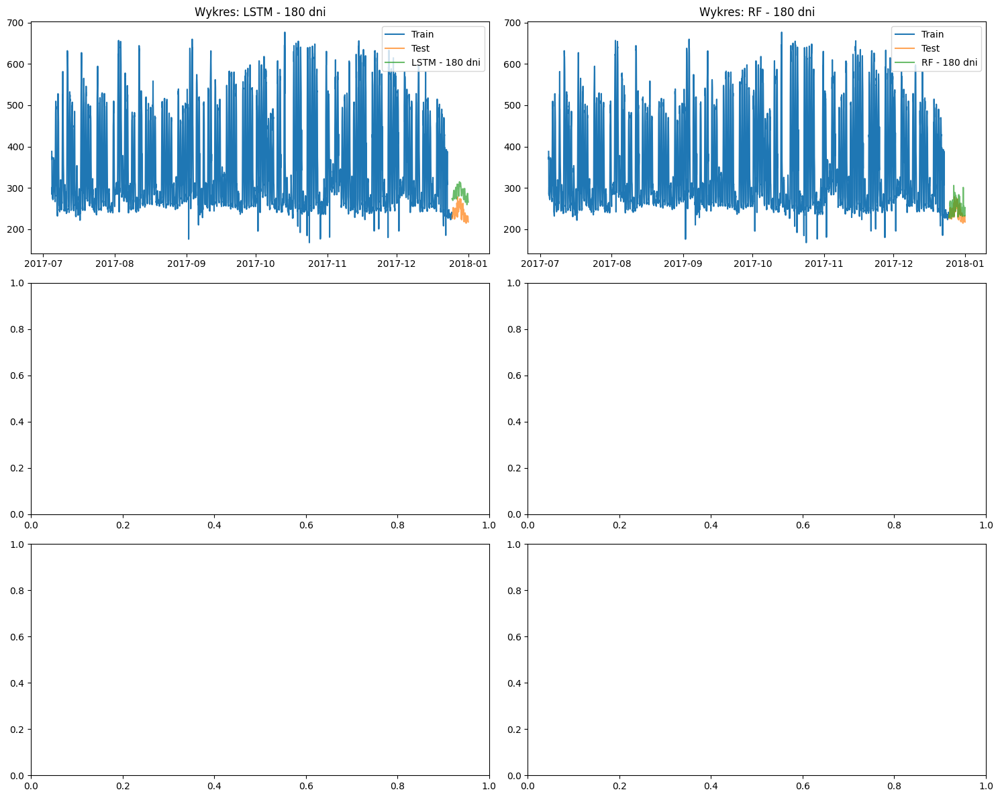


Metryki efektywności:
                              RMSE        MAE      MAPE  Czas treningu  \
Model                                                                    
Random Forest - 180 dni  18.150831  12.951725  0.054880       0.020838   
LSTM - 180 dni           47.464911  46.091680  0.193686       0.628591   

                         Czas predykcji  
Model                                    
Random Forest - 180 dni       10.167637  
LSTM - 180 dni                 0.352810  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption     lag_1     lag_2     lag_3  \
timestamp                                                               
2017-01-05 12:00:00            331.9550       NaN       NaN       NaN   
2017-01-05 13:00:00            335.7825  331.9550       NaN       NaN   
2017-01-05 14:00:00            335.7475  335.7825  331.9550       NaN   
2017-01-05

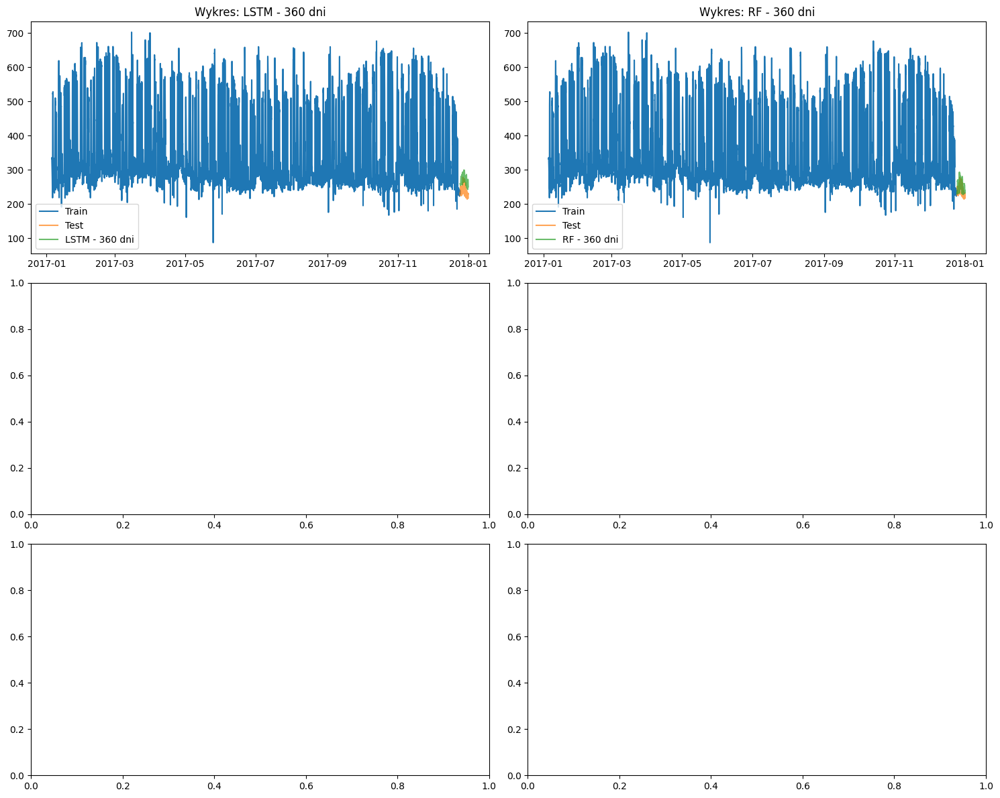


Metryki efektywności:
                              RMSE        MAE      MAPE  Czas treningu  \
Model                                                                    
Random Forest - 360 dni  14.665190  11.655073  0.048966       0.021044   
LSTM - 360 dni           33.137548  30.944811  0.130483       0.728204   

                         Czas predykcji  
Model                                    
Random Forest - 360 dni       23.550372  
LSTM - 360 dni                 0.361055  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption     lag_1     lag_2     lag_3  \
timestamp                                                               
2016-01-01 00:00:00            257.2000       NaN       NaN       NaN   
2016-01-01 01:00:00            257.0425  257.2000       NaN       NaN   
2016-01-01 02:00:00            255.2725  257.0425  257.2000       NaN   
2016-01-01

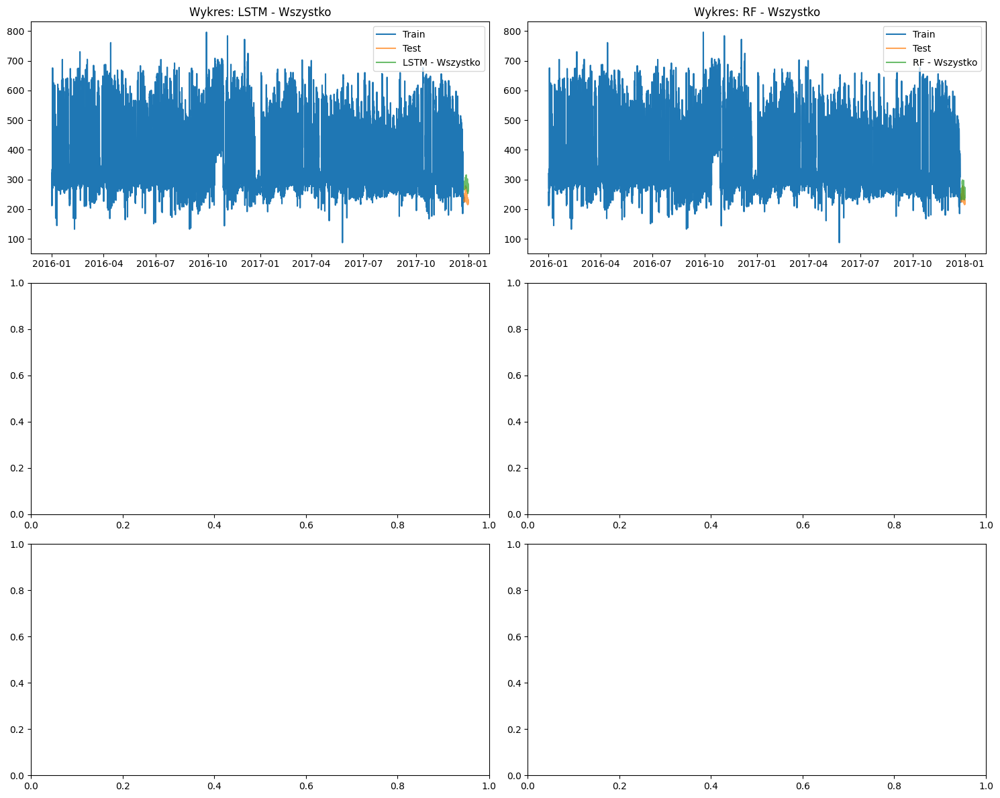


Metryki efektywności:
                               RMSE        MAE      MAPE  Czas treningu  \
Model                                                                     
Random Forest - Wszystko  19.650349  15.379063  0.065130       0.031599   
LSTM - Wszystko           45.966492  44.153194  0.185488       0.646265   

                          Czas predykcji  
Model                                     
Random Forest - Wszystko       52.311410  
LSTM - Wszystko                 0.352418  


====== Processing Building Wolf_retail_Toshia ======
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption    lag_1    lag_2    lag_3    lag_4  \
timestamp                                                                     
2017-12-02 00:00:00             28.9750      NaN      NaN      NaN      NaN   
2017-12-02 01:00:00             29.2050  28.9750      NaN      NaN      NaN

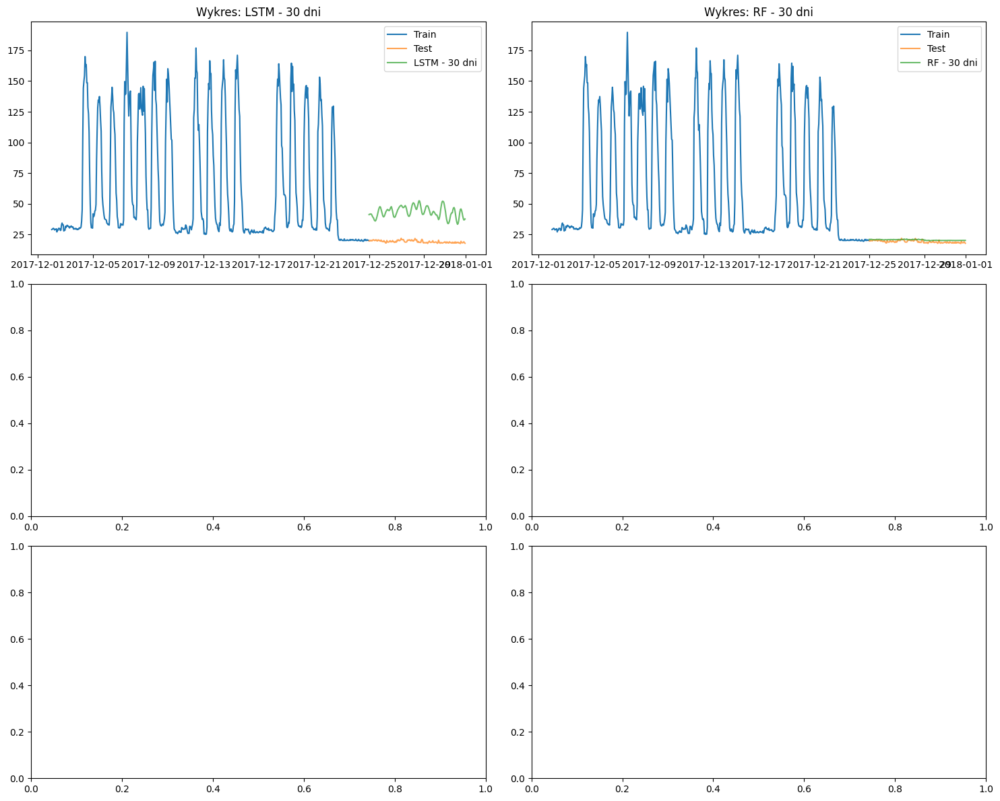


Metryki efektywności:
                             RMSE        MAE      MAPE  Czas treningu  \
Model                                                                   
Random Forest - 30 dni   1.526193   1.356048  0.072567       0.018714   
LSTM - 30 dni           24.534199  24.138954  1.264348       0.622966   

                        Czas predykcji  
Model                                   
Random Forest - 30 dni        0.944354  
LSTM - 30 dni                 0.355827  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption    lag_1    lag_2    lag_3    lag_4  \
timestamp                                                                     
2017-10-02 23:00:00             30.6875      NaN      NaN      NaN      NaN   
2017-10-03 00:00:00             31.5875  30.6875      NaN      NaN      NaN   
2017-10-03 01:00:00             31.6100  31.5875  30.6875      NaN 

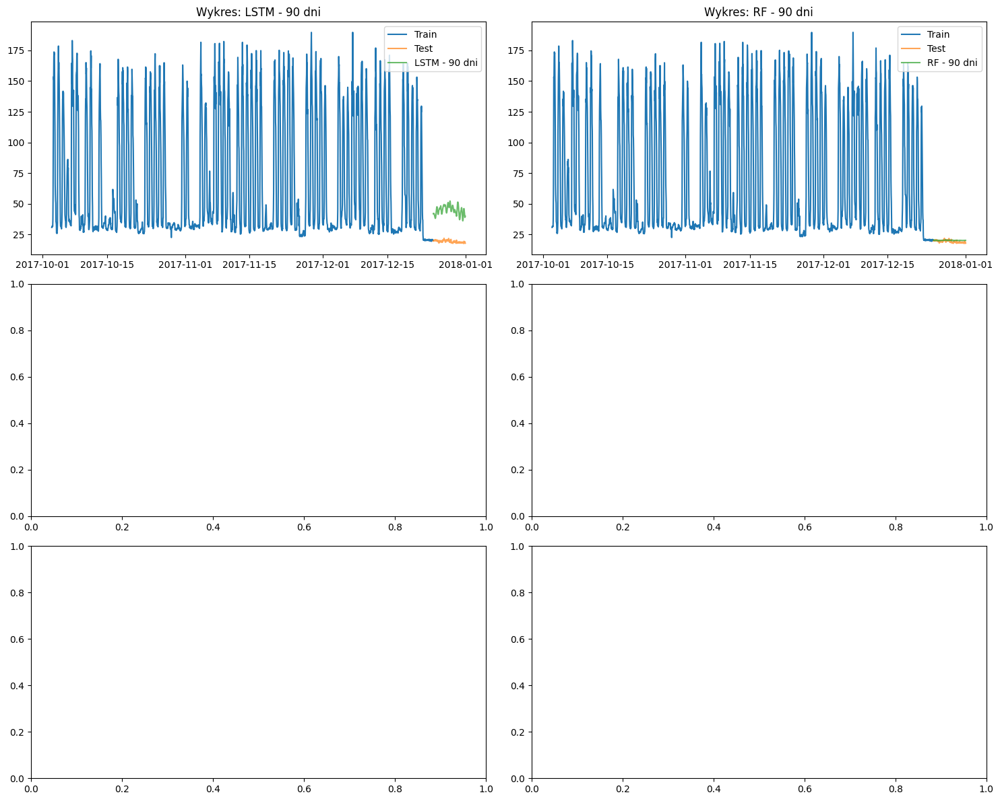


Metryki efektywności:
                             RMSE        MAE      MAPE  Czas treningu  \
Model                                                                   
Random Forest - 90 dni   1.334453   1.136731  0.061050       0.019265   
LSTM - 90 dni           25.725185  25.459516  1.333515       0.623671   

                        Czas predykcji  
Model                                   
Random Forest - 90 dni        4.511975  
LSTM - 90 dni                 0.368308  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption    lag_1    lag_2    lag_3    lag_4  \
timestamp                                                                     
2017-07-04 17:00:00             95.4675      NaN      NaN      NaN      NaN   
2017-07-04 18:00:00             69.9700  95.4675      NaN      NaN      NaN   
2017-07-04 19:00:00             45.8550  69.9700  95.4675      NaN 

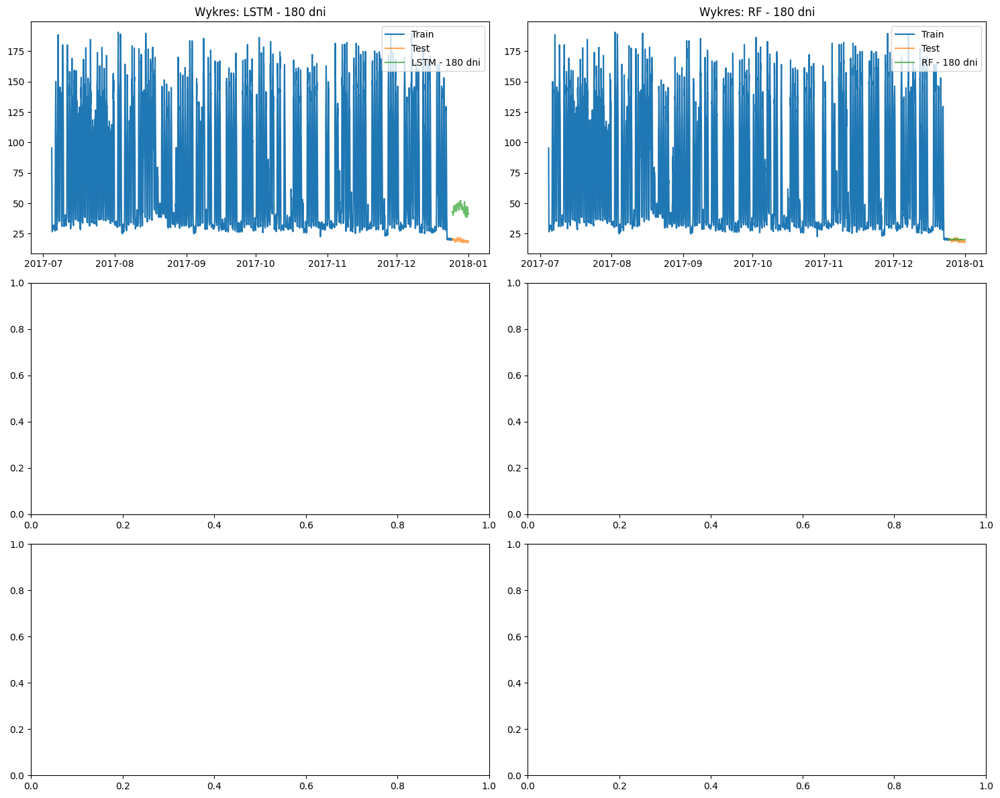


Metryki efektywności:
                              RMSE        MAE      MAPE  Czas treningu  \
Model                                                                    
Random Forest - 180 dni   1.315417   1.118870  0.060097       0.021417   
LSTM - 180 dni           26.747821  26.550532  1.390648       0.638474   

                         Czas predykcji  
Model                                    
Random Forest - 180 dni        9.750416  
LSTM - 180 dni                 0.386036  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption    lag_1    lag_2    lag_3    lag_4  \
timestamp                                                                     
2017-01-05 13:00:00             31.1300      NaN      NaN      NaN      NaN   
2017-01-05 14:00:00             31.1000  31.1300      NaN      NaN      NaN   
2017-01-05 15:00:00             31.9150  31.1000  31.1300  

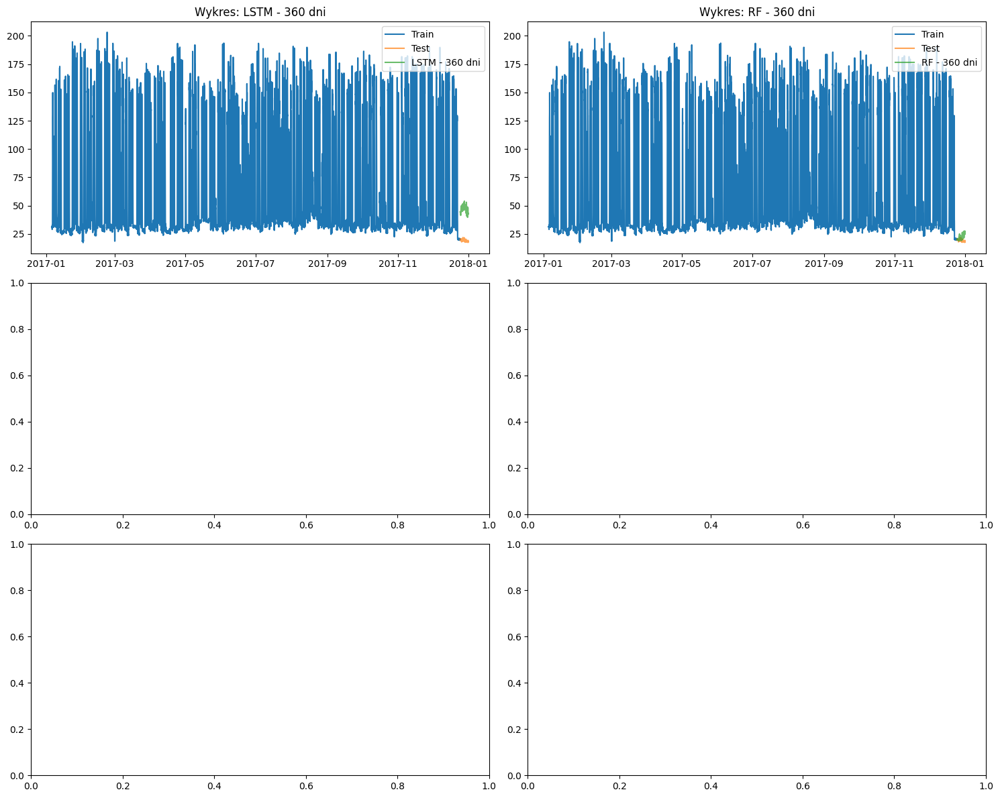


Metryki efektywności:
                              RMSE        MAE      MAPE  Czas treningu  \
Model                                                                    
Random Forest - 360 dni   4.408181   3.329603  0.178803       0.030529   
LSTM - 360 dni           28.377645  28.185170  1.476174       0.602366   

                         Czas predykcji  
Model                                    
Random Forest - 360 dni       22.861950  
LSTM - 360 dni                 0.405653  
Reloading Tuner from tuning_pred\energy_forecast\tuner0.json
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
LSTM DONE
Trenowanie Random Forest...
                     energy_consumption    lag_1    lag_2    lag_3    lag_4  \
timestamp                                                                     
2016-01-01 00:00:00             17.6575      NaN      NaN      NaN      NaN   
2016-01-01 01:00:00             18.5775  17.6575      NaN      NaN      NaN   
2016-01-01 02:00:00             18.1275  18.5775  17.6575  

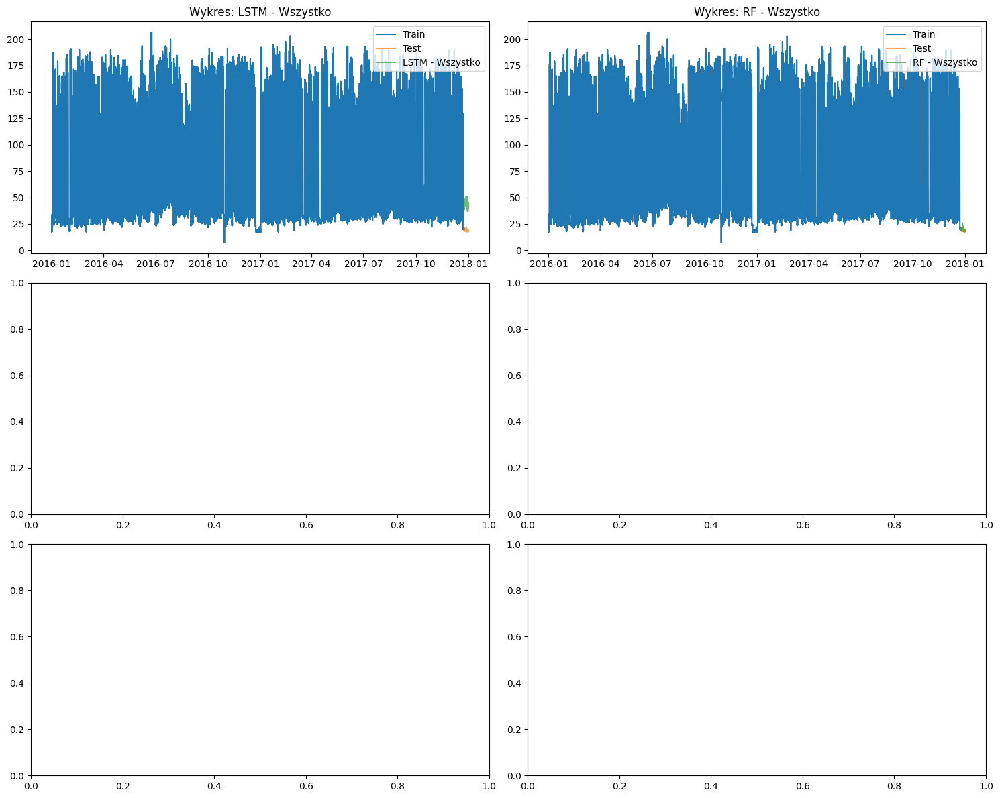


Metryki efektywności:
                               RMSE        MAE      MAPE  Czas treningu  \
Model                                                                     
Random Forest - Wszystko   0.764336   0.518968  0.026820       0.032398   
LSTM - Wszystko           25.656579  25.438491  1.332413       0.656102   

                          Czas predykcji  
Model                                     
Random Forest - Wszystko       55.551991  
LSTM - Wszystko                 0.383510  


In [18]:
import warnings
warnings.filterwarnings('ignore')
warnings.filterwarnings("ignore", category=UserWarning)

sorted_buildings = sorted(df_final['building_id'].unique())

selected_buildings = sorted_buildings[:20]

all_results_2 = []
all_metrics_2 = []

for i in selected_buildings:
    print(f"\n\n====== Processing Building {i} ======")

    data = df_final[df_final['building_id'] == i].copy()
    data['timestamp'] = pd.to_datetime(data['timestamp'])
    data = data.set_index('timestamp').sort_index()
    data = data.asfreq('h')
    data['energy_consumption'] = data['energy_consumption'].interpolate()
    data = data.dropna(subset=['energy_consumption', 'airTemperature'])

    for k, i in {"30 dni": -720, "90 dni": -2160, "180 dni": -4320, "360 dni": -8640, "Wszystko": 0}.items():
        train = data['energy_consumption'][i:-168]
        test = data['energy_consumption'][-168:]

        features = ['energy_consumption', 'airTemperature', 'sqm']
        target = 'energy_consumption'
        data = data[features].dropna()

        train_lstm = data.iloc[i:-168]
        test_lstm = data.iloc[-168:]

        predictions, true_values, lstmTimes = train_and_predict(train_lstm, test_lstm, target)
        print("LSTM DONE")

        rf_model, X_test_rf, y_test_rf, rfTimes = doRandomForest(train, test)
        print("RF DONE")

        results = pd.DataFrame(index=test.index)
        metrics = []

        # LSTM
        results[f'LSTM - {k}'] = predictions
        metrics.append(evaluate_model(test, results[f'LSTM - {k}'], f'LSTM - {k}', model_time=lstmTimes['LSTMPredict'], trening_time=lstmTimes['LSTMTrain']))

        # Random Forest
        results[f'RF - {k}'] = rf_model.predict(X_test_rf)
        metrics.append(evaluate_model(test, results[f'RF - {k}'], f'Random Forest - {k}', trening_time=rfTimes['RFTrain'], model_time=rfTimes['RFModel']))

        fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(15, 12))
        axes = axes.flatten()

        for i, col in enumerate(results.columns[:2]):
            ax = axes[i]
            ax.plot(train, label='Train')
            ax.plot(test, label='Test', alpha=0.7)
            ax.plot(results[col], label=col, alpha=0.7)
            ax.set_title(f'Wykres: {col}')
            ax.legend()

        plt.tight_layout()
        plt.show()

        metrics_df = pd.DataFrame(metrics).set_index('Model')
        print("\nMetryki efektywności:")
        print(metrics_df.sort_values('RMSE'))

        all_results_2.append(results)
        all_metrics_2.append(metrics)


In [19]:
df_list = []
for iteration in all_metrics_2:
    df_iter = pd.DataFrame(iteration)
    df_list.append(df_iter)

full_df = pd.concat(df_list, ignore_index=True)

results = full_df[full_df['RMSE'] <2000].groupby('Model').agg({
    'RMSE': 'mean',
    'MAE': 'mean',
    'MAPE': 'mean',
    'Czas treningu': 'mean',
    'Czas predykcji': 'mean'
}).reset_index()

results = results.sort_values('RMSE').reset_index(drop=True)

results['Ranking'] = results.index + 1

results['RMSE'] = results['RMSE'].round(4)
results['MAE'] = results['MAE'].round(4)
results['MAPE'] = results['MAPE'].round(6)
results['Czas treningu'] = results['Czas treningu'].apply(lambda x: f"{x:.3f} s" if pd.notnull(x) else "Brak")
results['Czas predykcji'] = results['Czas predykcji'].round(3).astype(str) + " s"

final_results = results[['Ranking', 'Model', 'RMSE', 'MAE', 'MAPE', 'Czas treningu', 'Czas predykcji']]

print("ŚREDNIE WYNIKI DLA WSZYSTKICH MODELI:")
print(final_results.to_string(index=False))

best_model = results.iloc[0]
worst_model = results.iloc[-1]

print("\nPODSUMOWANIE:")
print(f"Najlepszy model: {best_model['Model']}")
print(f"- Średnie RMSE: {best_model['RMSE']}")
print(f"- Średnie MAE: {best_model['MAE']}")
print(f"- Średnie MAPE: {best_model['MAPE']}")
print(f"\nNajgorszy model: {worst_model['Model']}")
print(f"- Średnie RMSE: {worst_model['RMSE']}")
print(f"- Średnie MAE: {worst_model['MAE']}")
print(f"- Średnie MAPE: {worst_model['MAPE']}")

ŚREDNIE WYNIKI DLA WSZYSTKICH MODELI:
 Ranking                    Model    RMSE     MAE     MAPE Czas treningu Czas predykcji
       1 Random Forest - Wszystko  4.0534  2.9620 0.057891       0.030 s      520.777 s
       2   Random Forest - 30 dni  4.0939  2.9633 0.068537       0.018 s        0.892 s
       3  Random Forest - 360 dni  4.3053  3.1175 0.068614       0.025 s       19.123 s
       4  Random Forest - 180 dni  4.3864  3.1558 0.065599       0.022 s        8.671 s
       5   Random Forest - 90 dni  4.6394  3.2731 0.065996       0.022 s        3.791 s
       6            LSTM - 30 dni  8.8512  7.7868 0.215122       0.683 s        0.375 s
       7            LSTM - 90 dni 10.3196  9.2341 0.248537       0.668 s        0.396 s
       8           LSTM - 360 dni 10.9738  9.8616 0.293113       0.653 s        0.371 s
       9          LSTM - Wszystko 11.7756 10.6807 0.297527       0.628 s        0.358 s
      10           LSTM - 180 dni 12.1207 11.0952 0.309827       0.629 s         0

In [20]:
def analizuj_wyniki_z_progowaniem(lista_list, progowanie=None):
    if progowanie is None:
        progowanie = {'RMSE': float('inf'), 
                     'MAE': float('inf'), 
                     'MAPE': float('inf'),
                     'Czas treningu': float('inf'),
                     'Czas predykcji': float('inf')}
    
    podsumowanie = {}
    liczba_analizowanych_list = 0

    for lista_modeli in lista_list:
        przefiltrowane_modele = []
        for model in lista_modeli:
            include = True
            for metryka, prog in progowanie.items():
                if metryka in model and model[metryka] >= prog:
                    include = False
                    break
            if include:
                przefiltrowane_modele.append(model)
        
        if not przefiltrowane_modele:
            continue
            
        liczba_analizowanych_list += 1
        
        for model in przefiltrowane_modele:
            if model['Model'] not in podsumowanie:
                podsumowanie[model['Model']] = {
                    'RMSE': 0,
                    'MAE': 0,
                    'MAPE': 0,
                    'Czas treningu': 0,
                    'Czas predykcji': 0,
                    'Liczba wystąpień': 0
                }
            podsumowanie[model['Model']]['Liczba wystąpień'] += 1
        
        najlepsze = {
            'RMSE': {'model': None, 'wartosc': float('inf')},
            'MAE': {'model': None, 'wartosc': float('inf')},
            'MAPE': {'model': None, 'wartosc': float('inf')},
            'Czas treningu': {'model': None, 'wartosc': float('inf')},
            'Czas predykcji': {'model': None, 'wartosc': float('inf')}
        }
        
        for model in przefiltrowane_modele:
            for metryka in najlepsze:
                if metryka in model:
                    if model[metryka] < najlepsze[metryka]['wartosc']:
                        najlepsze[metryka] = {'model': model['Model'], 'wartosc': model[metryka]}
        
        for metryka, dane in najlepsze.items():
            if dane['model']:
                podsumowanie[dane['model']][metryka] += 1
    
    wyniki = {
        'podsumowanie': podsumowanie,
        'liczba_analizowanych_list': liczba_analizowanych_list,
        'progowanie': progowanie
    }
    return wyniki

def pokaz_podsumowanie(wyniki):
    print(f"\nPodsumowanie najlepszych wyników (przeanalizowano {wyniki['liczba_analizowanych_list']} list z progami: {wyniki['progowanie']})")
    print("{:<15} {:<8} {:<8} {:<8} {:<15} {:<15} {:<10}".format(
        'Model', 'RMSE', 'MAE', 'MAPE', 'Czas treningu', 'Czas predykcji', 'Wystąpienia'))
    
    for model, dane in wyniki['podsumowanie'].items():
        print("{:<15} {:<8} {:<8} {:<8} {:<15} {:<15} {:<10}".format(
            model,
            dane['RMSE'],
            dane['MAE'],
            dane['MAPE'],
            dane['Czas treningu'],
            dane['Czas predykcji'],
            dane['Liczba wystąpień']))

wyniki = analizuj_wyniki_z_progowaniem(all_metrics_2)
df_arima = pd.DataFrame(wyniki['podsumowanie']).T
df_arima[['RMSE', 'MAE', 'MAPE']].sort_values(by='RMSE', ascending=False)


,RMSE,MAE,MAPE
Random Forest - 30 dni,20,20,20
Random Forest - 90 dni,20,20,20
Random Forest - 180 dni,20,20,20
Random Forest - 360 dni,20,20,20
Random Forest - Wszystko,20,20,20
LSTM - 30 dni,0,0,0
LSTM - 90 dni,0,0,0
LSTM - 180 dni,0,0,0
LSTM - 360 dni,0,0,0
LSTM - Wszystko,0,0,0
